
### <font color = "darkblue">Updates to Assignment</font>

#### If you were working on the older version:
* Please click on the "Coursera" icon in the top right to open up the folder directory.  
* Navigate to the folder: Week 3/ Planar data classification with one hidden layer.  You can see your prior work in version 6b: "Planar data classification with one hidden layer v6b.ipynb"

#### List of bug fixes and enhancements
* Clarifies that the classifier will learn to classify regions as either red or blue.
* compute_cost function fixes np.squeeze by casting it as a float.
* compute_cost instructions clarify the purpose of np.squeeze.
* compute_cost clarifies that "parameters" parameter is not needed, but is kept in the function definition until the auto-grader is also updated.
* nn_model removes extraction of parameter values, as the entire parameter dictionary is passed to the invoked functions.

# Planar data classification with one hidden layer

Welcome to your week 3 programming assignment. It's time to build your first neural network, which will have a hidden layer. You will see a big difference between this model and the one you implemented using logistic regression. 

**You will learn how to:**
- Implement a 2-class classification neural network with a single hidden layer
- Use units with a non-linear activation function, such as tanh 
- Compute the cross entropy loss 
- Implement forward and backward propagation


## 1 - Packages ##

Let's first import all the packages that you will need during this assignment.
- [numpy](https://www.numpy.org/) is the fundamental package for scientific computing with Python.
- [sklearn](http://scikit-learn.org/stable/) provides simple and efficient tools for data mining and data analysis. 
- [matplotlib](http://matplotlib.org) is a library for plotting graphs in Python.
- testCases provides some test examples to assess the correctness of your functions
- planar_utils provide various useful functions used in this assignment

In [1]:
# Package imports
import numpy as np
import matplotlib.pyplot as plt
from testCases_v2 import *
import sklearn
import sklearn.datasets
import sklearn.linear_model
from planar_utils import plot_decision_boundary, sigmoid, load_planar_dataset, load_extra_datasets

%matplotlib inline

np.random.seed(1) # set a seed so that the results are consistent

## 2 - Dataset ##

First, let's get the dataset you will work on. The following code will load a "flower" 2-class dataset into variables `X` and `Y`.

In [2]:
X, Y = load_planar_dataset()

Visualize the dataset using matplotlib. The data looks like a "flower" with some red (label y=0) and some blue (y=1) points. Your goal is to build a model to fit this data. In other words, we want the classifier to define regions as either red or blue.

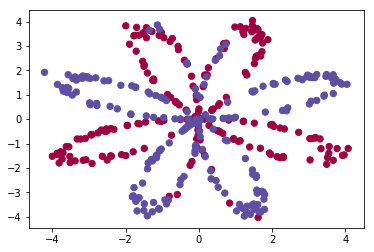

In [3]:
# Visualize the data:
plt.scatter(X[0, :], X[1, :], c=Y, s=40, cmap=plt.cm.Spectral);

You have:
    - a numpy-array (matrix) X that contains your features (x1, x2)
    - a numpy-array (vector) Y that contains your labels (red:0, blue:1).

Lets first get a better sense of what our data is like. 

**Exercise**: How many training examples do you have? In addition, what is the `shape` of the variables `X` and `Y`? 

**Hint**: How do you get the shape of a numpy array? [(help)](https://docs.scipy.org/doc/numpy/reference/generated/numpy.ndarray.shape.html)

In [4]:
### START CODE HERE ### (≈ 3 lines of code)
shape_X = X.shape
shape_Y = Y.shape
m = X.shape[1]  # training set size
### END CODE HERE ###

print ('The shape of X is: ' + str(shape_X))
print ('The shape of Y is: ' + str(shape_Y))
print ('I have m = %d training examples!' % (m))

The shape of X is: (2, 400)
The shape of Y is: (1, 400)
I have m = 400 training examples!


**Expected Output**:
       
<table style="width:20%">
  
  <tr>
    <td>**shape of X**</td>
    <td> (2, 400) </td> 
  </tr>
  
  <tr>
    <td>**shape of Y**</td>
    <td>(1, 400) </td> 
  </tr>
  
    <tr>
    <td>**m**</td>
    <td> 400 </td> 
  </tr>
  
</table>

## 3 - Simple Logistic Regression

Before building a full neural network, lets first see how logistic regression performs on this problem. You can use sklearn's built-in functions to do that. Run the code below to train a logistic regression classifier on the dataset.

In [5]:
# Train the logistic regression classifier
clf = sklearn.linear_model.LogisticRegressionCV();
clf.fit(X.T, Y.T);

You can now plot the decision boundary of these models. Run the code below.

Accuracy of logistic regression: 47 % (percentage of correctly labelled datapoints)


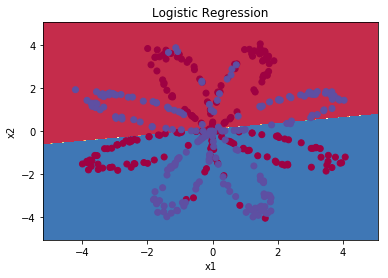

In [7]:
# Plot the decision boundary for logistic regression
plot_decision_boundary(lambda x: clf.predict(x), X, Y)
plt.title("Logistic Regression")

# Print accuracy
LR_predictions = clf.predict(X.T)
print ('Accuracy of logistic regression: %d ' % float((np.dot(Y,LR_predictions) + np.dot(1-Y,1-LR_predictions))/float(Y.size)*100) +
       '% ' + "(percentage of correctly labelled datapoints)")

**Expected Output**:

<table style="width:20%">
  <tr>
    <td>**Accuracy**</td>
    <td> 47% </td> 
  </tr>
  
</table>


**Interpretation**: The dataset is not linearly separable, so logistic regression doesn't perform well. Hopefully a neural network will do better. Let's try this now! 

## 4 - Neural Network model

Logistic regression did not work well on the "flower dataset". You are going to train a Neural Network with a single hidden layer.

**Here is our model**:
<img src="images/classification_kiank.png" style="width:600px;height:300px;">

**Mathematically**:

For one example $x^{(i)}$:
$$z^{[1] (i)} =  W^{[1]} x^{(i)} + b^{[1]}\tag{1}$$ 
$$a^{[1] (i)} = \tanh(z^{[1] (i)})\tag{2}$$
$$z^{[2] (i)} = W^{[2]} a^{[1] (i)} + b^{[2]}\tag{3}$$
$$\hat{y}^{(i)} = a^{[2] (i)} = \sigma(z^{ [2] (i)})\tag{4}$$
$$y^{(i)}_{prediction} = \begin{cases} 1 & \mbox{if } a^{[2](i)} > 0.5 \\ 0 & \mbox{otherwise } \end{cases}\tag{5}$$

Given the predictions on all the examples, you can also compute the cost $J$ as follows: 
$$J = - \frac{1}{m} \sum\limits_{i = 0}^{m} \large\left(\small y^{(i)}\log\left(a^{[2] (i)}\right) + (1-y^{(i)})\log\left(1- a^{[2] (i)}\right)  \large  \right) \small \tag{6}$$

**Reminder**: The general methodology to build a Neural Network is to:
    1. Define the neural network structure ( # of input units,  # of hidden units, etc). 
    2. Initialize the model's parameters
    3. Loop:
        - Implement forward propagation
        - Compute loss
        - Implement backward propagation to get the gradients
        - Update parameters (gradient descent)

You often build helper functions to compute steps 1-3 and then merge them into one function we call `nn_model()`. Once you've built `nn_model()` and learnt the right parameters, you can make predictions on new data.

### 4.1 - Defining the neural network structure ####

**Exercise**: Define three variables:
    - n_x: the size of the input layer
    - n_h: the size of the hidden layer (set this to 4) 
    - n_y: the size of the output layer

**Hint**: Use shapes of X and Y to find n_x and n_y. Also, hard code the hidden layer size to be 4.

In [8]:
# GRADED FUNCTION: layer_sizes

def layer_sizes(X, Y):
    """
    Arguments:
    X -- input dataset of shape (input size, number of examples)
    Y -- labels of shape (output size, number of examples)
    
    Returns:
    n_x -- the size of the input layer
    n_h -- the size of the hidden layer
    n_y -- the size of the output layer
    """
    ### START CODE HERE ### (≈ 3 lines of code)
    n_x = X.shape[0] # size of input layer
    n_h = 4
    n_y = Y.shape[0] # size of output layer
    ### END CODE HERE ###
    return (n_x, n_h, n_y)

In [9]:
X_assess, Y_assess = layer_sizes_test_case()
(n_x, n_h, n_y) = layer_sizes(X_assess, Y_assess)
print("The size of the input layer is: n_x = " + str(n_x))
print("The size of the hidden layer is: n_h = " + str(n_h))
print("The size of the output layer is: n_y = " + str(n_y))

The size of the input layer is: n_x = 5
The size of the hidden layer is: n_h = 4
The size of the output layer is: n_y = 2


**Expected Output** (these are not the sizes you will use for your network, they are just used to assess the function you've just coded).

<table style="width:20%">
  <tr>
    <td>**n_x**</td>
    <td> 5 </td> 
  </tr>
  
    <tr>
    <td>**n_h**</td>
    <td> 4 </td> 
  </tr>
  
    <tr>
    <td>**n_y**</td>
    <td> 2 </td> 
  </tr>
  
</table>

### 4.2 - Initialize the model's parameters ####

**Exercise**: Implement the function `initialize_parameters()`.

**Instructions**:
- Make sure your parameters' sizes are right. Refer to the neural network figure above if needed.
- You will initialize the weights matrices with random values. 
    - Use: `np.random.randn(a,b) * 0.01` to randomly initialize a matrix of shape (a,b).
- You will initialize the bias vectors as zeros. 
    - Use: `np.zeros((a,b))` to initialize a matrix of shape (a,b) with zeros.

In [10]:
# GRADED FUNCTION: initialize_parameters

def initialize_parameters(n_x, n_h, n_y):
    """
    Argument:
    n_x -- size of the input layer
    n_h -- size of the hidden layer
    n_y -- size of the output layer
    
    Returns:
    params -- python dictionary containing your parameters:
                    W1 -- weight matrix of shape (n_h, n_x)
                    b1 -- bias vector of shape (n_h, 1)
                    W2 -- weight matrix of shape (n_y, n_h)
                    b2 -- bias vector of shape (n_y, 1)
    """
    
    np.random.seed(2) # we set up a seed so that your output matches ours although the initialization is random.
    
    ### START CODE HERE ### (≈ 4 lines of code)
    W1 = np.random.randn(n_h,n_x) * 0.01
    b1 = np.zeros((n_h,1))
    W2 = np.random.randn(n_y,n_h) * 0.01
    b2 = np.zeros((n_y,1))
    ### END CODE HERE ###
    
    assert (W1.shape == (n_h, n_x))
    assert (b1.shape == (n_h, 1))
    assert (W2.shape == (n_y, n_h))
    assert (b2.shape == (n_y, 1))
    
    parameters = {"W1": W1,
                  "b1": b1,
                  "W2": W2,
                  "b2": b2}
    
    return parameters

In [11]:
n_x, n_h, n_y = initialize_parameters_test_case()

parameters = initialize_parameters(n_x, n_h, n_y)
print("W1 = " + str(parameters["W1"]))
print("b1 = " + str(parameters["b1"]))
print("W2 = " + str(parameters["W2"]))
print("b2 = " + str(parameters["b2"]))

W1 = [[-0.00416758 -0.00056267]
 [-0.02136196  0.01640271]
 [-0.01793436 -0.00841747]
 [ 0.00502881 -0.01245288]]
b1 = [[ 0.]
 [ 0.]
 [ 0.]
 [ 0.]]
W2 = [[-0.01057952 -0.00909008  0.00551454  0.02292208]]
b2 = [[ 0.]]


**Expected Output**:

<table style="width:90%">
  <tr>
    <td>**W1**</td>
    <td> [[-0.00416758 -0.00056267]
 [-0.02136196  0.01640271]
 [-0.01793436 -0.00841747]
 [ 0.00502881 -0.01245288]] </td> 
  </tr>
  
  <tr>
    <td>**b1**</td>
    <td> [[ 0.]
 [ 0.]
 [ 0.]
 [ 0.]] </td> 
  </tr>
  
  <tr>
    <td>**W2**</td>
    <td> [[-0.01057952 -0.00909008  0.00551454  0.02292208]]</td> 
  </tr>
  

  <tr>
    <td>**b2**</td>
    <td> [[ 0.]] </td> 
  </tr>
  
</table>



### 4.3 - The Loop ####

**Question**: Implement `forward_propagation()`.

**Instructions**:
- Look above at the mathematical representation of your classifier.
- You can use the function `sigmoid()`. It is built-in (imported) in the notebook.
- You can use the function `np.tanh()`. It is part of the numpy library.
- The steps you have to implement are:
    1. Retrieve each parameter from the dictionary "parameters" (which is the output of `initialize_parameters()`) by using `parameters[".."]`.
    2. Implement Forward Propagation. Compute $Z^{[1]}, A^{[1]}, Z^{[2]}$ and $A^{[2]}$ (the vector of all your predictions on all the examples in the training set).
- Values needed in the backpropagation are stored in "`cache`". The `cache` will be given as an input to the backpropagation function.

In [14]:
# GRADED FUNCTION: forward_propagation

def forward_propagation(X, parameters):
    """
    Argument:
    X -- input data of size (n_x, m)
    parameters -- python dictionary containing your parameters (output of initialization function)
    
    Returns:
    A2 -- The sigmoid output of the second activation
    cache -- a dictionary containing "Z1", "A1", "Z2" and "A2"
    """
    # Retrieve each parameter from the dictionary "parameters"
    ### START CODE HERE ### (≈ 4 lines of code)
    W1 = parameters['W1']
    b1 = parameters['b1']
    W2 = parameters['W2']
    b2 = parameters['b2']
    ### END CODE HERE ###
    
    # Implement Forward Propagation to calculate A2 (probabilities)
    ### START CODE HERE ### (≈ 4 lines of code)
    Z1 = np.dot(W1,X) + b1
    A1 = np.tanh(Z1)
    Z2 = np.dot(W2,A1)+ b2
    A2 = sigmoid(Z2)
    ### END CODE HERE ###
    
    assert(A2.shape == (1, X.shape[1]))
    
    cache = {"Z1": Z1,
             "A1": A1,
             "Z2": Z2,
             "A2": A2}
    
    return A2, cache

In [15]:
X_assess, parameters = forward_propagation_test_case()
A2, cache = forward_propagation(X_assess, parameters)

# Note: we use the mean here just to make sure that your output matches ours. 
print(np.mean(cache['Z1']) ,np.mean(cache['A1']),np.mean(cache['Z2']),np.mean(cache['A2']))

0.262818640198 0.091999045227 -1.30766601287 0.212877681719


**Expected Output**:
<table style="width:50%">
  <tr>
    <td> 0.262818640198 0.091999045227 -1.30766601287 0.212877681719 </td> 
  </tr>
</table>

Now that you have computed $A^{[2]}$ (in the Python variable "`A2`"), which contains $a^{[2](i)}$ for every example, you can compute the cost function as follows:

$$J = - \frac{1}{m} \sum\limits_{i = 1}^{m} \large{(} \small y^{(i)}\log\left(a^{[2] (i)}\right) + (1-y^{(i)})\log\left(1- a^{[2] (i)}\right) \large{)} \small\tag{13}$$

**Exercise**: Implement `compute_cost()` to compute the value of the cost $J$.

**Instructions**:
- There are many ways to implement the cross-entropy loss. To help you, we give you how we would have implemented
$- \sum\limits_{i=0}^{m}  y^{(i)}\log(a^{[2](i)})$:
```python
logprobs = np.multiply(np.log(A2),Y)
cost = - np.sum(logprobs)                # no need to use a for loop!
```

(you can use either `np.multiply()` and then `np.sum()` or directly `np.dot()`).  
Note that if you use `np.multiply` followed by `np.sum` the end result will be a type `float`, whereas if you use `np.dot`, the result will be a 2D numpy array.  We can use `np.squeeze()` to remove redundant dimensions (in the case of single float, this will be reduced to a zero-dimension array). We can cast the array as a type `float` using `float()`.

In [18]:
# GRADED FUNCTION: compute_cost

def compute_cost(A2, Y, parameters):
    """
    Computes the cross-entropy cost given in equation (13)
    
    Arguments:
    A2 -- The sigmoid output of the second activation, of shape (1, number of examples)
    Y -- "true" labels vector of shape (1, number of examples)
    parameters -- python dictionary containing your parameters W1, b1, W2 and b2
    [Note that the parameters argument is not used in this function, 
    but the auto-grader currently expects this parameter.
    Future version of this notebook will fix both the notebook 
    and the auto-grader so that `parameters` is not needed.
    For now, please include `parameters` in the function signature,
    and also when invoking this function.]
    
    Returns:
    cost -- cross-entropy cost given equation (13)
    
    """
    
    m = Y.shape[1] # number of example

    # Compute the cross-entropy cost
    ### START CODE HERE ### (≈ 2 lines of code)
    logprobs = np.multiply(np.log(A2),Y) + np.multiply((1 - Y), np.log(1 - A2))
    cost = - np.sum(logprobs)/m
    ### END CODE HERE ###
    
    cost = float(np.squeeze(cost))  # makes sure cost is the dimension we expect. 
                                    # E.g., turns [[17]] into 17 
    assert(isinstance(cost, float))
    
    return cost

In [19]:
A2, Y_assess, parameters = compute_cost_test_case()

print("cost = " + str(compute_cost(A2, Y_assess, parameters)))

cost = 0.6930587610394646


**Expected Output**:
<table style="width:20%">
  <tr>
    <td>**cost**</td>
    <td> 0.693058761... </td> 
  </tr>
  
</table>

Using the cache computed during forward propagation, you can now implement backward propagation.

**Question**: Implement the function `backward_propagation()`.

**Instructions**:
Backpropagation is usually the hardest (most mathematical) part in deep learning. To help you, here again is the slide from the lecture on backpropagation. You'll want to use the six equations on the right of this slide, since you are building a vectorized implementation.  

<img src="images/grad_summary.png" style="width:600px;height:300px;">

<!--
$\frac{\partial \mathcal{J} }{ \partial z_{2}^{(i)} } = \frac{1}{m} (a^{[2](i)} - y^{(i)})$

$\frac{\partial \mathcal{J} }{ \partial W_2 } = \frac{\partial \mathcal{J} }{ \partial z_{2}^{(i)} } a^{[1] (i) T} $

$\frac{\partial \mathcal{J} }{ \partial b_2 } = \sum_i{\frac{\partial \mathcal{J} }{ \partial z_{2}^{(i)}}}$

$\frac{\partial \mathcal{J} }{ \partial z_{1}^{(i)} } =  W_2^T \frac{\partial \mathcal{J} }{ \partial z_{2}^{(i)} } * ( 1 - a^{[1] (i) 2}) $

$\frac{\partial \mathcal{J} }{ \partial W_1 } = \frac{\partial \mathcal{J} }{ \partial z_{1}^{(i)} }  X^T $

$\frac{\partial \mathcal{J} _i }{ \partial b_1 } = \sum_i{\frac{\partial \mathcal{J} }{ \partial z_{1}^{(i)}}}$

- Note that $*$ denotes elementwise multiplication.
- The notation you will use is common in deep learning coding:
    - dW1 = $\frac{\partial \mathcal{J} }{ \partial W_1 }$
    - db1 = $\frac{\partial \mathcal{J} }{ \partial b_1 }$
    - dW2 = $\frac{\partial \mathcal{J} }{ \partial W_2 }$
    - db2 = $\frac{\partial \mathcal{J} }{ \partial b_2 }$
    
!-->

- Tips:
    - To compute dZ1 you'll need to compute $g^{[1]'}(Z^{[1]})$. Since $g^{[1]}(.)$ is the tanh activation function, if $a = g^{[1]}(z)$ then $g^{[1]'}(z) = 1-a^2$. So you can compute 
    $g^{[1]'}(Z^{[1]})$ using `(1 - np.power(A1, 2))`.

In [20]:
# GRADED FUNCTION: backward_propagation

def backward_propagation(parameters, cache, X, Y):
    """
    Implement the backward propagation using the instructions above.
    
    Arguments:
    parameters -- python dictionary containing our parameters 
    cache -- a dictionary containing "Z1", "A1", "Z2" and "A2".
    X -- input data of shape (2, number of examples)
    Y -- "true" labels vector of shape (1, number of examples)
    
    Returns:
    grads -- python dictionary containing your gradients with respect to different parameters
    """
    m = X.shape[1]
    
    # First, retrieve W1 and W2 from the dictionary "parameters".
    ### START CODE HERE ### (≈ 2 lines of code)
    W1 = parameters['W1']
    W2 = parameters['W2']
    ### END CODE HERE ###
        
    # Retrieve also A1 and A2 from dictionary "cache".
    ### START CODE HERE ### (≈ 2 lines of code)
    A1 = cache['A1']
    A2 = cache['A2']
    ### END CODE HERE ###
    
    # Backward propagation: calculate dW1, db1, dW2, db2. 
    ### START CODE HERE ### (≈ 6 lines of code, corresponding to 6 equations on slide above)
    dZ2 = A2-Y
    dW2 = (1/m)*(np.dot(dZ2,A1.T))
    db2 = (1/m)*(np.sum(dZ2, axis=1, keepdims=True))
    dZ1 = np.dot(W2.T,dZ2)*(1 - np.power(A1,2))
    dW1 = (1/m)*np.dot(dZ1,X.T)
    print(dW1)
    db1 = (1/m)*np.sum(dZ1, axis=1, keepdims=True)
    ### END CODE HERE ###
    
    grads = {"dW1": dW1,
             "db1": db1,
             "dW2": dW2,
             "db2": db2}
    
    return grads

In [21]:
parameters, cache, X_assess, Y_assess = backward_propagation_test_case()

grads = backward_propagation(parameters, cache, X_assess, Y_assess)
print ("dW1 = "+ str(grads["dW1"]))
print ("db1 = "+ str(grads["db1"]))
print ("dW2 = "+ str(grads["dW2"]))
print ("db2 = "+ str(grads["db2"]))

[[ 0.00301023 -0.00747267]
 [ 0.00257968 -0.00641288]
 [-0.00156892  0.003893  ]
 [-0.00652037  0.01618243]]
dW1 = [[ 0.00301023 -0.00747267]
 [ 0.00257968 -0.00641288]
 [-0.00156892  0.003893  ]
 [-0.00652037  0.01618243]]
db1 = [[ 0.00176201]
 [ 0.00150995]
 [-0.00091736]
 [-0.00381422]]
dW2 = [[ 0.00078841  0.01765429 -0.00084166 -0.01022527]]
db2 = [[-0.16655712]]


**Expected output**:



<table style="width:80%">
  <tr>
    <td>**dW1**</td>
    <td> [[ 0.00301023 -0.00747267]
 [ 0.00257968 -0.00641288]
 [-0.00156892  0.003893  ]
 [-0.00652037  0.01618243]] </td> 
  </tr>
  
  <tr>
    <td>**db1**</td>
    <td>  [[ 0.00176201]
 [ 0.00150995]
 [-0.00091736]
 [-0.00381422]] </td> 
  </tr>
  
  <tr>
    <td>**dW2**</td>
    <td> [[ 0.00078841  0.01765429 -0.00084166 -0.01022527]] </td> 
  </tr>
  

  <tr>
    <td>**db2**</td>
    <td> [[-0.16655712]] </td> 
  </tr>
  
</table>  

**Question**: Implement the update rule. Use gradient descent. You have to use (dW1, db1, dW2, db2) in order to update (W1, b1, W2, b2).

**General gradient descent rule**: $ \theta = \theta - \alpha \frac{\partial J }{ \partial \theta }$ where $\alpha$ is the learning rate and $\theta$ represents a parameter.

**Illustration**: The gradient descent algorithm with a good learning rate (converging) and a bad learning rate (diverging). Images courtesy of Adam Harley.

<img src="images/sgd.gif" style="width:400;height:400;"> <img src="images/sgd_bad.gif" style="width:400;height:400;">



In [22]:
# GRADED FUNCTION: update_parameters

def update_parameters(parameters, grads, learning_rate = 1.2):
    """
    Updates parameters using the gradient descent update rule given above
    
    Arguments:
    parameters -- python dictionary containing your parameters 
    grads -- python dictionary containing your gradients 
    
    Returns:
    parameters -- python dictionary containing your updated parameters 
    """
    # Retrieve each parameter from the dictionary "parameters"
    ### START CODE HERE ### (≈ 4 lines of code)
    W1 = parameters['W1']
    b1 = parameters['b1']
    W2 = parameters['W2']
    b2 = parameters['b2']
    ### END CODE HERE ###
    
    # Retrieve each gradient from the dictionary "grads"
    ### START CODE HERE ### (≈ 4 lines of code)
    dW1 = grads['dW1']
    db1 = grads['db1']
    dW2 = grads['dW2']
    db2 = grads['db2']
    ## END CODE HERE ###
    
    # Update rule for each parameter
    ### START CODE HERE ### (≈ 4 lines of code)
    W1 = W1-learning_rate*dW1
    b1 = b1-learning_rate*db1
    W2 = W2-learning_rate*dW2
    b2 = b2-learning_rate*db2
    ### END CODE HERE ###
    
    parameters = {"W1": W1,
                  "b1": b1,
                  "W2": W2,
                  "b2": b2}
    
    return parameters

In [23]:
parameters, grads = update_parameters_test_case()
parameters = update_parameters(parameters, grads)

print("W1 = " + str(parameters["W1"]))
print("b1 = " + str(parameters["b1"]))
print("W2 = " + str(parameters["W2"]))
print("b2 = " + str(parameters["b2"]))

W1 = [[-0.00643025  0.01936718]
 [-0.02410458  0.03978052]
 [-0.01653973 -0.02096177]
 [ 0.01046864 -0.05990141]]
b1 = [[ -1.02420756e-06]
 [  1.27373948e-05]
 [  8.32996807e-07]
 [ -3.20136836e-06]]
W2 = [[-0.01041081 -0.04463285  0.01758031  0.04747113]]
b2 = [[ 0.00010457]]


**Expected Output**:


<table style="width:80%">
  <tr>
    <td>**W1**</td>
    <td> [[-0.00643025  0.01936718]
 [-0.02410458  0.03978052]
 [-0.01653973 -0.02096177]
 [ 0.01046864 -0.05990141]]</td> 
  </tr>
  
  <tr>
    <td>**b1**</td>
    <td> [[ -1.02420756e-06]
 [  1.27373948e-05]
 [  8.32996807e-07]
 [ -3.20136836e-06]]</td> 
  </tr>
  
  <tr>
    <td>**W2**</td>
    <td> [[-0.01041081 -0.04463285  0.01758031  0.04747113]] </td> 
  </tr>
  

  <tr>
    <td>**b2**</td>
    <td> [[ 0.00010457]] </td> 
  </tr>
  
</table>  

### 4.4 - Integrate parts 4.1, 4.2 and 4.3 in nn_model() ####

**Question**: Build your neural network model in `nn_model()`.

**Instructions**: The neural network model has to use the previous functions in the right order.

In [25]:
# GRADED FUNCTION: nn_model

def nn_model(X, Y, n_h, num_iterations = 10000, print_cost=False):
    """
    Arguments:
    X -- dataset of shape (2, number of examples)
    Y -- labels of shape (1, number of examples)
    n_h -- size of the hidden layer
    num_iterations -- Number of iterations in gradient descent loop
    print_cost -- if True, print the cost every 1000 iterations
    
    Returns:
    parameters -- parameters learnt by the model. They can then be used to predict.
    """
    
    np.random.seed(3)
    n_x = layer_sizes(X, Y)[0]
    n_y = layer_sizes(X, Y)[2]
    
    # Initialize parameters
    ### START CODE HERE ### (≈ 1 line of code)
    parameters = initialize_parameters(n_x, n_h, n_y)
    ### END CODE HERE ###
    
    # Loop (gradient descent)

    for i in range(0, num_iterations):
         
        ### START CODE HERE ### (≈ 4 lines of code)
        # Forward propagation. Inputs: "X, parameters". Outputs: "A2, cache".
        A2, cache = forward_propagation(X, parameters)
        
        # Cost function. Inputs: "A2, Y, parameters". Outputs: "cost".
        cost = compute_cost(A2, Y, parameters)
 
        # Backpropagation. Inputs: "parameters, cache, X, Y". Outputs: "grads".
        grads = backward_propagation(parameters, cache, X, Y)
 
        # Gradient descent parameter update. Inputs: "parameters, grads". Outputs: "parameters".
        parameters = update_parameters(parameters, grads)
        
        ### END CODE HERE ###
        
        # Print the cost every 1000 iterations
        if print_cost and i % 1000 == 0:
            print ("Cost after iteration %i: %f" %(i, cost))

    return parameters

In [26]:
X_assess, Y_assess = nn_model_test_case()
parameters = nn_model(X_assess, Y_assess, 4, num_iterations=10000, print_cost=True)
print("W1 = " + str(parameters["W1"]))
print("b1 = " + str(parameters["b1"]))
print("W2 = " + str(parameters["W2"]))
print("b2 = " + str(parameters["b2"]))

[[ 0.00301023 -0.00747267]
 [ 0.00257968 -0.00641288]
 [-0.00156892  0.003893  ]
 [-0.00652037  0.01618243]]
Cost after iteration 0: 0.692739
[[ 0.00318087 -0.00764644]
 [ 0.00832665 -0.0200438 ]
 [-0.00180209  0.00432628]
 [-0.00969677  0.02326856]]
[[ 0.00567595 -0.01330438]
 [ 0.01542612 -0.0361869 ]
 [-0.00317623  0.00743024]
 [-0.01750388  0.04080188]]
[[ 0.01006565 -0.0230709 ]
 [ 0.02706949 -0.06181231]
 [-0.00559803  0.01279668]
 [-0.03056008  0.06892509]]
[[ 0.01702547 -0.03795654]
 [ 0.04398364 -0.09617445]
 [-0.00948229  0.02108322]
 [-0.0491971   0.10518889]]
[[ 0.02591707 -0.05528645]
 [ 0.06057738 -0.12258153]
 [-0.01460161  0.03114207]
 [-0.06618822  0.12968309]]
[[ 0.03241656 -0.06525377]
 [ 0.06296526 -0.1163422 ]
 [-0.01879933  0.03808805]
 [-0.06627232  0.11865006]]
[[ 0.03193329 -0.06127564]
 [ 0.04920016 -0.08614631]
 [-0.01950418  0.03798356]
 [-0.05003525  0.08545455]]
[[ 0.02681704 -0.05002157]
 [ 0.03386053 -0.05816206]
 [-0.0175042   0.03332897]
 [-0.03374664 

[[  1.02869663e-04  -1.82742956e-04]
 [  7.60596127e-05  -1.33945405e-04]
 [ -1.23180591e-04   2.16205643e-04]
 [ -7.41877848e-05   1.29039338e-04]]
[[  1.02563155e-04  -1.82198850e-04]
 [  7.58347674e-05  -1.33551237e-04]
 [ -1.22817704e-04   2.15567009e-04]
 [ -7.39687610e-05   1.28660327e-04]]
[[  1.02258380e-04  -1.81657819e-04]
 [  7.56111912e-05  -1.33159287e-04]
 [ -1.22456842e-04   2.14931949e-04]
 [ -7.37509724e-05   1.28283445e-04]]
[[  1.01955324e-04  -1.81119837e-04]
 [  7.53888733e-05  -1.32769536e-04]
 [ -1.22097991e-04   2.14300432e-04]
 [ -7.35344089e-05   1.27908677e-04]]
[[  1.01653971e-04  -1.80584879e-04]
 [  7.51678036e-05  -1.32381966e-04]
 [ -1.21741133e-04   2.13672431e-04]
 [ -7.33190603e-05   1.27536004e-04]]
[[  1.01354309e-04  -1.80052920e-04]
 [  7.49479715e-05  -1.31996560e-04]
 [ -1.21386251e-04   2.13047916e-04]
 [ -7.31049167e-05   1.27165409e-04]]
[[  1.01056324e-04  -1.79523934e-04]
 [  7.47293670e-05  -1.31613300e-04]
 [ -1.21033331e-04   2.12426859e

[[  4.42338372e-05  -7.86180035e-05]
 [  3.29668094e-05  -5.82520447e-05]
 [ -5.32767643e-05   9.33363217e-05]
 [ -3.21910845e-05   5.62071308e-05]]
[[  4.41724123e-05  -7.85088785e-05]
 [  3.29215196e-05  -5.81722987e-05]
 [ -5.32030130e-05   9.32068754e-05]
 [ -3.21469188e-05   5.61303295e-05]]
[[  4.41111500e-05  -7.84000426e-05]
 [  3.28763492e-05  -5.80927626e-05]
 [ -5.31294561e-05   9.30777705e-05]
 [ -3.21028696e-05   5.60537300e-05]]
[[  4.40500498e-05  -7.82914944e-05]
 [  3.28312978e-05  -5.80134354e-05]
 [ -5.30560927e-05   9.29490057e-05]
 [ -3.20589362e-05   5.59773316e-05]]
[[  4.39891111e-05  -7.81832329e-05]
 [  3.27863650e-05  -5.79343165e-05]
 [ -5.29829220e-05   9.28205798e-05]
 [ -3.20151184e-05   5.59011335e-05]]
[[  4.39283332e-05  -7.80752570e-05]
 [  3.27415502e-05  -5.78554049e-05]
 [ -5.29099433e-05   9.26924913e-05]
 [ -3.19714157e-05   5.58251349e-05]]
[[  4.38677154e-05  -7.79675656e-05]
 [  3.26968530e-05  -5.77766999e-05]
 [ -5.28371560e-05   9.25647390e

 [ -2.04376173e-05   3.57467962e-05]]
[[  2.78971348e-05  -4.95902355e-05]
 [  2.08987005e-05  -3.69824975e-05]
 [ -3.36241003e-05   5.88601721e-05]
 [ -2.04191916e-05   3.57146824e-05]]
[[  2.78716767e-05  -4.95449925e-05]
 [  2.08798501e-05  -3.69492393e-05]
 [ -3.35934184e-05   5.88063779e-05]
 [ -2.04007978e-05   3.56826242e-05]]
[[  2.78462631e-05  -4.94998285e-05]
 [  2.08610324e-05  -3.69160387e-05]
 [ -3.35627899e-05   5.87526774e-05]
 [ -2.03824359e-05   3.56506214e-05]]
[[  2.78208937e-05  -4.94547432e-05]
 [  2.08422473e-05  -3.68828955e-05]
 [ -3.35322146e-05   5.86990704e-05]
 [ -2.03641058e-05   3.56186740e-05]]
[[  2.77955686e-05  -4.94097364e-05]
 [  2.08234948e-05  -3.68498097e-05]
 [ -3.35016924e-05   5.86455566e-05]
 [ -2.03458074e-05   3.55867818e-05]]
[[  2.77702875e-05  -4.93648078e-05]
 [  2.08047748e-05  -3.68167810e-05]
 [ -3.34712232e-05   5.85921357e-05]
 [ -2.03275407e-05   3.55549446e-05]]
[[  2.77450504e-05  -4.93199574e-05]
 [  2.07860871e-05  -3.67838094

 [ -1.48496030e-05   2.60009182e-05]]
[[  2.01884246e-05  -3.58894005e-05]
 [  1.51818160e-05  -2.68900363e-05]
 [ -2.43266566e-05   4.25641302e-05]
 [ -1.48396473e-05   2.59835418e-05]]
[[  2.01747154e-05  -3.58650326e-05]
 [  1.51716307e-05  -2.68720437e-05]
 [ -2.43101107e-05   4.25351391e-05]
 [ -1.48297044e-05   2.59661878e-05]]
[[  2.01610240e-05  -3.58406964e-05]
 [  1.51614586e-05  -2.68540744e-05]
 [ -2.42935863e-05   4.25061857e-05]
 [ -1.48197744e-05   2.59488561e-05]]
[[  2.01473505e-05  -3.58163918e-05]
 [  1.51512996e-05  -2.68361283e-05]
 [ -2.42770833e-05   4.24772699e-05]
 [ -1.48098571e-05   2.59315468e-05]]
[[  2.01336946e-05  -3.57921187e-05]
 [  1.51411537e-05  -2.68182052e-05]
 [ -2.42606017e-05   4.24483916e-05]
 [ -1.47999527e-05   2.59142598e-05]]
[[  2.01200565e-05  -3.57678771e-05]
 [  1.51310209e-05  -2.68003053e-05]
 [ -2.42441415e-05   4.24195507e-05]
 [ -1.47900611e-05   2.58969951e-05]]
[[  2.01064361e-05  -3.57436670e-05]
 [  1.51209012e-05  -2.67824284

 [ -1.16610425e-05   2.04330394e-05]]
[[  1.58035402e-05  -2.80948821e-05]
 [  1.19198203e-05  -2.11252658e-05]
 [ -1.90328928e-05   3.32905503e-05]
 [ -1.16547975e-05   2.04221288e-05]]
[[  1.57949647e-05  -2.80796375e-05]
 [  1.19134317e-05  -2.11139706e-05]
 [ -1.90225373e-05   3.32724136e-05]
 [ -1.16485589e-05   2.04112293e-05]]
[[  1.57863982e-05  -2.80644088e-05]
 [  1.19070497e-05  -2.11026870e-05]
 [ -1.90121925e-05   3.32542958e-05]
 [ -1.16423268e-05   2.04003411e-05]]
[[  1.57778405e-05  -2.80491960e-05]
 [  1.19006743e-05  -2.10914150e-05]
 [ -1.90018585e-05   3.32361968e-05]
 [ -1.16361011e-05   2.03894642e-05]]
[[  1.57692917e-05  -2.80339989e-05]
 [  1.18943055e-05  -2.10801546e-05]
 [ -1.89915352e-05   3.32181166e-05]
 [ -1.16298818e-05   2.03785984e-05]]
[[  1.57607518e-05  -2.80188176e-05]
 [  1.18879432e-05  -2.10689059e-05]
 [ -1.89812226e-05   3.32000552e-05]
 [ -1.16236689e-05   2.03677438e-05]]
[[  1.57522208e-05  -2.80036521e-05]
 [  1.18815875e-05  -2.10576687

[[  1.29761014e-05  -2.30683909e-05]
 [  9.81110996e-06  -1.73958372e-05]
 [ -1.56182431e-05   2.73110682e-05]
 [ -9.59535099e-06   1.68227520e-05]]
[[  1.29702250e-05  -2.30579438e-05]
 [  9.80672215e-06  -1.73880745e-05]
 [ -1.56111459e-05   2.72986422e-05]
 [ -9.59106512e-06   1.68152585e-05]]
[[  1.29643537e-05  -2.30475058e-05]
 [  9.80233813e-06  -1.73803184e-05]
 [ -1.56040549e-05   2.72862270e-05]
 [ -9.58678294e-06   1.68077715e-05]]
[[  1.29584876e-05  -2.30370768e-05]
 [  9.79795789e-06  -1.73725691e-05]
 [ -1.55969701e-05   2.72738226e-05]
 [ -9.58250445e-06   1.68002909e-05]]
[[  1.29526265e-05  -2.30266569e-05]
 [  9.79358143e-06  -1.73648264e-05]
 [ -1.55898914e-05   2.72614290e-05]
 [ -9.57822965e-06   1.67928168e-05]]
[[  1.29467705e-05  -2.30162460e-05]
 [  9.78920874e-06  -1.73570903e-05]
 [ -1.55828188e-05   2.72490461e-05]
 [ -9.57395853e-06   1.67853491e-05]]
[[  1.29409196e-05  -2.30058441e-05]
 [  9.78483982e-06  -1.73493610e-05]
 [ -1.55757524e-05   2.72366740e

 [ -8.12698667e-06   1.42546921e-05]]
[[  1.09607352e-05  -1.94853458e-05]
 [  8.30480144e-06  -1.47302680e-05]
 [ -1.31842233e-05   2.30500384e-05]
 [ -8.12387720e-06   1.42492522e-05]]
[[  1.09564844e-05  -1.94777883e-05]
 [  8.30162108e-06  -1.47246385e-05]
 [ -1.31790897e-05   2.30410527e-05]
 [ -8.12077004e-06   1.42438163e-05]]
[[  1.09522368e-05  -1.94702365e-05]
 [  8.29844306e-06  -1.47190132e-05]
 [ -1.31739600e-05   2.30320737e-05]
 [ -8.11766516e-06   1.42383844e-05]]
[[  1.09479924e-05  -1.94626903e-05]
 [  8.29526740e-06  -1.47133921e-05]
 [ -1.31688341e-05   2.30231014e-05]
 [ -8.11456259e-06   1.42329565e-05]]
[[  1.09437511e-05  -1.94551497e-05]
 [  8.29209409e-06  -1.47077751e-05]
 [ -1.31637120e-05   2.30141358e-05]
 [ -8.11146230e-06   1.42275327e-05]]
[[  1.09395130e-05  -1.94476147e-05]
 [  8.28892312e-06  -1.47021622e-05]
 [ -1.31585937e-05   2.30051769e-05]
 [ -8.10836430e-06   1.42221128e-05]]
[[  1.09352780e-05  -1.94400853e-05]
 [  8.28575449e-06  -1.46965535

 [ -7.02218099e-06   1.23213958e-05]]
[[  9.45180819e-06  -1.68025687e-05]
 [  7.17485947e-06  -1.27297812e-05]
 [ -1.13620649e-05   1.98609032e-05]
 [ -7.01983659e-06   1.23172923e-05]]
[[  9.44860937e-06  -1.67968814e-05]
 [  7.17246186e-06  -1.27255354e-05]
 [ -1.13582025e-05   1.98541438e-05]
 [ -7.01749372e-06   1.23131914e-05]]
[[  9.44541264e-06  -1.67911977e-05]
 [  7.17006580e-06  -1.27212925e-05]
 [ -1.13543425e-05   1.98473889e-05]
 [ -7.01515235e-06   1.23090932e-05]]
[[  9.44221798e-06  -1.67855177e-05]
 [  7.16767129e-06  -1.27170522e-05]
 [ -1.13504851e-05   1.98406384e-05]
 [ -7.01281249e-06   1.23049977e-05]]
[[  9.43902539e-06  -1.67798413e-05]
 [  7.16527832e-06  -1.27128147e-05]
 [ -1.13466302e-05   1.98338923e-05]
 [ -7.01047414e-06   1.23009047e-05]]
[[  9.43583487e-06  -1.67741687e-05]
 [  7.16288690e-06  -1.27085799e-05]
 [ -1.13427777e-05   1.98271505e-05]
 [ -7.00813730e-06   1.22968144e-05]]
[[  9.43264643e-06  -1.67684998e-05]
 [  7.16049701e-06  -1.27043479

 [ -6.21739956e-06   1.09124709e-05]]
[[  8.35457862e-06  -1.48517104e-05]
 [  6.35184656e-06  -1.12721382e-05]
 [ -1.00373394e-05   1.75428255e-05]
 [ -6.21554684e-06   1.09092267e-05]]
[[  8.35205471e-06  -1.48472228e-05]
 [  6.34995195e-06  -1.12687820e-05]
 [ -1.00342925e-05   1.75374944e-05]
 [ -6.21369518e-06   1.09059843e-05]]
[[  8.34953227e-06  -1.48427379e-05]
 [  6.34805844e-06  -1.12654278e-05]
 [ -1.00312475e-05   1.75321665e-05]
 [ -6.21184458e-06   1.09027438e-05]]
[[  8.34701128e-06  -1.48382556e-05]
 [  6.34616601e-06  -1.12620756e-05]
 [ -1.00282042e-05   1.75268416e-05]
 [ -6.20999506e-06   1.08995052e-05]]
[[  8.34449176e-06  -1.48337759e-05]
 [  6.34427467e-06  -1.12587252e-05]
 [ -1.00251626e-05   1.75215199e-05]
 [ -6.20814659e-06   1.08962685e-05]]
[[  8.34197370e-06  -1.48292988e-05]
 [  6.34238443e-06  -1.12553768e-05]
 [ -1.00221229e-05   1.75162012e-05]
 [ -6.20629920e-06   1.08930336e-05]]
[[  8.33945710e-06  -1.48248242e-05]
 [  6.34049527e-06  -1.12520304

 [ -5.49387281e-06   9.64529519e-06]]
[[  7.36973599e-06  -1.31006424e-05]
 [  5.61199927e-06  -9.96135888e-06]
 [ -8.84861816e-06   1.54630913e-05]
 [ -5.49241440e-06   9.64274044e-06]]
[[  7.36775253e-06  -1.30971157e-05]
 [  5.61050804e-06  -9.95871645e-06]
 [ -8.84622447e-06   1.54589038e-05]
 [ -5.49095674e-06   9.64018700e-06]]
[[  7.36577009e-06  -1.30935909e-05]
 [  5.60901757e-06  -9.95607537e-06]
 [ -8.84383202e-06   1.54547185e-05]
 [ -5.48949983e-06   9.63763486e-06]]
[[  7.36378868e-06  -1.30900679e-05]
 [  5.60752787e-06  -9.95343565e-06]
 [ -8.84144081e-06   1.54505353e-05]
 [ -5.48804366e-06   9.63508404e-06]]
[[  7.36180830e-06  -1.30865467e-05]
 [  5.60603894e-06  -9.95079728e-06]
 [ -8.83905084e-06   1.54463542e-05]
 [ -5.48658824e-06   9.63253452e-06]]
[[  7.35982893e-06  -1.30830273e-05]
 [  5.60455077e-06  -9.94816027e-06]
 [ -8.83666211e-06   1.54421754e-05]
 [ -5.48513357e-06   9.62998631e-06]]
[[  7.35785059e-06  -1.30795098e-05]
 [  5.60306336e-06  -9.94552461

[[  6.75648519e-06  -1.20102596e-05]
 [  5.15069159e-06  -9.14384422e-06]
 [ -8.10862167e-06   1.41686101e-05]
 [ -5.04146675e-06   8.85269651e-06]]
[[  6.75480671e-06  -1.20072752e-05]
 [  5.14942829e-06  -9.14160519e-06]
 [ -8.10659656e-06   1.41650678e-05]
 [ -5.04023175e-06   8.85053255e-06]]
[[  6.75312905e-06  -1.20042922e-05]
 [  5.14816559e-06  -9.13936723e-06]
 [ -8.10457241e-06   1.41615271e-05]
 [ -5.03899734e-06   8.84836962e-06]]
[[  6.75145218e-06  -1.20013107e-05]
 [  5.14690349e-06  -9.13713033e-06]
 [ -8.10254924e-06   1.41579882e-05]
 [ -5.03776351e-06   8.84620771e-06]]
[[  6.74977611e-06  -1.19983305e-05]
 [  5.14564199e-06  -9.13489449e-06]
 [ -8.10052703e-06   1.41544509e-05]
 [ -5.03653026e-06   8.84404682e-06]]
[[  6.74810084e-06  -1.19953518e-05]
 [  5.14438108e-06  -9.13265970e-06]
 [ -8.09850578e-06   1.41509154e-05]
 [ -5.03529761e-06   8.84188695e-06]]
[[  6.74642637e-06  -1.19923746e-05]
 [  5.14312077e-06  -9.13042598e-06]
 [ -8.09648550e-06   1.41473815e

 [ -4.59535293e-06   8.07091198e-06]]
[[  6.14916319e-06  -1.09304124e-05]
 [  4.69332579e-06  -8.33313732e-06]
 [ -7.37598064e-06   1.28871456e-05]
 [ -4.59432066e-06   8.06910276e-06]]
[[  6.14776269e-06  -1.09279223e-05]
 [  4.69227046e-06  -8.33126647e-06]
 [ -7.37429141e-06   1.28841911e-05]
 [ -4.59328885e-06   8.06729431e-06]]
[[  6.14636280e-06  -1.09254332e-05]
 [  4.69121558e-06  -8.32939643e-06]
 [ -7.37260292e-06   1.28812380e-05]
 [ -4.59225748e-06   8.06548666e-06]]
[[  6.14496352e-06  -1.09229452e-05]
 [  4.69016117e-06  -8.32752720e-06]
 [ -7.37091518e-06   1.28782861e-05]
 [ -4.59122656e-06   8.06367978e-06]]
[[  6.14356486e-06  -1.09204583e-05]
 [  4.68910721e-06  -8.32565878e-06]
 [ -7.36922818e-06   1.28753356e-05]
 [ -4.59019609e-06   8.06187369e-06]]
[[  6.14216681e-06  -1.09179725e-05]
 [  4.68805371e-06  -8.32379118e-06]
 [ -7.36754191e-06   1.28723863e-05]
 [ -4.58916606e-06   8.06006839e-06]]
[[  6.14076937e-06  -1.09154878e-05]
 [  4.68700066e-06  -8.32192438

 [ -4.21369110e-06   7.40190023e-06]]
[[  5.63165463e-06  -1.00102556e-05]
 [  4.30314941e-06  -7.64138009e-06]
 [ -6.75187806e-06   1.17956514e-05]
 [ -4.21281834e-06   7.40037018e-06]]
[[  5.63047194e-06  -1.00081528e-05]
 [  4.30225722e-06  -7.63979812e-06]
 [ -6.75045199e-06   1.17931575e-05]
 [ -4.21194593e-06   7.39884074e-06]]
[[  5.62928973e-06  -1.00060507e-05]
 [  4.30136538e-06  -7.63821679e-06]
 [ -6.74902650e-06   1.17906646e-05]
 [ -4.21107386e-06   7.39731191e-06]]
[[  5.62810799e-06  -1.00039495e-05]
 [  4.30047389e-06  -7.63663609e-06]
 [ -6.74760159e-06   1.17881727e-05]
 [ -4.21020215e-06   7.39578370e-06]]
[[  5.62692673e-06  -1.00018492e-05]
 [  4.29958277e-06  -7.63505602e-06]
 [ -6.74617725e-06   1.17856818e-05]
 [ -4.20933079e-06   7.39425610e-06]]
[[  5.62574594e-06  -9.99974969e-06]
 [  4.29869200e-06  -7.63347658e-06]
 [ -6.74475348e-06   1.17831919e-05]
 [ -4.20845977e-06   7.39272911e-06]]
[[  5.62456563e-06  -9.99765104e-06]
 [  4.29780159e-06  -7.63189778

 [ -3.88748049e-06   6.82995315e-06]]
[[  5.18984318e-06  -9.22469270e-06]
 [  3.96968678e-06  -7.05005956e-06]
 [ -6.21923154e-06   1.08642023e-05]
 [ -3.88673381e-06   6.82864383e-06]]
[[  5.18883246e-06  -9.22289559e-06]
 [  3.96892352e-06  -7.04870597e-06]
 [ -6.21801321e-06   1.08620719e-05]
 [ -3.88598740e-06   6.82733500e-06]]
[[  5.18782212e-06  -9.22109915e-06]
 [  3.96816055e-06  -7.04735288e-06]
 [ -6.21679534e-06   1.08599423e-05]
 [ -3.88524127e-06   6.82602666e-06]]
[[  5.18681215e-06  -9.21930338e-06]
 [  3.96739786e-06  -7.04600030e-06]
 [ -6.21557793e-06   1.08578135e-05]
 [ -3.88449541e-06   6.82471879e-06]]
[[  5.18580256e-06  -9.21750829e-06]
 [  3.96663545e-06  -7.04464822e-06]
 [ -6.21436098e-06   1.08556855e-05]
 [ -3.88374984e-06   6.82341142e-06]]
[[  5.18479335e-06  -9.21571386e-06]
 [  3.96587333e-06  -7.04329665e-06]
 [ -6.21314448e-06   1.08535583e-05]
 [ -3.88300454e-06   6.82210453e-06]]
[[  5.18378452e-06  -9.21392011e-06]
 [  3.96511149e-06  -7.04194557

 [ -3.60880847e-06   6.34125176e-06]]
[[  4.81282113e-06  -8.55433060e-06]
 [  3.68484017e-06  -6.54486217e-06]
 [ -5.76483703e-06   1.00696693e-05]
 [ -3.60816196e-06   6.34011787e-06]]
[[  4.81194690e-06  -8.55277619e-06]
 [  3.68417936e-06  -6.54369007e-06]
 [ -5.76378356e-06   1.00678274e-05]
 [ -3.60751567e-06   6.33898437e-06]]
[[  4.81107298e-06  -8.55122233e-06]
 [  3.68351878e-06  -6.54251838e-06]
 [ -5.76273046e-06   1.00659861e-05]
 [ -3.60686961e-06   6.33785126e-06]]
[[  4.81019937e-06  -8.54966900e-06]
 [  3.68285842e-06  -6.54134709e-06]
 [ -5.76167774e-06   1.00641454e-05]
 [ -3.60622377e-06   6.33671855e-06]]
[[  4.80932606e-06  -8.54811622e-06]
 [  3.68219829e-06  -6.54017621e-06]
 [ -5.76062538e-06   1.00623054e-05]
 [ -3.60557815e-06   6.33558623e-06]]
[[  4.80845305e-06  -8.54656399e-06]
 [  3.68153840e-06  -6.53900573e-06]
 [ -5.75957338e-06   1.00604660e-05]
 [ -3.60493276e-06   6.33445430e-06]]
[[  4.80758036e-06  -8.54501229e-06]
 [  3.68087873e-06  -6.53783566

 [ -3.36922186e-06   5.92101329e-06]]
[[  4.48900065e-06  -7.97856607e-06]
 [  3.43996169e-06  -6.11048497e-06]
 [ -5.37468172e-06   9.38752065e-06]
 [ -3.36865590e-06   5.92002049e-06]]
[[  4.48823607e-06  -7.97720664e-06]
 [  3.43938324e-06  -6.10945882e-06]
 [ -5.37376066e-06   9.38591034e-06]
 [ -3.36809012e-06   5.91902802e-06]]
[[  4.48747175e-06  -7.97584764e-06]
 [  3.43880499e-06  -6.10843301e-06]
 [ -5.37283990e-06   9.38430055e-06]
 [ -3.36752452e-06   5.91803586e-06]]
[[  4.48670767e-06  -7.97448909e-06]
 [  3.43822692e-06  -6.10740752e-06]
 [ -5.37191945e-06   9.38269130e-06]
 [ -3.36695911e-06   5.91704403e-06]]
[[  4.48594385e-06  -7.97313099e-06]
 [  3.43764904e-06  -6.10638237e-06]
 [ -5.37099930e-06   9.38108257e-06]
 [ -3.36639388e-06   5.91605251e-06]]
[[  4.48518027e-06  -7.97177333e-06]
 [  3.43707134e-06  -6.10535756e-06]
 [ -5.37007945e-06   9.37947438e-06]
 [ -3.36582883e-06   5.91506132e-06]]
[[  4.48441695e-06  -7.97041612e-06]
 [  3.43649384e-06  -6.10433308

 [ -3.16164383e-06   5.55685561e-06]]
[[  4.20870089e-06  -7.48018605e-06]
 [  3.22781235e-06  -5.73411279e-06]
 [ -5.03706294e-06   8.79727309e-06]
 [ -3.16114346e-06   5.55597773e-06]]
[[  4.20802553e-06  -7.47898525e-06]
 [  3.22730098e-06  -5.73320551e-06]
 [ -5.03624959e-06   8.79585120e-06]
 [ -3.16064325e-06   5.55510013e-06]]
[[  4.20735038e-06  -7.47778483e-06]
 [  3.22678977e-06  -5.73229852e-06]
 [ -5.03543650e-06   8.79442976e-06]
 [ -3.16014319e-06   5.55422279e-06]]
[[  4.20667544e-06  -7.47658477e-06]
 [  3.22627871e-06  -5.73139180e-06]
 [ -5.03462367e-06   8.79300875e-06]
 [ -3.15964328e-06   5.55334572e-06]]
[[  4.20600070e-06  -7.47538508e-06]
 [  3.22576782e-06  -5.73048536e-06]
 [ -5.03381108e-06   8.79158819e-06]
 [ -3.15914353e-06   5.55246893e-06]]
[[  4.20532618e-06  -7.47418576e-06]
 [  3.22525707e-06  -5.72957919e-06]
 [ -5.03299874e-06   8.79016806e-06]
 [ -3.15864393e-06   5.55159240e-06]]
[[  4.20465186e-06  -7.47298682e-06]
 [  3.22474649e-06  -5.72867331

 [ -2.96374272e-06   5.20961778e-06]]
[[  3.94170740e-06  -7.00546853e-06]
 [  3.02556575e-06  -5.37526280e-06]
 [ -4.71556829e-06   8.23525665e-06]
 [ -2.96330126e-06   5.20884312e-06]]
[[  3.94111208e-06  -7.00441005e-06]
 [  3.02511461e-06  -5.37446228e-06]
 [ -4.71485157e-06   8.23400376e-06]
 [ -2.96285992e-06   5.20806869e-06]]
[[  3.94051694e-06  -7.00335188e-06]
 [  3.02466360e-06  -5.37366199e-06]
 [ -4.71413505e-06   8.23275124e-06]
 [ -2.96241871e-06   5.20729448e-06]]
[[  3.93992197e-06  -7.00229402e-06]
 [  3.02421271e-06  -5.37286193e-06]
 [ -4.71341874e-06   8.23149908e-06]
 [ -2.96197763e-06   5.20652049e-06]]
[[  3.93932717e-06  -7.00123647e-06]
 [  3.02376196e-06  -5.37206210e-06]
 [ -4.71270264e-06   8.23024729e-06]
 [ -2.96153668e-06   5.20574672e-06]]
[[  3.93873254e-06  -7.00017922e-06]
 [  3.02331134e-06  -5.37126250e-06]
 [ -4.71198675e-06   8.22899586e-06]
 [ -2.96109585e-06   5.20497318e-06]]
[[  3.93813809e-06  -6.99912228e-06]
 [  3.02286085e-06  -5.37046313

 [ -2.79717288e-06   4.91730941e-06]]
[[  3.71717660e-06  -6.60625360e-06]
 [  2.85534873e-06  -5.07320741e-06]
 [ -4.44528505e-06   7.76279788e-06]
 [ -2.79677823e-06   4.91661679e-06]]
[[  3.71664484e-06  -6.60530814e-06]
 [  2.85494545e-06  -5.07249174e-06]
 [ -4.44464503e-06   7.76167915e-06]
 [ -2.79638369e-06   4.91592437e-06]]
[[  3.71611322e-06  -6.60436294e-06]
 [  2.85454228e-06  -5.07177626e-06]
 [ -4.44400519e-06   7.76056073e-06]
 [ -2.79598925e-06   4.91523214e-06]]
[[  3.71558176e-06  -6.60341800e-06]
 [  2.85413922e-06  -5.07106098e-06]
 [ -4.44336552e-06   7.75944262e-06]
 [ -2.79559492e-06   4.91454009e-06]]
[[  3.71505044e-06  -6.60247331e-06]
 [  2.85373627e-06  -5.07034589e-06]
 [ -4.44272603e-06   7.75832481e-06]
 [ -2.79520070e-06   4.91384824e-06]]
[[  3.71451926e-06  -6.60152889e-06]
 [  2.85333343e-06  -5.06963099e-06]
 [ -4.44208671e-06   7.75720732e-06]
 [ -2.79480659e-06   4.91315657e-06]]
[[  3.71398824e-06  -6.60058473e-06]
 [  2.85293070e-06  -5.06891630

 [ -2.64535614e-06   4.65085406e-06]]
[[  3.51269568e-06  -6.24269066e-06]
 [  2.70021668e-06  -4.79789109e-06]
 [ -4.19920781e-06   7.33267912e-06]
 [ -2.64500194e-06   4.65023237e-06]]
[[  3.51221881e-06  -6.24184279e-06]
 [  2.69985476e-06  -4.79724875e-06]
 [ -4.19863401e-06   7.33167621e-06]
 [ -2.64464784e-06   4.64961083e-06]]
[[  3.51174206e-06  -6.24099514e-06]
 [  2.69949293e-06  -4.79660658e-06]
 [ -4.19806036e-06   7.33067356e-06]
 [ -2.64429383e-06   4.64898946e-06]]
[[  3.51126543e-06  -6.24014772e-06]
 [  2.69913120e-06  -4.79596457e-06]
 [ -4.19748687e-06   7.32967118e-06]
 [ -2.64393991e-06   4.64836825e-06]]
[[  3.51078893e-06  -6.23930051e-06]
 [  2.69876956e-06  -4.79532273e-06]
 [ -4.19691352e-06   7.32866905e-06]
 [ -2.64358608e-06   4.64774720e-06]]
[[  3.51031256e-06  -6.23845353e-06]
 [  2.69840802e-06  -4.79468105e-06]
 [ -4.19634032e-06   7.32766719e-06]
 [ -2.64323234e-06   4.64712631e-06]]
[[  3.50983630e-06  -6.23760677e-06]
 [  2.69804656e-06  -4.79403954

 [ -2.51001625e-06   4.41328686e-06]]
[[  3.33054614e-06  -5.91883566e-06]
 [  2.56192886e-06  -4.55244406e-06]
 [ -3.98006634e-06   6.94966460e-06]
 [ -2.50969633e-06   4.41272527e-06]]
[[  3.33011574e-06  -5.91807043e-06]
 [  2.56160199e-06  -4.55186387e-06]
 [ -3.97954861e-06   6.94875972e-06]
 [ -2.50937650e-06   4.41216382e-06]]
[[  3.32968545e-06  -5.91730538e-06]
 [  2.56127519e-06  -4.55128381e-06]
 [ -3.97903100e-06   6.94785508e-06]
 [ -2.50905674e-06   4.41160250e-06]]
[[  3.32925526e-06  -5.91654053e-06]
 [  2.56094848e-06  -4.55070391e-06]
 [ -3.97851352e-06   6.94695066e-06]
 [ -2.50873706e-06   4.41104133e-06]]
[[  3.32882518e-06  -5.91577587e-06]
 [  2.56062185e-06  -4.55012414e-06]
 [ -3.97799617e-06   6.94604646e-06]
 [ -2.50841746e-06   4.41048029e-06]]
[[  3.32839521e-06  -5.91501140e-06]
 [  2.56029530e-06  -4.54954452e-06]
 [ -3.97747895e-06   6.94514250e-06]
 [ -2.50809795e-06   4.40991939e-06]]
[[  3.32796534e-06  -5.91424711e-06]
 [  2.55996883e-06  -4.54896504

 [ -2.38603336e-06   4.19562892e-06]]
[[  3.16380282e-06  -5.62237540e-06]
 [  2.43525208e-06  -4.32758458e-06]
 [ -3.77951502e-06   6.59916177e-06]
 [ -2.38574337e-06   4.19511979e-06]]
[[  3.16341295e-06  -5.62168224e-06]
 [  2.43495579e-06  -4.32705863e-06]
 [ -3.77904617e-06   6.59834239e-06]
 [ -2.38545345e-06   4.19461079e-06]]
[[  3.16302318e-06  -5.62098925e-06]
 [  2.43465958e-06  -4.32653281e-06]
 [ -3.77857743e-06   6.59752321e-06]
 [ -2.38516359e-06   4.19410191e-06]]
[[  3.16263350e-06  -5.62029643e-06]
 [  2.43436344e-06  -4.32600711e-06]
 [ -3.77810881e-06   6.59670422e-06]
 [ -2.38487380e-06   4.19359314e-06]]
[[  3.16224391e-06  -5.61960376e-06]
 [  2.43406736e-06  -4.32548154e-06]
 [ -3.77764030e-06   6.59588542e-06]
 [ -2.38458409e-06   4.19308450e-06]]
[[  3.16185441e-06  -5.61891127e-06]
 [  2.43377136e-06  -4.32495608e-06]
 [ -3.77717189e-06   6.59506682e-06]
 [ -2.38429444e-06   4.19257597e-06]]
[[  3.16146501e-06  -5.61821893e-06]
 [  2.43347542e-06  -4.32443076

[[  3.01704494e-06  -5.36145093e-06]
 [  2.32368735e-06  -4.12953301e-06]
 [ -3.60304823e-06   6.29076782e-06]
 [ -2.27657088e-06   4.00344084e-06]]
[[  3.01668916e-06  -5.36081838e-06]
 [  2.32341681e-06  -4.12905271e-06]
 [ -3.60262048e-06   6.29002030e-06]
 [ -2.27630613e-06   4.00297598e-06]]
[[  3.01633346e-06  -5.36018597e-06]
 [  2.32314632e-06  -4.12857252e-06]
 [ -3.60219283e-06   6.28927296e-06]
 [ -2.27604144e-06   4.00251122e-06]]
[[  3.01597784e-06  -5.35955371e-06]
 [  2.32287590e-06  -4.12809244e-06]
 [ -3.60176528e-06   6.28852579e-06]
 [ -2.27577680e-06   4.00204656e-06]]
[[  3.01562230e-06  -5.35892159e-06]
 [  2.32260553e-06  -4.12761247e-06]
 [ -3.60133782e-06   6.28777878e-06]
 [ -2.27551223e-06   4.00158201e-06]]
[[  3.01526684e-06  -5.35828962e-06]
 [  2.32233523e-06  -4.12713260e-06]
 [ -3.60091046e-06   6.28703195e-06]
 [ -2.27524771e-06   4.00111757e-06]]
[[  3.01491147e-06  -5.35765779e-06]
 [  2.32206499e-06  -4.12665284e-06]
 [ -3.60048320e-06   6.28628529e

 [ -2.17717166e-06   3.82890336e-06]]
[[  2.88318650e-06  -5.12346325e-06]
 [  2.22186773e-06  -3.94876690e-06]
 [ -3.44213322e-06   6.00956612e-06]
 [ -2.17692886e-06   3.82847700e-06]]
[[  2.88286050e-06  -5.12288366e-06]
 [  2.22161968e-06  -3.94832651e-06]
 [ -3.44174138e-06   6.00888138e-06]
 [ -2.17668612e-06   3.82805073e-06]]
[[  2.88253458e-06  -5.12230420e-06]
 [  2.22137169e-06  -3.94788622e-06]
 [ -3.44134962e-06   6.00819680e-06]
 [ -2.17644342e-06   3.82762456e-06]]
[[  2.88220872e-06  -5.12172486e-06]
 [  2.22112375e-06  -3.94744603e-06]
 [ -3.44095795e-06   6.00751236e-06]
 [ -2.17620078e-06   3.82719848e-06]]
[[  2.88188293e-06  -5.12114564e-06]
 [  2.22087587e-06  -3.94700593e-06]
 [ -3.44056636e-06   6.00682808e-06]
 [ -2.17595819e-06   3.82677249e-06]]
[[  2.88155722e-06  -5.12056656e-06]
 [  2.22062804e-06  -3.94656593e-06]
 [ -3.44017486e-06   6.00614394e-06]
 [ -2.17571565e-06   3.82634659e-06]]
[[  2.88123158e-06  -5.11998760e-06]
 [  2.22038026e-06  -3.94612602

**Expected Output**:

<table style="width:90%">

<tr> 
    <td> 
        **cost after iteration 0**
    </td>
    <td> 
        0.692739
    </td>
</tr>

<tr> 
    <td> 
        <center> $\vdots$ </center>
    </td>
    <td> 
        <center> $\vdots$ </center>
    </td>
</tr>

  <tr>
    <td>**W1**</td>
    <td> [[-0.65848169  1.21866811]
 [-0.76204273  1.39377573]
 [ 0.5792005  -1.10397703]
 [ 0.76773391 -1.41477129]]</td> 
  </tr>
  
  <tr>
    <td>**b1**</td>
    <td> [[ 0.287592  ]
 [ 0.3511264 ]
 [-0.2431246 ]
 [-0.35772805]] </td> 
  </tr>
  
  <tr>
    <td>**W2**</td>
    <td> [[-2.45566237 -3.27042274  2.00784958  3.36773273]] </td> 
  </tr>
  

  <tr>
    <td>**b2**</td>
    <td> [[ 0.20459656]] </td> 
  </tr>
  
</table>  

### 4.5 Predictions

**Question**: Use your model to predict by building predict().
Use forward propagation to predict results.

**Reminder**: predictions = $y_{prediction} = \mathbb 1 \text{{activation > 0.5}} = \begin{cases}
      1 & \text{if}\ activation > 0.5 \\
      0 & \text{otherwise}
    \end{cases}$  
    
As an example, if you would like to set the entries of a matrix X to 0 and 1 based on a threshold you would do: ```X_new = (X > threshold)```

In [27]:
# GRADED FUNCTION: predict

def predict(parameters, X):
    """
    Using the learned parameters, predicts a class for each example in X
    
    Arguments:
    parameters -- python dictionary containing your parameters 
    X -- input data of size (n_x, m)
    
    Returns
    predictions -- vector of predictions of our model (red: 0 / blue: 1)
    """
    
    # Computes probabilities using forward propagation, and classifies to 0/1 using 0.5 as the threshold.
    ### START CODE HERE ### (≈ 2 lines of code)
    A2, cache = forward_propagation(X, parameters)
    predictions = np.round(A2)
    ### END CODE HERE ###
    
    return predictions

In [28]:
parameters, X_assess = predict_test_case()

predictions = predict(parameters, X_assess)
print("predictions mean = " + str(np.mean(predictions)))

predictions mean = 0.666666666667


**Expected Output**: 


<table style="width:40%">
  <tr>
    <td>**predictions mean**</td>
    <td> 0.666666666667 </td> 
  </tr>
  
</table>

It is time to run the model and see how it performs on a planar dataset. Run the following code to test your model with a single hidden layer of $n_h$ hidden units.

[[ 0.00023606 -0.00207914]
 [ 0.0002091  -0.00178201]
 [-0.00012051  0.0010843 ]
 [-0.00051496  0.00449162]]
Cost after iteration 0: 0.693048
[[ 0.00023483 -0.00207144]
 [ 0.00031157 -0.00264497]
 [-0.00015243  0.00137791]
 [-0.00058369  0.00506875]]
[[ 0.00024656 -0.00217811]
 [ 0.00042644 -0.0035939 ]
 [-0.00019024  0.00172907]
 [-0.00068119  0.00587308]]
[[ 0.00027081 -0.00239571]
 [ 0.00055992 -0.00466439]
 [-0.00023514  0.00215085]
 [-0.00081103  0.00691341]]
[[ 0.00030763 -0.00272476]
 [ 0.00071896 -0.00588539]
 [-0.00028827  0.00265646]
 [-0.00097823  0.00819196]]
[[ 0.00035731 -0.00316745]
 [ 0.00091159 -0.00727257]
 [-0.00035048  0.00325766]
 [-0.00118943  0.00969122]]
[[ 0.0004201  -0.00372434]
 [ 0.00114727 -0.00881596]
 [-0.000422    0.00396148]
 [-0.00145304  0.01135379]]
[[ 0.00049569 -0.00438923]
 [ 0.00143725 -0.01046118]
 [-0.00050178  0.00476472]
 [-0.00177974  0.0130568 ]]
[[ 0.00058248 -0.00514204]
 [ 0.00179484 -0.01208692]
 [-0.00058652  0.005646  ]
 [-0.002183   

 [-0.00388984  0.0064175 ]]
[[ 0.00019569  0.00569338]
 [ 0.0020571  -0.00394964]
 [ 0.00358841  0.00536813]
 [-0.00387884  0.006391  ]]
[[ 0.00019135  0.0056118 ]
 [ 0.0020495  -0.00392665]
 [ 0.00357081  0.00533528]
 [-0.00386811  0.00636475]]
[[ 0.00018707  0.00553259]
 [ 0.00204192 -0.00390399]
 [ 0.00355349  0.00530299]
 [-0.00385763  0.00633876]]
[[ 0.00018285  0.00545566]
 [ 0.00203435 -0.00388163]
 [ 0.00353643  0.00527125]
 [-0.00384738  0.00631302]]
[[ 0.0001787   0.00538092]
 [ 0.00202681 -0.00385958]
 [ 0.00351962  0.00524004]
 [-0.00383737  0.00628752]]
[[ 0.00017461  0.00530828]
 [ 0.00201928 -0.00383783]
 [ 0.00350306  0.00520935]
 [-0.00382758  0.00626226]]
[[ 0.00017058  0.00523765]
 [ 0.00201178 -0.00381636]
 [ 0.00348674  0.00517916]
 [-0.00381799  0.00623724]]
[[ 0.00016662  0.00516897]
 [ 0.00200429 -0.00379518]
 [ 0.00347066  0.00514946]
 [-0.0038086   0.00621245]]
[[ 0.00016273  0.00510214]
 [ 0.00199682 -0.00377427]
 [ 0.00345481  0.00512023]
 [-0.0037994   0.00

 [ -2.37760533e-03   3.17616628e-03]]
[[  1.72815806e-05   1.61448802e-03]
 [  6.02545207e-04  -1.28068862e-03]
 [  1.64110640e-03   2.17362523e-03]
 [ -2.37531713e-03   3.17256761e-03]]
[[  1.74034285e-05   1.61336825e-03]
 [  6.00132932e-04  -1.27731221e-03]
 [  1.63895936e-03   2.17048819e-03]
 [ -2.37303676e-03   3.16898288e-03]]
[[  1.75252627e-05   1.61225748e-03]
 [  5.97727093e-04  -1.27394724e-03]
 [  1.63682208e-03   2.16736549e-03]
 [ -2.37076420e-03   3.16541199e-03]]
[[  1.76470798e-05   1.61115564e-03]
 [  5.95327659e-04  -1.27059365e-03]
 [  1.63469449e-03   2.16425703e-03]
 [ -2.36849938e-03   3.16185485e-03]]
[[  1.77688767e-05   1.61006265e-03]
 [  5.92934600e-04  -1.26725137e-03]
 [  1.63257655e-03   2.16116273e-03]
 [ -2.36624227e-03   3.15831136e-03]]
[[  1.78906500e-05   1.60897844e-03]
 [  5.90547886e-04  -1.26392035e-03]
 [  1.63046820e-03   2.15808252e-03]
 [ -2.36399281e-03   3.15478144e-03]]
[[  1.80123967e-05   1.60790293e-03]
 [  5.88167486e-04  -1.26060052

 [ -1.87196491e-03   2.42967674e-03]]
[[  4.85637316e-05   1.49353902e-03]
 [  7.00448324e-05  -5.58162692e-04]
 [  1.26443827e-03   1.61575937e-03]
 [ -1.87078932e-03   2.42807840e-03]]
[[  4.86281578e-05   1.49352938e-03]
 [  6.90605238e-05  -5.56600965e-04]
 [  1.26387770e-03   1.61488579e-03]
 [ -1.86961499e-03   2.42648228e-03]]
[[  4.86923852e-05   1.49352063e-03]
 [  6.80802851e-05  -5.55041421e-04]
 [  1.26331937e-03   1.61401530e-03]
 [ -1.86844190e-03   2.42488839e-03]]
[[  4.87564142e-05   1.49351276e-03]
 [  6.71041181e-05  -5.53484046e-04]
 [  1.26276325e-03   1.61314789e-03]
 [ -1.86727006e-03   2.42329671e-03]]
[[  4.88202449e-05   1.49350576e-03]
 [  6.61320247e-05  -5.51928828e-04]
 [  1.26220934e-03   1.61228355e-03]
 [ -1.86609946e-03   2.42170723e-03]]
[[  4.88838777e-05   1.49349964e-03]
 [  6.51640065e-05  -5.50375756e-04]
 [  1.26165763e-03   1.61142227e-03]
 [ -1.86493009e-03   2.42011993e-03]]
[[  4.89473127e-05   1.49349437e-03]
 [  6.42000652e-05  -5.48824816

[[  6.10769496e-05   1.50656070e-03]
 [ -4.02359696e-05  -1.22141798e-04]
 [  1.16179224e-03   1.44337279e-03]
 [ -1.54468089e-03   1.98321180e-03]]
[[  6.10976279e-05   1.50658731e-03]
 [ -3.99906406e-05  -1.20935762e-04]
 [  1.16163270e-03   1.44306733e-03]
 [ -1.54383298e-03   1.98197928e-03]]
[[  6.11182562e-05   1.50661360e-03]
 [ -3.97423104e-05  -1.19730314e-04]
 [  1.16147372e-03   1.44276273e-03]
 [ -1.54298604e-03   1.98074735e-03]]
[[  6.11388355e-05   1.50663957e-03]
 [ -3.94909852e-05  -1.18525451e-04]
 [  1.16131529e-03   1.44245900e-03]
 [ -1.54214008e-03   1.97951602e-03]]
[[  6.11593663e-05   1.50666521e-03]
 [ -3.92366709e-05  -1.17321172e-04]
 [  1.16115742e-03   1.44215613e-03]
 [ -1.54129509e-03   1.97828527e-03]]
[[  6.11798495e-05   1.50669053e-03]
 [ -3.89793736e-05  -1.16117473e-04]
 [  1.16100011e-03   1.44185412e-03]
 [ -1.54045107e-03   1.97705512e-03]]
[[  6.12002856e-05   1.50671553e-03]
 [ -3.87190992e-05  -1.14914351e-04]
 [  1.16084335e-03   1.44155296e

 [ -1.32526781e-03   1.60577564e-03]]
[[  7.10591003e-05   1.49880664e-03]
 [  1.84476331e-04   2.86270285e-04]
 [  1.12679833e-03   1.37544175e-03]
 [ -1.32482931e-03   1.60465412e-03]]
[[  7.11228159e-05   1.49876607e-03]
 [  1.85645333e-04   2.87830173e-04]
 [  1.12671223e-03   1.37530436e-03]
 [ -1.32439296e-03   1.60353212e-03]]
[[  7.11868905e-05   1.49872590e-03]
 [  1.86818380e-04   2.89394830e-04]
 [  1.12662609e-03   1.37516730e-03]
 [ -1.32395879e-03   1.60240961e-03]]
[[  7.12513251e-05   1.49868613e-03]
 [  1.87995492e-04   2.90964296e-04]
 [  1.12653990e-03   1.37503057e-03]
 [ -1.32352680e-03   1.60128660e-03]]
[[  7.13161208e-05   1.49864679e-03]
 [  1.89176692e-04   2.92538613e-04]
 [  1.12645367e-03   1.37489417e-03]
 [ -1.32309701e-03   1.60016305e-03]]
[[  7.13812786e-05   1.49860787e-03]
 [  1.90362002e-04   2.94117821e-04]
 [  1.12636738e-03   1.37475810e-03]
 [ -1.32266944e-03   1.59903896e-03]]
[[  7.14467996e-05   1.49856939e-03]
 [  1.91551445e-04   2.95701960

 [-0.00141984  0.00104417]]
[[ 0.0001051   0.00159131]
 [ 0.00127017  0.00152972]
 [ 0.00109334  0.00135367]
 [-0.00142135  0.00104095]]
[[ 0.00010534  0.00159217]
 [ 0.00128115  0.00154067]
 [ 0.00109318  0.00135376]
 [-0.00142288  0.00103771]]
[[ 0.00010559  0.00159304]
 [ 0.0012923   0.00155178]
 [ 0.00109301  0.00135385]
 [-0.00142442  0.00103445]]
[[ 0.00010585  0.00159391]
 [ 0.00130361  0.00156307]
 [ 0.00109283  0.00135394]
 [-0.00142598  0.00103117]]
[[ 0.00010612  0.00159478]
 [ 0.00131509  0.00157452]
 [ 0.00109266  0.00135404]
 [-0.00142755  0.00102786]]
[[ 0.00010639  0.00159566]
 [ 0.00132675  0.00158616]
 [ 0.00109248  0.00135414]
 [-0.00142915  0.00102453]]
[[ 0.00010667  0.00159654]
 [ 0.00133858  0.00159798]
 [ 0.00109229  0.00135424]
 [-0.00143076  0.00102118]]
[[ 0.00010696  0.00159742]
 [ 0.0013506   0.00160998]
 [ 0.00109211  0.00135435]
 [-0.0014324   0.0010178 ]]
[[ 0.00010725  0.0015983 ]
 [ 0.00136281  0.00162218]
 [ 0.00109192  0.00135446]
 [-0.00143406  0.00

[[ -9.00577725e-05   1.52971650e-03]
 [  3.81520433e-03  -1.19926300e-03]
 [  1.16160582e-03   1.31803325e-03]
 [ -1.06673466e-03   6.09738835e-04]]
[[ -9.04728665e-05   1.52874415e-03]
 [  3.80964322e-03  -1.19787982e-03]
 [  1.16178027e-03   1.31780593e-03]
 [ -1.06529932e-03   6.09897220e-04]]
[[ -9.08804123e-05   1.52777135e-03]
 [  3.80410219e-03  -1.19648325e-03]
 [  1.16195165e-03   1.31758175e-03]
 [ -1.06387629e-03   6.10048044e-04]]
[[ -9.12805799e-05   1.52679811e-03]
 [  3.79858100e-03  -1.19507387e-03]
 [  1.16212003e-03   1.31736060e-03]
 [ -1.06246530e-03   6.10191515e-04]]
[[ -9.16735345e-05   1.52582446e-03]
 [  3.79307942e-03  -1.19365223e-03]
 [  1.16228547e-03   1.31714239e-03]
 [ -1.06106608e-03   6.10327838e-04]]
[[ -9.20594372e-05   1.52485043e-03]
 [  3.78759724e-03  -1.19221887e-03]
 [  1.16244803e-03   1.31692703e-03]
 [ -1.05967836e-03   6.10457208e-04]]
[[ -9.24384443e-05   1.52387604e-03]
 [  3.78213424e-03  -1.19077431e-03]
 [  1.16260777e-03   1.31671443e

[[-0.00011375  0.00129884]
 [ 0.00278493 -0.00085375]
 [ 0.00116209  0.00128282]
 [-0.0008435   0.00058973]]
[[-0.00011373  0.00129803]
 [ 0.00278186 -0.00085272]
 [ 0.001162    0.00128269]
 [-0.00084285  0.00058961]]
[[-0.00011372  0.00129721]
 [ 0.00277879 -0.00085169]
 [ 0.00116191  0.00128255]
 [-0.00084221  0.00058948]]
[[-0.0001137   0.0012964 ]
 [ 0.00277573 -0.00085066]
 [ 0.00116182  0.00128242]
 [-0.00084157  0.00058936]]
[[-0.00011369  0.00129559]
 [ 0.00277268 -0.00084964]
 [ 0.00116172  0.00128228]
 [-0.00084093  0.00058924]]
[[-0.00011367  0.00129478]
 [ 0.00276963 -0.00084862]
 [ 0.00116163  0.00128215]
 [-0.00084029  0.00058911]]
[[-0.00011365  0.00129397]
 [ 0.00276659 -0.0008476 ]
 [ 0.00116153  0.00128201]
 [-0.00083966  0.00058899]]
[[-0.00011364  0.00129316]
 [ 0.00276356 -0.00084658]
 [ 0.00116144  0.00128188]
 [-0.00083902  0.00058887]]
[[-0.00011362  0.00129235]
 [ 0.00276053 -0.00084557]
 [ 0.00116135  0.00128174]
 [-0.00083838  0.00058874]]
[[-0.0001136   0.00

 [-0.00070063  0.00055523]]
[[-0.00010388  0.00109978]
 [ 0.00211182 -0.00063421]
 [ 0.00112558  0.00124187]
 [-0.00070021  0.00055511]]
[[-0.00010383  0.00109914]
 [ 0.00210989 -0.00063359]
 [ 0.00112542  0.00124171]
 [-0.00069979  0.00055498]]
[[-0.00010379  0.0010985 ]
 [ 0.00210797 -0.00063298]
 [ 0.00112526  0.00124155]
 [-0.00069938  0.00055486]]
[[-0.00010374  0.00109786]
 [ 0.00210605 -0.00063236]
 [ 0.0011251   0.00124139]
 [-0.00069896  0.00055474]]
[[-0.0001037   0.00109722]
 [ 0.00210413 -0.00063175]
 [ 0.00112494  0.00124123]
 [-0.00069854  0.00055461]]
[[-0.00010365  0.00109658]
 [ 0.00210221 -0.00063114]
 [ 0.00112478  0.00124107]
 [-0.00069813  0.00055449]]
[[-0.00010361  0.00109594]
 [ 0.0021003  -0.00063052]
 [ 0.00112462  0.00124091]
 [-0.00069771  0.00055436]]
[[-0.00010356  0.0010953 ]
 [ 0.00209839 -0.00062991]
 [ 0.00112446  0.00124075]
 [-0.0006973   0.00055424]]
[[-0.00010351  0.00109467]
 [ 0.00209649 -0.0006293 ]
 [ 0.0011243   0.00124059]
 [-0.00069689  0.00

[[ -9.01019469e-05   9.30730921e-04]
 [  1.65348124e-03  -4.87641133e-04]
 [  1.07562603e-03   1.19312604e-03]
 [ -5.99393517e-04   5.20807070e-04]]
[[ -9.00556327e-05   9.30211389e-04]
 [  1.65222021e-03  -4.87236118e-04]
 [  1.07544854e-03   1.19295475e-03]
 [ -5.99111402e-04   5.20698357e-04]]
[[ -9.00093321e-05   9.29692208e-04]
 [  1.65096089e-03  -4.86831633e-04]
 [  1.07527103e-03   1.19278345e-03]
 [ -5.98829639e-04   5.20589706e-04]]
[[ -8.99630454e-05   9.29173377e-04]
 [  1.64970328e-03  -4.86427675e-04]
 [  1.07509349e-03   1.19261212e-03]
 [ -5.98548227e-04   5.20481116e-04]]
[[ -8.99167724e-05   9.28654898e-04]
 [  1.64844737e-03  -4.86024245e-04]
 [  1.07491594e-03   1.19244077e-03]
 [ -5.98267165e-04   5.20372588e-04]]
[[ -8.98705133e-05   9.28136768e-04]
 [  1.64719315e-03  -4.85621342e-04]
 [  1.07473835e-03   1.19226940e-03]
 [ -5.97986452e-04   5.20264122e-04]]
[[ -8.98242682e-05   9.27618989e-04]
 [  1.64594064e-03  -4.85218964e-04]
 [  1.07456075e-03   1.19209801e

[[ -7.69620772e-05   7.88895679e-04]
 [  1.33945498e-03  -3.86001322e-04]
 [  1.02182177e-03   1.14097657e-03]
 [ -5.27972487e-04   4.90821706e-04]]
[[ -7.69214997e-05   7.88469200e-04]
 [  1.33859737e-03  -3.85721178e-04]
 [  1.02164357e-03   1.14080253e-03]
 [ -5.27773454e-04   4.90730836e-04]]
[[ -7.68809441e-05   7.88042994e-04]
 [  1.33774080e-03  -3.85441358e-04]
 [  1.02146539e-03   1.14062848e-03]
 [ -5.27574635e-04   4.90640020e-04]]
[[ -7.68404105e-05   7.87617061e-04]
 [  1.33688526e-03  -3.85161860e-04]
 [  1.02128722e-03   1.14045444e-03]
 [ -5.27376029e-04   4.90549258e-04]]
[[ -7.67998987e-05   7.87191400e-04]
 [  1.33603076e-03  -3.84882685e-04]
 [  1.02110907e-03   1.14028040e-03]
 [ -5.27177636e-04   4.90458550e-04]]
[[ -7.67594089e-05   7.86766012e-04]
 [  1.33517730e-03  -3.84603831e-04]
 [  1.02093093e-03   1.14010636e-03]
 [ -5.26979456e-04   4.90367896e-04]]
[[ -7.67189411e-05   7.86340896e-04]
 [  1.33432486e-03  -3.84325299e-04]
 [  1.02075280e-03   1.13993232e

[[ -6.61194002e-05   6.75886664e-04]
 [  1.12853949e-03  -3.16611956e-04]
 [  9.70953610e-04   1.09079311e-03]
 [ -4.78010401e-04   4.66540649e-04]]
[[ -6.60851903e-05   6.75531521e-04]
 [  1.12792588e-03  -3.16408631e-04]
 [  9.70781716e-04   1.09062173e-03]
 [ -4.77861372e-04   4.66463428e-04]]
[[ -6.60510017e-05   6.75176599e-04]
 [  1.12731295e-03  -3.16205521e-04]
 [  9.70609849e-04   1.09045038e-03]
 [ -4.77712481e-04   4.66386247e-04]]
[[ -6.60168344e-05   6.74821898e-04]
 [  1.12670069e-03  -3.16002626e-04]
 [  9.70438010e-04   1.09027904e-03]
 [ -4.77563728e-04   4.66309106e-04]]
[[ -6.59826884e-05   6.74467418e-04]
 [  1.12608911e-03  -3.15799946e-04]
 [  9.70266200e-04   1.09010771e-03]
 [ -4.77415111e-04   4.66232005e-04]]
[[ -6.59485637e-05   6.74113160e-04]
 [  1.12547820e-03  -3.15597481e-04]
 [  9.70094417e-04   1.08993640e-03]
 [ -4.77266632e-04   4.66154944e-04]]
[[ -6.59144604e-05   6.73759121e-04]
 [  1.12486796e-03  -3.15395230e-04]
 [  9.69922663e-04   1.08976511e

 [ -4.38097763e-04   4.44641525e-04]]
[[ -5.66036536e-05   5.76850261e-04]
 [  9.68304989e-04  -2.63242393e-04]
 [  9.19780527e-04   1.03922653e-03]
 [ -4.37982749e-04   4.44574553e-04]]
[[ -5.65755350e-05   5.76556173e-04]
 [  9.67860289e-04  -2.63093517e-04]
 [  9.19618287e-04   1.03906131e-03]
 [ -4.37867825e-04   4.44507608e-04]]
[[ -5.65474348e-05   5.76262265e-04]
 [  9.67416037e-04  -2.62944787e-04]
 [  9.19456082e-04   1.03889611e-03]
 [ -4.37752991e-04   4.44440692e-04]]
[[ -5.65193529e-05   5.75968535e-04]
 [  9.66972231e-04  -2.62796202e-04]
 [  9.19293911e-04   1.03873093e-03]
 [ -4.37638245e-04   4.44373803e-04]]
[[ -5.64912893e-05   5.75674985e-04]
 [  9.66528871e-04  -2.62647763e-04]
 [  9.19131774e-04   1.03856577e-03]
 [ -4.37523589e-04   4.44306941e-04]]
[[ -5.64632440e-05   5.75381614e-04]
 [  9.66085957e-04  -2.62499468e-04]
 [  9.18969670e-04   1.03840064e-03]
 [ -4.37409022e-04   4.44240108e-04]]
[[ -5.64352170e-05   5.75088422e-04]
 [  9.65643488e-04  -2.62351317

[[ -4.82352270e-05   4.88624598e-04]
 [  8.42523545e-04  -2.20916367e-04]
 [  8.67973405e-04   9.85927795e-04]
 [ -4.04182211e-04   4.23748879e-04]]
[[ -4.82126122e-05   4.88383817e-04]
 [  8.42200520e-04  -2.20806896e-04]
 [  8.67822708e-04   9.85771228e-04]
 [ -4.04091256e-04   4.23689519e-04]]
[[ -4.81900125e-05   4.88143180e-04]
 [  8.41877795e-04  -2.20697521e-04]
 [  8.67672045e-04   9.85614688e-04]
 [ -4.04000360e-04   4.23630178e-04]]
[[ -4.81674277e-05   4.87902687e-04]
 [  8.41555370e-04  -2.20588242e-04]
 [  8.67521418e-04   9.85458177e-04]
 [ -4.03909522e-04   4.23570856e-04]]
[[ -4.81448580e-05   4.87662338e-04]
 [  8.41233245e-04  -2.20479059e-04]
 [  8.67370825e-04   9.85301693e-04]
 [ -4.03818742e-04   4.23511552e-04]]
[[ -4.81223031e-05   4.87422133e-04]
 [  8.40911418e-04  -2.20369971e-04]
 [  8.67220268e-04   9.85145238e-04]
 [ -4.03728020e-04   4.23452267e-04]]
[[ -4.80997633e-05   4.87182071e-04]
 [  8.40589891e-04  -2.20260979e-04]
 [  8.67069746e-04   9.84988810e

[[ -4.15161559e-05   4.16269205e-04]
 [  7.50203836e-04  -1.89272339e-04]
 [  8.19994447e-04   9.35659046e-04]
 [ -3.76862747e-04   4.05018017e-04]]
[[ -4.14980361e-05   4.16071413e-04]
 [  7.49964464e-04  -1.89188903e-04]
 [  8.19855198e-04   9.35511963e-04]
 [ -3.76787637e-04   4.04963927e-04]]
[[ -4.14799285e-05   4.15873738e-04]
 [  7.49725303e-04  -1.89105530e-04]
 [  8.19715983e-04   9.35364908e-04]
 [ -3.76712566e-04   4.04909851e-04]]
[[ -4.14618333e-05   4.15676179e-04]
 [  7.49486356e-04  -1.89022221e-04]
 [  8.19576801e-04   9.35217883e-04]
 [ -3.76637534e-04   4.04855788e-04]]
[[ -4.14437502e-05   4.15478737e-04]
 [  7.49247620e-04  -1.88938975e-04]
 [  8.19437654e-04   9.35070887e-04]
 [ -3.76562542e-04   4.04801739e-04]]
[[ -4.14256795e-05   4.15281411e-04]
 [  7.49009095e-04  -1.88855793e-04]
 [  8.19298539e-04   9.34923919e-04]
 [ -3.76487588e-04   4.04747703e-04]]
[[ -4.14076209e-05   4.15084202e-04]
 [  7.48770783e-04  -1.88772674e-04]
 [  8.19159459e-04   9.34776981e

 [ -3.53904899e-04   3.87795375e-04]]
[[ -3.61336345e-05   3.56598989e-04]
 [  6.81302228e-04  -1.64655971e-04]
 [  7.75575662e-04   8.88415407e-04]
 [ -3.53840690e-04   3.87745262e-04]]
[[ -3.61192209e-05   3.56436236e-04]
 [  6.81123743e-04  -1.64590084e-04]
 [  7.75447222e-04   8.88277883e-04]
 [ -3.53776508e-04   3.87695159e-04]]
[[ -3.61048174e-05   3.56273578e-04]
 [  6.80945415e-04  -1.64524242e-04]
 [  7.75318814e-04   8.88140387e-04]
 [ -3.53712355e-04   3.87645067e-04]]
[[ -3.60904240e-05   3.56111015e-04]
 [  6.80767246e-04  -1.64458443e-04]
 [  7.75190437e-04   8.88002920e-04]
 [ -3.53648228e-04   3.87594986e-04]]
[[ -3.60760407e-05   3.55948547e-04]
 [  6.80589235e-04  -1.64392689e-04]
 [  7.75062091e-04   8.87865480e-04]
 [ -3.53584130e-04   3.87544916e-04]]
[[ -3.60616674e-05   3.55786174e-04]
 [  6.80411383e-04  -1.64326978e-04]
 [  7.74933777e-04   8.87728070e-04]
 [ -3.53520059e-04   3.87494856e-04]]
[[ -3.60473043e-05   3.55623895e-04]
 [  6.80233688e-04  -1.64261311

[[ -3.18895892e-05   3.07728345e-04]
 [  6.30306068e-04  -1.45105902e-04]
 [  7.34839158e-04   8.44548910e-04]
 [ -3.34020068e-04   3.71768930e-04]]
[[ -3.18781787e-05   3.07594044e-04]
 [  6.30173665e-04  -1.45052896e-04]
 [  7.34720592e-04   8.44420526e-04]
 [ -3.33963775e-04   3.71722144e-04]]
[[ -3.18667762e-05   3.07459822e-04]
 [  6.30041383e-04  -1.44999925e-04]
 [  7.34602055e-04   8.44292168e-04]
 [ -3.33907503e-04   3.71675368e-04]]
[[ -3.18553819e-05   3.07325677e-04]
 [  6.29909225e-04  -1.44946990e-04]
 [  7.34483546e-04   8.44163838e-04]
 [ -3.33851252e-04   3.71628601e-04]]
[[ -3.18439955e-05   3.07191610e-04]
 [  6.29777189e-04  -1.44894090e-04]
 [  7.34365066e-04   8.44035534e-04]
 [ -3.33795022e-04   3.71581844e-04]]
[[ -3.18326172e-05   3.07057621e-04]
 [  6.29645275e-04  -1.44841227e-04]
 [  7.34246615e-04   8.43907258e-04]
 [ -3.33738813e-04   3.71535096e-04]]
[[ -3.18212470e-05   3.06923709e-04]
 [  6.29513483e-04  -1.44788400e-04]
 [  7.34128192e-04   8.43779008e

[[ -2.85570421e-05   2.67797791e-04]
 [  5.93103906e-04  -1.29731308e-04]
 [  6.97659842e-04   8.04097181e-04]
 [ -3.16695634e-04   3.57002108e-04]]
[[ -2.85478826e-05   2.67686378e-04]
 [  5.93006546e-04  -1.29690173e-04]
 [  6.97550222e-04   8.03977343e-04]
 [ -3.16645462e-04   3.56958258e-04]]
[[ -2.85387288e-05   2.67575028e-04]
 [  5.92909277e-04  -1.29649076e-04]
 [  6.97440628e-04   8.03857531e-04]
 [ -3.16595308e-04   3.56914416e-04]]
[[ -2.85295806e-05   2.67463740e-04]
 [  5.92812101e-04  -1.29608018e-04]
 [  6.97331060e-04   8.03737744e-04]
 [ -3.16545170e-04   3.56870583e-04]]
[[ -2.85204379e-05   2.67352515e-04]
 [  5.92715017e-04  -1.29566998e-04]
 [  6.97221519e-04   8.03617982e-04]
 [ -3.16495049e-04   3.56826759e-04]]
[[ -2.85113009e-05   2.67241353e-04]
 [  5.92618025e-04  -1.29526016e-04]
 [  6.97112004e-04   8.03498246e-04]
 [ -3.16444946e-04   3.56782943e-04]]
[[ -2.85021695e-05   2.67130253e-04]
 [  5.92521125e-04  -1.29485074e-04]
 [  6.97002516e-04   8.03378536e

 [ -3.00941425e-04   3.42886174e-04]]
[[ -2.57639339e-05   2.33905102e-04]
 [  5.65184466e-04  -1.18291110e-04]
 [  6.62585555e-04   7.65581934e-04]
 [ -3.00896610e-04   3.42844904e-04]]
[[ -2.57561523e-05   2.33812222e-04]
 [  5.65112346e-04  -1.18263944e-04]
 [  6.62484465e-04   7.65470423e-04]
 [ -3.00851809e-04   3.42803642e-04]]
[[ -2.57483733e-05   2.33719390e-04]
 [  5.65040286e-04  -1.18236823e-04]
 [  6.62383400e-04   7.65358936e-04]
 [ -3.00807024e-04   3.42762386e-04]]
[[ -2.57405968e-05   2.33626607e-04]
 [  5.64968283e-04  -1.18209747e-04]
 [  6.62282360e-04   7.65247474e-04]
 [ -3.00762255e-04   3.42721137e-04]]
[[ -2.57328230e-05   2.33533872e-04]
 [  5.64896339e-04  -1.18182716e-04]
 [  6.62181345e-04   7.65136037e-04]
 [ -3.00717500e-04   3.42679894e-04]]
[[ -2.57250517e-05   2.33441185e-04]
 [  5.64824454e-04  -1.18155729e-04]
 [  6.62080355e-04   7.65024624e-04]
 [ -3.00672761e-04   3.42638659e-04]]
[[ -2.57172830e-05   2.33348548e-04]
 [  5.64752626e-04  -1.18128787

[[ -2.32731884e-05   2.05503837e-04]
 [  5.43847542e-04  -1.11689468e-04]
 [  6.30375388e-04   7.29903373e-04]
 [ -2.86840408e-04   3.29478326e-04]]
[[ -2.32658368e-05   2.05424992e-04]
 [  5.43789388e-04  -1.11676515e-04]
 [  6.30282405e-04   7.29799954e-04]
 [ -2.86800465e-04   3.29438936e-04]]
[[ -2.32584854e-05   2.05346183e-04]
 [  5.43731262e-04  -1.11663600e-04]
 [  6.30189446e-04   7.29696559e-04]
 [ -2.86760536e-04   3.29399551e-04]]
[[ -2.32511343e-05   2.05267410e-04]
 [  5.43673161e-04  -1.11650722e-04]
 [  6.30096511e-04   7.29593188e-04]
 [ -2.86720621e-04   3.29360170e-04]]
[[ -2.32437835e-05   2.05188674e-04]
 [  5.43615088e-04  -1.11637882e-04]
 [  6.30003599e-04   7.29489842e-04]
 [ -2.86680720e-04   3.29320794e-04]]
[[ -2.32364329e-05   2.05109974e-04]
 [  5.43557040e-04  -1.11625079e-04]
 [  6.29910712e-04   7.29386519e-04]
 [ -2.86640832e-04   3.29281422e-04]]
[[ -2.32290826e-05   2.05031310e-04]
 [  5.43499020e-04  -1.11612314e-04]
 [  6.29817848e-04   7.29283221e

[[ -2.08213749e-05   1.81026025e-04]
 [  5.25485123e-04  -1.09087485e-04]
 [  6.00619292e-04   6.96692732e-04]
 [ -2.74222975e-04   3.16530263e-04]]
[[ -2.08140425e-05   1.80957880e-04]
 [  5.25432271e-04  -1.09083687e-04]
 [  6.00534030e-04   6.96597259e-04]
 [ -2.74187219e-04   3.16492032e-04]]
[[ -2.08067103e-05   1.80889763e-04]
 [  5.25379426e-04  -1.09079905e-04]
 [  6.00448790e-04   6.96501810e-04]
 [ -2.74151475e-04   3.16453802e-04]]
[[ -2.07993784e-05   1.80821675e-04]
 [  5.25326590e-04  -1.09076140e-04]
 [  6.00363573e-04   6.96406384e-04]
 [ -2.74115742e-04   3.16415576e-04]]
[[ -2.07920466e-05   1.80753615e-04]
 [  5.25273760e-04  -1.09072391e-04]
 [  6.00278377e-04   6.96310981e-04]
 [ -2.74080019e-04   3.16377353e-04]]
[[ -2.07847151e-05   1.80685583e-04]
 [  5.25220938e-04  -1.09068659e-04]
 [  6.00193204e-04   6.96215601e-04]
 [ -2.74044308e-04   3.16339132e-04]]
[[ -2.07773838e-05   1.80617580e-04]
 [  5.25168124e-04  -1.09064942e-04]
 [  6.00108053e-04   6.96120245e

 [ -2.62794057e-04   3.03870006e-04]]
[[ -1.83919000e-05   1.59631872e-04]
 [  5.07992998e-04  -1.08387665e-04]
 [  5.73187622e-04   6.65892906e-04]
 [ -2.62761390e-04   3.03832649e-04]]
[[ -1.83848447e-05   1.59572453e-04]
 [  5.07941401e-04  -1.08386409e-04]
 [  5.73109506e-04   6.65804966e-04]
 [ -2.62728729e-04   3.03795294e-04]]
[[ -1.83777908e-05   1.59513058e-04]
 [  5.07889805e-04  -1.08385153e-04]
 [  5.73031411e-04   6.65717049e-04]
 [ -2.62696076e-04   3.03757942e-04]]
[[ -1.83707384e-05   1.59453687e-04]
 [  5.07838210e-04  -1.08383897e-04]
 [  5.72953336e-04   6.65629152e-04]
 [ -2.62663431e-04   3.03720593e-04]]
[[ -1.83636875e-05   1.59394339e-04]
 [  5.07786617e-04  -1.08382642e-04]
 [  5.72875281e-04   6.65541277e-04]
 [ -2.62630793e-04   3.03683246e-04]]
[[ -1.83566381e-05   1.59335016e-04]
 [  5.07735026e-04  -1.08381388e-04]
 [  5.72797247e-04   6.65453424e-04]
 [ -2.62598162e-04   3.03645902e-04]]
[[ -1.83495902e-05   1.59275716e-04]
 [  5.07683436e-04  -1.08380134

[[ -1.61307010e-05   1.41010828e-04]
 [  4.90778008e-04  -1.07858692e-04]
 [  5.48110669e-04   6.37593622e-04]
 [ -2.52180507e-04   2.91471371e-04]]
[[ -1.61243067e-05   1.40958938e-04]
 [  4.90726840e-04  -1.07856493e-04]
 [  5.48038972e-04   6.37512510e-04]
 [ -2.52149853e-04   2.91434950e-04]]
[[ -1.61179148e-05   1.40907069e-04]
 [  4.90675674e-04  -1.07854290e-04]
 [  5.47967293e-04   6.37431417e-04]
 [ -2.52119204e-04   2.91398532e-04]]
[[ -1.61115252e-05   1.40855221e-04]
 [  4.90624510e-04  -1.07852081e-04]
 [  5.47895632e-04   6.37350344e-04]
 [ -2.52088559e-04   2.91362116e-04]]
[[ -1.61051380e-05   1.40803394e-04]
 [  4.90573347e-04  -1.07849867e-04]
 [  5.47823989e-04   6.37269290e-04]
 [ -2.52057919e-04   2.91325704e-04]]
[[ -1.60987530e-05   1.40751588e-04]
 [  4.90522186e-04  -1.07847649e-04]
 [  5.47752365e-04   6.37188256e-04]
 [ -2.52027284e-04   2.91289295e-04]]
[[ -1.60923705e-05   1.40699804e-04]
 [  4.90471026e-04  -1.07845426e-04]
 [  5.47680758e-04   6.37107240e

 [ -2.42174309e-04   2.79477390e-04]]
[[ -1.41245086e-05   1.24757402e-04]
 [  4.73755588e-04  -1.06835319e-04]
 [  5.25067294e-04   6.11462433e-04]
 [ -2.42144970e-04   2.79442009e-04]]
[[ -1.41189352e-05   1.24712130e-04]
 [  4.73705227e-04  -1.06831398e-04]
 [  5.25001326e-04   6.11387443e-04]
 [ -2.42115634e-04   2.79406631e-04]]
[[ -1.41133641e-05   1.24666877e-04]
 [  4.73654870e-04  -1.06827471e-04]
 [  5.24935373e-04   6.11312471e-04]
 [ -2.42086301e-04   2.79371257e-04]]
[[ -1.41077956e-05   1.24621643e-04]
 [  4.73604515e-04  -1.06823539e-04]
 [  5.24869437e-04   6.11237516e-04]
 [ -2.42056971e-04   2.79335885e-04]]
[[ -1.41022295e-05   1.24576427e-04]
 [  4.73554164e-04  -1.06819603e-04]
 [  5.24803517e-04   6.11162579e-04]
 [ -2.42027645e-04   2.79300517e-04]]
[[ -1.40966659e-05   1.24531229e-04]
 [  4.73503817e-04  -1.06815661e-04]
 [  5.24737613e-04   6.11087658e-04]
 [ -2.41998323e-04   2.79265153e-04]]
[[ -1.40911047e-05   1.24486050e-04]
 [  4.73453473e-04  -1.06811715

[[  6.08540910e-06   1.16460576e-04]
 [  4.51027922e-04  -1.09388699e-04]
 [  5.01353088e-04   5.87389216e-04]
 [ -2.55365035e-04   2.46878949e-04]]
[[ -3.23356538e-05   1.04086285e-04]
 [  4.63530291e-04  -1.00773801e-04]
 [  5.06343738e-04   5.86940634e-04]
 [ -2.07598166e-04   2.90351571e-04]]
[[  9.32532053e-06   1.17416681e-04]
 [  4.49879525e-04  -1.10098379e-04]
 [  5.00808930e-04   5.87282763e-04]
 [ -2.59305270e-04   2.43172037e-04]]
[[ -3.58068698e-05   1.02886861e-04]
 [  4.64573011e-04  -9.99800871e-05]
 [  5.06681860e-04   5.86768326e-04]
 [ -2.03199350e-04   2.94245870e-04]]
[[  1.31424901e-05   1.18557427e-04]
 [  4.48544361e-04  -1.10936140e-04]
 [  5.00189768e-04   5.87182309e-04]
 [ -2.63956507e-04   2.38818772e-04]]
[[ -3.98957542e-05   1.01488021e-04]
 [  4.65818999e-04  -9.90467647e-05]
 [  5.07102103e-04   5.86590353e-04]
 [ -1.98026180e-04   2.98848064e-04]]
[[  1.76424200e-05   1.19916379e-04]
 [  4.46988626e-04  -1.11925152e-04]
 [  4.99482047e-04   5.87088993e

[[ 0.00231906  0.00084192]
 [-0.00025513 -0.00058098]
 [ 0.00024254  0.00061217]
 [-0.00298787 -0.00214076]]
[[-0.00232002 -0.00051756]
 [ 0.00114099  0.00037489]
 [ 0.00079604  0.00055265]
 [ 0.00237542  0.00276319]]
[[ 0.00231924  0.00084195]
 [-0.00025522 -0.00058094]
 [ 0.00024244  0.00061202]
 [-0.0029877  -0.00214081]]
[[-0.0023203  -0.00051761]
 [ 0.00114085  0.00037493]
 [ 0.00079591  0.00055252]
 [ 0.0023755   0.00276316]]
[[ 0.00231943  0.00084199]
 [-0.00025531 -0.00058089]
 [ 0.00024234  0.00061186]
 [-0.00298752 -0.00214086]]
[[-0.00232057 -0.00051767]
 [ 0.00114072  0.00037497]
 [ 0.00079579  0.00055239]
 [ 0.00237558  0.00276313]]
[[ 0.00231961  0.00084203]
 [-0.00025541 -0.00058085]
 [ 0.00024224  0.0006117 ]
 [-0.00298735 -0.00214091]]
[[-0.00232085 -0.00051772]
 [ 0.00114058  0.00037501]
 [ 0.00079567  0.00055226]
 [ 0.00237566  0.00276309]]
[[ 0.00231979  0.00084206]
 [-0.0002555  -0.00058081]
 [ 0.00024214  0.00061154]
 [-0.00298718 -0.00214096]]
[[-0.00232112 -0.00

 [ 0.00238908  0.00275978]]
[[ 0.00234533  0.00084586]
 [-0.00026747 -0.0005762 ]
 [ 0.00022729  0.00058926]
 [-0.00296882 -0.00215423]]
[[-0.00235408 -0.00052698]
 [ 0.00112036  0.0003786 ]
 [ 0.00077746  0.00053392]
 [ 0.00238916  0.00275976]]
[[ 0.00234548  0.00084587]
 [-0.00026754 -0.00057617]
 [ 0.00022719  0.00058912]
 [-0.00296872 -0.00215434]]
[[-0.00235425 -0.00052705]
 [ 0.00112023  0.00037862]
 [ 0.00077734  0.0005338 ]
 [ 0.00238924  0.00275974]]
[[ 0.00234563  0.00084589]
 [-0.0002676  -0.00057614]
 [ 0.0002271   0.00058898]
 [-0.00296863 -0.00215444]]
[[-0.00235443 -0.00052711]
 [ 0.0011201   0.00037863]
 [ 0.00077723  0.00053369]
 [ 0.00238933  0.00275972]]
[[ 0.00234579  0.0008459 ]
 [-0.00026767 -0.00057611]
 [ 0.000227    0.00058884]
 [-0.00296854 -0.00215455]]
[[-0.0023546  -0.00052718]
 [ 0.00111996  0.00037865]
 [ 0.00077711  0.00053358]
 [ 0.00238941  0.00275969]]
[[ 0.00234594  0.00084592]
 [-0.00026774 -0.00057608]
 [ 0.0002269   0.0005887 ]
 [-0.00296844 -0.00

 [-0.0029552  -0.00217037]]
[[-0.00237676 -0.00053758]
 [ 0.00110002  0.00037983]
 [ 0.00075949  0.00051707]
 [ 0.00240031  0.00275533]]
[[ 0.00236701  0.00084671]
 [-0.00027704 -0.00057162]
 [ 0.00021251  0.00056835]
 [-0.00295512 -0.00217046]]
[[-0.00237688 -0.00053765]
 [ 0.00109989  0.00037983]
 [ 0.00075938  0.00051697]
 [ 0.00240037  0.0027553 ]]
[[ 0.00236714  0.00084671]
 [-0.00027709 -0.00057159]
 [ 0.00021242  0.00056822]
 [-0.00295503 -0.00217056]]
[[-0.002377   -0.00053772]
 [ 0.00109976  0.00037983]
 [ 0.00075927  0.00051686]
 [ 0.00240042  0.00275526]]
[[ 0.00236726  0.0008467 ]
 [-0.00027715 -0.00057156]
 [ 0.00021233  0.0005681 ]
 [-0.00295494 -0.00217066]]
[[-0.00237712 -0.00053779]
 [ 0.00109963  0.00037984]
 [ 0.00075915  0.00051676]
 [ 0.00240048  0.00275522]]
[[ 0.00236738  0.0008467 ]
 [-0.0002772  -0.00057153]
 [ 0.00021224  0.00056797]
 [-0.00295486 -0.00217075]]
[[-0.00237724 -0.00053786]
 [ 0.0010995   0.00037984]
 [ 0.00075904  0.00051666]
 [ 0.00240054  0.00

 [ 0.00240718  0.00274828]]
[[ 0.00238421  0.00084545]
 [-0.0002847  -0.0005664 ]
 [ 0.00019898  0.00054906]
 [-0.00294116 -0.00218403]]
[[-0.00239338 -0.00054814]
 [ 0.00107965  0.00037969]
 [ 0.00074217  0.00050152]
 [ 0.00240721  0.00274823]]
[[ 0.00238431  0.00084543]
 [-0.00028475 -0.00056636]
 [ 0.0001989   0.00054894]
 [-0.00294107 -0.00218411]]
[[-0.00239348 -0.00054821]
 [ 0.00107952  0.00037969]
 [ 0.00074206  0.00050143]
 [ 0.00240724  0.00274818]]
[[ 0.00238441  0.00084542]
 [-0.00028479 -0.00056633]
 [ 0.00019881  0.00054882]
 [-0.00294097 -0.00218418]]
[[-0.00239357 -0.00054827]
 [ 0.00107939  0.00037968]
 [ 0.00074195  0.00050133]
 [ 0.00240727  0.00274812]]
[[ 0.00238451  0.00084541]
 [-0.00028484 -0.00056629]
 [ 0.00019873  0.0005487 ]
 [-0.00294088 -0.00218426]]
[[-0.00239366 -0.00054834]
 [ 0.00107926  0.00037968]
 [ 0.00074185  0.00050124]
 [ 0.0024073   0.00274807]]
[[ 0.00238461  0.00084539]
 [-0.00028488 -0.00056626]
 [ 0.00019865  0.00054858]
 [-0.00294079 -0.00

[[-0.00240606 -0.00055807]
 [ 0.00105963  0.00037865]
 [ 0.00072572  0.00048721]
 [ 0.0024103   0.00273876]]
[[ 0.002398    0.00084289]
 [-0.00029108 -0.00056046]
 [ 0.00018656  0.00053082]
 [-0.0029256  -0.00219441]]
[[-0.00240613 -0.00055813]
 [ 0.0010595   0.00037864]
 [ 0.00072562  0.00048712]
 [ 0.00241031  0.00273869]]
[[ 0.00239808  0.00084287]
 [-0.00029112 -0.00056042]
 [ 0.00018648  0.00053071]
 [-0.00292549 -0.00219446]]
[[-0.0024062  -0.00055819]
 [ 0.00105938  0.00037864]
 [ 0.00072551  0.00048703]
 [ 0.00241032  0.00273862]]
[[ 0.00239816  0.00084285]
 [-0.00029116 -0.00056038]
 [ 0.00018641  0.0005306 ]
 [-0.00292539 -0.00219452]]
[[-0.00240627 -0.00055825]
 [ 0.00105925  0.00037863]
 [ 0.00072541  0.00048694]
 [ 0.00241032  0.00273855]]
[[ 0.00239824  0.00084283]
 [-0.0002912  -0.00056034]
 [ 0.00018633  0.00053048]
 [-0.00292529 -0.00219458]]
[[-0.00240634 -0.00055832]
 [ 0.00105912  0.00037862]
 [ 0.00072531  0.00048685]
 [ 0.00241033  0.00273849]]
[[ 0.00239832  0.00

[[ 0.00240891  0.00083963]
 [-0.0002964  -0.00055406]
 [ 0.00017531  0.00051373]
 [-0.00290871 -0.00220185]]
[[-0.00241604 -0.00056734]
 [ 0.00103989  0.00037696]
 [ 0.0007099   0.00047379]
 [ 0.00241044  0.00272734]]
[[ 0.00240897  0.0008396 ]
 [-0.00029643 -0.00055401]
 [ 0.00017524  0.00051362]
 [-0.0029086  -0.00220189]]
[[-0.0024161  -0.0005674 ]
 [ 0.00103976  0.00037695]
 [ 0.0007098   0.00047371]
 [ 0.00241044  0.00272726]]
[[ 0.00240904  0.00083958]
 [-0.00029646 -0.00055397]
 [ 0.00017517  0.00051352]
 [-0.00290849 -0.00220193]]
[[-0.00241616 -0.00056745]
 [ 0.00103964  0.00037694]
 [ 0.0007097   0.00047363]
 [ 0.00241043  0.00272718]]
[[ 0.0024091   0.00083956]
 [-0.00029649 -0.00055393]
 [ 0.0001751   0.00051341]
 [-0.00290838 -0.00220197]]
[[-0.00241621 -0.00056751]
 [ 0.00103951  0.00037693]
 [ 0.0007096   0.00047355]
 [ 0.00241042  0.0027271 ]]
[[ 0.00240916  0.00083954]
 [-0.00029653 -0.00055389]
 [ 0.00017503  0.0005133 ]
 [-0.00290826 -0.00220201]]
[[-0.00241627 -0.00

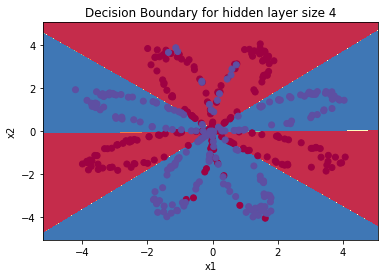

In [29]:
# Build a model with a n_h-dimensional hidden layer
parameters = nn_model(X, Y, n_h = 4, num_iterations = 10000, print_cost=True)

# Plot the decision boundary
plot_decision_boundary(lambda x: predict(parameters, x.T), X, Y)
plt.title("Decision Boundary for hidden layer size " + str(4))

**Expected Output**:

<table style="width:40%">
  <tr>
    <td>**Cost after iteration 9000**</td>
    <td> 0.218607 </td> 
  </tr>
  
</table>


In [30]:
# Print accuracy
predictions = predict(parameters, X)
print ('Accuracy: %d' % float((np.dot(Y,predictions.T) + np.dot(1-Y,1-predictions.T))/float(Y.size)*100) + '%')

Accuracy: 90%


**Expected Output**: 

<table style="width:15%">
  <tr>
    <td>**Accuracy**</td>
    <td> 90% </td> 
  </tr>
</table>

Accuracy is really high compared to Logistic Regression. The model has learnt the leaf patterns of the flower! Neural networks are able to learn even highly non-linear decision boundaries, unlike logistic regression. 

Now, let's try out several hidden layer sizes.

### 4.6 - Tuning hidden layer size (optional/ungraded exercise) ###

Run the following code. It may take 1-2 minutes. You will observe different behaviors of the model for various hidden layer sizes.

[[ 0.00047988 -0.00420853]]
[[ 0.00048038 -0.00420069]]
[[ 0.0005083  -0.00442603]]
[[ 0.00056383 -0.00488021]]
[[ 0.00064878 -0.00556794]]
[[ 0.00076668 -0.00649966]]
[[ 0.00092297 -0.00768614]]
[[ 0.00112545 -0.00912934]]
[[ 0.00138491 -0.01080762]]
[[ 0.00171631 -0.01265414]]
[[ 0.00214055 -0.01453114]]
[[ 0.00268709 -0.01621228]]
[[ 0.00339725 -0.01739698]]
[[ 0.00432712 -0.01778183]]
[[ 0.00554779 -0.01718204]]
[[ 0.00714074 -0.01563809]]
[[ 0.00918706 -0.01342823]]
[[ 0.01174822 -0.01097977]]
[[ 0.01483198 -0.0087544 ]]
[[ 0.01833642 -0.00717626]]
[[ 0.02198358 -0.00659847]]
[[ 0.02530051 -0.00724776]]
[[ 0.02774571 -0.00910486]]
[[ 0.02898874 -0.01179454]]
[[ 0.02911214 -0.01467176]]
[[ 0.02849216 -0.01713354]]
[[ 0.02750578 -0.01887803]]
[[ 0.02637847 -0.01990113]]
[[ 0.02521015 -0.02034488]]
[[ 0.02404336 -0.02037426]]
[[ 0.02290173 -0.02012676]]
[[ 0.02180188 -0.01970416]]
[[ 0.02075557 -0.01917811]]
[[ 0.01977005 -0.01859767]]
[[ 0.0188487  -0.01799569]]
[[ 0.01799188 -0.017

[[ 0.0017281  -0.00194534]]
[[ 0.0017256  -0.00194257]]
[[ 0.0017231  -0.00193982]]
[[ 0.00172062 -0.00193707]]
[[ 0.00171814 -0.00193434]]
[[ 0.00171568 -0.00193162]]
[[ 0.00171322 -0.00192891]]
[[ 0.00171078 -0.00192621]]
[[ 0.00170834 -0.00192351]]
[[ 0.00170591 -0.00192083]]
[[ 0.00170349 -0.00191816]]
[[ 0.00170109 -0.0019155 ]]
[[ 0.00169869 -0.00191285]]
[[ 0.0016963  -0.00191021]]
[[ 0.00169392 -0.00190758]]
[[ 0.00169154 -0.00190496]]
[[ 0.00168918 -0.00190235]]
[[ 0.00168683 -0.00189975]]
[[ 0.00168448 -0.00189716]]
[[ 0.00168215 -0.00189457]]
[[ 0.00167982 -0.001892  ]]
[[ 0.0016775  -0.00188944]]
[[ 0.00167519 -0.00188689]]
[[ 0.00167289 -0.00188434]]
[[ 0.0016706  -0.00188181]]
[[ 0.00166832 -0.00187928]]
[[ 0.00166604 -0.00187676]]
[[ 0.00166378 -0.00187426]]
[[ 0.00166152 -0.00187176]]
[[ 0.00165927 -0.00186927]]
[[ 0.00165703 -0.00186679]]
[[ 0.0016548  -0.00186432]]
[[ 0.00165257 -0.00186186]]
[[ 0.00165035 -0.0018594 ]]
[[ 0.00164815 -0.00185696]]
[[ 0.00164594 -0.001

[[ 0.0011207  -0.00126857]]
[[ 0.00111991 -0.00126768]]
[[ 0.00111911 -0.0012668 ]]
[[ 0.00111832 -0.00126591]]
[[ 0.00111753 -0.00126503]]
[[ 0.00111674 -0.00126414]]
[[ 0.00111596 -0.00126326]]
[[ 0.00111517 -0.00126238]]
[[ 0.00111439 -0.0012615 ]]
[[ 0.00111361 -0.00126062]]
[[ 0.00111283 -0.00125975]]
[[ 0.00111205 -0.00125888]]
[[ 0.00111127 -0.001258  ]]
[[ 0.00111049 -0.00125713]]
[[ 0.00110972 -0.00125626]]
[[ 0.00110894 -0.0012554 ]]
[[ 0.00110817 -0.00125453]]
[[ 0.0011074  -0.00125367]]
[[ 0.00110663 -0.0012528 ]]
[[ 0.00110586 -0.00125194]]
[[ 0.00110509 -0.00125108]]
[[ 0.00110433 -0.00125022]]
[[ 0.00110356 -0.00124937]]
[[ 0.0011028  -0.00124851]]
[[ 0.00110204 -0.00124766]]
[[ 0.00110128 -0.00124681]]
[[ 0.00110052 -0.00124595]]
[[ 0.00109976 -0.00124511]]
[[ 0.001099   -0.00124426]]
[[ 0.00109825 -0.00124341]]
[[ 0.0010975  -0.00124257]]
[[ 0.00109674 -0.00124172]]
[[ 0.00109599 -0.00124088]]
[[ 0.00109524 -0.00124004]]
[[ 0.00109449 -0.0012392 ]]
[[ 0.00109375 -0.001

[[ 0.0008659 -0.000983 ]]
[[ 0.00086549 -0.00098254]]
[[ 0.00086507 -0.00098208]]
[[ 0.00086466 -0.00098161]]
[[ 0.00086425 -0.00098115]]
[[ 0.00086384 -0.00098069]]
[[ 0.00086343 -0.00098023]]
[[ 0.00086302 -0.00097978]]
[[ 0.00086261 -0.00097932]]
[[ 0.0008622  -0.00097886]]
[[ 0.0008618 -0.0009784]]
[[ 0.00086139 -0.00097795]]
[[ 0.00086098 -0.00097749]]
[[ 0.00086057 -0.00097703]]
[[ 0.00086017 -0.00097658]]
[[ 0.00085976 -0.00097612]]
[[ 0.00085936 -0.00097567]]
[[ 0.00085895 -0.00097522]]
[[ 0.00085855 -0.00097476]]
[[ 0.00085815 -0.00097431]]
[[ 0.00085774 -0.00097386]]
[[ 0.00085734 -0.00097341]]
[[ 0.00085694 -0.00097296]]
[[ 0.00085654 -0.00097251]]
[[ 0.00085613 -0.00097206]]
[[ 0.00085573 -0.00097161]]
[[ 0.00085533 -0.00097116]]
[[ 0.00085493 -0.00097071]]
[[ 0.00085453 -0.00097026]]
[[ 0.00085413 -0.00096982]]
[[ 0.00085374 -0.00096937]]
[[ 0.00085334 -0.00096892]]
[[ 0.00085294 -0.00096848]]
[[ 0.00085254 -0.00096803]]
[[ 0.00085215 -0.00096759]]
[[ 0.00085175 -0.0009671

[[ 0.00072141 -0.000821  ]]
[[ 0.00072115 -0.00082071]]
[[ 0.00072089 -0.00082042]]
[[ 0.00072063 -0.00082013]]
[[ 0.00072037 -0.00081984]]
[[ 0.00072011 -0.00081955]]
[[ 0.00071985 -0.00081926]]
[[ 0.00071959 -0.00081897]]
[[ 0.00071934 -0.00081868]]
[[ 0.00071908 -0.00081839]]
[[ 0.00071882 -0.0008181 ]]
[[ 0.00071856 -0.00081781]]
[[ 0.00071831 -0.00081752]]
[[ 0.00071805 -0.00081724]]
[[ 0.00071779 -0.00081695]]
[[ 0.00071754 -0.00081666]]
[[ 0.00071728 -0.00081637]]
[[ 0.00071703 -0.00081608]]
[[ 0.00071677 -0.0008158 ]]
[[ 0.00071651 -0.00081551]]
[[ 0.00071626 -0.00081522]]
[[ 0.000716   -0.00081494]]
[[ 0.00071575 -0.00081465]]
[[ 0.0007155  -0.00081437]]
[[ 0.00071524 -0.00081408]]
[[ 0.00071499 -0.0008138 ]]
[[ 0.00071473 -0.00081351]]
[[ 0.00071448 -0.00081323]]
[[ 0.00071423 -0.00081294]]
[[ 0.00071397 -0.00081266]]
[[ 0.00071372 -0.00081237]]
[[ 0.00071347 -0.00081209]]
[[ 0.00071322 -0.00081181]]
[[ 0.00071296 -0.00081152]]
[[ 0.00071271 -0.00081124]]
[[ 0.00071246 -0.000

[[ 0.00062651 -0.0007143 ]]
[[ 0.00062633 -0.0007141 ]]
[[ 0.00062615 -0.0007139 ]]
[[ 0.00062597 -0.00071369]]
[[ 0.00062579 -0.00071349]]
[[ 0.00062561 -0.00071329]]
[[ 0.00062543 -0.00071308]]
[[ 0.00062525 -0.00071288]]
[[ 0.00062507 -0.00071268]]
[[ 0.00062489 -0.00071247]]
[[ 0.00062471 -0.00071227]]
[[ 0.00062453 -0.00071207]]
[[ 0.00062435 -0.00071187]]
[[ 0.00062417 -0.00071166]]
[[ 0.00062399 -0.00071146]]
[[ 0.00062381 -0.00071126]]
[[ 0.00062363 -0.00071106]]
[[ 0.00062345 -0.00071086]]
[[ 0.00062328 -0.00071066]]
[[ 0.0006231  -0.00071045]]
[[ 0.00062292 -0.00071025]]
[[ 0.00062274 -0.00071005]]
[[ 0.00062256 -0.00070985]]
[[ 0.00062238 -0.00070965]]
[[ 0.00062221 -0.00070945]]
[[ 0.00062203 -0.00070925]]
[[ 0.00062185 -0.00070905]]
[[ 0.00062167 -0.00070885]]
[[ 0.0006215  -0.00070865]]
[[ 0.00062132 -0.00070845]]
[[ 0.00062114 -0.00070825]]
[[ 0.00062096 -0.00070805]]
[[ 0.00062079 -0.00070785]]
[[ 0.00062061 -0.00070765]]
[[ 0.00062043 -0.00070745]]
[[ 0.00062026 -0.000

[[ 0.00055744 -0.00063626]]
[[ 0.00055731 -0.00063611]]
[[ 0.00055718 -0.00063596]]
[[ 0.00055704 -0.00063581]]
[[ 0.00055691 -0.00063566]]
[[ 0.00055678 -0.0006355 ]]
[[ 0.00055664 -0.00063535]]
[[ 0.00055651 -0.0006352 ]]
[[ 0.00055638 -0.00063505]]
[[ 0.00055624 -0.0006349 ]]
[[ 0.00055611 -0.00063475]]
[[ 0.00055598 -0.0006346 ]]
[[ 0.00055584 -0.00063445]]
[[ 0.00055571 -0.0006343 ]]
[[ 0.00055558 -0.00063415]]
[[ 0.00055545 -0.000634  ]]
[[ 0.00055531 -0.00063385]]
[[ 0.00055518 -0.0006337 ]]
[[ 0.00055505 -0.00063355]]
[[ 0.00055492 -0.0006334 ]]
[[ 0.00055478 -0.00063325]]
[[ 0.00055465 -0.0006331 ]]
[[ 0.00055452 -0.00063295]]
[[ 0.00055439 -0.0006328 ]]
[[ 0.00055426 -0.00063265]]
[[ 0.00055412 -0.0006325 ]]
[[ 0.00055399 -0.00063235]]
[[ 0.00055386 -0.0006322 ]]
[[ 0.00055373 -0.00063205]]
[[ 0.0005536 -0.0006319]]
[[ 0.00055347 -0.00063175]]
[[ 0.00055333 -0.0006316 ]]
[[ 0.0005532  -0.00063145]]
[[ 0.00055307 -0.00063131]]
[[ 0.00055294 -0.00063116]]
[[ 0.00055281 -0.00063

[[ 0.00050477 -0.00057639]]
[[ 0.00050467 -0.00057627]]
[[ 0.00050456 -0.00057615]]
[[ 0.00050446 -0.00057603]]
[[ 0.00050436 -0.00057592]]
[[ 0.00050426 -0.0005758 ]]
[[ 0.00050415 -0.00057568]]
[[ 0.00050405 -0.00057556]]
[[ 0.00050395 -0.00057545]]
[[ 0.00050384 -0.00057533]]
[[ 0.00050374 -0.00057521]]
[[ 0.00050364 -0.00057509]]
[[ 0.00050353 -0.00057498]]
[[ 0.00050343 -0.00057486]]
[[ 0.00050333 -0.00057474]]
[[ 0.00050323 -0.00057462]]
[[ 0.00050312 -0.00057451]]
[[ 0.00050302 -0.00057439]]
[[ 0.00050292 -0.00057427]]
[[ 0.00050282 -0.00057416]]
[[ 0.00050271 -0.00057404]]
[[ 0.00050261 -0.00057392]]
[[ 0.00050251 -0.00057381]]
[[ 0.00050241 -0.00057369]]
[[ 0.00050231 -0.00057357]]
[[ 0.0005022  -0.00057346]]
[[ 0.0005021  -0.00057334]]
[[ 0.000502   -0.00057323]]
[[ 0.0005019  -0.00057311]]
[[ 0.0005018  -0.00057299]]
[[ 0.00050169 -0.00057288]]
[[ 0.00050159 -0.00057276]]
[[ 0.00050149 -0.00057264]]
[[ 0.00050139 -0.00057253]]
[[ 0.00050129 -0.00057241]]
[[ 0.00050119 -0.000

[[ 0.0004632  -0.00052884]]
[[ 0.00046312 -0.00052874]]
[[ 0.00046304 -0.00052865]]
[[ 0.00046296 -0.00052855]]
[[ 0.00046287 -0.00052846]]
[[ 0.00046279 -0.00052836]]
[[ 0.00046271 -0.00052827]]
[[ 0.00046263 -0.00052817]]
[[ 0.00046254 -0.00052808]]
[[ 0.00046246 -0.00052798]]
[[ 0.00046238 -0.00052789]]
[[ 0.0004623  -0.00052779]]
[[ 0.00046221 -0.0005277 ]]
[[ 0.00046213 -0.00052761]]
[[ 0.00046205 -0.00052751]]
[[ 0.00046197 -0.00052742]]
[[ 0.00046189 -0.00052732]]
[[ 0.0004618  -0.00052723]]
[[ 0.00046172 -0.00052714]]
[[ 0.00046164 -0.00052704]]
[[ 0.00046156 -0.00052695]]
[[ 0.00046148 -0.00052685]]
[[ 0.0004614  -0.00052676]]
[[ 0.00046131 -0.00052667]]
[[ 0.00046123 -0.00052657]]
[[ 0.00046115 -0.00052648]]
[[ 0.00046107 -0.00052638]]
[[ 0.00046099 -0.00052629]]
[[ 0.00046091 -0.0005262 ]]
[[ 0.00046082 -0.0005261 ]]
[[ 0.00046074 -0.00052601]]
[[ 0.00046066 -0.00052592]]
[[ 0.00046058 -0.00052582]]
[[ 0.0004605  -0.00052573]]
[[ 0.00046042 -0.00052564]]
[[ 0.00046034 -0.000

[[ 0.0004294  -0.00048992]]
[[ 0.00042933 -0.00048985]]
[[ 0.00042926 -0.00048977]]
[[ 0.0004292  -0.00048969]]
[[ 0.00042913 -0.00048961]]
[[ 0.00042906 -0.00048953]]
[[ 0.00042899 -0.00048946]]
[[ 0.00042893 -0.00048938]]
[[ 0.00042886 -0.0004893 ]]
[[ 0.00042879 -0.00048922]]
[[ 0.00042872 -0.00048914]]
[[ 0.00042866 -0.00048907]]
[[ 0.00042859 -0.00048899]]
[[ 0.00042852 -0.00048891]]
[[ 0.00042845 -0.00048883]]
[[ 0.00042839 -0.00048875]]
[[ 0.00042832 -0.00048868]]
[[ 0.00042825 -0.0004886 ]]
[[ 0.00042818 -0.00048852]]
[[ 0.00042812 -0.00048844]]
[[ 0.00042805 -0.00048837]]
[[ 0.00042798 -0.00048829]]
[[ 0.00042791 -0.00048821]]
[[ 0.00042785 -0.00048813]]
[[ 0.00042778 -0.00048806]]
[[ 0.00042771 -0.00048798]]
[[ 0.00042765 -0.0004879 ]]
[[ 0.00042758 -0.00048782]]
[[ 0.00042751 -0.00048775]]
[[ 0.00042745 -0.00048767]]
[[ 0.00042738 -0.00048759]]
[[ 0.00042731 -0.00048751]]
[[ 0.00042724 -0.00048744]]
[[ 0.00042718 -0.00048736]]
[[ 0.00042711 -0.00048728]]
[[ 0.00042704 -0.000

[[ 0.00040171 -0.00045787]]
[[ 0.00040165 -0.0004578 ]]
[[ 0.00040159 -0.00045773]]
[[ 0.00040154 -0.00045767]]
[[ 0.00040148 -0.0004576 ]]
[[ 0.00040142 -0.00045754]]
[[ 0.00040137 -0.00045747]]
[[ 0.00040131 -0.0004574 ]]
[[ 0.00040125 -0.00045734]]
[[ 0.00040119 -0.00045727]]
[[ 0.00040114 -0.00045721]]
[[ 0.00040108 -0.00045714]]
[[ 0.00040102 -0.00045707]]
[[ 0.00040097 -0.00045701]]
[[ 0.00040091 -0.00045694]]
[[ 0.00040085 -0.00045688]]
[[ 0.0004008  -0.00045681]]
[[ 0.00040074 -0.00045675]]
[[ 0.00040068 -0.00045668]]
[[ 0.00040063 -0.00045661]]
[[ 0.00040057 -0.00045655]]
[[ 0.00040052 -0.00045648]]
[[ 0.00040046 -0.00045642]]
[[ 0.0004004  -0.00045635]]
[[ 0.00040035 -0.00045629]]
[[ 0.00040029 -0.00045622]]
[[ 0.00040023 -0.00045616]]
[[ 0.00040018 -0.00045609]]
[[ 0.00040012 -0.00045603]]
[[ 0.00040006 -0.00045596]]
[[ 0.00040001 -0.00045589]]
[[ 0.00039995 -0.00045583]]
[[ 0.0003999  -0.00045576]]
[[ 0.00039984 -0.0004557 ]]
[[ 0.00039978 -0.00045563]]
[[ 0.00039973 -0.000

[[ 0.00037824 -0.00043056]]
[[ 0.00037819 -0.0004305 ]]
[[ 0.00037814 -0.00043045]]
[[ 0.00037809 -0.00043039]]
[[ 0.00037805 -0.00043033]]
[[ 0.000378   -0.00043028]]
[[ 0.00037795 -0.00043022]]
[[ 0.0003779  -0.00043016]]
[[ 0.00037785 -0.00043011]]
[[ 0.0003778  -0.00043005]]
[[ 0.00037775 -0.00042999]]
[[ 0.00037771 -0.00042994]]
[[ 0.00037766 -0.00042988]]
[[ 0.00037761 -0.00042982]]
[[ 0.00037756 -0.00042977]]
[[ 0.00037751 -0.00042971]]
[[ 0.00037746 -0.00042965]]
[[ 0.00037741 -0.0004296 ]]
[[ 0.00037737 -0.00042954]]
[[ 0.00037732 -0.00042948]]
[[ 0.00037727 -0.00042943]]
[[ 0.00037722 -0.00042937]]
[[ 0.00037717 -0.00042931]]
[[ 0.00037712 -0.00042926]]
[[ 0.00037708 -0.0004292 ]]
[[ 0.00037703 -0.00042915]]
[[ 0.00037698 -0.00042909]]
[[ 0.00037693 -0.00042903]]
[[ 0.00037688 -0.00042898]]
[[ 0.00037684 -0.00042892]]
[[ 0.00037679 -0.00042886]]
[[ 0.00037674 -0.00042881]]
[[ 0.00037669 -0.00042875]]
[[ 0.00037664 -0.0004287 ]]
[[ 0.00037659 -0.00042864]]
[[ 0.00037655 -0.000

[[-0.00242651 -0.00214107]
 [ 0.0021738  -0.00230115]]
[[-0.00242146 -0.00213666]
 [ 0.00216928 -0.00229646]]
[[-0.00241643 -0.00213227]
 [ 0.00216479 -0.00229179]]
[[-0.00241143 -0.00212791]
 [ 0.00216032 -0.00228714]]
[[-0.00240646 -0.00212357]
 [ 0.00215587 -0.00228252]]
[[-0.00240152 -0.00211926]
 [ 0.00215145 -0.00227793]]
[[-0.0023966  -0.00211497]
 [ 0.00214705 -0.00227336]]
[[-0.0023917  -0.0021107 ]
 [ 0.00214267 -0.00226881]]
[[-0.00238683 -0.00210645]
 [ 0.00213832 -0.00226429]]
[[-0.00238199 -0.00210223]
 [ 0.00213399 -0.0022598 ]]
[[-0.00237717 -0.00209803]
 [ 0.00212969 -0.00225533]]
[[-0.00237238 -0.00209385]
 [ 0.00212541 -0.00225088]]
[[-0.00236761 -0.00208969]
 [ 0.00212114 -0.00224645]]
[[-0.00236286 -0.00208555]
 [ 0.00211691 -0.00224205]]
[[-0.00235814 -0.00208144]
 [ 0.00211269 -0.00223767]]
[[-0.00235345 -0.00207735]
 [ 0.0021085  -0.00223332]]
[[-0.00234877 -0.00207328]
 [ 0.00210433 -0.00222899]]
[[-0.00234412 -0.00206923]
 [ 0.00210018 -0.00222468]]
[[-0.00233

 [ 0.0013065  -0.00139624]]
[[-0.00142391 -0.00127097]
 [ 0.00130532 -0.001395  ]]
[[-0.00142249 -0.00126975]
 [ 0.00130415 -0.00139376]]
[[-0.00142108 -0.00126853]
 [ 0.00130297 -0.00139252]]
[[-0.00141967 -0.00126731]
 [ 0.0013018  -0.00139128]]
[[-0.00141827 -0.0012661 ]
 [ 0.00130064 -0.00139005]]
[[-0.00141686 -0.00126489]
 [ 0.00129947 -0.00138882]]
[[-0.00141547 -0.00126368]
 [ 0.00129831 -0.00138759]]
[[-0.00141407 -0.00126248]
 [ 0.00129715 -0.00138637]]
[[-0.00141268 -0.00126128]
 [ 0.001296   -0.00138514]]
[[-0.00141129 -0.00126008]
 [ 0.00129485 -0.00138392]]
[[-0.0014099  -0.00125888]
 [ 0.0012937  -0.00138271]]
[[-0.00140852 -0.00125769]
 [ 0.00129255 -0.00138149]]
[[-0.00140713 -0.0012565 ]
 [ 0.0012914  -0.00138028]]
[[-0.00140576 -0.00125531]
 [ 0.00129026 -0.00137907]]
[[-0.00140438 -0.00125412]
 [ 0.00128912 -0.00137787]]
[[-0.00140301 -0.00125294]
 [ 0.00128798 -0.00137667]]
[[-0.00140164 -0.00125176]
 [ 0.00128685 -0.00137546]]
[[-0.00140028 -0.00125058]
 [ 0.00128

[[-0.00104071 -0.00094305]
 [ 0.00098876 -0.00105796]]
[[-0.00104001 -0.00094246]
 [ 0.00098817 -0.00105734]]
[[-0.00103931 -0.00094187]
 [ 0.00098759 -0.00105671]]
[[-0.00103861 -0.00094128]
 [ 0.00098701 -0.00105609]]
[[-0.00103791 -0.00094069]
 [ 0.00098643 -0.00105547]]
[[-0.00103722 -0.0009401 ]
 [ 0.00098585 -0.00105485]]
[[-0.00103652 -0.00093951]
 [ 0.00098527 -0.00105423]]
[[-0.00103583 -0.00093892]
 [ 0.0009847  -0.00105361]]
[[-0.00103513 -0.00093834]
 [ 0.00098412 -0.00105299]]
[[-0.00103444 -0.00093775]
 [ 0.00098354 -0.00105237]]
[[-0.00103375 -0.00093717]
 [ 0.00098297 -0.00105176]]
[[-0.00103306 -0.00093658]
 [ 0.00098239 -0.00105114]]
[[-0.00103237 -0.000936  ]
 [ 0.00098182 -0.00105053]]
[[-0.00103168 -0.00093542]
 [ 0.00098125 -0.00104991]]
[[-0.00103099 -0.00093484]
 [ 0.00098068 -0.0010493 ]]
[[-0.00103031 -0.00093426]
 [ 0.00098011 -0.00104869]]
[[-0.00102962 -0.00093368]
 [ 0.00097954 -0.00104808]]
[[-0.00102894 -0.0009331 ]
 [ 0.00097897 -0.00104747]]
[[-0.00102

 [ 0.00081339 -0.00086946]]
[[-0.00083301 -0.00076927]
 [ 0.00081303 -0.00086907]]
[[-0.00083259 -0.00076893]
 [ 0.00081267 -0.00086868]]
[[-0.00083218 -0.00076858]
 [ 0.00081231 -0.00086829]]
[[-0.00083176 -0.00076824]
 [ 0.00081195 -0.0008679 ]]
[[-0.00083135 -0.0007679 ]
 [ 0.00081159 -0.00086752]]
[[-0.00083094 -0.00076756]
 [ 0.00081123 -0.00086713]]
[[-0.00083052 -0.00076722]
 [ 0.00081087 -0.00086674]]
[[-0.00083011 -0.00076688]
 [ 0.00081052 -0.00086636]]
[[-0.0008297  -0.00076654]
 [ 0.00081016 -0.00086597]]
[[-0.00082929 -0.0007662 ]
 [ 0.0008098  -0.00086558]]
[[-0.00082888 -0.00076586]
 [ 0.00080944 -0.0008652 ]]
[[-0.00082847 -0.00076552]
 [ 0.00080909 -0.00086481]]
[[-0.00082806 -0.00076518]
 [ 0.00080873 -0.00086443]]
[[-0.00082765 -0.00076485]
 [ 0.00080837 -0.00086405]]
[[-0.00082724 -0.00076451]
 [ 0.00080802 -0.00086366]]
[[-0.00082683 -0.00076417]
 [ 0.00080766 -0.00086328]]
[[-0.00082643 -0.00076383]
 [ 0.00080731 -0.0008629 ]]
[[-0.00082602 -0.0007635 ]
 [ 0.00080

[[-0.00070471 -0.00066413]
 [ 0.00069805 -0.00074501]]
[[-0.00070444 -0.00066392]
 [ 0.0006978  -0.00074474]]
[[-0.00070418 -0.0006637 ]
 [ 0.00069755 -0.00074447]]
[[-0.00070391 -0.00066348]
 [ 0.00069731 -0.0007442 ]]
[[-0.00070364 -0.00066327]
 [ 0.00069706 -0.00074393]]
[[-0.00070338 -0.00066305]
 [ 0.00069681 -0.00074367]]
[[-0.00070311 -0.00066283]
 [ 0.00069656 -0.0007434 ]]
[[-0.00070285 -0.00066262]
 [ 0.00069631 -0.00074313]]
[[-0.00070258 -0.0006624 ]
 [ 0.00069607 -0.00074286]]
[[-0.00070232 -0.00066219]
 [ 0.00069582 -0.0007426 ]]
[[-0.00070205 -0.00066197]
 [ 0.00069557 -0.00074233]]
[[-0.00070179 -0.00066176]
 [ 0.00069533 -0.00074206]]
[[-0.00070153 -0.00066154]
 [ 0.00069508 -0.0007418 ]]
[[-0.00070126 -0.00066133]
 [ 0.00069483 -0.00074153]]
[[-0.000701   -0.00066112]
 [ 0.00069459 -0.00074127]]
[[-0.00070074 -0.0006609 ]
 [ 0.00069434 -0.000741  ]]
[[-0.00070047 -0.00066069]
 [ 0.0006941  -0.00074074]]
[[-0.00070021 -0.00066048]
 [ 0.00069385 -0.00074047]]
[[-0.00069

 [ 0.00061533 -0.00065559]]
[[-0.00061924 -0.00059487]
 [ 0.00061514 -0.00065539]]
[[-0.00061906 -0.00059473]
 [ 0.00061496 -0.0006552 ]]
[[-0.00061888 -0.00059458]
 [ 0.00061478 -0.000655  ]]
[[-0.0006187  -0.00059444]
 [ 0.0006146  -0.0006548 ]]
[[-0.00061852 -0.00059429]
 [ 0.00061441 -0.0006546 ]]
[[-0.00061835 -0.00059415]
 [ 0.00061423 -0.00065441]]
[[-0.00061817 -0.000594  ]
 [ 0.00061405 -0.00065421]]
[[-0.00061799 -0.00059386]
 [ 0.00061387 -0.00065401]]
[[-0.00061781 -0.00059371]
 [ 0.00061369 -0.00065382]]
[[-0.00061763 -0.00059357]
 [ 0.0006135  -0.00065362]]
[[-0.00061745 -0.00059342]
 [ 0.00061332 -0.00065342]]
[[-0.00061728 -0.00059328]
 [ 0.00061314 -0.00065323]]
[[-0.0006171  -0.00059314]
 [ 0.00061296 -0.00065303]]
[[-0.00061692 -0.00059299]
 [ 0.00061278 -0.00065284]]
[[-0.00061674 -0.00059285]
 [ 0.0006126  -0.00065264]]
[[-0.00061657 -0.00059271]
 [ 0.00061242 -0.00065245]]
[[-0.00061639 -0.00059256]
 [ 0.00061224 -0.00065225]]
[[-0.00061621 -0.00059242]
 [ 0.00061

 [ 0.00055343 -0.00058862]]
[[-0.00056109 -0.00054756]
 [ 0.00055329 -0.00058847]]
[[-0.00056096 -0.00054746]
 [ 0.00055315 -0.00058832]]
[[-0.00056084 -0.00054736]
 [ 0.00055301 -0.00058817]]
[[-0.00056071 -0.00054726]
 [ 0.00055287 -0.00058801]]
[[-0.00056059 -0.00054715]
 [ 0.00055273 -0.00058786]]
[[-0.00056046 -0.00054705]
 [ 0.00055259 -0.00058771]]
[[-0.00056034 -0.00054695]
 [ 0.00055245 -0.00058756]]
[[-0.00056021 -0.00054684]
 [ 0.00055231 -0.00058741]]
[[-0.00056009 -0.00054674]
 [ 0.00055217 -0.00058726]]
[[-0.00055996 -0.00054664]
 [ 0.00055203 -0.0005871 ]]
[[-0.00055984 -0.00054654]
 [ 0.00055189 -0.00058695]]
[[-0.00055971 -0.00054643]
 [ 0.00055175 -0.0005868 ]]
[[-0.00055959 -0.00054633]
 [ 0.00055161 -0.00058665]]
[[-0.00055946 -0.00054623]
 [ 0.00055147 -0.0005865 ]]
[[-0.00055934 -0.00054613]
 [ 0.00055133 -0.00058635]]
[[-0.00055922 -0.00054603]
 [ 0.00055119 -0.0005862 ]]
[[-0.00055909 -0.00054592]
 [ 0.00055105 -0.00058605]]
[[-0.00055897 -0.00054582]
 [ 0.00055

[[-0.00051952 -0.00051312]
 [ 0.00050475 -0.00053593]]
[[-0.00051943 -0.00051304]
 [ 0.00050464 -0.0005358 ]]
[[-0.00051934 -0.00051296]
 [ 0.00050453 -0.00053568]]
[[-0.00051924 -0.00051289]
 [ 0.00050441 -0.00053556]]
[[-0.00051915 -0.00051281]
 [ 0.0005043  -0.00053544]]
[[-0.00051906 -0.00051273]
 [ 0.00050419 -0.00053532]]
[[-0.00051897 -0.00051266]
 [ 0.00050408 -0.0005352 ]]
[[-0.00051888 -0.00051258]
 [ 0.00050397 -0.00053508]]
[[-0.00051879 -0.0005125 ]
 [ 0.00050386 -0.00053496]]
[[-0.0005187  -0.00051243]
 [ 0.00050374 -0.00053484]]
[[-0.00051861 -0.00051235]
 [ 0.00050363 -0.00053472]]
[[-0.00051852 -0.00051227]
 [ 0.00050352 -0.0005346 ]]
[[-0.00051843 -0.0005122 ]
 [ 0.00050341 -0.00053448]]
[[-0.00051834 -0.00051212]
 [ 0.0005033  -0.00053436]]
[[-0.00051824 -0.00051204]
 [ 0.00050319 -0.00053424]]
[[-0.00051815 -0.00051197]
 [ 0.00050308 -0.00053412]]
[[-0.00051806 -0.00051189]
 [ 0.00050297 -0.000534  ]]
[[-0.00051797 -0.00051182]
 [ 0.00050286 -0.00053388]]
[[-0.00051

[[-0.00048847 -0.00048669]
 [ 0.00046535 -0.00049327]]
[[-0.00048841 -0.00048663]
 [ 0.00046526 -0.00049317]]
[[-0.00048834 -0.00048657]
 [ 0.00046517 -0.00049308]]
[[-0.00048827 -0.00048651]
 [ 0.00046508 -0.00049298]]
[[-0.0004882  -0.00048645]
 [ 0.00046499 -0.00049288]]
[[-0.00048813 -0.00048639]
 [ 0.0004649  -0.00049278]]
[[-0.00048806 -0.00048633]
 [ 0.00046481 -0.00049268]]
[[-0.00048799 -0.00048627]
 [ 0.00046472 -0.00049258]]
[[-0.00048792 -0.00048621]
 [ 0.00046463 -0.00049249]]
[[-0.00048785 -0.00048615]
 [ 0.00046454 -0.00049239]]
[[-0.00048778 -0.00048609]
 [ 0.00046444 -0.00049229]]
[[-0.00048772 -0.00048603]
 [ 0.00046435 -0.00049219]]
[[-0.00048765 -0.00048597]
 [ 0.00046426 -0.00049209]]
[[-0.00048758 -0.00048591]
 [ 0.00046417 -0.00049199]]
[[-0.00048751 -0.00048585]
 [ 0.00046408 -0.0004919 ]]
[[-0.00048744 -0.00048579]
 [ 0.00046399 -0.0004918 ]]
[[-0.00048737 -0.00048573]
 [ 0.0004639  -0.0004917 ]]
[[-0.0004873  -0.00048568]
 [ 0.00046381 -0.0004916 ]]
[[-0.00048

 [ 0.00043299 -0.00045823]]
[[-0.00046451 -0.0004657 ]
 [ 0.00043291 -0.00045815]]
[[-0.00046445 -0.00046565]
 [ 0.00043284 -0.00045807]]
[[-0.0004644  -0.0004656 ]
 [ 0.00043276 -0.00045798]]
[[-0.00046434 -0.00046555]
 [ 0.00043268 -0.0004579 ]]
[[-0.00046429 -0.0004655 ]
 [ 0.00043261 -0.00045782]]
[[-0.00046424 -0.00046546]
 [ 0.00043253 -0.00045774]]
[[-0.00046418 -0.00046541]
 [ 0.00043246 -0.00045766]]
[[-0.00046413 -0.00046536]
 [ 0.00043238 -0.00045757]]
[[-0.00046407 -0.00046531]
 [ 0.00043231 -0.00045749]]
[[-0.00046402 -0.00046526]
 [ 0.00043223 -0.00045741]]
[[-0.00046396 -0.00046521]
 [ 0.00043215 -0.00045733]]
[[-0.00046391 -0.00046517]
 [ 0.00043208 -0.00045725]]
[[-0.00046386 -0.00046512]
 [ 0.000432   -0.00045716]]
[[-0.0004638  -0.00046507]
 [ 0.00043193 -0.00045708]]
[[-0.00046375 -0.00046502]
 [ 0.00043185 -0.000457  ]]
[[-0.00046369 -0.00046497]
 [ 0.00043178 -0.00045692]]
[[-0.00046364 -0.00046492]
 [ 0.0004317  -0.00045684]]
[[-0.00046358 -0.00046488]
 [ 0.00043

[[-0.00044538 -0.00044851]
 [ 0.00040588 -0.00042889]]
[[-0.00044534 -0.00044847]
 [ 0.00040582 -0.00042882]]
[[-0.00044529 -0.00044843]
 [ 0.00040575 -0.00042875]]
[[-0.00044525 -0.00044839]
 [ 0.00040569 -0.00042868]]
[[-0.0004452  -0.00044835]
 [ 0.00040563 -0.00042861]]
[[-0.00044516 -0.00044831]
 [ 0.00040556 -0.00042854]]
[[-0.00044511 -0.00044827]
 [ 0.0004055  -0.00042847]]
[[-0.00044507 -0.00044823]
 [ 0.00040543 -0.0004284 ]]
[[-0.00044502 -0.00044819]
 [ 0.00040537 -0.00042833]]
[[-0.00044498 -0.00044815]
 [ 0.0004053  -0.00042826]]
[[-0.00044493 -0.0004481 ]
 [ 0.00040524 -0.00042819]]
[[-0.00044489 -0.00044806]
 [ 0.00040518 -0.00042812]]
[[-0.00044484 -0.00044802]
 [ 0.00040511 -0.00042806]]
[[-0.0004448  -0.00044798]
 [ 0.00040505 -0.00042799]]
[[-0.00044475 -0.00044794]
 [ 0.00040498 -0.00042792]]
[[-0.00044471 -0.0004479 ]
 [ 0.00040492 -0.00042785]]
[[-0.00044467 -0.00044786]
 [ 0.00040486 -0.00042778]]
[[-0.00044462 -0.00044782]
 [ 0.00040479 -0.00042771]]
[[-0.00044

[[-0.00042962 -0.00043404]
 [ 0.0003831  -0.00040424]]
[[-0.00042958 -0.00043401]
 [ 0.00038305 -0.00040418]]
[[-0.00042954 -0.00043397]
 [ 0.00038299 -0.00040412]]
[[-0.0004295  -0.00043394]
 [ 0.00038294 -0.00040406]]
[[-0.00042947 -0.0004339 ]
 [ 0.00038288 -0.000404  ]]
[[-0.00042943 -0.00043387]
 [ 0.00038283 -0.00040394]]
[[-0.00042939 -0.00043383]
 [ 0.00038277 -0.00040388]]
[[-0.00042935 -0.0004338 ]
 [ 0.00038272 -0.00040382]]
[[-0.00042931 -0.00043376]
 [ 0.00038266 -0.00040376]]
[[-0.00042928 -0.00043372]
 [ 0.00038261 -0.0004037 ]]
[[-0.00042924 -0.00043369]
 [ 0.00038255 -0.00040364]]
[[-0.0004292  -0.00043365]
 [ 0.0003825  -0.00040358]]
[[-0.00042916 -0.00043362]
 [ 0.00038244 -0.00040352]]
[[-0.00042912 -0.00043358]
 [ 0.00038239 -0.00040346]]
[[-0.00042909 -0.00043355]
 [ 0.00038233 -0.0004034 ]]
[[-0.00042905 -0.00043351]
 [ 0.00038228 -0.00040334]]
[[-0.00042901 -0.00043348]
 [ 0.00038222 -0.00040328]]
[[-0.00042897 -0.00043344]
 [ 0.00038217 -0.00040322]]
[[-0.00042

[[-0.00041589 -0.00042121]
 [ 0.00036316 -0.00038265]]
[[-0.00041586 -0.00042118]
 [ 0.00036311 -0.0003826 ]]
[[-0.00041582 -0.00042115]
 [ 0.00036306 -0.00038255]]
[[-0.00041579 -0.00042111]
 [ 0.00036301 -0.0003825 ]]
[[-0.00041576 -0.00042108]
 [ 0.00036296 -0.00038245]]
[[-0.00041572 -0.00042105]
 [ 0.00036292 -0.00038239]]
[[-0.00041569 -0.00042102]
 [ 0.00036287 -0.00038234]]
[[-0.00041566 -0.00042099]
 [ 0.00036282 -0.00038229]]
[[-0.00041563 -0.00042096]
 [ 0.00036277 -0.00038224]]
[[-0.00041559 -0.00042093]
 [ 0.00036272 -0.00038219]]
[[-0.00041556 -0.0004209 ]
 [ 0.00036268 -0.00038213]]
[[-0.00041553 -0.00042086]
 [ 0.00036263 -0.00038208]]
[[-0.00041549 -0.00042083]
 [ 0.00036258 -0.00038203]]
[[-0.00041546 -0.0004208 ]
 [ 0.00036253 -0.00038198]]
[[-0.00041543 -0.00042077]
 [ 0.00036248 -0.00038193]]
[[-0.00041539 -0.00042074]
 [ 0.00036244 -0.00038188]]
[[-0.00041536 -0.00042071]
 [ 0.00036239 -0.00038182]]
[[-0.00041533 -0.00042068]
 [ 0.00036234 -0.00038177]]
[[-0.00041

[[  2.51510688e-03   3.40668956e-03]
 [  2.99358341e-03  -4.29068018e-03]
 [  3.25455509e-05   2.67682367e-03]]
[[  2.50954405e-03   3.39830101e-03]
 [  2.98784074e-03  -4.28062085e-03]
 [  3.24971042e-05   2.66855396e-03]]
[[  2.50401411e-03   3.38996341e-03]
 [  2.98212811e-03  -4.27062719e-03]
 [  3.24501726e-05   2.66037147e-03]]
[[  2.49851673e-03   3.38167625e-03]
 [  2.97644535e-03  -4.26069858e-03]
 [  3.24047109e-05   2.65227488e-03]]
[[  2.49305159e-03   3.37343903e-03]
 [  2.97079230e-03  -4.25083441e-03]
 [  3.23606751e-05   2.64426291e-03]]
[[  2.48761836e-03   3.36525124e-03]
 [  2.96516879e-03  -4.24103410e-03]
 [  3.23180223e-05   2.63633430e-03]]
[[  2.48221674e-03   3.35711241e-03]
 [  2.95957464e-03  -4.23129704e-03]
 [  3.22767109e-05   2.62848780e-03]]
[[  2.47684641e-03   3.34902204e-03]
 [  2.95400969e-03  -4.22162266e-03]
 [  3.22367002e-05   2.62072220e-03]]
[[  2.47150709e-03   3.34097967e-03]
 [  2.94847376e-03  -4.21201037e-03]
 [  3.21979508e-05   2.6130363

[[  1.51611988e-03   1.92064010e-03]
 [  1.93065917e-03  -2.56927847e-03]
 [  2.57676395e-05   1.61082842e-03]]
[[  1.51497282e-03   1.91894074e-03]
 [  1.92929730e-03  -2.56718848e-03]
 [  2.57420388e-05   1.60977825e-03]]
[[  1.51382946e-03   1.91724676e-03]
 [  1.92793859e-03  -2.56510360e-03]
 [  2.57164183e-05   1.60873076e-03]]
[[  1.51268980e-03   1.91555816e-03]
 [  1.92658302e-03  -2.56302382e-03]
 [  2.56907783e-05   1.60768592e-03]]
[[  1.51155381e-03   1.91387489e-03]
 [  1.92523057e-03  -2.56094911e-03]
 [  2.56651188e-05   1.60664372e-03]]
[[  1.51042148e-03   1.91219695e-03]
 [  1.92388125e-03  -2.55887944e-03]
 [  2.56394402e-05   1.60560416e-03]]
[[  1.50929279e-03   1.91052430e-03]
 [  1.92253502e-03  -2.55681480e-03]
 [  2.56137426e-05   1.60456721e-03]]
[[  1.50816773e-03   1.90885694e-03]
 [  1.92119188e-03  -2.55475516e-03]
 [  2.55880264e-05   1.60353285e-03]]
[[  1.50704629e-03   1.90719482e-03]
 [  1.91985182e-03  -2.55270049e-03]
 [  2.55622916e-05   1.6025010

[[  1.25299075e-03   1.52512183e-03]
 [  1.55735715e-03  -2.00901408e-03]
 [  1.58271150e-05   1.32408332e-03]]
[[  1.25258987e-03   1.52450441e-03]
 [  1.55662501e-03  -2.00794462e-03]
 [  1.58025603e-05   1.32350360e-03]]
[[  1.25218991e-03   1.52388835e-03]
 [  1.55589372e-03  -2.00687655e-03]
 [  1.57780201e-05   1.32292439e-03]]
[[  1.25179086e-03   1.52327363e-03]
 [  1.55516329e-03  -2.00580984e-03]
 [  1.57534946e-05   1.32234570e-03]]
[[  1.25139273e-03   1.52266026e-03]
 [  1.55443371e-03  -2.00474451e-03]
 [  1.57289837e-05   1.32176751e-03]]
[[  1.25099551e-03   1.52204823e-03]
 [  1.55370498e-03  -2.00368054e-03]
 [  1.57044876e-05   1.32118984e-03]]
[[  1.25059919e-03   1.52143753e-03]
 [  1.55297710e-03  -2.00261793e-03]
 [  1.56800062e-05   1.32061267e-03]]
[[  1.25020378e-03   1.52082816e-03]
 [  1.55225006e-03  -2.00155669e-03]
 [  1.56555396e-05   1.32003600e-03]]
[[  1.24980927e-03   1.52022012e-03]
 [  1.55152386e-03  -2.00049679e-03]
 [  1.56310877e-05   1.3194598

[[  1.15851999e-03   1.37825618e-03]
 [  1.35804946e-03  -1.72253529e-03]
 [  8.83562501e-06   1.15786128e-03]]
[[  1.15829909e-03   1.37791205e-03]
 [  1.35751565e-03  -1.72178024e-03]
 [  8.81674761e-06   1.15738719e-03]]
[[  1.15807850e-03   1.37756841e-03]
 [  1.35698230e-03  -1.72102588e-03]
 [  8.79788956e-06   1.15691332e-03]]
[[  1.15785823e-03   1.37722528e-03]
 [  1.35644940e-03  -1.72027223e-03]
 [  8.77905086e-06   1.15643967e-03]]
[[  1.15763826e-03   1.37688265e-03]
 [  1.35591696e-03  -1.71951929e-03]
 [  8.76023153e-06   1.15596624e-03]]
[[  1.15741859e-03   1.37654051e-03]
 [  1.35538496e-03  -1.71876704e-03]
 [  8.74143155e-06   1.15549302e-03]]
[[  1.15719923e-03   1.37619887e-03]
 [  1.35485342e-03  -1.71801550e-03]
 [  8.72265094e-06   1.15502002e-03]]
[[  1.15698018e-03   1.37585772e-03]
 [  1.35432233e-03  -1.71726465e-03]
 [  8.70388969e-06   1.15454724e-03]]
[[  1.15676143e-03   1.37551707e-03]
 [  1.35379169e-03  -1.71651451e-03]
 [  8.68514781e-06   1.1540746

 [  3.03345161e-06   9.91147447e-04]]
[[  1.08929997e-03   1.27285130e-03]
 [  1.18229195e-03  -1.47713052e-03]
 [  3.02165699e-06   9.90740680e-04]]
[[  1.08914291e-03   1.27262121e-03]
 [  1.18189233e-03  -1.47657947e-03]
 [  3.00987940e-06   9.90334070e-04]]
[[  1.08898592e-03   1.27239128e-03]
 [  1.18149298e-03  -1.47602883e-03]
 [  2.99811884e-06   9.89927617e-04]]
[[  1.08882900e-03   1.27216152e-03]
 [  1.18109390e-03  -1.47547859e-03]
 [  2.98637527e-06   9.89521322e-04]]
[[  1.08867216e-03   1.27193191e-03]
 [  1.18069511e-03  -1.47492876e-03]
 [  2.97464871e-06   9.89115185e-04]]
[[  1.08851539e-03   1.27170246e-03]
 [  1.18029658e-03  -1.47437935e-03]
 [  2.96293912e-06   9.88709204e-04]]
[[  1.08835868e-03   1.27147317e-03]
 [  1.17989833e-03  -1.47383033e-03]
 [  2.95124650e-06   9.88303381e-04]]
[[  1.08820205e-03   1.27124404e-03]
 [  1.17950035e-03  -1.47328173e-03]
 [  2.93957085e-06   9.87897715e-04]]
[[  1.08804549e-03   1.27101506e-03]
 [  1.17910265e-03  -1.472733

[[  1.04186246e-03   1.20595125e-03]
 [  1.06798354e-03  -1.32070377e-03]
 [  7.19943662e-08   8.69611956e-04]]
[[  1.04171724e-03   1.20575436e-03]
 [  1.06765825e-03  -1.32026201e-03]
 [  6.49459357e-08   8.69254256e-04]]
[[  1.04157203e-03   1.20555753e-03]
 [  1.06733315e-03  -1.31982053e-03]
 [  5.79101814e-08   8.68896709e-04]]
[[  1.04142683e-03   1.20536076e-03]
 [  1.06700826e-03  -1.31937935e-03]
 [  5.08870888e-08   8.68539315e-04]]
[[  1.04128165e-03   1.20516407e-03]
 [  1.06668356e-03  -1.31893846e-03]
 [  4.38766435e-08   8.68182072e-04]]
[[  1.04113648e-03   1.20496743e-03]
 [  1.06635906e-03  -1.31849786e-03]
 [  3.68788310e-08   8.67824982e-04]]
[[  1.04099132e-03   1.20477086e-03]
 [  1.06603476e-03  -1.31805755e-03]
 [  2.98936370e-08   8.67468044e-04]]
[[  1.04084618e-03   1.20457435e-03]
 [  1.06571066e-03  -1.31761752e-03]
 [  2.29210471e-08   8.67111258e-04]]
[[  1.04070105e-03   1.20437791e-03]
 [  1.06538676e-03  -1.31717779e-03]
 [  1.59610467e-08   8.6675462

[[  9.86719429e-04   1.13406788e-03]
 [  9.56470867e-04  -1.17041779e-03]
 [ -1.83089693e-06   7.43597165e-04]]
[[  9.86575908e-04   1.13388721e-03]
 [  9.56210424e-04  -1.17006958e-03]
 [ -1.83410449e-06   7.43296408e-04]]
[[  9.86432388e-04   1.13370657e-03]
 [  9.55950124e-04  -1.16972157e-03]
 [ -1.83730451e-06   7.42995794e-04]]
[[  9.86288869e-04   1.13352596e-03]
 [  9.55689967e-04  -1.16937377e-03]
 [ -1.84049700e-06   7.42695324e-04]]
[[  9.86145351e-04   1.13334537e-03]
 [  9.55429953e-04  -1.16902617e-03]
 [ -1.84368197e-06   7.42394997e-04]]
[[  9.86001833e-04   1.13316481e-03]
 [  9.55170081e-04  -1.16867878e-03]
 [ -1.84685944e-06   7.42094814e-04]]
[[  9.85858316e-04   1.13298428e-03]
 [  9.54910352e-04  -1.16833159e-03]
 [ -1.85002941e-06   7.41794773e-04]]
[[  9.85714799e-04   1.13280378e-03]
 [  9.54650766e-04  -1.16798461e-03]
 [ -1.85319189e-06   7.41494876e-04]]
[[  9.85571284e-04   1.13262331e-03]
 [  9.54391322e-04  -1.16763783e-03]
 [ -1.85634690e-06   7.4119512

[[  9.31609335e-04   1.06638685e-03]
 [  8.65778119e-04  -1.05001570e-03]
 [ -2.60907697e-06   6.38017491e-04]]
[[  9.31466954e-04   1.06621561e-03]
 [  8.65565178e-04  -1.04973511e-03]
 [ -2.61014335e-06   6.37768788e-04]]
[[  9.31324578e-04   1.06604440e-03]
 [  8.65352343e-04  -1.04945467e-03]
 [ -2.61120587e-06   6.37520211e-04]]
[[  9.31182210e-04   1.06587320e-03]
 [  8.65139614e-04  -1.04917438e-03]
 [ -2.61226455e-06   6.37271760e-04]]
[[  9.31039847e-04   1.06570203e-03]
 [  8.64926991e-04  -1.04889423e-03]
 [ -2.61331939e-06   6.37023435e-04]]
[[  9.30897492e-04   1.06553089e-03]
 [  8.64714473e-04  -1.04861424e-03]
 [ -2.61437041e-06   6.36775235e-04]]
[[  9.30755142e-04   1.06535976e-03]
 [  8.64502062e-04  -1.04833439e-03]
 [ -2.61541760e-06   6.36527162e-04]]
[[  9.30612800e-04   1.06518866e-03]
 [  8.64289756e-04  -1.04805470e-03]
 [ -2.61646098e-06   6.36279213e-04]]
[[  9.30470463e-04   1.06501758e-03]
 [  8.64077555e-04  -1.04777515e-03]
 [ -2.61750056e-06   6.3603139

[[  8.78021982e-04   1.00283265e-03]
 [  7.91659826e-04  -9.52992034e-04]
 [ -2.79571813e-06   5.51885888e-04]]
[[  8.77883580e-04   1.00267043e-03]
 [  7.91482191e-04  -9.52761093e-04]
 [ -2.79576346e-06   5.51681256e-04]]
[[  8.77745192e-04   1.00250823e-03]
 [  7.91304636e-04  -9.52530266e-04]
 [ -2.79580706e-06   5.51476729e-04]]
[[  8.77606818e-04   1.00234606e-03]
 [  7.91127162e-04  -9.52299551e-04]
 [ -2.79584895e-06   5.51272308e-04]]
[[  8.77468459e-04   1.00218391e-03]
 [  7.90949768e-04  -9.52068948e-04]
 [ -2.79588912e-06   5.51067992e-04]]
[[  8.77330114e-04   1.00202179e-03]
 [  7.90772455e-04  -9.51838459e-04]
 [ -2.79592757e-06   5.50863781e-04]]
[[  8.77191783e-04   1.00185969e-03]
 [  7.90595223e-04  -9.51608081e-04]
 [ -2.79596432e-06   5.50659674e-04]]
[[  8.77053467e-04   1.00169762e-03]
 [  7.90418071e-04  -9.51377816e-04]
 [ -2.79599936e-06   5.50455673e-04]]
[[  8.76915166e-04   1.00153557e-03]
 [  7.90240999e-04  -9.51147664e-04]
 [ -2.79603270e-06   5.5025177

[[  8.34421462e-04   9.52074660e-04]
 [  7.38507880e-04  -8.84240832e-04]
 [ -2.74037549e-06   4.91312695e-04]]
[[  8.34288491e-04   9.51920773e-04]
 [  7.38353604e-04  -8.84042306e-04]
 [ -2.74003435e-06   4.91139120e-04]]
[[  8.34155540e-04   9.51766914e-04]
 [  7.38199393e-04  -8.83843870e-04]
 [ -2.73969243e-06   4.90965632e-04]]
[[  8.34022607e-04   9.51613081e-04]
 [  7.38045247e-04  -8.83645524e-04]
 [ -2.73934973e-06   4.90792233e-04]]
[[  8.33889694e-04   9.51459276e-04]
 [  7.37891167e-04  -8.83447269e-04]
 [ -2.73900625e-06   4.90618923e-04]]
[[  8.33756800e-04   9.51305497e-04]
 [  7.37737153e-04  -8.83249103e-04]
 [ -2.73866200e-06   4.90445700e-04]]
[[  8.33623926e-04   9.51151746e-04]
 [  7.37583203e-04  -8.83051027e-04]
 [ -2.73831697e-06   4.90272566e-04]]
[[  8.33491071e-04   9.50998021e-04]
 [  7.37429319e-04  -8.82853041e-04]
 [ -2.73797117e-06   4.90099520e-04]]
[[  8.33358235e-04   9.50844324e-04]
 [  7.37275500e-04  -8.82655145e-04]
 [ -2.73762460e-06   4.8992656

[[  7.84747477e-04   8.94864693e-04]
 [  6.83589132e-04  -8.13940822e-04]
 [ -2.56713348e-06   4.30569641e-04]]
[[  7.84622637e-04   8.94721499e-04]
 [  6.83457306e-04  -8.13772950e-04]
 [ -2.56660751e-06   4.30426611e-04]]
[[  7.84497820e-04   8.94578332e-04]
 [  6.83325532e-04  -8.13605148e-04]
 [ -2.56608128e-06   4.30283652e-04]]
[[  7.84373025e-04   8.94435195e-04]
 [  6.83193809e-04  -8.13437416e-04]
 [ -2.56555480e-06   4.30140763e-04]]
[[  7.84248253e-04   8.94292085e-04]
 [  6.83062138e-04  -8.13269754e-04]
 [ -2.56502805e-06   4.29997945e-04]]
[[  7.84123504e-04   8.94149004e-04]
 [  6.82930519e-04  -8.13102162e-04]
 [ -2.56450106e-06   4.29855198e-04]]
[[  7.83998777e-04   8.94005951e-04]
 [  6.82798952e-04  -8.12934640e-04]
 [ -2.56397381e-06   4.29712521e-04]]
[[  7.83874072e-04   8.93862927e-04]
 [  6.82667437e-04  -8.12767188e-04]
 [ -2.56344631e-06   4.29569915e-04]]
[[  7.83749391e-04   8.93719931e-04]
 [  6.82535973e-04  -8.12599806e-04]
 [ -2.56291855e-06   4.2942737

[[  7.38045398e-04   8.41437158e-04]
 [  6.36068159e-04  -7.53678311e-04]
 [ -2.34980545e-06   3.80000197e-04]]
[[  7.37929602e-04   8.41304975e-04]
 [  6.35954434e-04  -7.53534669e-04]
 [ -2.34922293e-06   3.79881679e-04]]
[[  7.37813829e-04   8.41172821e-04]
 [  6.35840752e-04  -7.53391084e-04]
 [ -2.34864034e-06   3.79763217e-04]]
[[  7.37698081e-04   8.41040695e-04]
 [  6.35727111e-04  -7.53247554e-04]
 [ -2.34805768e-06   3.79644811e-04]]
[[  7.37582356e-04   8.40908597e-04]
 [  6.35613513e-04  -7.53104079e-04]
 [ -2.34747495e-06   3.79526461e-04]]
[[  7.37466654e-04   8.40776527e-04]
 [  6.35499956e-04  -7.52960659e-04]
 [ -2.34689214e-06   3.79408167e-04]]
[[  7.37350977e-04   8.40644486e-04]
 [  6.35386441e-04  -7.52817295e-04]
 [ -2.34630927e-06   3.79289929e-04]]
[[  7.37235323e-04   8.40512473e-04]
 [  6.35272967e-04  -7.52673987e-04]
 [ -2.34572633e-06   3.79171747e-04]]
[[  7.37119693e-04   8.40380488e-04]
 [  6.35159536e-04  -7.52530733e-04]
 [ -2.34514333e-06   3.7905362

 [ -2.12133257e-06   3.38121688e-04]]
[[  6.95003444e-04   7.92368867e-04]
 [  5.94990155e-04  -7.01949117e-04]
 [ -2.12073401e-06   3.38022530e-04]]
[[  6.94896803e-04   7.92247422e-04]
 [  5.94891150e-04  -7.01824783e-04]
 [ -2.12013543e-06   3.37923416e-04]]
[[  6.94790186e-04   7.92126004e-04]
 [  5.94792179e-04  -7.01700494e-04]
 [ -2.11953682e-06   3.37824346e-04]]
[[  6.94683592e-04   7.92004613e-04]
 [  5.94693243e-04  -7.01576250e-04]
 [ -2.11893818e-06   3.37725322e-04]]
[[  6.94577021e-04   7.91883250e-04]
 [  5.94594342e-04  -7.01452050e-04]
 [ -2.11833952e-06   3.37626341e-04]]
[[  6.94470474e-04   7.91761913e-04]
 [  5.94495474e-04  -7.01327895e-04]
 [ -2.11774083e-06   3.37527406e-04]]
[[  6.94363950e-04   7.91640604e-04]
 [  5.94396642e-04  -7.01203785e-04]
 [ -2.11714212e-06   3.37428514e-04]]
[[  6.94257449e-04   7.91519321e-04]
 [  5.94297843e-04  -7.01079719e-04]
 [ -2.11654338e-06   3.37329668e-04]]
[[  6.94150972e-04   7.91398066e-04]
 [  5.94199079e-04  -7.009556

Accuracy for 3 hidden units: 90.75 %
[[ 0.00023606 -0.00207914]
 [ 0.0002091  -0.00178201]
 [-0.00012051  0.0010843 ]
 [-0.00051496  0.00449162]]
[[ 0.00023483 -0.00207144]
 [ 0.00031157 -0.00264497]
 [-0.00015243  0.00137791]
 [-0.00058369  0.00506875]]
[[ 0.00024656 -0.00217811]
 [ 0.00042644 -0.0035939 ]
 [-0.00019024  0.00172907]
 [-0.00068119  0.00587308]]
[[ 0.00027081 -0.00239571]
 [ 0.00055992 -0.00466439]
 [-0.00023514  0.00215085]
 [-0.00081103  0.00691341]]
[[ 0.00030763 -0.00272476]
 [ 0.00071896 -0.00588539]
 [-0.00028827  0.00265646]
 [-0.00097823  0.00819196]]
[[ 0.00035731 -0.00316745]
 [ 0.00091159 -0.00727257]
 [-0.00035048  0.00325766]
 [-0.00118943  0.00969122]]
[[ 0.0004201  -0.00372434]
 [ 0.00114727 -0.00881596]
 [-0.000422    0.00396148]
 [-0.00145304  0.01135379]]
[[ 0.00049569 -0.00438923]
 [ 0.00143725 -0.01046118]
 [-0.00050178  0.00476472]
 [-0.00177974  0.0130568 ]]
[[ 0.00058248 -0.00514204]
 [ 0.00179484 -0.01208692]
 [-0.00058652  0.005646  ]
 [-0.00218

[[  2.97846281e-05   2.86836007e-03]
 [  1.55439152e-03  -2.79750043e-03]
 [  2.72803128e-03   3.84048471e-03]
 [ -3.35099101e-03   4.96838425e-03]]
[[  2.89614593e-05   2.85127963e-03]
 [  1.54834358e-03  -2.78636048e-03]
 [  2.71977196e-03   3.82679436e-03]
 [ -3.34493633e-03   4.95417922e-03]]
[[  2.81590930e-05   2.83447903e-03]
 [  1.54232080e-03  -2.77530065e-03]
 [  2.71157117e-03   3.81322191e-03]
 [ -3.33889810e-03   4.94008128e-03]]
[[  2.73770405e-05   2.81795236e-03]
 [  1.53632316e-03  -2.76431989e-03]
 [  2.70342816e-03   3.79976564e-03]
 [ -3.33287643e-03   4.92608934e-03]]
[[  2.66148256e-05   2.80169385e-03]
 [  1.53035067e-03  -2.75341716e-03]
 [  2.69534223e-03   3.78642388e-03]
 [ -3.32687145e-03   4.91220227e-03]]
[[  2.58719841e-05   2.78569788e-03]
 [  1.52440331e-03  -2.74259147e-03]
 [  2.68731266e-03   3.77319497e-03]
 [ -3.32088328e-03   4.89841900e-03]]
[[  2.51480636e-05   2.76995900e-03]
 [  1.51848109e-03  -2.73184184e-03]
 [  2.67933877e-03   3.76007731e

 [ -2.21402988e-03   2.92306833e-03]]
[[  2.68950362e-05   1.54754162e-03]
 [  4.25786778e-04  -1.03954067e-03]
 [  1.49479119e-03   1.95974735e-03]
 [ -2.21224378e-03   2.92035423e-03]]
[[  2.70084526e-05   1.54695856e-03]
 [  4.23816570e-04  -1.03691902e-03]
 [  1.49328845e-03   1.95754586e-03]
 [ -2.21046245e-03   2.91764854e-03]]
[[  2.71217041e-05   1.54638027e-03]
 [  4.21851050e-04  -1.03430486e-03]
 [  1.49179212e-03   1.95535357e-03]
 [ -2.20868585e-03   2.91495120e-03]]
[[  2.72347897e-05   1.54580673e-03]
 [  4.19890205e-04  -1.03169817e-03]
 [  1.49030217e-03   1.95317041e-03]
 [ -2.20691396e-03   2.91226216e-03]]
[[  2.73477085e-05   1.54523791e-03]
 [  4.17934021e-04  -1.02909889e-03]
 [  1.48881857e-03   1.95099636e-03]
 [ -2.20514673e-03   2.90958138e-03]]
[[  2.74604597e-05   1.54467376e-03]
 [  4.15982485e-04  -1.02650699e-03]
 [  1.48734128e-03   1.94883136e-03]
 [ -2.20338416e-03   2.90690880e-03]]
[[  2.75730424e-05   1.54411427e-03]
 [  4.14035583e-04  -1.02392245

[[  5.35037420e-05   1.49533800e-03]
 [ -8.51439516e-07  -4.27876814e-04]
 [  1.22273629e-03   1.54948043e-03]
 [ -1.77183724e-03   2.29497178e-03]]
[[  5.35518158e-05   1.49538100e-03]
 [ -1.47340843e-06  -4.26466702e-04]
 [  1.22234127e-03   1.54883698e-03]
 [ -1.77076032e-03   2.29353249e-03]]
[[  5.35997190e-05   1.49542434e-03]
 [ -2.09125211e-06  -4.25057919e-04]
 [  1.22194782e-03   1.54819571e-03]
 [ -1.76968441e-03   2.29209459e-03]]
[[  5.36474519e-05   1.49546801e-03]
 [ -2.70497150e-06  -4.23650459e-04]
 [  1.22155593e-03   1.54755662e-03]
 [ -1.76860952e-03   2.29065809e-03]]
[[  5.36950151e-05   1.49551201e-03]
 [ -3.31456759e-06  -4.22244316e-04]
 [  1.22116560e-03   1.54691970e-03]
 [ -1.76753563e-03   2.28922297e-03]]
[[  5.37424087e-05   1.49555632e-03]
 [ -3.92004143e-06  -4.20839481e-04]
 [  1.22077681e-03   1.54628494e-03]
 [ -1.76646274e-03   2.28778924e-03]]
[[  5.37896334e-05   1.49560096e-03]
 [ -4.52139408e-06  -4.19435948e-04]
 [  1.22038956e-03   1.54565233e

 [ -1.46850709e-03   1.86867053e-03]]
[[  6.29457799e-05   1.50754087e-03]
 [ -3.78731105e-06  -8.54208781e-06]
 [  1.14867365e-03   1.41756661e-03]
 [ -1.46775290e-03   1.86749125e-03]]
[[  6.29653467e-05   1.50753357e-03]
 [ -3.27792381e-06  -7.37470804e-06]
 [  1.14855670e-03   1.41733084e-03]
 [ -1.46699971e-03   1.86631251e-03]]
[[  6.29849468e-05   1.50752591e-03]
 [ -2.76599021e-06  -6.20745939e-06]
 [  1.14844009e-03   1.41709568e-03]
 [ -1.46624755e-03   1.86513430e-03]]
[[  6.30045813e-05   1.50751788e-03]
 [ -2.25151310e-06  -5.04033416e-06]
 [  1.14832381e-03   1.41686112e-03]
 [ -1.46549639e-03   1.86395662e-03]]
[[  6.30242512e-05   1.50750949e-03]
 [ -1.73449528e-06  -3.87332456e-06]
 [  1.14820785e-03   1.41662715e-03]
 [ -1.46474624e-03   1.86277947e-03]]
[[  6.30439576e-05   1.50750072e-03]
 [ -1.21493953e-06  -2.70642274e-06]
 [  1.14809223e-03   1.41639377e-03]
 [ -1.46399712e-03   1.86160285e-03]]
[[  6.30637016e-05   1.50749159e-03]
 [ -6.92848550e-07  -1.53962075

[[  7.94896515e-05   1.49856800e-03]
 [  3.29494530e-04   4.77900419e-04]
 [  1.11758794e-03   1.36315329e-03]
 [ -1.29436169e-03   1.48457473e-03]]
[[  7.95910157e-05   1.49862739e-03]
 [  3.31240949e-04   4.80197933e-04]
 [  1.11749177e-03   1.36305082e-03]
 [ -1.29423890e-03   1.48330086e-03]]
[[  7.96926931e-05   1.49868851e-03]
 [  3.32995433e-04   4.82505724e-04]
 [  1.11739548e-03   1.36294873e-03]
 [ -1.29412038e-03   1.48202409e-03]]
[[  7.97946808e-05   1.49875138e-03]
 [  3.34758051e-04   4.84823865e-04]
 [  1.11729904e-03   1.36284702e-03]
 [ -1.29400614e-03   1.48074441e-03]]
[[  7.98969760e-05   1.49881603e-03]
 [  3.36528870e-04   4.87152427e-04]
 [  1.11720248e-03   1.36274568e-03]
 [ -1.29389621e-03   1.47946177e-03]]
[[  7.99995755e-05   1.49888247e-03]
 [  3.38307961e-04   4.89491484e-04]
 [  1.11710578e-03   1.36264472e-03]
 [ -1.29379063e-03   1.47817614e-03]]
[[  8.01024764e-05   1.49895073e-03]
 [  3.40095395e-04   4.91841109e-04]
 [  1.11700895e-03   1.36254413e

[[ 0.00023165  0.00167275]
 [ 0.00431643  0.00495634]
 [ 0.00100849  0.00142913]
 [-0.00182366  0.00048832]]
[[ 0.0002364   0.00167356]
 [ 0.00441001  0.00507074]
 [ 0.00100467  0.0014327 ]
 [-0.00183554  0.00047524]]
[[ 0.00024134  0.00167437]
 [ 0.00450647  0.00518897]
 [ 0.00100065  0.00143645]
 [-0.00184772  0.00046184]]
[[ 0.00024647  0.00167518]
 [ 0.00460583  0.00531111]
 [ 0.00099642  0.00144041]
 [-0.00186021  0.00044814]]
[[ 0.0002518   0.00167598]
 [ 0.00470811  0.00543719]
 [ 0.00099196  0.00144457]
 [-0.00187301  0.00043414]]
[[ 0.00025733  0.00167678]
 [ 0.00481331  0.00556722]
 [ 0.00098728  0.00144896]
 [-0.0018861   0.00041982]]
[[ 0.00026308  0.00167757]
 [ 0.00492143  0.00570121]
 [ 0.00098234  0.00145358]
 [-0.00189948  0.00040521]]
[[ 0.00026904  0.00167836]
 [ 0.00503242  0.00583913]
 [ 0.00097715  0.00145845]
 [-0.00191315  0.00039029]]
[[ 0.00027522  0.00167915]
 [ 0.00514623  0.00598092]
 [ 0.00097168  0.00146358]
 [-0.00192709  0.00037508]]
[[ 0.00028163  0.00

[[-0.00011156  0.00141818]
 [ 0.00326823 -0.00102056]
 [ 0.00116945  0.00130043]
 [-0.00094419  0.00060583]]
[[-0.00011162  0.00141726]
 [ 0.00326417 -0.00101913]
 [ 0.00116945  0.0013003 ]
 [-0.00094335  0.00060572]]
[[-0.00011168  0.00141633]
 [ 0.00326013 -0.0010177 ]
 [ 0.00116944  0.00130018]
 [-0.0009425   0.00060561]]
[[-0.00011174  0.0014154 ]
 [ 0.0032561  -0.00101628]
 [ 0.00116943  0.00130005]
 [-0.00094166  0.00060551]]
[[-0.0001118   0.00141448]
 [ 0.00325207 -0.00101486]
 [ 0.00116943  0.00129993]
 [-0.00094082  0.0006054 ]]
[[-0.00011186  0.00141355]
 [ 0.00324805 -0.00101344]
 [ 0.00116942  0.0012998 ]
 [-0.00093998  0.00060529]]
[[-0.00011192  0.00141263]
 [ 0.00324404 -0.00101203]
 [ 0.00116941  0.00129968]
 [-0.00093915  0.00060518]]
[[-0.00011198  0.00141171]
 [ 0.00324004 -0.00101062]
 [ 0.0011694   0.00129955]
 [-0.00093831  0.00060507]]
[[-0.00011204  0.00141079]
 [ 0.00323605 -0.00100922]
 [ 0.00116938  0.00129942]
 [-0.00093748  0.00060497]]
[[-0.00011209  0.00

[[-0.00010851  0.0011707 ]
 [ 0.00233434 -0.00070568]
 [ 0.00114161  0.00125839]
 [-0.00074814  0.0005684 ]]
[[-0.00010847  0.00117   ]
 [ 0.00233206 -0.00070494]
 [ 0.00114147  0.00125824]
 [-0.00074765  0.00056827]]
[[-0.00010843  0.0011693 ]
 [ 0.00232978 -0.00070421]
 [ 0.00114133  0.00125809]
 [-0.00074716  0.00056815]]
[[-0.00010839  0.0011686 ]
 [ 0.0023275  -0.00070347]
 [ 0.00114118  0.00125793]
 [-0.00074667  0.00056802]]
[[-0.00010835  0.00116791]
 [ 0.00232523 -0.00070274]
 [ 0.00114104  0.00125778]
 [-0.00074619  0.00056789]]
[[-0.00010831  0.00116721]
 [ 0.00232297 -0.00070201]
 [ 0.0011409   0.00125763]
 [-0.0007457   0.00056777]]
[[-0.00010827  0.00116652]
 [ 0.0023207  -0.00070128]
 [ 0.00114075  0.00125748]
 [-0.00074522  0.00056764]]
[[-0.00010823  0.00116582]
 [ 0.00231844 -0.00070055]
 [ 0.00114061  0.00125732]
 [-0.00074473  0.00056751]]
[[-0.00010819  0.00116513]
 [ 0.00231619 -0.00069982]
 [ 0.00114047  0.00125717]
 [-0.00074425  0.00056739]]
[[-0.00010814  0.00

 [ -6.24724595e-04   5.30270689e-04]]
[[ -9.40345110e-05   9.75661365e-04]
 [  1.76583257e-03  -5.23656181e-04]
 [  1.09043065e-03   1.20742434e-03]
 [ -6.24410263e-04   5.30156827e-04]]
[[ -9.39872900e-05   9.75111059e-04]
 [  1.76441651e-03  -5.23202995e-04]
 [  1.09025587e-03   1.20725529e-03]
 [ -6.24096339e-04   5.30043024e-04]]
[[ -9.39400765e-05   9.74561135e-04]
 [  1.76300244e-03  -5.22750430e-04]
 [  1.09008105e-03   1.20708621e-03]
 [ -6.23782821e-04   5.29929280e-04]]
[[ -9.38928707e-05   9.74011594e-04]
 [  1.76159035e-03  -5.22298484e-04]
 [  1.08990619e-03   1.20691709e-03]
 [ -6.23469710e-04   5.29815594e-04]]
[[ -9.38456725e-05   9.73462433e-04]
 [  1.76018025e-03  -5.21847155e-04]
 [  1.08973128e-03   1.20674795e-03]
 [ -6.23157004e-04   5.29701968e-04]]
[[ -9.37984821e-05   9.72913653e-04]
 [  1.75877212e-03  -5.21396443e-04]
 [  1.08955634e-03   1.20657877e-03]
 [ -6.22844704e-04   5.29588402e-04]]
[[ -9.37512996e-05   9.72365254e-04]
 [  1.75736596e-03  -5.20946347

[[ -7.91855802e-05   8.12336827e-04]
 [  1.38735382e-03  -4.01623039e-04]
 [  1.03146197e-03   1.15037594e-03]
 [ -5.39047180e-04   4.95810212e-04]]
[[ -7.91438319e-05   8.11895290e-04]
 [  1.38643765e-03  -4.01324690e-04]
 [  1.03128317e-03   1.15020189e-03]
 [ -5.38836090e-04   4.95716357e-04]]
[[ -7.91021050e-05   8.11454037e-04]
 [  1.38552261e-03  -4.01026692e-04]
 [  1.03110438e-03   1.15002784e-03]
 [ -5.38625232e-04   4.95622557e-04]]
[[ -7.90603995e-05   8.11013069e-04]
 [  1.38460870e-03  -4.00729044e-04]
 [  1.03092560e-03   1.14985379e-03]
 [ -5.38414607e-04   4.95528815e-04]]
[[ -7.90187154e-05   8.10572385e-04]
 [  1.38369592e-03  -4.00431747e-04]
 [  1.03074683e-03   1.14967974e-03]
 [ -5.38204214e-04   4.95435128e-04]]
[[ -7.89770528e-05   8.10131986e-04]
 [  1.38278426e-03  -4.00134798e-04]
 [  1.03056807e-03   1.14950568e-03]
 [ -5.37994053e-04   4.95341498e-04]]
[[ -7.89354117e-05   8.09691869e-04]
 [  1.38187373e-03  -3.99838198e-04]
 [  1.03038931e-03   1.14933163e

 [ -4.80868330e-04   4.68015518e-04]]
[[ -6.67388336e-05   6.82317252e-04]
 [  1.13970093e-03  -3.20308983e-04]
 [  9.74052477e-04   1.09388043e-03]
 [ -4.80716651e-04   4.67937527e-04]]
[[ -6.67042385e-05   6.81958099e-04]
 [  1.13907501e-03  -3.20101730e-04]
 [  9.73880083e-04   1.09370878e-03]
 [ -4.80565113e-04   4.67859577e-04]]
[[ -6.66696650e-05   6.81599171e-04]
 [  1.13844978e-03  -3.19894698e-04]
 [  9.73707716e-04   1.09353715e-03]
 [ -4.80413716e-04   4.67781668e-04]]
[[ -6.66351129e-05   6.81240467e-04]
 [  1.13782524e-03  -3.19687886e-04]
 [  9.73535377e-04   1.09336553e-03]
 [ -4.80262461e-04   4.67703800e-04]]
[[ -6.66005822e-05   6.80881986e-04]
 [  1.13720139e-03  -3.19481294e-04]
 [  9.73363065e-04   1.09319393e-03]
 [ -4.80111346e-04   4.67625973e-04]]
[[ -6.65660730e-05   6.80523729e-04]
 [  1.13657823e-03  -3.19274922e-04]
 [  9.73190781e-04   1.09302234e-03]
 [ -4.79960372e-04   4.67548187e-04]]
[[ -6.65315852e-05   6.80165695e-04]
 [  1.13595576e-03  -3.19068770

[[ -5.62674386e-05   5.73333018e-04]
 [  9.62997989e-04  -2.61465444e-04]
 [  9.17835901e-04   1.03724539e-03]
 [ -4.36609532e-04   4.43773043e-04]]
[[ -5.62395394e-05   5.73041075e-04]
 [  9.62558619e-04  -2.61318301e-04]
 [  9.17674070e-04   1.03708045e-03]
 [ -4.36495672e-04   4.43706429e-04]]
[[ -5.62116584e-05   5.72749309e-04]
 [  9.62119690e-04  -2.61171302e-04]
 [  9.17512273e-04   1.03691554e-03]
 [ -4.36381900e-04   4.43639842e-04]]
[[ -5.61837956e-05   5.72457722e-04]
 [  9.61681202e-04  -2.61024445e-04]
 [  9.17350511e-04   1.03675065e-03]
 [ -4.36268215e-04   4.43573283e-04]]
[[ -5.61559510e-05   5.72166312e-04]
 [  9.61243152e-04  -2.60877732e-04]
 [  9.17188782e-04   1.03658578e-03]
 [ -4.36154619e-04   4.43506751e-04]]
[[ -5.61281245e-05   5.71875079e-04]
 [  9.60805542e-04  -2.60731161e-04]
 [  9.17027088e-04   1.03642093e-03]
 [ -4.36041110e-04   4.43440246e-04]]
[[ -5.61003162e-05   5.71584024e-04]
 [  9.60368369e-04  -2.60584732e-04]
 [  9.16865428e-04   1.03625611e

[[ -4.78751848e-05   4.84789340e-04]
 [  8.37390980e-04  -2.19176284e-04]
 [  8.65566458e-04   9.83426073e-04]
 [ -4.02733872e-04   4.22801364e-04]]
[[ -4.78528088e-05   4.84550854e-04]
 [  8.37072717e-04  -2.19068334e-04]
 [  8.65416323e-04   9.83269953e-04]
 [ -4.02643838e-04   4.22742303e-04]]
[[ -4.78304477e-05   4.84312510e-04]
 [  8.36754750e-04  -2.18960479e-04]
 [  8.65266222e-04   9.83113861e-04]
 [ -4.02553861e-04   4.22683259e-04]]
[[ -4.78081013e-05   4.84074308e-04]
 [  8.36437077e-04  -2.18852717e-04]
 [  8.65116157e-04   9.82957797e-04]
 [ -4.02463941e-04   4.22624235e-04]]
[[ -4.77857698e-05   4.83836249e-04]
 [  8.36119699e-04  -2.18745050e-04]
 [  8.64966127e-04   9.82801762e-04]
 [ -4.02374078e-04   4.22565228e-04]]
[[ -4.77634531e-05   4.83598333e-04]
 [  8.35802614e-04  -2.18637476e-04]
 [  8.64816131e-04   9.82645754e-04]
 [ -4.02284272e-04   4.22506240e-04]]
[[ -4.77411512e-05   4.83360558e-04]
 [  8.35485823e-04  -2.18529995e-04]
 [  8.64666171e-04   9.82489775e

[[ -4.11382081e-05   4.12139983e-04]
 [  7.45221342e-04  -1.87533433e-04]
 [  8.17077296e-04   9.32576388e-04]
 [ -3.75293602e-04   4.03884958e-04]]
[[ -4.11203445e-05   4.11944626e-04]
 [  7.44986387e-04  -1.87451317e-04]
 [  8.16938754e-04   9.32429913e-04]
 [ -3.75219305e-04   4.03831150e-04]]
[[ -4.11024931e-05   4.11749385e-04]
 [  7.44751640e-04  -1.87369262e-04]
 [  8.16800246e-04   9.32283468e-04]
 [ -3.75145047e-04   4.03777355e-04]]
[[ -4.10846539e-05   4.11554258e-04]
 [  7.44517101e-04  -1.87287270e-04]
 [  8.16661771e-04   9.32137052e-04]
 [ -3.75070826e-04   4.03723574e-04]]
[[ -4.10668267e-05   4.11359247e-04]
 [  7.44282769e-04  -1.87205339e-04]
 [  8.16523330e-04   9.31990665e-04]
 [ -3.74996644e-04   4.03669806e-04]]
[[ -4.10490116e-05   4.11164351e-04]
 [  7.44048645e-04  -1.87123470e-04]
 [  8.16384923e-04   9.31844307e-04]
 [ -3.74922500e-04   4.03616051e-04]]
[[ -4.10312087e-05   4.10969570e-04]
 [  7.43814729e-04  -1.87041663e-04]
 [  8.16246549e-04   9.31697978e

 [ -3.52880855e-04   3.86994852e-04]]
[[ -3.59042258e-05   3.54006321e-04]
 [  6.78465396e-04  -1.63607045e-04]
 [  7.73524375e-04   8.86218423e-04]
 [ -3.52817085e-04   3.86944911e-04]]
[[ -3.58899732e-05   3.53845083e-04]
 [  6.78289430e-04  -1.63541858e-04]
 [  7.73396435e-04   8.86081352e-04]
 [ -3.52753342e-04   3.86894980e-04]]
[[ -3.58757305e-05   3.53683939e-04]
 [  6.78113620e-04  -1.63476714e-04]
 [  7.73268526e-04   8.85944310e-04]
 [ -3.52689627e-04   3.86845060e-04]]
[[ -3.58614979e-05   3.53522890e-04]
 [  6.77937967e-04  -1.63411614e-04]
 [  7.73140648e-04   8.85807296e-04]
 [ -3.52625938e-04   3.86795151e-04]]
[[ -3.58472752e-05   3.53361934e-04]
 [  6.77762469e-04  -1.63346556e-04]
 [  7.73012801e-04   8.85670310e-04]
 [ -3.52562277e-04   3.86745252e-04]]
[[ -3.58330625e-05   3.53201073e-04]
 [  6.77587128e-04  -1.63281542e-04]
 [  7.72884985e-04   8.85533353e-04]
 [ -3.52498643e-04   3.86695364e-04]]
[[ -3.58188598e-05   3.53040306e-04]
 [  6.77411943e-04  -1.63216572

Accuracy for 4 hidden units: 90.5 %
[[ -1.27687389e-04   1.08882779e-03]
 [ -5.46430639e-04   4.51462350e-03]
 [ -9.42653975e-06   8.20601391e-05]
 [  2.60550071e-04  -2.20088073e-03]
 [ -1.23422157e-04   1.06330107e-03]]
[[ -1.27618879e-04   1.09065924e-03]
 [ -4.33031501e-04   3.63633796e-03]
 [ -4.33052628e-05   3.77725852e-04]
 [  1.87690664e-04  -1.59253617e-03]
 [ -1.65271739e-04   1.42745516e-03]]
[[ -1.34993717e-04   1.15460868e-03]
 [ -3.54648639e-04   3.01102507e-03]
 [ -7.75459222e-05   6.77137010e-04]
 [  1.30513406e-04  -1.10977880e-03]
 [ -2.13929281e-04   1.85011622e-03]]
[[ -1.49747947e-04   1.28010922e-03]
 [ -3.02993404e-04   2.59090254e-03]
 [ -1.14137304e-04   9.96957711e-04]
 [  8.43825199e-05  -7.17708366e-04]
 [ -2.71798415e-04   2.35063622e-03]]
[[ -1.72300649e-04   1.47011113e-03]
 [ -2.72609099e-04   2.34090529e-03]
 [ -1.55041624e-04   1.35354633e-03]
 [  4.57843011e-05  -3.88866681e-04]
 [ -3.41646214e-04   2.95044180e-03]]
[[ -2.03529271e-04   1.73073952e-0

[[-0.00012274 -0.00367513]
 [ 0.00113141  0.00203942]
 [ 0.00259848  0.00354324]
 [ 0.00013113 -0.00168697]
 [-0.00302468  0.00442112]]
[[-0.00012244 -0.00367117]
 [ 0.00112516  0.00202933]
 [ 0.00259139  0.00353194]
 [ 0.00013029 -0.00167198]
 [-0.00301504  0.00440352]]
[[-0.00012214 -0.00366727]
 [ 0.00111897  0.00201934]
 [ 0.00258435  0.00352073]
 [ 0.00012945 -0.00165724]
 [-0.00300545  0.00438606]]
[[-0.00012185 -0.00366344]
 [ 0.00111285  0.00200946]
 [ 0.00257736  0.00350961]
 [ 0.00012861 -0.00164275]
 [-0.00299592  0.00436875]]
[[-0.00012155 -0.00365966]
 [ 0.00110677  0.00199969]
 [ 0.00257043  0.00349858]
 [ 0.00012776 -0.00162852]
 [-0.00298645  0.00435157]]
[[-0.00012126 -0.00365593]
 [ 0.00110076  0.00199002]
 [ 0.00256355  0.00348763]
 [ 0.00012691 -0.00161454]
 [-0.00297703  0.00433453]]
[[-0.00012097 -0.00365226]
 [ 0.0010948   0.00198045]
 [ 0.00255672  0.00347677]
 [ 0.00012606 -0.0016008 ]
 [-0.00296766  0.00431763]]
[[-0.00012068 -0.00364864]
 [ 0.0010889   0.0019

[[ -7.89388630e-05  -2.50920202e-03]
 [  4.61152640e-04   1.03761317e-03]
 [  1.66356060e-03   2.06986926e-03]
 [ -2.54414358e-05  -4.59630357e-04]
 [ -1.71011683e-03   2.32675333e-03]]
[[ -7.88668547e-05  -2.50602227e-03]
 [  4.60477441e-04   1.03656985e-03]
 [  1.66223770e-03   2.06772728e-03]
 [ -2.56041494e-05  -4.57670743e-04]
 [ -1.70861507e-03   2.32437278e-03]]
[[ -7.87947553e-05  -2.50285301e-03]
 [  4.59804423e-04   1.03552954e-03]
 [  1.66091915e-03   2.06559269e-03]
 [ -2.57658104e-05  -4.55717312e-04]
 [ -1.70712102e-03   2.32200324e-03]]
[[ -7.87225636e-05  -2.49969420e-03]
 [  4.59133559e-04   1.03449221e-03]
 [  1.65960492e-03   2.06346543e-03]
 [ -2.59264267e-05  -4.53770066e-04]
 [ -1.70563459e-03   2.31964464e-03]]
[[ -7.86502787e-05  -2.49654581e-03]
 [  4.58464821e-04   1.03345782e-03]
 [  1.65829499e-03   2.06134549e-03]
 [ -2.60860061e-05  -4.51829004e-04]
 [ -1.70415575e-03   2.31729691e-03]]
[[ -7.85778994e-05  -2.49340781e-03]
 [  4.57798179e-04   1.03242636e-

[[ -5.41320697e-05  -1.88696408e-03]
 [  2.95312307e-04   7.95629563e-04]
 [  1.39302750e-03   1.64492525e-03]
 [ -4.54358261e-05  -1.02035722e-04]
 [ -1.44447892e-03   1.89128392e-03]]
[[ -5.40498434e-05  -1.88564667e-03]
 [  2.94807386e-04   7.94987404e-04]
 [  1.39242721e-03   1.64401759e-03]
 [ -4.54379612e-05  -1.01432775e-04]
 [ -1.44391496e-03   1.89035250e-03]]
[[ -5.39676807e-05  -1.88433230e-03]
 [  2.94302612e-04   7.94346101e-04]
 [  1.39182830e-03   1.64311219e-03]
 [ -4.54397986e-05  -1.00832459e-04]
 [ -1.44335195e-03   1.88942277e-03]]
[[ -5.38855821e-05  -1.88302094e-03]
 [  2.93797983e-04   7.93705655e-04]
 [  1.39123074e-03   1.64220904e-03]
 [ -4.54413391e-05  -1.00234768e-04]
 [ -1.44278988e-03   1.88849473e-03]]
[[ -5.38035480e-05  -1.88171260e-03]
 [  2.93293501e-04   7.93066064e-04]
 [  1.39063455e-03   1.64130812e-03]
 [ -4.54425836e-05  -9.96396895e-05]
 [ -1.44222874e-03   1.88756838e-03]]
[[ -5.37215789e-05  -1.88040725e-03]
 [  2.92789166e-04   7.92427327e-

[[ -3.32693957e-05  -1.58530504e-03]
 [  1.53181660e-04   6.37168135e-04]
 [  1.25765868e-03   1.44812434e-03]
 [ -3.58008716e-05  -6.81365289e-06]
 [ -1.30047169e-03   1.66008670e-03]]
[[ -3.32149257e-05  -1.58452604e-03]
 [  1.52761889e-04   6.36747889e-04]
 [  1.25731813e-03   1.44766295e-03]
 [ -3.57443717e-05  -6.70296866e-06]
 [ -1.30004830e-03   1.65942994e-03]]
[[ -3.31605507e-05  -1.58374802e-03]
 [  1.52342574e-04   6.36328225e-04]
 [  1.25697804e-03   1.44720246e-03]
 [ -3.56877664e-05  -6.59319984e-06]
 [ -1.29962513e-03   1.65877367e-03]]
[[ -3.31062707e-05  -1.58297098e-03]
 [  1.51923716e-04   6.35909144e-04]
 [  1.25663841e-03   1.44674286e-03]
 [ -3.56310563e-05  -6.48434310e-06]
 [ -1.29920218e-03   1.65811787e-03]]
[[ -3.30520854e-05  -1.58219491e-03]
 [  1.51505315e-04   6.35490643e-04]
 [  1.25629925e-03   1.44628416e-03]
 [ -3.55742418e-05  -6.37639515e-06]
 [ -1.29877945e-03   1.65746256e-03]]
[[ -3.29979950e-05  -1.58141980e-03]
 [  1.51087373e-04   6.35072722e-

[[ -2.06828359e-05  -1.38375294e-03]
 [  5.13371236e-05   5.31567459e-04]
 [  1.16934321e-03   1.33889971e-03]
 [ -1.57514965e-05  -2.65256736e-06]
 [ -1.18105105e-03   1.47979842e-03]]
[[ -2.06524308e-05  -1.38317153e-03]
 [  5.10921261e-05   5.31272853e-04]
 [  1.16908312e-03   1.33860928e-03]
 [ -1.56795720e-05  -2.70267724e-06]
 [ -1.18068072e-03   1.47925332e-03]]
[[ -2.06220900e-05  -1.38259056e-03]
 [  5.08477583e-05   5.30978521e-04]
 [  1.16882317e-03   1.33831917e-03]
 [ -1.56076287e-05  -2.75302903e-06]
 [ -1.18031054e-03   1.47870852e-03]]
[[ -2.05918134e-05  -1.38201003e-03]
 [  5.06040199e-05   5.30684460e-04]
 [  1.16856336e-03   1.33802937e-03]
 [ -1.55356666e-05  -2.80362131e-06]
 [ -1.17994052e-03   1.47816404e-03]]
[[ -2.05616008e-05  -1.38142994e-03]
 [  5.03609107e-05   5.30390672e-04]
 [  1.16830369e-03   1.33773989e-03]
 [ -1.54636858e-05  -2.85445269e-06]
 [ -1.17957066e-03   1.47761986e-03]]
[[ -2.05314523e-05  -1.38085030e-03]
 [  5.01184305e-05   5.30097155e-

[[ -1.41113136e-05  -1.22530149e-03]
 [  3.45884039e-06   4.52829879e-04]
 [  1.09612567e-03   1.26152441e-03]
 [  7.01160646e-06  -2.36816224e-05]
 [ -1.07626482e-03   1.32839672e-03]]
[[ -1.40975193e-05  -1.22482643e-03]
 [  3.37518049e-06   4.52598675e-04]
 [  1.09589893e-03   1.26129283e-03]
 [  7.09229389e-06  -2.37576298e-05]
 [ -1.07594110e-03   1.32793693e-03]]
[[ -1.40837746e-05  -1.22435165e-03]
 [  3.29191867e-06   4.52367649e-04]
 [  1.09567229e-03   1.26106136e-03]
 [  7.17303469e-06  -2.38336138e-05]
 [ -1.07561753e-03   1.32747740e-03]]
[[ -1.40700795e-05  -1.22387716e-03]
 [  3.20905392e-06   4.52136802e-04]
 [  1.09544575e-03   1.26083002e-03]
 [  7.25382910e-06  -2.39095741e-05]
 [ -1.07529412e-03   1.32701812e-03]]
[[ -1.40564340e-05  -1.22340296e-03]
 [  3.12658524e-06   4.51906133e-04]
 [  1.09521930e-03   1.26059879e-03]
 [  7.33467733e-06  -2.39855101e-05]
 [ -1.07497086e-03   1.32655910e-03]]
[[ -1.40428382e-05  -1.22292906e-03]
 [  3.04451161e-06   4.51675643e-

 [ -9.84845506e-04   1.19992735e-03]]
[[ -1.22028612e-05  -1.09323987e-03]
 [ -7.99826083e-06   3.90571974e-04]
 [  1.03151354e-03   1.19580660e-03]
 [  3.50616682e-05  -4.43567050e-05]
 [ -9.84564957e-04   1.19953618e-03]]
[[ -1.22042735e-05  -1.09284371e-03]
 [ -8.00265785e-06   3.90393169e-04]
 [  1.03131472e-03   1.19560447e-03]
 [  3.51691336e-05  -4.44141666e-05]
 [ -9.84284541e-04   1.19914520e-03]]
[[ -1.22057376e-05  -1.09244779e-03]
 [ -8.00691028e-06   3.90214529e-04]
 [  1.03111598e-03   1.19540244e-03]
 [  3.52767213e-05  -4.44715537e-05]
 [ -9.84004256e-04   1.19875442e-03]]
[[ -1.22072534e-05  -1.09205210e-03]
 [ -8.01101874e-06   3.90036055e-04]
 [  1.03091732e-03   1.19520049e-03]
 [  3.53844315e-05  -4.45288663e-05]
 [ -9.83724102e-04   1.19836383e-03]]
[[ -1.22088212e-05  -1.09165665e-03]
 [ -8.01498381e-06   3.89857746e-04]
 [  1.03071875e-03   1.19499863e-03]
 [  3.54922646e-05  -4.45861045e-05]
 [ -9.83444081e-04   1.19797343e-03]]
[[ -1.22104407e-05  -1.09126144e

[[ -1.50756406e-05  -9.83582234e-04]
 [ -4.97465394e-06   3.43566737e-04]
 [  9.74939969e-04   1.13856062e-03]
 [  7.41659096e-05  -5.87582248e-05]
 [ -9.05238406e-04   1.08892674e-03]]
[[ -1.50934835e-05  -9.83253455e-04]
 [ -4.95629968e-06   3.43433885e-04]
 [  9.74764690e-04   1.13838500e-03]
 [  7.43197642e-05  -5.87976561e-05]
 [ -9.04994050e-04   1.08858451e-03]]
[[ -1.51113828e-05  -9.82924886e-04]
 [ -4.93792226e-06   3.43301169e-04]
 [  9.74589481e-04   1.13820946e-03]
 [  7.44738019e-05  -5.88370492e-05]
 [ -9.04749800e-04   1.08824242e-03]]
[[ -1.51293387e-05  -9.82596526e-04]
 [ -4.91952193e-06   3.43168587e-04]
 [  9.74414344e-04   1.13803402e-03]
 [  7.46280228e-05  -5.88764043e-05]
 [ -9.04505656e-04   1.08790045e-03]]
[[ -1.51473510e-05  -9.82268377e-04]
 [ -4.90109893e-06   3.43036141e-04]
 [  9.74239277e-04   1.13785866e-03]
 [  7.47824270e-05  -5.89157217e-05]
 [ -9.04261618e-04   1.08755862e-03]]
[[ -1.51654198e-05  -9.81940437e-04]
 [ -4.88265350e-06   3.42903829e-

[[ -2.31752945e-05  -8.92699911e-04]
 [  7.85833461e-07   3.08761121e-04]
 [  9.24617233e-04   1.08906164e-03]
 [  1.30465501e-04  -6.97996482e-05]
 [ -8.35301474e-04   9.89635190e-04]]
[[ -2.32106732e-05  -8.92431885e-04]
 [  8.02867298e-07   3.08664047e-04]
 [  9.24462300e-04   1.08891268e-03]
 [  1.30683909e-04  -6.98352018e-05]
 [ -8.35086298e-04   9.89323576e-04]]
[[ -2.32461091e-05  -8.92164047e-04]
 [  8.19876804e-07   3.08567072e-04]
 [  9.24307432e-04   1.08876382e-03]
 [  1.30902556e-04  -6.98707680e-05]
 [ -8.34871208e-04   9.89012035e-04]]
[[ -2.32816022e-05  -8.91896399e-04]
 [  8.36861887e-07   3.08470198e-04]
 [  9.24152630e-04   1.08861503e-03]
 [  1.31121443e-04  -6.99063470e-05]
 [ -8.34656205e-04   9.88700567e-04]]
[[ -2.33171526e-05  -8.91628939e-04]
 [  8.53822456e-07   3.08373422e-04]
 [  9.23997892e-04   1.08846634e-03]
 [  1.31340569e-04  -6.99419391e-05]
 [ -8.34441288e-04   9.88389172e-04]]
[[ -2.33527602e-05  -8.91361668e-04]
 [  8.70758422e-07   3.08276747e-

[[ -3.64685804e-05  -8.19414268e-04]
 [  4.52080893e-06   2.83299688e-04]
 [  8.80445217e-04   1.04752930e-03]
 [  2.08780274e-04  -8.19630532e-05]
 [ -7.73482814e-04   8.97260856e-04]]
[[ -3.65195471e-05  -8.19200909e-04]
 [  4.52741248e-06   2.83228378e-04]
 [  8.80310980e-04   1.04740554e-03]
 [  2.09076974e-04  -8.20096296e-05]
 [ -7.73292204e-04   8.96964595e-04]]
[[ -3.65705531e-05  -8.18987718e-04]
 [  4.53397546e-06   2.83157137e-04]
 [  8.80176816e-04   1.04728186e-03]
 [  2.09373937e-04  -8.20562645e-05]
 [ -7.73101670e-04   8.96668365e-04]]
[[ -3.66215983e-05  -8.18774696e-04]
 [  4.54049786e-06   2.83085967e-04]
 [  8.80042725e-04   1.04715826e-03]
 [  2.09671163e-04  -8.21029579e-05]
 [ -7.72911213e-04   8.96372165e-04]]
[[ -3.66726824e-05  -8.18561844e-04]
 [  4.54697965e-06   2.83014867e-04]
 [  8.79908708e-04   1.04703474e-03]
 [  2.09968653e-04  -8.21497101e-05]
 [ -7.72720832e-04   8.96075995e-04]]
[[ -3.67238055e-05  -8.18349160e-04]
 [  4.55342081e-06   2.82943836e-

[[ -5.28699930e-05  -7.62143352e-04]
 [  4.65278178e-06   2.64509224e-04]
 [  8.43366442e-04   1.01326722e-03]
 [  3.09816629e-04  -9.93072102e-05]
 [ -7.19186834e-04   8.08536218e-04]]
[[ -5.29235045e-05  -7.61977469e-04]
 [  4.64725154e-06   2.64455288e-04]
 [  8.43256914e-04   1.01316365e-03]
 [  3.10181591e-04  -9.93767742e-05]
 [ -7.19019038e-04   8.08246271e-04]]
[[ -5.29769793e-05  -7.61811728e-04]
 [  4.64168574e-06   2.64401397e-04]
 [  8.43147476e-04   1.01306014e-03]
 [  3.10546706e-04  -9.94464275e-05]
 [ -7.18851316e-04   8.07956345e-04]]
[[ -5.30304171e-05  -7.61646129e-04]
 [  4.63608445e-06   2.64347550e-04]
 [  8.43038129e-04   1.01295668e-03]
 [  3.10911972e-04  -9.95161701e-05]
 [ -7.18683669e-04   8.07666438e-04]]
[[ -5.30838175e-05  -7.61480671e-04]
 [  4.63044772e-06   2.64293748e-04]
 [  8.42928873e-04   1.01285328e-03]
 [  3.11277387e-04  -9.95860020e-05]
 [ -7.18516097e-04   8.07376551e-04]]
[[ -5.31371799e-05  -7.61315354e-04]
 [  4.62477562e-06   2.64239991e-

 [ -6.71367113e-04   7.21619375e-04]]
[[ -6.53275709e-05  -7.17289521e-04]
 [  1.69495165e-06   2.49696900e-04]
 [  8.14247884e-04   9.83429167e-04]
 [  4.23938414e-04  -1.24810692e-04]
 [ -6.71220919e-04   7.21342509e-04]]
[[ -6.53473928e-05  -7.17159621e-04]
 [  1.68278812e-06   2.49652716e-04]
 [  8.14167360e-04   9.83335613e-04]
 [  4.24301256e-04  -1.24907316e-04]
 [ -6.71074790e-04   7.21065722e-04]]
[[ -6.53670255e-05  -7.17029809e-04]
 [  1.67062125e-06   2.49608550e-04]
 [  8.14086929e-04   9.83242070e-04]
 [  4.24663904e-04  -1.25004016e-04]
 [ -6.70928725e-04   7.20789015e-04]]
[[ -6.53864684e-05  -7.16900085e-04]
 [  1.65845118e-06   2.49564402e-04]
 [  8.14006590e-04   9.83148538e-04]
 [  4.25026356e-04  -1.25100793e-04]
 [ -6.70782726e-04   7.20512389e-04]]
[[ -6.54057211e-05  -7.16770448e-04]
 [  1.64627804e-06   2.49520272e-04]
 [  8.13926344e-04   9.83055018e-04]
 [  4.25388612e-04  -1.25197646e-04]
 [ -6.70636792e-04   7.20235844e-04]]
[[ -6.54247832e-05  -7.16640899e

[[ -6.14743476e-05  -6.80639371e-04]
 [ -1.61252053e-06   2.36644850e-04]
 [  7.93378760e-04   9.54998822e-04]
 [  5.23001502e-04  -1.56572848e-04]
 [ -6.29795808e-04   6.41861778e-04]]
[[ -6.14304908e-05  -6.80525509e-04]
 [ -1.62087741e-06   2.36601980e-04]
 [  7.93319520e-04   9.54905368e-04]
 [  5.23295792e-04  -1.56678527e-04]
 [ -6.29672781e-04   6.41619389e-04]]
[[ -6.13864824e-05  -6.80411668e-04]
 [ -1.62921784e-06   2.36559100e-04]
 [  7.93260315e-04   9.54811917e-04]
 [  5.23590084e-04  -1.56784162e-04]
 [ -6.29549873e-04   6.41377107e-04]]
[[ -6.13423234e-05  -6.80297848e-04]
 [ -1.63754191e-06   2.36516209e-04]
 [  7.93201144e-04   9.54718468e-04]
 [  5.23884380e-04  -1.56889755e-04]
 [ -6.29427086e-04   6.41134933e-04]]
[[ -6.12980149e-05  -6.80184049e-04]
 [ -1.64584972e-06   2.36473307e-04]
 [  7.93142008e-04   9.54625022e-04]
 [  5.24178685e-04  -1.56995305e-04]
 [ -6.29304419e-04   6.40892865e-04]]
[[ -6.12535577e-05  -6.80070271e-04]
 [ -1.65414138e-06   2.36430395e-

[[ -4.63315901e-05  -6.46259902e-04]
 [ -4.36337911e-06   2.22559727e-04]
 [  7.75740939e-04   9.27580298e-04]
 [  6.32489153e-04  -1.84359155e-04]
 [ -6.01113675e-04   5.70133789e-04]]
[[ -4.62913103e-05  -6.46145655e-04]
 [ -4.37750917e-06   2.22508285e-04]
 [  7.75681963e-04   9.27498290e-04]
 [  6.32963903e-04  -1.84428427e-04]
 [ -6.01057613e-04   5.69898325e-04]]
[[ -4.62511680e-05  -6.46031370e-04]
 [ -4.39170761e-06   2.22456795e-04]
 [  7.75622973e-04   9.27416367e-04]
 [  6.33439594e-04  -1.84497473e-04]
 [ -6.01001833e-04   5.69662837e-04]]
[[ -4.62111643e-05  -6.45917048e-04]
 [ -4.40597485e-06   2.22405254e-04]
 [  7.75563970e-04   9.27334531e-04]
 [  6.33916228e-04  -1.84566290e-04]
 [ -6.00946336e-04   5.69427324e-04]]
[[ -4.61713000e-05  -6.45802687e-04]
 [ -4.42031129e-06   2.22353664e-04]
 [  7.75504953e-04   9.27252780e-04]
 [  6.34393809e-04  -1.84634875e-04]
 [ -6.00891121e-04   5.69191787e-04]]
[[ -4.61315759e-05  -6.45688288e-04]
 [ -4.43471734e-06   2.22302024e-

[[ -4.87517104e-05  -6.08172177e-04]
 [ -1.43185142e-05   2.03494834e-04]
 [  7.57630469e-04   9.08868258e-04]
 [  8.59341322e-04  -1.75587088e-04]
 [ -6.07154629e-04   4.89119438e-04]]
[[ -4.88327566e-05  -6.08028457e-04]
 [ -1.43794260e-05   2.03415726e-04]
 [  7.57573909e-04   9.08833715e-04]
 [  8.60516711e-04  -1.75385712e-04]
 [ -6.07301343e-04   4.88777098e-04]]
[[ -4.89142868e-05  -6.07884559e-04]
 [ -1.44405707e-05   2.03336480e-04]
 [  7.57517424e-04   9.08799377e-04]
 [  8.61695290e-04  -1.75182695e-04]
 [ -6.07449193e-04   4.88434036e-04]]
[[ -4.89962996e-05  -6.07740481e-04]
 [ -1.45019484e-05   2.03257097e-04]
 [  7.57461013e-04   9.08765242e-04]
 [  8.62877055e-04  -1.74978029e-04]
 [ -6.07598182e-04   4.88090249e-04]]
[[ -4.90787935e-05  -6.07596223e-04]
 [ -1.45635594e-05   2.03177575e-04]
 [  7.57404677e-04   9.08731313e-04]
 [  8.64062004e-04  -1.74771706e-04]
 [ -6.07748313e-04   4.87745736e-04]]
[[ -4.91617668e-05  -6.07451784e-04]
 [ -1.46254040e-05   2.03097916e-

[[ -1.01979825e-04  -5.51384051e-04]
 [ -4.63630045e-05   1.70455628e-04]
 [  7.45309616e-04   9.08546869e-04]
 [  1.48644631e-03   1.05837787e-04]
 [ -7.59735062e-04   3.06344644e-04]]
[[ -1.02293853e-04  -5.51138689e-04]
 [ -4.65245737e-05   1.70307314e-04]
 [  7.45286764e-04   9.08583446e-04]
 [  1.49037429e-03   1.08573965e-04]
 [ -7.61001672e-04   3.05136500e-04]]
[[ -1.02609832e-04  -5.50892778e-04]
 [ -4.66866949e-05   1.70158631e-04]
 [  7.45263881e-04   9.08620434e-04]
 [  1.49433108e-03   1.11339008e-04]
 [ -7.62279300e-04   3.03919078e-04]]
[[ -1.02927792e-04  -5.50646314e-04]
 [ -4.68493733e-05   1.70009577e-04]
 [  7.45240963e-04   9.08657839e-04]
 [  1.49831706e-03   1.14133316e-04]
 [ -7.63568082e-04   3.02692259e-04]]
[[ -1.03247766e-04  -5.50399296e-04]
 [ -4.70126140e-05   1.69860150e-04]
 [  7.45218003e-04   9.08695669e-04]
 [  1.50233264e-03   1.16957291e-04]
 [ -7.64868154e-04   3.01455918e-04]]
[[ -1.03569786e-04  -5.50151719e-04]
 [ -4.71764220e-05   1.69710349e-

Accuracy for 5 hidden units: 91.25 %
[[  7.03831157e-05  -6.17455144e-04]
 [ -1.78399924e-04   1.51474688e-03]
 [  4.10796632e-04  -3.68109844e-03]
 [ -3.91293363e-04   3.39963924e-03]
 [ -3.25705733e-04   2.88773324e-03]
 [  7.43291946e-05  -6.54563886e-04]
 [ -1.37380773e-04   1.20104118e-03]
 [ -1.08071890e-05   9.44210563e-05]
 [  1.86275479e-04  -1.62851157e-03]
 [ -1.96857980e-05   1.72787104e-04]
 [ -2.24104180e-04   1.97086206e-03]
 [  8.58215796e-05  -7.49113361e-04]
 [  8.42948068e-05  -7.39781044e-04]
 [  1.65807237e-05  -1.46297554e-04]
 [ -9.68430317e-05   8.54699792e-04]
 [ -2.88919507e-04   2.49373338e-03]
 [  1.41681259e-04  -1.25433826e-03]
 [ -1.13548201e-04   9.97738819e-04]
 [ -4.87438599e-05   4.25082496e-04]
 [  4.17473958e-04  -3.65811524e-03]]
[[  6.96429657e-05  -6.10274942e-04]
 [ -7.47044320e-05   6.36962240e-04]
 [  3.79019400e-04  -3.37035418e-03]
 [ -4.60211009e-04   3.97438095e-03]
 [ -3.64237169e-04   3.23303578e-03]
 [  1.89729919e-04  -1.66877430e-03]


 [  9.98423214e-05   9.58132259e-03]]
[[  1.41575942e-04  -6.41090617e-04]
 [  3.20045598e-04  -1.43479011e-03]
 [  2.84986873e-04  -1.29892138e-03]
 [ -4.90356567e-03   8.69670809e-03]
 [  5.49334092e-03   8.56335917e-03]
 [  1.24502360e-04   9.85114164e-03]
 [ -3.10895979e-04  -7.04364869e-04]
 [ -3.08073178e-04   1.40801793e-03]
 [  1.30830375e-04   9.85622741e-03]
 [ -2.41740599e-05   1.10229982e-04]
 [  1.23956166e-04   2.53812808e-03]
 [ -3.02040958e-04   1.38398566e-03]
 [  7.96334855e-05  -3.61542110e-04]
 [ -4.73791025e-04   2.60275262e-03]
 [ -2.91587781e-04   1.36328273e-03]
 [  3.89154483e-04  -1.81694563e-03]
 [  3.31361950e-04  -1.44925599e-03]
 [  4.58392307e-04  -2.09503855e-03]
 [ -2.02142951e-04   8.81413841e-04]
 [  8.55814137e-05   9.32446265e-03]]
[[  1.41636890e-04  -6.40573118e-04]
 [  3.17589670e-04  -1.42081490e-03]
 [  2.80036760e-04  -1.27646307e-03]
 [ -4.86168387e-03   8.63741900e-03]
 [  5.40813493e-03   8.44718749e-03]
 [  1.11207800e-04   9.57321545e-03]

 [ -1.59118859e-04   3.64315868e-04]]
[[ -2.08861623e-04  -1.89352722e-04]
 [ -2.56076016e-04  -2.14967865e-04]
 [ -2.67368456e-04  -2.42658651e-04]
 [ -3.15327820e-03   4.72765659e-03]
 [  2.61705770e-03   3.79894856e-03]
 [ -8.03488557e-06   1.93466053e-03]
 [  1.04673493e-05   2.35090507e-04]
 [  1.72416378e-04   1.44605361e-04]
 [  6.42591003e-06   2.13921948e-03]
 [  2.56335621e-05   2.41293460e-05]
 [ -7.89261846e-04  -3.00637229e-04]
 [  1.65071765e-04   1.37891075e-04]
 [ -1.69833584e-04  -1.57938105e-04]
 [ -2.80548759e-04  -1.31562204e-04]
 [  1.46461664e-04   1.21903741e-04]
 [ -1.49554647e-04  -1.30547519e-04]
 [ -2.75263435e-04  -2.09650298e-04]
 [ -8.86083788e-05  -6.58665386e-05]
 [ -2.08756275e-05  -1.92959239e-05]
 [ -1.59006136e-04   3.47545599e-04]]
[[ -2.09179161e-04  -1.86714768e-04]
 [ -2.55550600e-04  -2.11290121e-04]
 [ -2.67324081e-04  -2.39369860e-04]
 [ -3.14501514e-03   4.71006973e-03]
 [  2.60857911e-03   3.78481403e-03]
 [ -7.31783927e-06   1.93385073e-03]

[[ -1.48097393e-04  -1.14210453e-05]
 [ -8.48210582e-05  -4.43511006e-05]
 [ -1.43425215e-04  -4.58797375e-05]
 [ -2.24473831e-03   2.98370186e-03]
 [  1.80068050e-03   2.40110814e-03]
 [ -7.90563395e-06   2.51865705e-03]
 [  1.04618406e-05   5.99983770e-05]
 [  5.50675274e-05  -1.84610523e-05]
 [  1.78416955e-06   2.69837842e-03]
 [  5.14049514e-05   2.44521122e-05]
 [ -1.93579245e-04   3.83160389e-04]
 [  5.32885330e-05  -2.43750272e-05]
 [ -1.80015173e-04  -5.30129923e-05]
 [ -1.47662471e-04   2.61522632e-04]
 [  5.61768698e-05  -5.09819773e-05]
 [ -3.48155376e-05   2.00051421e-05]
 [ -7.17221039e-05  -7.28604762e-05]
 [  1.70914101e-05  -2.13512115e-05]
 [ -1.44746186e-05  -7.06336047e-06]
 [ -9.96169909e-05  -9.40749674e-04]]
[[ -1.47495431e-04  -1.11257766e-05]
 [ -8.37236637e-05  -4.45870752e-05]
 [ -1.42437974e-04  -4.57214870e-05]
 [ -2.23976278e-03   2.97594151e-03]
 [  1.79679974e-03   2.39485294e-03]
 [ -8.51622920e-06   2.52135436e-03]
 [  1.05361678e-05   5.89794752e-05]


 [  1.32322880e-04   2.37070630e-04]]
[[ -8.70496497e-05   1.13495293e-04]
 [  2.37888202e-05  -9.14885857e-06]
 [ -3.45061299e-05   4.14851452e-05]
 [ -1.76265925e-03   2.44036179e-03]
 [  1.44848723e-03   1.92913268e-03]
 [ -3.49573817e-05   2.07047515e-03]
 [  2.53416527e-05  -4.85759109e-06]
 [ -6.06162584e-06  -6.54115773e-05]
 [ -4.45393195e-06   2.19931942e-03]
 [  7.90686117e-05   2.15698033e-05]
 [ -3.97419358e-05   5.14811200e-05]
 [ -2.75170924e-06  -7.36881731e-05]
 [ -1.42420924e-04   6.79909099e-05]
 [ -6.99395343e-05   9.54060891e-05]
 [  2.53863597e-05  -1.24695910e-04]
 [  1.89055656e-05   5.68161854e-05]
 [  4.17486092e-05  -5.17319437e-05]
 [  6.75230920e-05  -3.25085772e-05]
 [ -6.47005511e-06  -2.12918484e-06]
 [  1.32691779e-04   2.40791792e-04]]
[[ -8.69434695e-05   1.14621847e-04]
 [  2.42008930e-05  -8.81112652e-06]
 [ -3.40589938e-05   4.22040493e-05]
 [ -1.76096302e-03   2.43816311e-03]
 [  1.44707337e-03   1.92693532e-03]
 [ -3.47842327e-05   2.06580418e-03]

 [  1.56620403e-04   3.98127844e-04]]
[[ -1.16156576e-04   2.34662802e-04]
 [  6.63464036e-05  -1.64869883e-05]
 [  5.44862184e-06   8.76263433e-05]
 [ -1.59073195e-03   2.17173628e-03]
 [  1.27922462e-03   1.64976453e-03]
 [ -1.41286035e-05   1.59201858e-03]
 [  4.11600989e-05  -9.69245785e-06]
 [ -1.74422625e-05  -9.37118111e-05]
 [  2.90512951e-05   1.77655548e-03]
 [  9.57626733e-05   8.65170598e-06]
 [ -4.44167197e-05  -9.99550066e-05]
 [ -8.55471725e-06  -1.08837203e-04]
 [ -1.47506762e-04   1.99944783e-04]
 [ -5.21527891e-05   9.36932141e-06]
 [  6.63547741e-05  -2.14269395e-04]
 [  3.10577549e-05   7.34489798e-05]
 [  7.76761179e-05  -6.26241340e-05]
 [  8.69998432e-05  -6.19630569e-05]
 [  3.83687677e-06   9.13988160e-07]
 [  1.56825953e-04   3.97952911e-04]]
[[ -1.16649386e-04   2.35307114e-04]
 [  6.66161122e-05  -1.68544159e-05]
 [  5.66755270e-06   8.76060612e-05]
 [ -1.58978347e-03   2.17014411e-03]
 [  1.27819460e-03   1.64805505e-03]
 [ -1.40405976e-05   1.58963368e-03]

[[ -2.36247566e-04   3.22085871e-04]
 [  1.05287311e-04  -8.50230692e-05]
 [  4.77104025e-05   5.09660385e-05]
 [ -1.47884773e-03   1.98585213e-03]
 [  1.15822688e-03   1.44628842e-03]
 [ -8.51402495e-06   1.31833879e-03]
 [  5.08995478e-05  -2.80701260e-06]
 [ -5.88068985e-05  -3.84522915e-05]
 [  4.29463409e-05   1.58540363e-03]
 [  8.96887525e-05  -1.02868452e-07]
 [ -4.79796063e-05  -1.28298222e-04]
 [ -4.41073728e-05  -6.29321798e-05]
 [ -2.49431859e-04   2.97244713e-04]
 [ -5.25985724e-05  -1.14692390e-05]
 [  1.33719039e-04  -2.65827640e-04]
 [  7.83956312e-05   2.70551410e-06]
 [  9.53567852e-05  -1.00792066e-04]
 [  1.08712589e-04  -1.25668207e-04]
 [  8.94016253e-06   2.99096700e-06]
 [  2.03578025e-04   3.40288393e-04]]
[[ -2.37592841e-04   3.22791546e-04]
 [  1.05554873e-04  -8.55330389e-05]
 [  4.81435090e-05   5.04869388e-05]
 [ -1.47820721e-03   1.98479260e-03]
 [  1.15754798e-03   1.44511096e-03]
 [ -8.51039629e-06   1.31671858e-03]
 [  5.09592502e-05  -2.71372386e-06]


[[ -6.26798471e-04   5.12471565e-04]
 [  1.46847693e-04  -1.42386317e-04]
 [  1.48389958e-04  -5.30373916e-05]
 [ -1.40745757e-03   1.85570355e-03]
 [  1.08004964e-03   1.30761565e-03]
 [ -7.55458982e-06   1.10754458e-03]
 [  6.98896665e-05   1.46408949e-05]
 [ -1.72002688e-04   9.39956945e-05]
 [  5.35682784e-05   1.47670908e-03]
 [  4.20920592e-05  -5.06296659e-06]
 [ -7.78645557e-05  -1.05760200e-04]
 [ -1.62958874e-04   6.73724727e-05]
 [ -6.24171317e-04   4.91029741e-04]
 [ -7.81735023e-05  -2.28413925e-05]
 [  2.30770202e-04  -3.12016102e-04]
 [  1.81985191e-04  -1.33017647e-04]
 [  1.14171688e-04  -1.04634273e-04]
 [  1.27304519e-04  -1.39231060e-04]
 [  6.06742639e-06   4.61477646e-06]
 [  2.86351325e-04   2.87812619e-04]]
[[ -6.32106125e-04   5.15071841e-04]
 [  1.47256488e-04  -1.42648091e-04]
 [  1.49480196e-04  -5.40635565e-05]
 [ -1.40713288e-03   1.85486845e-03]
 [  1.07960009e-03   1.30685404e-03]
 [ -7.49928319e-06   1.10619112e-03]
 [  7.01948334e-05   1.47724238e-05]


 [  5.67403898e-04   2.08338280e-04]]
[[ -2.76493995e-03   1.42243546e-03]
 [  3.27361617e-04  -1.63855722e-04]
 [  4.32265825e-04  -2.34086709e-04]
 [ -1.46194877e-03   1.66623074e-03]
 [  9.87917498e-04   1.26799297e-03]
 [  8.34825414e-05   9.40217199e-04]
 [  2.34992297e-04   2.09613469e-05]
 [ -4.52039448e-04   2.82459467e-04]
 [  1.51459423e-04   1.42882057e-03]
 [ -1.19307439e-04   2.44285032e-05]
 [ -3.46069229e-04  -4.61981014e-05]
 [ -4.77572525e-04   2.88643602e-04]
 [ -2.57710637e-03   1.33384814e-03]
 [ -3.21616109e-04  -1.61791325e-06]
 [  1.29201405e-04  -3.05585866e-04]
 [  4.22733779e-04  -2.74230685e-04]
 [  2.95910128e-04  -9.29825317e-05]
 [  3.12266300e-04  -1.19594711e-04]
 [ -3.74337493e-06   3.05720896e-06]
 [  5.72339938e-04   2.06709558e-04]]
[[ -2.79504912e-03   1.43216351e-03]
 [  3.30511749e-04  -1.63802999e-04]
 [  4.35782903e-04  -2.35122381e-04]
 [ -1.46398446e-03   1.66355465e-03]
 [  9.86755101e-04   1.26866757e-03]
 [  8.55963448e-05   9.39415906e-04]

 [  1.49829866e-03  -3.15741268e-04]]
[[ -5.86999903e-03   1.87648404e-03]
 [  9.00842306e-04   1.73568515e-06]
 [  9.47453962e-04  -2.40497896e-05]
 [ -1.88768605e-03   1.10290964e-03]
 [  1.05047924e-03   1.23803427e-03]
 [  3.91029559e-04   1.03392438e-03]
 [  8.23903353e-04   6.56670211e-05]
 [ -9.70744334e-04   2.16103029e-05]
 [  3.73184100e-04   1.58739434e-03]
 [ -2.71857799e-04  -2.15007265e-05]
 [ -1.15776761e-03  -3.31771857e-04]
 [ -9.94072662e-04   1.21837400e-05]
 [ -5.46323292e-03   1.75536125e-03]
 [ -1.04803237e-03  -1.49187026e-04]
 [ -1.09556197e-03  -4.55561149e-05]
 [  9.56722445e-04  -1.75647533e-05]
 [  9.06483793e-04   3.50727126e-05]
 [  9.32828151e-04   2.99726704e-05]
 [  5.42194164e-05   3.10886066e-06]
 [  1.49537392e-03  -3.18272258e-04]]
[[ -5.86133649e-03   1.86857412e-03]
 [  9.00527729e-04   2.47869622e-06]
 [  9.46354483e-04  -2.05343965e-05]
 [ -1.88882366e-03   1.09968105e-03]
 [  1.05247415e-03   1.23606311e-03]
 [  3.89270582e-04   1.03691861e-03]

 [  1.57995982e-04  -2.20052381e-04]]
[[ -3.50726845e-03   8.73224235e-04]
 [  6.06651395e-04  -2.64443016e-04]
 [  5.53578616e-04   3.35478457e-04]
 [ -1.68416766e-03   9.76974569e-04]
 [  1.08780397e-03   1.10268533e-03]
 [ -2.34467196e-05   1.48160393e-03]
 [  5.94941557e-04  -2.30268336e-04]
 [ -5.89275189e-04  -7.99759487e-05]
 [ -8.79688260e-05   1.91136081e-03]
 [ -6.32979454e-05  -1.41684275e-04]
 [ -9.95869943e-04  -2.44032998e-04]
 [ -6.15619508e-04  -3.58136230e-04]
 [ -3.19233026e-03   7.95220790e-04]
 [ -7.89676416e-04   5.01323104e-04]
 [ -9.15608286e-04  -7.46420075e-04]
 [  5.99513276e-04  -1.25071943e-04]
 [  6.39341015e-04  -3.09051531e-04]
 [  6.64774753e-04  -3.56233165e-04]
 [  2.68025694e-05   5.81700573e-05]
 [  1.51023266e-04  -2.17532026e-04]]
[[ -3.49488552e-03   8.69161131e-04]
 [  6.05169539e-04  -2.67432219e-04]
 [  5.51663942e-04   3.38365556e-04]
 [ -1.68095603e-03   9.77847768e-04]
 [  1.08804347e-03   1.10188106e-03]
 [ -2.60870295e-05   1.48357843e-03]

 [ -8.55557530e-04   4.78845317e-04]]
[[ -2.57786940e-03   2.02578709e-04]
 [  3.38310828e-04  -7.93084898e-04]
 [  3.40532225e-04   8.43459366e-04]
 [ -1.29530799e-03   1.05645439e-03]
 [  1.18640859e-03   9.22274466e-04]
 [ -3.67335184e-04   1.63939489e-03]
 [  3.38707129e-04  -6.20502994e-04]
 [ -1.98693464e-04   1.00804997e-03]
 [ -3.96443258e-04   1.95034230e-03]
 [  2.02083952e-05  -7.11460605e-05]
 [ -1.72515482e-03  -2.95507726e-03]
 [ -6.81529111e-04  -1.93404592e-03]
 [ -2.28240680e-03   1.39921718e-04]
 [ -5.30797149e-04   9.40472252e-04]
 [ -2.00281492e-03  -3.38123352e-04]
 [  2.77026765e-04  -9.97153924e-04]
 [  3.78827038e-04  -7.60397818e-04]
 [  4.09523279e-04  -7.82911899e-04]
 [ -5.38671755e-06   1.86552960e-05]
 [ -8.69429020e-04   4.89457999e-04]]
[[ -2.57396105e-03   1.97421444e-04]
 [  3.35177963e-04  -7.99070103e-04]
 [  3.38699221e-04   8.35597789e-04]
 [ -1.29203341e-03   1.05717339e-03]
 [  1.19038956e-03   9.17328283e-04]
 [ -3.72855920e-04   1.64083820e-03]

[[ -1.78404134e-03   6.45792039e-04]
 [  1.01334670e-04  -4.17602476e-04]
 [ -8.25621538e-05   1.07036356e-04]
 [ -9.92252908e-04   1.27422959e-03]
 [  1.31137052e-03   6.72224321e-04]
 [ -4.17989681e-04   1.51325505e-03]
 [  7.93732346e-05  -3.76536772e-04]
 [ -4.55567237e-05   6.27043060e-04]
 [ -3.91204342e-04   1.79549328e-03]
 [  1.05366673e-04  -3.18830987e-06]
 [ -3.48636482e-03  -1.69882288e-03]
 [ -8.33054714e-04  -8.37675776e-04]
 [ -1.52163042e-03   5.66774488e-04]
 [ -3.00061668e-04   3.46986516e-04]
 [ -1.23601642e-03  -5.26063403e-04]
 [  8.76233443e-05  -4.97994687e-04]
 [  1.29660956e-04  -3.90129004e-04]
 [  1.57683448e-04  -3.81814315e-04]
 [ -1.38099233e-05   3.04075834e-07]
 [ -1.29034814e-03   4.95830734e-04]]
[[ -1.78077797e-03   6.45790532e-04]
 [  1.01185643e-04  -4.16171887e-04]
 [ -8.49500861e-05   1.06274843e-04]
 [ -9.93608598e-04   1.27276488e-03]
 [  1.31067096e-03   6.72505896e-04]
 [ -4.15995385e-04   1.51143993e-03]
 [  7.91087418e-05  -3.75572023e-04]


[[ -1.56246644e-03   6.12236112e-04]
 [  1.16897114e-04  -2.09459313e-04]
 [ -1.89642078e-04   4.09827479e-05]
 [ -1.07502653e-03   1.11629344e-03]
 [  1.17559078e-03   7.50673719e-04]
 [ -2.04083672e-04   1.29222996e-03]
 [  8.39161023e-05  -2.08662012e-04]
 [ -7.08612479e-05   2.76312563e-04]
 [ -1.83251131e-04   1.57081756e-03]
 [  1.42565796e-04  -3.00256719e-05]
 [ -3.01131136e-03  -1.48183663e-03]
 [ -3.28295021e-04  -1.72495056e-04]
 [ -1.30106579e-03   5.58963801e-04]
 [ -3.72024711e-04   1.20232291e-04]
 [ -5.26683330e-04  -2.01167432e-04]
 [  1.07188843e-04  -2.27263739e-04]
 [  1.52099066e-04  -1.96448221e-04]
 [  1.89183340e-04  -1.89253264e-04]
 [  2.06591862e-05  -4.53279985e-06]
 [ -6.64062992e-04   2.30027743e-04]]
[[ -1.56171268e-03   6.11741220e-04]
 [  1.17105465e-04  -2.08344488e-04]
 [ -1.89443598e-04   4.10941578e-05]
 [ -1.07514792e-03   1.11528697e-03]
 [  1.17474328e-03   7.51127084e-04]
 [ -2.03052339e-04   1.29091434e-03]
 [  8.40708456e-05  -2.07695447e-04]


 [ -4.46390192e-04   1.07599651e-04]]
[[ -1.47762483e-03   5.38525393e-04]
 [  1.43668170e-04  -1.11126217e-04]
 [ -1.25983784e-04   7.14856732e-05]
 [ -1.05930350e-03   9.81151472e-04]
 [  1.08840844e-03   7.87147529e-04]
 [ -1.08075440e-04   1.14321229e-03]
 [  1.04927725e-04  -1.22860487e-04]
 [ -9.60715559e-05   1.34494872e-04]
 [ -1.01439291e-04   1.40317790e-03]
 [  1.65193754e-04  -6.08566215e-05]
 [ -2.87953016e-03  -1.35471169e-03]
 [ -3.99006586e-05  -1.41790158e-05]
 [ -1.21230859e-03   5.08909164e-04]
 [ -4.28436695e-04   8.35295900e-06]
 [ -1.29221614e-04  -3.11986262e-05]
 [  1.34540335e-04  -1.09584230e-04]
 [  1.83085965e-04  -1.03012915e-04]
 [  2.25090333e-04  -9.65052057e-05]
 [  5.49453562e-05  -2.24166498e-05]
 [ -4.45503205e-04   1.06905121e-04]]
[[ -1.47706229e-03   5.38010038e-04]
 [  1.43830761e-04  -1.10729134e-04]
 [ -1.25415945e-04   7.15989598e-05]
 [ -1.05901250e-03   9.80222016e-04]
 [  1.08794950e-03   7.87274500e-04]
 [ -1.07623440e-04   1.14235534e-03]

 [ -3.68737806e-04   2.72400954e-05]]
[[ -1.39768679e-03   4.70616545e-04]
 [  1.60841687e-04  -7.77226025e-05]
 [ -5.18530130e-05   5.51259939e-05]
 [ -1.00546305e-03   8.61770532e-04]
 [  1.03669217e-03   7.97283540e-04]
 [ -6.05399514e-05   1.04649889e-03]
 [  1.18416452e-04  -9.58319056e-05]
 [ -1.12088074e-04   8.10887921e-05]
 [ -6.47480332e-05   1.27916414e-03]
 [  1.76520320e-04  -9.52701361e-05]
 [ -2.65064981e-03  -1.20332682e-03]
 [  9.08304857e-05   3.22609289e-05]
 [ -1.13128962e-03   4.58614989e-04]
 [ -4.62382404e-04  -5.67249883e-05]
 [  7.95440391e-05   5.12793672e-05]
 [  1.52553587e-04  -6.61752384e-05]
 [  2.02496383e-04  -7.16502911e-05]
 [  2.47102419e-04  -6.49505242e-05]
 [  8.00792204e-05  -5.10081599e-05]
 [ -3.68412904e-04   2.67633989e-05]]
[[ -1.39709634e-03   4.70142435e-04]
 [  1.60923149e-04  -7.75961228e-05]
 [ -5.13853985e-05   5.48077552e-05]
 [ -1.00500306e-03   8.60996033e-04]
 [  1.03638571e-03   7.97321156e-04]
 [ -6.02800254e-05   1.04594706e-03]

[[ -1.31512548e-03   4.03043878e-04]
 [  1.65734639e-04  -6.90527457e-05]
 [  4.27174328e-07  -6.46978686e-07]
 [ -9.36796868e-04   7.67891175e-04]
 [  9.99737979e-04   7.99963610e-04]
 [ -3.18086218e-05   9.85329216e-04]
 [  1.20993094e-04  -9.23176144e-05]
 [ -1.17131423e-04   6.11109094e-05]
 [ -4.39827763e-05   1.18709843e-03]
 [  1.69116655e-04  -1.14869783e-04]
 [ -2.36322398e-03  -1.05003104e-03]
 [  1.36943534e-04   3.79533400e-05]
 [ -1.04755644e-03   4.14775094e-04]
 [ -4.81322024e-04  -1.28236619e-04]
 [  1.68651003e-04   7.79868049e-05]
 [  1.58662095e-04  -5.04538256e-05]
 [  2.08413572e-04  -6.30548088e-05]
 [  2.54325425e-04  -5.44342975e-05]
 [  9.72517127e-05  -8.40105904e-05]
 [ -3.39359752e-04  -2.70177591e-05]]
[[ -1.31452600e-03   4.02523441e-04]
 [  1.65721539e-04  -6.90449504e-05]
 [  7.16304757e-07  -1.08705434e-06]
 [ -9.36273715e-04   7.67305244e-04]
 [  9.99501922e-04   7.99967214e-04]
 [ -3.16459292e-05   9.84981371e-04]
 [  1.20968266e-04  -9.23431406e-05]


 [ -3.26412597e-04  -5.79845055e-05]]
[[ -1.23360270e-03   3.21876405e-04]
 [  1.56959881e-04  -7.48863920e-05]
 [  3.04454545e-05  -5.73562849e-05]
 [ -8.62976835e-04   6.97382774e-04]
 [  9.69695554e-04   7.98642747e-04]
 [ -1.40720840e-05   9.46066794e-04]
 [  1.11456612e-04  -1.01557568e-04]
 [ -1.09611155e-04   5.89733877e-05]
 [ -3.23657898e-05   1.11582202e-03]
 [  1.46356041e-04  -1.08080228e-04]
 [ -2.07885214e-03  -9.12549422e-04]
 [  1.46522779e-04   2.69101030e-05]
 [ -9.59183673e-04   3.76616170e-04]
 [ -4.88643467e-04  -2.15985537e-04]
 [  1.94697867e-04   6.73751698e-05]
 [  1.51093107e-04  -5.06841456e-05]
 [  1.99704612e-04  -6.85674173e-05]
 [  2.45955238e-04  -5.74970270e-05]
 [  1.07673262e-04  -1.10532428e-04]
 [ -3.26344306e-04  -5.81249130e-05]]
[[ -1.23304939e-03   3.21223935e-04]
 [  1.56848183e-04  -7.49779864e-05]
 [  3.05959612e-05  -5.77030238e-05]
 [ -8.62454517e-04   6.96954144e-04]
 [  9.69499193e-04   7.98621376e-04]
 [ -1.39780812e-05   9.45841261e-04]

 [ -3.18153801e-04  -6.67111123e-05]]
[[ -1.16321082e-03   2.19241397e-04]
 [  1.35516197e-04  -9.40810576e-05]
 [  4.63321310e-05  -9.34249351e-05]
 [ -7.92488679e-04   6.45696380e-04]
 [  9.44057174e-04   7.94492066e-04]
 [ -4.43454420e-06   9.18569456e-04]
 [  9.14355884e-05  -1.19718991e-04]
 [ -8.98722358e-05   7.17244365e-05]
 [ -2.69860115e-05   1.05829897e-03]
 [  1.25289196e-04  -7.83862740e-05]
 [ -1.83093468e-03  -7.98778341e-04]
 [  1.43046281e-04   8.52611329e-06]
 [ -8.67576560e-04   3.55662534e-04]
 [ -4.85120013e-04  -2.99667093e-04]
 [  1.93131480e-04   3.42306338e-05]
 [  1.30045168e-04  -6.66508991e-05]
 [  1.77325903e-04  -8.90166189e-05]
 [  2.22800584e-04  -7.74102715e-05]
 [  1.13073181e-04  -1.16128384e-04]
 [ -3.18100289e-04  -6.66979823e-05]]
[[ -1.16276644e-03   2.18436546e-04]
 [  1.35326592e-04  -9.42605908e-05]
 [  4.64218943e-05  -9.35808976e-05]
 [ -7.92009542e-04   6.45382391e-04]
 [  9.43886136e-04   7.94456290e-04]
 [ -4.38754462e-06   9.18390533e-04]

[[ -1.10865519e-03   1.06495520e-04]
 [  1.05953558e-04  -1.24275552e-04]
 [  5.99326385e-05  -9.96473718e-05]
 [ -7.30817692e-04   6.08302286e-04]
 [  9.21856602e-04   7.89390583e-04]
 [  4.56485155e-07   8.93020557e-04]
 [  6.56319433e-05  -1.42301937e-04]
 [ -6.15018013e-05   9.70095200e-05]
 [ -2.41325020e-05   1.00719904e-03]
 [  1.23669527e-04  -3.46792019e-05]
 [ -1.62409169e-03  -7.07365891e-04]
 [  1.35220900e-04  -1.23703207e-05]
 [ -7.71465145e-04   3.77123273e-04]
 [ -4.83825942e-04  -3.67136648e-04]
 [  1.80758176e-04  -6.42051680e-06]
 [  9.92943322e-05  -9.78326679e-05]
 [  1.45882772e-04  -1.23549276e-04]
 [  1.89254011e-04  -1.15892736e-04]
 [  1.19790828e-04  -9.48542081e-05]
 [ -3.10793894e-04  -5.59835659e-05]]
[[ -1.10829950e-03   1.05735064e-04]
 [  1.05723438e-04  -1.24532899e-04]
 [  6.00594411e-05  -9.95786646e-05]
 [ -7.30419055e-04   6.08071775e-04]
 [  9.21708985e-04   7.89355933e-04]
 [  4.86688063e-07   8.92821919e-04]
 [  6.54366023e-05  -1.42477194e-04]


 [ -3.02119321e-04  -3.04535092e-05]]
[[ -1.05616521e-03   2.92715825e-05]
 [  7.35037580e-05  -1.65215915e-04]
 [  8.90468165e-05  -7.48908406e-05]
 [ -6.85326804e-04   5.78608065e-04]
 [  9.03392343e-04   7.86038561e-04]
 [  6.38769694e-06   8.61361182e-04]
 [  3.88430863e-05  -1.67983145e-04]
 [ -2.86718471e-05   1.35737895e-04]
 [ -1.74613913e-05   9.56048464e-04]
 [  1.58676284e-04   2.19149018e-05]
 [ -1.45067264e-03  -6.34397830e-04]
 [  1.24688595e-04  -3.43979266e-05]
 [ -6.79102489e-04   4.36162257e-04]
 [ -5.23198748e-04  -4.46205585e-04]
 [  1.61629353e-04  -4.49857964e-05]
 [  6.35854169e-05  -1.46050288e-04]
 [  1.10862463e-04  -1.72586603e-04]
 [  1.50707892e-04  -1.75312799e-04]
 [  1.42080910e-04  -5.05548481e-05]
 [ -3.02040628e-04  -3.02181804e-05]]
[[ -1.05571563e-03   2.90064595e-05]
 [  7.32726310e-05  -1.65540803e-04]
 [  8.93752670e-05  -7.45989674e-05]
 [ -6.85080034e-04   5.78395945e-04]
 [  9.03274013e-04   7.86031017e-04]
 [  6.45272362e-06   8.61093145e-04]

 [ -2.88149856e-04   5.14477738e-06]]
[[ -9.74098415e-04   5.78077947e-05]
 [  4.68527367e-05  -2.03384907e-04]
 [  1.51551016e-04  -2.43796642e-05]
 [ -6.63877503e-04   5.48969470e-04]
 [  8.89928800e-04   7.89423478e-04]
 [  1.94228881e-05   8.17140479e-04]
 [  1.80137939e-05  -1.87646523e-04]
 [  7.61256420e-07   1.77861227e-04]
 [ -8.01736248e-07   8.98880217e-04]
 [  2.40957615e-04   9.10005134e-05]
 [ -1.30126056e-03  -5.68875125e-04]
 [  1.04477365e-04  -4.89968903e-05]
 [ -6.09880669e-04   4.91093833e-04]
 [ -6.24639601e-04  -4.96421803e-04]
 [  1.27709334e-04  -6.56556418e-05]
 [  3.21658683e-05  -1.97680341e-04]
 [  8.20059663e-05  -2.18760492e-04]
 [  1.18115141e-04  -2.33581237e-04]
 [  1.92713925e-04   1.14023806e-05]
 [ -2.88025657e-04   5.40185060e-06]]
[[ -9.73343687e-04   5.85428915e-05]
 [  4.67176738e-05  -2.03553772e-04]
 [  1.52084544e-04  -2.39847395e-05]
 [ -6.63804471e-04   5.48758873e-04]
 [  8.89854232e-04   7.89487936e-04]
 [  1.95441011e-05   8.16753309e-04]

[[ -8.74285016e-04   1.83401045e-04]
 [  3.89407986e-05  -2.01663109e-04]
 [  2.05866286e-04   1.64075326e-05]
 [ -6.59661592e-04   5.25623572e-04]
 [  8.83798083e-04   8.01229068e-04]
 [  3.43917205e-05   7.58384527e-04]
 [  1.25330463e-05  -1.78904053e-04]
 [  1.17964012e-05   1.83866045e-04]
 [  1.90460029e-05   8.33265397e-04]
 [  3.06304208e-04   1.17480169e-04]
 [ -1.16505799e-03  -4.94511121e-04]
 [  6.70122739e-05  -3.85266380e-05]
 [ -5.65697421e-04   5.15602965e-04]
 [ -6.93667926e-04  -4.03164326e-04]
 [  7.26648021e-05  -4.66375776e-05]
 [  2.13581086e-05  -2.05029495e-04]
 [  7.37097389e-05  -2.16797919e-04]
 [  1.08558767e-04  -2.32371958e-04]
 [  2.34854755e-04   5.73959255e-05]
 [ -2.71102345e-04   3.13264024e-05]]
[[ -8.73641902e-04   1.84285325e-04]
 [  3.89452454e-05  -2.01486437e-04]
 [  2.06061999e-04   1.65988410e-05]
 [ -6.59645660e-04   5.25493035e-04]
 [  8.83781434e-04   8.01318162e-04]
 [  3.44717421e-05   7.57909517e-04]
 [  1.25425142e-05  -1.78728144e-04]


 [ -2.59030642e-04   4.12119340e-05]]
[[ -8.08306072e-04   2.59806019e-04]
 [  4.22098193e-05  -1.70013761e-04]
 [  1.99964314e-04   2.81188723e-05]
 [ -6.53755484e-04   5.13977956e-04]
 [  8.83663137e-04   8.07573474e-04]
 [  3.77139472e-05   6.96231909e-04]
 [  1.56920442e-05  -1.50724864e-04]
 [  9.97648329e-06   1.58235098e-04]
 [  2.52462342e-05   7.66787986e-04]
 [  2.91319819e-04   8.68005114e-05]
 [ -1.02769618e-03  -4.23841161e-04]
 [  2.74383500e-05  -1.63065034e-05]
 [ -5.32424357e-04   4.87331691e-04]
 [ -6.76491300e-04  -2.71774061e-04]
 [  1.54887951e-05  -1.04677903e-05]
 [  2.41420352e-05  -1.75394307e-04]
 [  7.74779404e-05  -1.79245470e-04]
 [  1.12749653e-04  -1.86805534e-04]
 [  2.29918049e-04   6.74222292e-05]
 [ -2.58971276e-04   4.12600732e-05]]
[[ -8.07954133e-04   2.60048197e-04]
 [  4.22343496e-05  -1.69776938e-04]
 [  1.99723213e-04   2.81178274e-05]
 [ -6.53674340e-04   5.13932584e-04]
 [  8.83665107e-04   8.07569845e-04]
 [  3.76866569e-05   6.95819365e-04]

[[ -7.67526745e-04   2.65634473e-04]
 [  4.32011203e-05  -1.43073756e-04]
 [  1.54754109e-04   2.24713805e-05]
 [ -6.37750641e-04   5.10671984e-04]
 [  8.81524874e-04   8.01622063e-04]
 [  3.02136806e-05   6.47090613e-04]
 [  1.63001968e-05  -1.28258552e-04]
 [  9.06353421e-06   1.35273317e-04]
 [  1.81109495e-05   7.13421704e-04]
 [  2.26445809e-04   4.51314557e-05]
 [ -9.05474527e-04  -3.70641351e-04]
 [  8.49172652e-07  -4.91078843e-07]
 [ -4.99215186e-04   4.36350026e-04]
 [ -6.12335623e-04  -1.72635077e-04]
 [ -2.67930492e-05   1.83207042e-05]
 [  2.55104835e-05  -1.48742769e-04]
 [  7.87635649e-05  -1.46540131e-04]
 [  1.14593131e-04  -1.45702149e-04]
 [  1.94058699e-04   5.46981162e-05]
 [ -2.54030533e-04   4.92159945e-05]]
[[ -7.67257802e-04   2.65534646e-04]
 [  4.31893053e-05  -1.42922466e-04]
 [  1.54380671e-04   2.24089232e-05]
 [ -6.37605324e-04   5.10660116e-04]
 [  8.81485980e-04   8.01547611e-04]
 [  3.01434568e-05   6.46784364e-04]
 [  1.62868428e-05  -1.28133763e-04]


 [ -2.53073100e-04   6.25248471e-05]]
[[ -7.30541080e-04   2.45040949e-04]
 [  3.95174395e-05  -1.27483013e-04]
 [  1.05612284e-04   1.43130446e-05]
 [ -6.15990978e-04   5.08827460e-04]
 [  8.72664219e-04   7.89379933e-04]
 [  2.07864503e-05   6.10482468e-04]
 [  1.25848111e-05  -1.15444723e-04]
 [  1.22549779e-05   1.23118156e-04]
 [  8.25963166e-06   6.72416000e-04]
 [  1.57695760e-04   1.61254152e-05]
 [ -8.03417481e-04  -3.29596755e-04]
 [ -1.56722720e-05   8.74736146e-06]
 [ -4.64583437e-04   3.88696018e-04]
 [ -5.24340690e-04  -1.06635989e-04]
 [ -5.86659164e-05   4.12098716e-05]
 [  2.23037389e-05  -1.33993541e-04]
 [  7.50430752e-05  -1.26480869e-04]
 [  1.11240498e-04  -1.18760518e-04]
 [  1.52798253e-04   3.90756449e-05]
 [ -2.53074136e-04   6.26412619e-05]]
[[ -7.30269794e-04   2.44871511e-04]
 [  3.94792579e-05  -1.27401966e-04]
 [  1.05288325e-04   1.42627750e-05]
 [ -6.15826859e-04   5.08808698e-04]
 [  8.72576293e-04   7.89282661e-04]
 [  2.07246106e-05   6.10252150e-04]

 [ -2.53919346e-04   8.06066889e-05]]
[[ -6.92290577e-04   2.22923571e-04]
 [  3.35063326e-05  -1.18745734e-04]
 [  6.58423749e-05   8.86111629e-06]
 [ -5.93096036e-04   5.05041843e-04]
 [  8.57918029e-04   7.75485085e-04]
 [  1.34196990e-05   5.81542474e-04]
 [  6.77225683e-06  -1.08353320e-04]
 [  1.75231511e-05   1.17831301e-04]
 [  6.36680261e-07   6.39367513e-04]
 [  1.02368507e-04  -7.23897156e-07]
 [ -7.18685003e-04  -2.95820236e-04]
 [ -2.71094510e-05   1.47942489e-05]
 [ -4.30665186e-04   3.50430260e-04]
 [ -4.26770448e-04  -7.04129387e-05]
 [ -8.67936562e-05   6.42705370e-05]
 [  1.67838317e-05  -1.26563079e-04]
 [  6.87763496e-05  -1.14169529e-04]
 [  1.05244188e-04  -1.00559959e-04]
 [  1.16893354e-04   2.80461434e-05]
 [ -2.53929791e-04   8.07451271e-05]]
[[ -6.92018431e-04   2.22782856e-04]
 [  3.34612142e-05  -1.18696890e-04]
 [  6.55960829e-05   8.83253274e-06]
 [ -5.92934562e-04   5.05006593e-04]
 [  8.57798507e-04   7.75385073e-04]
 [  1.33757490e-05   5.81355336e-04]

 [ -2.55871943e-04   9.99749345e-05]]
[[ -6.55939362e-04   2.06132429e-04]
 [  2.74859116e-05  -1.12895023e-04]
 [  3.58878882e-05   5.89475741e-06]
 [ -5.71351548e-04   4.99335282e-04]
 [  8.40429003e-04   7.61721016e-04]
 [  8.19561192e-06   5.57700623e-04]
 [  9.98955913e-07  -1.03798841e-04]
 [  2.26270398e-05   1.15261908e-04]
 [ -4.50491958e-06   6.12164686e-04]
 [  6.12345679e-05  -1.02407960e-05]
 [ -6.49814881e-04  -2.67908733e-04]
 [ -3.58960280e-05   1.94494645e-05]
 [ -4.00209022e-04   3.21335471e-04]
 [ -3.34623162e-04  -5.47735908e-05]
 [ -1.13703819e-04   8.92693551e-05]
 [  1.13144955e-05  -1.21928708e-04]
 [  6.23874325e-05  -1.05301033e-04]
 [  9.91480984e-05  -8.62385210e-05]
 [  8.78490074e-05   2.10894120e-05]
 [ -2.55890074e-04   1.00116865e-04]]
[[ -6.55683220e-04   2.06026708e-04]
 [  2.74440393e-05  -1.12856439e-04]
 [  3.56926466e-05   5.87869596e-06]
 [ -5.71195477e-04   4.99288071e-04]
 [  8.40295184e-04   7.61619674e-04]
 [  8.16202072e-06   5.57538041e-04]

 [ -2.58947664e-04   1.19256916e-04]]
[[ -6.22036198e-04   1.93188916e-04]
 [  2.20608977e-05  -1.07767072e-04]
 [  1.09534778e-05   4.10638522e-06]
 [ -5.49962047e-04   4.92230248e-04]
 [  8.21369613e-04   7.47378763e-04]
 [  3.85874271e-06   5.36352687e-04]
 [ -4.18871513e-06  -1.00051268e-04]
 [  2.69336077e-05   1.13184704e-04]
 [ -8.51206125e-06   5.88137596e-04]
 [  2.80175705e-05  -1.59146145e-05]
 [ -5.90815590e-04  -2.43545552e-04]
 [ -4.35375004e-05   2.36273525e-05]
 [ -3.72462845e-04   2.97904816e-04]
 [ -2.50569038e-04  -4.99999016e-05]
 [ -1.40177300e-04   1.13451065e-04]
 [  6.53901972e-06  -1.17692263e-04]
 [  5.65237245e-05  -9.73478135e-05]
 [  9.37174253e-05  -7.24972909e-05]
 [  6.22368845e-05   1.60567812e-05]
 [ -2.58973866e-04   1.19390918e-04]]
[[ -6.21805563e-04   1.93106271e-04]
 [  2.20248017e-05  -1.07731355e-04]
 [  1.07876081e-05   4.09564103e-06]
 [ -5.49810229e-04   4.92175809e-04]
 [  8.21229984e-04   7.47273351e-04]
 [  3.82926997e-06   5.36207430e-04]

[[ -5.92513311e-04   1.82724637e-04]
 [  1.75171444e-05  -1.03053962e-04]
 [ -1.00809724e-05   2.57243737e-06]
 [ -5.29595414e-04   4.84486982e-04]
 [  8.02131048e-04   7.32742636e-04]
 [  1.65511710e-08   5.17534465e-04]
 [ -8.51374852e-06  -9.67988529e-05]
 [  3.02312889e-05   1.11044005e-04]
 [ -1.18718217e-05   5.67350157e-04]
 [  1.21537513e-06  -1.89839681e-05]
 [ -5.41380451e-04  -2.23179734e-04]
 [ -5.02289179e-05   2.74415977e-05]
 [ -3.48221558e-04   2.79232937e-04]
 [ -1.79228556e-04  -5.04871730e-05]
 [ -1.60650568e-04   1.23275277e-04]
 [  2.69002688e-06  -1.13457639e-04]
 [  5.15198679e-05  -9.00155016e-05]
 [  8.93611754e-05  -5.88630755e-05]
 [  3.96803485e-05   1.20181696e-05]
 [ -2.63045752e-04   1.36673558e-04]]
[[ -5.92310015e-04   1.82651387e-04]
 [  1.74863883e-05  -1.03020788e-04]
 [ -1.02235469e-05   2.55897766e-06]
 [ -5.29448006e-04   4.84427595e-04]
 [  8.01987577e-04   7.32633138e-04]
 [ -1.02223831e-08   5.17402618e-04]
 [ -8.54290754e-06  -9.67765975e-05]


 [ -2.67784268e-04   1.51270306e-04]]
[[ -5.66996697e-04   1.72999401e-04]
 [  1.37501642e-05  -9.89799896e-05]
 [ -2.71422981e-05   5.31985936e-08]
 [ -5.10252083e-04   4.76174707e-04]
 [  7.82543307e-04   7.17993964e-04]
 [ -3.22946178e-06   5.00601643e-04]
 [ -1.20636768e-05  -9.41640534e-05]
 [  3.26854132e-05   1.09000191e-04]
 [ -1.45107878e-05   5.49019553e-04]
 [ -1.95311456e-05  -2.06107645e-05]
 [ -4.98951983e-04  -2.06515176e-04]
 [ -5.64686370e-05   3.15028126e-05]
 [ -3.26836707e-04   2.63776941e-04]
 [ -1.19319433e-04  -5.19600989e-05]
 [ -1.69631085e-04   1.04965846e-04]
 [ -3.79842562e-07  -1.09508879e-04]
 [  4.72928418e-05  -8.35223180e-05]
 [  8.60789142e-05  -4.52819179e-05]
 [  2.05546249e-05   7.94994103e-06]
 [ -2.67821558e-04   1.51369749e-04]]
[[ -5.66818817e-04   1.72927002e-04]
 [  1.37248825e-05  -9.89531660e-05]
 [ -2.72521185e-05   2.78345264e-08]
 [ -5.10111252e-04   4.76109743e-04]
 [  7.82393997e-04   7.17884034e-04]
 [ -3.25040254e-06   5.00480431e-04]

 [ -2.72535536e-04   1.62472859e-04]]
[[ -5.45894769e-04   1.64014631e-04]
 [  1.09342383e-05  -9.61387823e-05]
 [ -3.87282516e-05  -3.91496519e-06]
 [ -4.92975870e-04   4.67610660e-04]
 [  7.63348652e-04   7.04255216e-04]
 [ -5.37959176e-06   4.85844460e-04]
 [ -1.46632201e-05  -9.25626151e-05]
 [  3.42459537e-05   1.07542827e-04]
 [ -1.59935295e-05   5.33367907e-04]
 [ -3.30027600e-05  -2.10362514e-05]
 [ -4.63686209e-04  -1.93369565e-04]
 [ -6.25216522e-05   3.66533406e-05]
 [ -3.08724532e-04   2.51181538e-04]
 [ -7.23755975e-05  -5.22716533e-05]
 [ -1.68924699e-04   6.49035987e-05]
 [ -2.56190152e-06  -1.06517656e-04]
 [  4.40510924e-05  -7.86040574e-05]
 [  8.40945364e-05  -3.26918230e-05]
 [  6.61438301e-06   3.65019982e-06]
 [ -2.72573223e-04   1.62550923e-04]]
[[ -5.45737254e-04   1.63945463e-04]
 [  1.09149795e-05  -9.61207150e-05]
 [ -3.88026557e-05  -3.95167411e-06]
 [ -4.92842539e-04   4.67539659e-04]
 [  7.63193529e-04   7.04147097e-04]
 [ -5.39265337e-06   4.85731206e-04]

[[ -5.27023302e-04   1.55725634e-04]
 [  8.87902138e-06  -9.43647924e-05]
 [ -4.64149717e-05  -8.84448868e-06]
 [ -4.76473702e-04   4.58259132e-04]
 [  7.43430201e-04   6.90568841e-04]
 [ -6.59780423e-06   4.71889616e-04]
 [ -1.64747565e-05  -9.18748587e-05]
 [  3.50380294e-05   1.06622169e-04]
 [ -1.65182412e-05   5.18868163e-04]
 [ -4.13656668e-05  -1.99417667e-05]
 [ -4.32035523e-04  -1.81474893e-04]
 [ -6.91515505e-05   4.40857968e-05]
 [ -2.92245260e-04   2.39988553e-04]
 [ -3.45464767e-05  -5.16586901e-05]
 [ -1.66725476e-04   1.94586196e-05]
 [ -4.01299915e-06  -1.04363433e-04]
 [  4.15696244e-05  -7.49385559e-05]
 [  8.33493879e-05  -1.99698933e-05]
 [ -3.65663784e-06  -5.36054442e-07]
 [ -2.77282525e-04   1.71119103e-04]]
[[ -5.26883434e-04   1.55664783e-04]
 [  8.86585960e-06  -9.43545915e-05]
 [ -4.64638647e-05  -8.88378822e-06]
 [ -4.76346920e-04   4.58183126e-04]
 [  7.43272239e-04   6.90460995e-04]
 [ -6.60432587e-06   4.71782981e-04]
 [ -1.64858493e-05  -9.18725156e-05]


[[ -5.10416387e-04   1.48590854e-04]
 [  7.54952720e-06  -9.34341537e-05]
 [ -5.17240292e-05  -1.35402778e-05]
 [ -4.60819183e-04   4.48467829e-04]
 [  7.23514685e-04   6.76874545e-04]
 [ -7.15293082e-06   4.58819273e-04]
 [ -1.75191028e-05  -9.18434559e-05]
 [  3.51132851e-05   1.06002078e-04]
 [ -1.64417104e-05   5.05565920e-04]
 [ -4.63774291e-05  -1.75925326e-05]
 [ -4.03928960e-04  -1.70328410e-04]
 [ -7.62434457e-05   5.39432860e-05]
 [ -2.77543171e-04   2.30158770e-04]
 [ -6.04992974e-06  -5.08039237e-05]
 [ -1.68968116e-04  -1.76651079e-05]
 [ -4.77876368e-06  -1.02855599e-04]
 [  3.98010862e-05  -7.23114799e-05]
 [  8.38995999e-05  -6.56287303e-06]
 [ -1.14710087e-05  -3.78897531e-06]
 [ -2.81743762e-04   1.77216395e-04]]
[[ -5.10292569e-04   1.48538165e-04]
 [  7.54142673e-06  -9.34292114e-05]
 [ -5.17612204e-05  -1.35747370e-05]
 [ -4.60697393e-04   4.48388581e-04]
 [  7.23356886e-04   6.76764727e-04]
 [ -7.15552981e-06   4.58718399e-04]
 [ -1.75247242e-05  -9.18448866e-05]


 [ -2.85963544e-04   1.81298693e-04]]
[[ -4.95672984e-04   1.42711645e-04]
 [  6.84984300e-06  -9.29371600e-05]
 [ -5.61532233e-05  -1.78155674e-05]
 [ -4.46581900e-04   4.37771742e-04]
 [  7.03954775e-04   6.62839799e-04]
 [ -7.14985019e-06   4.46647289e-04]
 [ -1.78871948e-05  -9.20458799e-05]
 [  3.45811263e-05   1.05303848e-04]
 [ -1.58950503e-05   4.93415142e-04]
 [ -4.97668160e-05  -1.53333670e-05]
 [ -3.78657209e-04  -1.59907439e-04]
 [ -8.34844602e-05   6.58082545e-05]
 [ -2.64295631e-04   2.21673414e-04]
 [  1.46065815e-05  -5.03346783e-05]
 [ -1.77030980e-04  -4.38369978e-05]
 [ -4.95882351e-06  -1.01619350e-04]
 [  3.86398489e-05  -7.02998860e-05]
 [  8.58169596e-05   8.49312449e-06]
 [ -1.81399103e-05  -6.32993823e-06]
 [ -2.85806407e-04   1.81275234e-04]]
[[ -4.95974277e-04   1.41905671e-04]
 [  6.70883772e-06  -9.31545220e-05]
 [ -5.60681976e-05  -1.69850297e-05]
 [ -4.44908029e-04   4.39096568e-04]
 [  7.03613569e-04   6.63030238e-04]
 [ -7.50847507e-06   4.46316532e-04]

[[ -1.86161223e-03  -2.55877669e-03]
 [ -4.33719102e-04  -8.20504765e-04]
 [  3.25672362e-04   3.21354548e-03]
 [  4.53400632e-03   5.20968251e-03]
 [  1.50882703e-04   1.70571494e-03]
 [ -1.17315494e-03  -3.33574617e-04]
 [ -4.05919554e-04  -7.78703382e-04]
 [  3.76682908e-04   7.91983008e-04]
 [ -1.19821625e-03  -2.18383789e-04]
 [  5.77706400e-04   3.23903712e-03]
 [ -1.05363937e-03   9.52534565e-04]
 [ -7.95061553e-05  -3.73626590e-04]
 [ -1.39246307e-03  -9.95282639e-04]
 [ -2.65042837e-04   2.73961999e-03]
 [ -5.55509532e-05  -1.27709086e-03]
 [ -4.13331295e-04  -8.19901123e-04]
 [ -4.89121236e-04  -8.44323223e-04]
 [ -5.81708217e-04  -8.20058189e-04]
 [  3.85153300e-04   2.84222589e-03]
 [ -1.00834098e-03   4.03801707e-04]]
[[  8.86420085e-04   2.79529949e-03]
 [  4.72407516e-04   6.72457140e-04]
 [ -4.43746162e-04  -3.22787764e-03]
 [ -5.75357141e-03  -4.05451108e-03]
 [  1.45299387e-03  -2.76323362e-04]
 [  1.18476764e-03   1.17114996e-03]
 [  3.88921148e-04   6.27775806e-04]


[[  8.31336297e-04   2.65938722e-03]
 [  4.37565121e-04   6.21905573e-04]
 [ -4.11283432e-04  -3.10399241e-03]
 [ -5.40043664e-03  -3.82775738e-03]
 [  1.37389795e-03  -2.29221807e-04]
 [  1.12773719e-03   1.14550752e-03]
 [  3.59894335e-04   5.81584803e-04]
 [ -3.00457074e-04  -5.65821749e-04]
 [  1.12608161e-03   1.11641982e-03]
 [ -6.44897883e-04  -3.10293263e-03]
 [  2.92715060e-04  -1.21852088e-03]
 [ -1.12420526e-04   5.79079635e-04]
 [  8.09643226e-04   1.25551399e-03]
 [  3.10243187e-04  -2.71646998e-03]
 [ -3.63747647e-04   1.13503072e-03]
 [  3.94904221e-04   6.03680047e-04]
 [  5.57532125e-04   6.98466657e-04]
 [  7.71538602e-04   9.03161094e-04]
 [ -4.11616123e-04  -2.73399173e-03]
 [  3.88314444e-04   5.88454896e-05]]
[[ -1.76750696e-03  -2.40718573e-03]
 [ -4.08559388e-04  -7.73279528e-04]
 [  3.04159184e-04   3.08807418e-03]
 [  4.30237876e-03   4.92228839e-03]
 [  1.36758948e-04   1.63750416e-03]
 [ -1.12133587e-03  -2.85973116e-04]
 [ -3.82888223e-04  -7.34322799e-04]


Accuracy for 20 hidden units: 90.0 %
[[ -2.57461102e-04   2.29329207e-03]
 [ -8.82358124e-05   7.60378103e-04]
 [  2.45971148e-04  -2.23837728e-03]
 [ -9.66587554e-05   8.52604400e-04]
 [  6.66198232e-05  -5.99789059e-04]
 [ -5.65134249e-04   5.05383115e-03]
 [ -4.07219256e-04   3.61465183e-03]
 [ -9.80288889e-05   8.69566581e-04]
 [  1.59544668e-04  -1.41620101e-03]
 [  1.29284124e-04  -1.15216229e-03]
 [  7.18947863e-05  -6.41980782e-04]
 [  1.24571109e-04  -1.10398667e-03]
 [  1.99885823e-04  -1.78113997e-03]
 [  1.29900565e-04  -1.16384454e-03]
 [  6.09147365e-05  -5.45875166e-04]
 [  1.15349498e-04  -1.01079845e-03]
 [  1.53971831e-04  -1.38405308e-03]
 [  2.04825827e-04  -1.82749903e-03]
 [ -5.67985478e-04   5.02895267e-03]
 [  3.26709260e-04  -2.90668839e-03]
 [  2.27078491e-04  -2.01429391e-03]
 [ -9.87092259e-05   8.50549935e-04]
 [  7.19043179e-05  -6.39504052e-04]
 [ -9.39093678e-05   8.36896849e-04]
 [ -1.77188902e-04   1.57836804e-03]
 [ -2.80735466e-04   2.49345693e-03]
 

 [ -1.67056431e-03  -5.91674458e-04]]
[[  3.49964044e-04   1.54145190e-04]
 [  1.14780835e-04  -1.37769836e-04]
 [ -9.72144728e-05  -1.98524455e-04]
 [  1.96912064e-04  -9.30150156e-05]
 [  1.71409776e-04   1.87477182e-04]
 [  9.90831378e-05   1.56270305e-04]
 [ -2.20087356e-04  -8.28238034e-04]
 [  2.17058280e-04   1.85777090e-04]
 [ -3.34763782e-04   2.11508364e-04]
 [ -1.52726973e-04  -2.19362496e-04]
 [ -6.72262652e-05  -1.07839882e-04]
 [  1.21532975e-04   1.66633307e-04]
 [ -1.77169416e-04  -2.20690122e-04]
 [  1.69168506e-04   1.88264722e-04]
 [ -6.48708940e-05  -1.12192629e-04]
 [  1.51206267e-04   7.25472842e-04]
 [ -7.66762447e-06  -2.79987522e-04]
 [ -4.89580105e-04   4.53109913e-04]
 [ -1.69414863e-03  -7.30790685e-04]
 [ -3.01627271e-04   2.83269368e-04]
 [ -2.25283211e-04   1.52890997e-04]
 [  6.23940817e-05  -1.07030218e-04]
 [  3.73343946e-05   6.23949509e-05]
 [  1.12750910e-04   1.69945975e-04]
 [  2.12393794e-04   2.14191868e-04]
 [  9.74596431e-06  -6.13924413e-05]


[[  6.09008859e-04  -1.61965429e-04]
 [  1.63281066e-04   1.93971087e-04]
 [ -1.18208290e-04  -5.85037350e-05]
 [  4.46002487e-04  -4.24669267e-04]
 [  2.65109446e-04   5.67478064e-05]
 [  1.24826445e-04   5.15709107e-05]
 [ -1.76128374e-04  -6.77099590e-04]
 [  3.57793460e-04  -1.35263390e-04]
 [ -7.50143832e-04   4.88375004e-04]
 [ -2.14539267e-04  -1.81069421e-05]
 [ -8.21414106e-05  -3.92437980e-05]
 [  1.68829800e-04   4.48864941e-05]
 [ -2.56815911e-04  -8.38988304e-06]
 [  2.55196769e-04   4.54459641e-05]
 [ -7.46731426e-05  -4.03432230e-05]
 [  4.29438798e-05   6.73332277e-04]
 [ -6.36440739e-06   4.18991340e-05]
 [ -1.18832350e-03   5.67835157e-04]
 [ -5.57232836e-03   2.24975355e-03]
 [ -7.25108877e-04   5.38147073e-04]
 [ -5.23499362e-04   4.66651047e-04]
 [  6.35590213e-05   2.34188124e-04]
 [  3.75536564e-05   2.13885733e-05]
 [  1.49849857e-04   4.74622967e-05]
 [  3.26334131e-04   3.47754506e-05]
 [  1.08745166e-04  -3.91766034e-04]
 [  3.71688375e-04  -1.35268261e-05]
 

[[  1.27865048e-03  -1.86239301e-03]
 [ -5.29453765e-04   1.74742966e-03]
 [ -2.38456758e-04   5.26607995e-04]
 [  1.30423024e-03  -2.35455252e-03]
 [  5.67567799e-04  -9.73686711e-04]
 [  2.50322173e-04  -5.13425551e-04]
 [  1.41268265e-03  -3.41871283e-03]
 [  8.58263654e-04  -1.61043580e-03]
 [ -1.77821039e-03   2.53335610e-03]
 [ -4.76499352e-04   9.70105904e-04]
 [ -1.43806342e-04   2.96791755e-04]
 [  3.51197498e-04  -6.93750930e-04]
 [ -5.61157050e-04   1.08763845e-03]
 [  5.39788257e-04  -9.59263280e-04]
 [ -1.12048657e-04   2.35010792e-04]
 [ -1.40751306e-03   3.25244699e-03]
 [ -4.47077011e-04   1.27875518e-03]
 [ -2.63089197e-03   2.55992181e-03]
 [ -1.38860453e-02   1.08806144e-02]
 [ -1.81149148e-03   2.66565727e-03]
 [ -1.45584572e-03   2.48265354e-03]
 [ -6.28958527e-04   1.81932974e-03]
 [  2.37009868e-05  -4.88296520e-05]
 [  3.07269155e-04  -6.26663158e-04]
 [  6.84809789e-04  -1.15856708e-03]
 [  9.74315301e-04  -2.27848974e-03]
 [  7.81424702e-04  -1.33342412e-03]
 

[[ -1.50722278e-04  -4.14062645e-03]
 [ -9.83553756e-05   1.45558015e-03]
 [  1.76008942e-05  -2.96275956e-04]
 [ -1.60788191e-04  -5.27082984e-03]
 [  8.59687553e-05  -2.01623032e-03]
 [  3.15638523e-05  -4.69115326e-04]
 [  1.28206816e-04  -1.08987975e-02]
 [  1.10428143e-04  -2.69574625e-03]
 [  9.09269211e-04   6.70826002e-03]
 [ -7.00936655e-05   1.03575888e-03]
 [  6.68725006e-06  -1.01487532e-04]
 [  5.34062261e-05  -7.84982614e-04]
 [ -9.47757291e-05   1.53417513e-03]
 [  9.17512207e-05  -1.76586590e-03]
 [  2.91175459e-05  -4.80328701e-04]
 [  3.39206424e-05   9.69402846e-03]
 [ -2.06860249e-05   3.87180626e-04]
 [  2.08285368e-03   7.62759397e-03]
 [ -9.01686713e-03   1.10063057e-02]
 [  1.07313483e-03   7.39312625e-03]
 [  3.94430759e-04   6.03526572e-03]
 [ -1.38792536e-04   1.92993385e-03]
 [ -4.31522468e-05   7.48110083e-04]
 [  3.50996526e-05  -5.12553351e-04]
 [  8.39868403e-05  -2.33836100e-03]
 [  1.96040250e-04  -4.20012232e-03]
 [  8.76713219e-05  -2.52429189e-03]
 

[[  5.17340689e-04   1.67628686e-03]
 [ -2.30080890e-04  -4.94610205e-04]
 [  1.20248950e-04   2.62955501e-04]
 [  5.28763506e-04   6.51873041e-04]
 [  4.22896582e-04   1.05884180e-03]
 [  8.63826648e-05   1.87922333e-04]
 [  3.15112333e-04  -2.50929187e-02]
 [  5.15009871e-04   1.25228789e-03]
 [  6.62431790e-05   2.52080361e-03]
 [ -2.08369921e-04  -4.59432625e-04]
 [  4.97360372e-05   1.07913863e-04]
 [  1.65320809e-04   3.64116314e-04]
 [ -3.23364794e-04  -7.37152467e-04]
 [  3.80250338e-04   9.15848517e-04]
 [  1.45867706e-04   3.19581597e-04]
 [ -2.89295358e-04   1.90332448e-02]
 [  1.01859031e-05   2.27646756e-05]
 [  9.30579109e-04   6.76600594e-03]
 [ -5.37292869e-03   9.82863368e-03]
 [  2.19436075e-04   5.61872793e-03]
 [ -3.42697734e-04   6.78809802e-04]
 [ -3.59617511e-04  -7.54272595e-04]
 [ -2.00194196e-04  -4.43524314e-04]
 [  9.42537597e-05   2.05013400e-04]
 [  4.66962881e-04   1.19866101e-03]
 [  7.30981952e-04   1.24380830e-03]
 [  4.90541661e-04   1.26170510e-03]
 

[[  5.10474947e-04   2.23924958e-03]
 [ -1.16390801e-04  -5.05862069e-04]
 [  2.20845717e-05   9.59133396e-05]
 [  3.67939254e-04   1.58948501e-03]
 [  3.26632533e-04   1.39978323e-03]
 [  7.37130368e-05   3.19218413e-04]
 [ -7.89571396e-05  -1.38219149e-02]
 [  3.60703762e-04   1.55355391e-03]
 [ -2.26792056e-04  -3.77080490e-04]
 [ -1.69340185e-04  -7.27982768e-04]
 [ -1.90248241e-06  -8.25293181e-06]
 [  1.43687988e-04   6.18755783e-04]
 [ -2.39075009e-04  -1.02578235e-03]
 [  2.91524882e-04   1.24853264e-03]
 [  5.03702985e-05   2.18930581e-04]
 [ -3.07139273e-05   1.25078128e-02]
 [ -3.04134055e-05  -1.32270650e-04]
 [  5.66449086e-06   3.42756644e-03]
 [ -3.30731589e-03   7.17125245e-03]
 [ -9.62136646e-05   2.03717926e-03]
 [ -3.00897060e-04  -1.11922942e-03]
 [ -1.82577320e-04  -7.91391206e-04]
 [ -9.11926606e-05  -3.96746294e-04]
 [  9.66358484e-05   4.17274934e-04]
 [  3.62180364e-04   1.55215493e-03]
 [  3.44202778e-04   1.50618989e-03]
 [  3.78733612e-04   1.62272922e-03]
 

[[  1.67372827e-04   1.48644364e-03]
 [ -5.07154088e-05  -4.07023216e-04]
 [ -2.47182273e-06  -1.99428807e-05]
 [  9.60409498e-05   6.88090851e-04]
 [  1.27397912e-04   1.08958788e-03]
 [  3.66821298e-05   2.98822290e-04]
 [ -3.58674738e-05  -7.02941578e-03]
 [  1.35801954e-04   1.15425300e-03]
 [ -7.95468411e-06  -2.80783824e-05]
 [ -7.87073167e-05  -6.47122693e-04]
 [ -8.00891440e-06  -6.50307536e-05]
 [  6.85570786e-05   5.63171920e-04]
 [ -1.02108158e-04  -8.49439270e-04]
 [  1.18178224e-04   9.99930818e-04]
 [  1.29449256e-05   1.04844313e-04]
 [ -3.88451127e-05   6.83630171e-03]
 [ -2.40721013e-05  -1.92273855e-04]
 [  4.94819294e-05   1.92780493e-03]
 [ -3.23080323e-03   6.28582259e-03]
 [  1.50003542e-05   8.25125988e-04]
 [ -2.68543970e-05  -1.60515377e-04]
 [ -7.48102639e-05  -6.07348497e-04]
 [ -3.19383312e-05  -2.59163149e-04]
 [  4.95950465e-05   4.04899466e-04]
 [  1.36431069e-04   1.17701202e-03]
 [  1.08135938e-04   8.69275846e-04]
 [  1.40643660e-04   1.21614674e-03]
 

[[ -9.03130774e-05   8.69487098e-04]
 [ -1.05531450e-05  -3.17031490e-04]
 [ -1.53317591e-06  -4.59143367e-05]
 [  1.92268937e-05   3.31832786e-04]
 [ -3.78866924e-05   7.17875545e-04]
 [  6.30124959e-06   2.38593561e-04]
 [  1.11330433e-04  -3.76069276e-03]
 [ -3.67928282e-05   7.49417151e-04]
 [  9.60939925e-06   6.60963699e-05]
 [ -3.02773231e-06  -4.86743003e-04]
 [ -2.11056555e-06  -6.74178656e-05]
 [  4.64679753e-06   4.30480222e-04]
 [  8.35392081e-06  -6.03413073e-04]
 [ -2.58142985e-05   6.78195192e-04]
 [  1.82850275e-06   5.75729108e-05]
 [ -1.82407697e-04   3.76433803e-03]
 [ -6.45078654e-06  -1.77688752e-04]
 [  2.00020179e-05   1.40041877e-03]
 [ -3.08755891e-03   5.82963524e-03]
 [  1.86064868e-05   4.16826744e-04]
 [  1.31018113e-05   1.25415311e-04]
 [ -1.00047528e-05  -4.50029865e-04]
 [ -5.06487775e-06  -1.77693067e-04]
 [  6.87719689e-06   3.22300849e-04]
 [ -4.98294307e-05   7.55103864e-04]
 [  8.48558181e-06   5.48802417e-04]
 [ -5.46118641e-05   7.71584096e-04]
 

[[ -1.85562513e-04   5.06727114e-04]
 [ -7.78759816e-06  -2.49584399e-04]
 [ -1.54055690e-06  -4.65488337e-05]
 [  1.18004333e-05   1.95200130e-04]
 [ -9.56893722e-05   4.64834451e-04]
 [  3.06209869e-06   1.88865871e-04]
 [  1.83978543e-04  -2.23685737e-03]
 [ -9.52621837e-05   4.82697115e-04]
 [  2.25672325e-05   4.83376421e-05]
 [  1.39063057e-05  -3.60853446e-04]
 [ -1.71760989e-06  -5.89147533e-05]
 [ -8.38837328e-06   3.24397431e-04]
 [  4.00393569e-05  -4.23247030e-04]
 [ -7.37806313e-05   4.52266254e-04]
 [  1.09607993e-06   3.75270522e-05]
 [ -2.65755599e-04   2.16430885e-03]
 [ -5.78939523e-06  -1.50125081e-04]
 [ -3.53010362e-05   1.21098005e-03]
 [ -2.95689951e-03   5.34567045e-03]
 [  4.92888015e-06   2.83200520e-04]
 [  2.70669010e-05   1.64365968e-04]
 [ -9.71392214e-07  -3.39787659e-04]
 [ -2.62271069e-06  -1.31763032e-04]
 [  6.87117267e-07   2.51814019e-04]
 [ -1.16507761e-04   4.76197057e-04]
 [ -1.02485943e-05   3.79233680e-04]
 [ -1.24672133e-04   4.81534600e-04]
 

[[ -2.02756781e-04   3.11753302e-04]
 [ -2.15289508e-05  -2.04642926e-04]
 [ -4.60285968e-06  -4.23928852e-05]
 [  1.87016218e-05   1.34755620e-04]
 [ -1.01954946e-04   3.15691086e-04]
 [  1.24391140e-05   1.55551571e-04]
 [  2.03440901e-04  -1.49070733e-03]
 [ -1.00456512e-04   3.27543299e-04]
 [  5.25138120e-05   3.32260336e-05]
 [  4.17832297e-06  -2.78680067e-04]
 [ -5.22080560e-06  -5.10381106e-05]
 [  1.75858424e-06   2.54454783e-04]
 [  3.58017424e-05  -3.10414611e-04]
 [ -7.63875898e-05   3.15873865e-04]
 [  2.88212104e-06   2.83087332e-05]
 [ -2.98008005e-04   1.26728186e-03]
 [ -1.50121843e-05  -1.27673792e-04]
 [ -8.33822414e-05   1.12515328e-03]
 [ -2.80980477e-03   4.86598247e-03]
 [ -6.01961035e-06   2.35708314e-04]
 [  5.13859239e-05   1.56299944e-04]
 [ -1.52389477e-05  -2.69235404e-04]
 [ -9.00041141e-06  -1.05642086e-04]
 [  1.16098280e-05   2.04240028e-04]
 [ -1.25331588e-04   3.15690812e-04]
 [ -1.64211287e-06   2.82630030e-04]
 [ -1.34122897e-04   3.16407378e-04]
 

[[ -1.97744298e-04   2.18890938e-04]
 [ -3.48568635e-05  -1.78878556e-04]
 [ -7.75687929e-06  -3.87561205e-05]
 [  2.55005807e-05   1.07618508e-04]
 [ -9.62179641e-05   2.39162838e-04]
 [  2.20129253e-05   1.36405476e-04]
 [  2.02637832e-04  -1.15436719e-03]
 [ -9.37844484e-05   2.48627845e-04]
 [  7.69191124e-05   3.01457695e-05]
 [ -7.56779559e-06  -2.32485254e-04]
 [ -8.81004045e-06  -4.59495974e-05]
 [  1.33510457e-05   2.14716271e-04]
 [  2.63985439e-05  -2.49188818e-04]
 [ -6.96327200e-05   2.44366603e-04]
 [  4.62227144e-06   2.41901671e-05]
 [ -3.10114117e-04   7.86520007e-04]
 [ -2.40949208e-05  -1.13696231e-04]
 [ -1.12267245e-04   1.07982227e-03]
 [ -2.67880605e-03   4.50806779e-03]
 [ -1.29674314e-05   2.18029542e-04]
 [  7.21562012e-05   1.45884627e-04]
 [ -2.96886463e-05  -2.29690453e-04]
 [ -1.54742395e-05  -9.18603182e-05]
 [  2.30087745e-05   1.76826840e-04]
 [ -1.19799105e-04   2.35131374e-04]
 [  8.88380869e-06   2.30802660e-04]
 [ -1.28362134e-04   2.34361628e-04]
 

[[ -1.87701549e-04   1.58677742e-04]
 [ -4.71020944e-05  -1.58955452e-04]
 [ -1.08165356e-05  -3.53707262e-05]
 [  3.19026435e-05   8.95360877e-05]
 [ -8.90331474e-05   1.85937680e-04]
 [  3.11114374e-05   1.21477523e-04]
 [  1.95126875e-04  -9.53099018e-04]
 [ -8.58846415e-05   1.94142670e-04]
 [  9.65972392e-05   3.27715953e-05]
 [ -1.80308134e-05  -1.97338710e-04]
 [ -1.23212581e-05  -4.17464992e-05]
 [  2.38186457e-05   1.84113529e-04]
 [  1.77406692e-05  -2.04199255e-04]
 [ -6.23181268e-05   1.93582244e-04]
 [  6.34496656e-06   2.15194265e-05]
 [ -3.18600578e-04   4.26194550e-04]
 [ -3.26969162e-05  -1.02397819e-04]
 [ -1.32116372e-04   1.04129088e-03]
 [ -2.54350471e-03   4.18009426e-03]
 [ -1.85951125e-05   2.06964270e-04]
 [  9.03278681e-05   1.36705777e-04]
 [ -4.25038985e-05  -1.99538325e-04]
 [ -2.17454476e-05  -8.16249369e-05]
 [  3.35916812e-05   1.55445428e-04]
 [ -1.12057065e-04   1.80312779e-04]
 [  1.82645061e-05   1.91832412e-04]
 [ -1.20143713e-04   1.79091635e-04]
 

[[ -1.76601975e-04   1.19160690e-04]
 [ -5.72747291e-05  -1.42958041e-04]
 [ -1.35096093e-05  -3.23028597e-05]
 [  3.76704207e-05   7.64319110e-05]
 [ -8.28435062e-05   1.48084963e-04]
 [  3.89793328e-05   1.09314569e-04]
 [  1.84081337e-04  -8.44400915e-04]
 [ -7.92565254e-05   1.55688853e-04]
 [  1.10100058e-04   3.87923804e-05]
 [ -2.58271002e-05  -1.69635853e-04]
 [ -1.54792041e-05  -3.81927366e-05]
 [  3.19105864e-05   1.59624399e-04]
 [  1.15232909e-05  -1.70136708e-04]
 [ -5.65634433e-05   1.56597398e-04]
 [  7.98427252e-06   1.96591257e-05]
 [ -3.26050346e-04   1.48245165e-04]
 [ -4.01459249e-05  -9.30378565e-05]
 [ -1.43466285e-04   1.00456086e-03]
 [ -2.41044607e-03   3.88380693e-03]
 [ -2.29848159e-05   1.98156350e-04]
 [  1.04543274e-04   1.29345569e-04]
 [ -5.24142823e-05  -1.75625546e-04]
 [ -2.73798753e-05  -7.35411981e-05]
 [  4.23491410e-05   1.38060214e-04]
 [ -1.04901533e-04   1.42297288e-04]
 [  2.53647980e-05   1.61011495e-04]
 [ -1.12419122e-04   1.41212394e-04]
 

[[ -1.63589215e-04   8.85334154e-05]
 [ -6.66650374e-05  -1.26959187e-04]
 [ -1.61990321e-05  -2.89448966e-05]
 [  4.39041960e-05   6.41450233e-05]
 [ -7.73014879e-05   1.15596528e-04]
 [  4.66825871e-05   9.68779855e-05]
 [  1.68492159e-04  -8.01737058e-04]
 [ -7.35203732e-05   1.22983732e-04]
 [  1.18540320e-04   4.82152492e-05]
 [ -3.16145587e-05  -1.42647927e-04]
 [ -1.87514832e-05  -3.44651210e-05]
 [  3.84008793e-05   1.35291892e-04]
 [  7.36208934e-06  -1.38575092e-04]
 [ -5.20593509e-05   1.23915415e-04]
 [  9.85319583e-06   1.79891655e-05]
 [ -3.33698385e-04  -1.04592286e-04]
 [ -4.74758538e-05  -8.34457075e-05]
 [ -1.47464314e-04   9.59906617e-04]
 [ -2.25802927e-03   3.56541189e-03]
 [ -2.67600053e-05   1.87725404e-04]
 [  1.16313101e-04   1.22401581e-04]
 [ -6.04368702e-05  -1.52056236e-04]
 [ -3.32530529e-05  -6.54126056e-05]
 [  5.03174645e-05   1.20389052e-04]
 [ -9.78965200e-05   1.10686497e-04]
 [  3.09398937e-05   1.30571036e-04]
 [ -1.04700800e-04   1.10188430e-04]
 

[[ -1.51443171e-04   6.93189800e-05]
 [ -7.32417549e-05  -1.13215568e-04]
 [ -1.83221666e-05  -2.58693885e-05]
 [  4.95397442e-05   5.38200239e-05]
 [ -7.34254345e-05   9.24242469e-05]
 [  5.26020039e-05   8.58883162e-05]
 [  1.53019994e-04  -8.29600081e-04]
 [ -6.97408193e-05   9.99159146e-05]
 [  1.19836679e-04   5.81610939e-05]
 [ -3.41336551e-05  -1.20306233e-04]
 [ -2.14798098e-05  -3.11188731e-05]
 [  4.18627024e-05   1.14660739e-04]
 [  6.04433129e-06  -1.13951103e-04]
 [ -4.96013310e-05   9.97875104e-05]
 [  1.16208524e-05   1.66282768e-05]
 [ -3.37674688e-04  -2.77918504e-04]
 [ -5.31644942e-05  -7.50540328e-05]
 [ -1.43142079e-04   9.14853121e-04]
 [ -2.11832513e-03   3.28695077e-03]
 [ -2.90441961e-05   1.76294127e-04]
 [  1.22846560e-04   1.16832844e-04]
 [ -6.47671463e-05  -1.32190821e-04]
 [ -3.82047401e-05  -5.82399477e-05]
 [  5.57544735e-05   1.04942333e-04]
 [ -9.24021266e-05   8.90004066e-05]
 [  3.39138751e-05   1.04854567e-04]
 [ -9.85200302e-05   8.93114046e-05]
 

[[ -1.40050945e-04   5.67262094e-05]
 [ -7.75459317e-05  -1.00768241e-04]
 [ -1.99820289e-05  -2.29850288e-05]
 [  5.47909374e-05   4.43032039e-05]
 [ -7.04906330e-05   7.50577765e-05]
 [  5.70662795e-05   7.56494279e-05]
 [  1.40693266e-04  -9.04437851e-04]
 [ -6.71113253e-05   8.28352986e-05]
 [  1.15802996e-04   6.74474513e-05]
 [ -3.43232433e-05  -1.00939070e-04]
 [ -2.37655372e-05  -2.79810106e-05]
 [  4.30892879e-05   9.63402848e-05]
 [  6.53158033e-06  -9.38196130e-05]
 [ -4.83218872e-05   8.10846559e-05]
 [  1.33166088e-05   1.53781498e-05]
 [ -3.34706695e-04  -3.74091490e-04]
 [ -5.75192635e-05  -6.73698174e-05]
 [ -1.33150233e-04   8.70645001e-04]
 [ -1.99245809e-03   3.04413478e-03]
 [ -3.00953472e-05   1.63616488e-04]
 [  1.25141683e-04   1.11938365e-04]
 [ -6.62727994e-05  -1.14597303e-04]
 [ -4.24103188e-05  -5.14812302e-05]
 [  5.91812094e-05   9.07553460e-05]
 [ -8.78079700e-05   7.33815927e-05]
 [  3.51382993e-05   8.20942462e-05]
 [ -9.32949652e-05   7.45826036e-05]
 

[[ -1.29712475e-04   4.81480807e-05]
 [ -7.99810001e-05  -8.95062307e-05]
 [ -2.12211603e-05  -2.03440423e-05]
 [  5.96038663e-05   3.53375938e-05]
 [ -6.80372817e-05   6.17996889e-05]
 [  6.02485904e-05   6.61535726e-05]
 [  1.34586893e-04  -9.98615941e-04]
 [ -6.50841208e-05   6.99485834e-05]
 [  1.08448622e-04   7.50596286e-05]
 [ -3.30791959e-05  -8.42042562e-05]
 [ -2.56201152e-05  -2.50701097e-05]
 [  4.28222957e-05   8.01618860e-05]
 [  7.90130618e-06  -7.72972803e-05]
 [ -4.75679355e-05   6.64019943e-05]
 [  1.48913821e-05   1.41770699e-05]
 [ -3.22620864e-04  -3.94198734e-04]
 [ -6.06845288e-05  -6.03792084e-05]
 [ -1.20682247e-04   8.30501174e-04]
 [ -1.88469565e-03   2.84213751e-03]
 [ -3.02065014e-05   1.50583034e-04]
 [  1.24224398e-04   1.07393083e-04]
 [ -6.57860841e-05  -9.90591657e-05]
 [ -4.58747875e-05  -4.50989520e-05]
 [  6.10185850e-05   7.78043793e-05]
 [ -8.38033182e-05   6.18586371e-05]
 [  3.53368864e-05   6.20800435e-05]
 [ -8.87528976e-05   6.39164685e-05]
 

[[ -1.19421050e-04   4.09683720e-05]
 [ -8.11283544e-05  -7.80006372e-05]
 [ -2.22158624e-05  -1.76604351e-05]
 [  6.45237293e-05   2.56989973e-05]
 [ -6.55120730e-05   4.99745722e-05]
 [  6.26549844e-05   5.62539772e-05]
 [  1.35966055e-04  -1.09883108e-03]
 [ -6.30970362e-05   5.85718689e-05]
 [  9.83615876e-05   8.13023874e-05]
 [ -3.08868724e-05  -6.78626189e-05]
 [ -2.72718692e-05  -2.20462557e-05]
 [  4.15651460e-05   6.40708184e-05]
 [  9.70600860e-06  -6.18144857e-05]
 [ -4.68509609e-05   5.30664721e-05]
 [  1.64987494e-05   1.28412616e-05]
 [ -2.99118645e-04  -3.45955090e-04]
 [ -6.31369187e-05  -5.32248982e-05]
 [ -1.06872614e-04   7.91530104e-04]
 [ -1.78408717e-03   2.66018784e-03]
 [ -2.96518035e-05   1.36474021e-04]
 [  1.20745275e-04   1.02397922e-04]
 [ -6.38549059e-05  -8.35743362e-05]
 [ -4.90149825e-05  -3.83045128e-05]
 [  6.17979441e-05   6.45202754e-05]
 [ -7.97498601e-05   5.18085231e-05]
 [  3.50428209e-05   4.22831639e-05]
 [ -8.42147723e-05   5.47301519e-05]
 

[[ -1.10919827e-04   3.52951504e-05]
 [ -8.11740563e-05  -6.80208777e-05]
 [ -2.28627166e-05  -1.53719837e-05]
 [  6.87629277e-05   1.68953368e-05]
 [ -6.32341233e-05   4.06109732e-05]
 [  6.41018034e-05   4.75361501e-05]
 [  1.43659203e-04  -1.17292731e-03]
 [ -6.13369129e-05   4.96306077e-05]
 [  8.83659531e-05   8.51949670e-05]
 [ -2.85740961e-05  -5.42357635e-05]
 [ -2.84968300e-05  -1.93986435e-05]
 [  3.99620381e-05   5.04649406e-05]
 [  1.13032547e-05  -4.92662434e-05]
 [ -4.61151321e-05   4.24329359e-05]
 [  1.78639005e-05   1.15757626e-05]
 [ -2.70715209e-04  -2.58453611e-04]
 [ -6.46563875e-05  -4.70233645e-05]
 [ -9.57006997e-05   7.60028834e-04]
 [ -1.70548994e-03   2.52443409e-03]
 [ -2.87965608e-05   1.24201062e-04]
 [  1.16089577e-04   9.76612819e-05]
 [ -6.13465453e-05  -7.04464413e-05]
 [ -5.13922156e-05  -3.21981286e-05]
 [  6.17416129e-05   5.29946799e-05]
 [ -7.62523703e-05   4.39133125e-05]
 [  3.46503214e-05   2.56407253e-05]
 [ -8.03631335e-05   4.75467233e-05]
 

[[ -1.05644944e-04   3.16824726e-05]
 [ -8.07969247e-05  -6.15191877e-05]
 [ -2.31827459e-05  -1.39089409e-05]
 [  7.15133520e-05   1.09237217e-05]
 [ -6.17046970e-05   3.47961479e-05]
 [  6.47556253e-05   4.18031768e-05]
 [  1.51385595e-04  -1.21043976e-03]
 [ -6.01604780e-05   4.41033045e-05]
 [  8.15133404e-05   8.69910720e-05]
 [ -2.69672927e-05  -4.55924389e-05]
 [ -2.91934081e-05  -1.76677526e-05]
 [  3.87585346e-05   4.17609368e-05]
 [  1.22863819e-05  -4.14304460e-05]
 [ -4.55538335e-05   3.58282843e-05]
 [  1.87321492e-05   1.06952502e-05]
 [ -2.49455792e-04  -1.86407845e-04]
 [ -6.53661497e-05  -4.29899192e-05]
 [ -8.93258554e-05   7.40518999e-04]
 [ -1.65840717e-03   2.44642086e-03]
 [ -2.81192956e-05   1.16382406e-04]
 [  1.12413383e-04   9.43642421e-05]
 [ -5.94170118e-05  -6.20317592e-05]
 [ -5.27710937e-05  -2.81214159e-05]
 [  6.14076537e-05   4.54947164e-05]
 [ -7.39943132e-05   3.90082153e-05]
 [  3.44068302e-05   1.50363188e-05]
 [ -7.79088635e-05   4.30836918e-05]
 

[[ -1.00591342e-04   2.80914744e-05]
 [ -8.01351407e-05  -5.50253126e-05]
 [ -2.34273997e-05  -1.24733676e-05]
 [  7.42663073e-05   4.76108779e-06]
 [ -6.01474964e-05   2.91556875e-05]
 [  6.52009608e-05   3.60405136e-05]
 [  1.60734376e-04  -1.23833385e-03]
 [ -5.89650025e-05   3.87602948e-05]
 [  7.45113645e-05   8.82742125e-05]
 [ -2.53236710e-05  -3.71209581e-05]
 [ -2.98132562e-05  -1.59380333e-05]
 [  3.74716424e-05   3.31805684e-05]
 [  1.32032364e-05  -3.38249013e-05]
 [ -4.49280644e-05   2.94296922e-05]
 [  1.95824255e-05   9.77208500e-06]
 [ -2.26979080e-04  -1.07820310e-04]
 [ -6.58701710e-05  -3.89695676e-05]
 [ -8.38447607e-05   7.21609615e-04]
 [ -1.61426981e-03   2.37566188e-03]
 [ -2.73785292e-05   1.08781651e-04]
 [  1.08316278e-04   9.09201574e-05]
 [ -5.73098423e-05  -5.37262757e-05]
 [ -5.40218281e-05  -2.39765667e-05]
 [  6.08744857e-05   3.80130993e-05]
 [ -7.17630625e-05   3.42421739e-05]
 [  3.42065551e-05   4.60565749e-06]
 [ -7.55079504e-05   3.87446471e-05]
 

[[ -9.57795076e-05   2.45490026e-05]
 [ -7.92160653e-05  -4.85797987e-05]
 [ -2.35995526e-05  -1.10765235e-05]
 [  7.70269781e-05  -1.56731074e-06]
 [ -5.85778799e-05   2.37059992e-05]
 [  6.54507218e-05   3.02872386e-05]
 [  1.71224230e-04  -1.25654129e-03]
 [ -5.77629573e-05   3.36184438e-05]
 [  6.74511197e-05   8.91253463e-05]
 [ -2.36709302e-05  -2.88576512e-05]
 [ -3.03574763e-05  -1.42234264e-05]
 [  3.61300742e-05   2.47658758e-05]
 [  1.40452095e-05  -2.64718967e-05]
 [ -4.42467557e-05   2.32537400e-05]
 [  2.04119360e-05   8.81382410e-06]
 [ -2.04117257e-04  -2.69771039e-05]
 [ -6.61784046e-05  -3.49899263e-05]
 [ -7.93444485e-05   7.03202438e-04]
 [ -1.57294065e-03   2.31137674e-03]
 [ -2.65944649e-05   1.01466215e-04]
 [  1.03868535e-04   8.73754606e-05]
 [ -5.50658934e-05  -4.55739598e-05]
 [ -5.51460174e-05  -1.97926967e-05]
 [  6.01675784e-05   3.05960128e-05]
 [ -6.95760978e-05   2.96338128e-05]
 [  3.40692251e-05  -5.61275901e-06]
 [ -7.31773373e-05   3.45499678e-05]
 

[[ -8.95499911e-05   1.98432689e-05]
 [ -7.75676801e-05  -3.98384576e-05]
 [ -2.37242239e-05  -9.23147927e-06]
 [  8.08737886e-05  -1.05286743e-05]
 [ -5.64171311e-05   1.65656791e-05]
 [  6.54975980e-05   2.24328337e-05]
 [  1.86820664e-04  -1.26692998e-03]
 [ -5.61162890e-05   2.69228311e-05]
 [  5.77205350e-05   8.97667147e-05]
 [ -2.14061614e-05  -1.78667830e-05]
 [ -3.09888956e-05  -1.19074255e-05]
 [  3.42251913e-05   1.35020518e-05]
 [  1.50837318e-05  -1.67983198e-05]
 [ -4.32358171e-05   1.51573270e-05]
 [  2.15212230e-05   7.45012126e-06]
 [ -1.73134784e-04   8.21080324e-05]
 [ -6.63012149e-05  -2.96152302e-05]
 [ -7.47716944e-05   6.78463661e-04]
 [ -1.52012560e-03   2.23153675e-03]
 [ -2.54636949e-05   9.19085594e-05]
 [  9.72530330e-05   8.24175628e-05]
 [ -5.17985416e-05  -3.46558725e-05]
 [ -5.64975748e-05  -1.40079703e-05]
 [  5.89452009e-05   2.05477489e-05]
 [ -6.66558971e-05   2.36102426e-05]
 [  3.40085517e-05  -1.92999592e-05]
 [ -7.00995916e-05   2.90810650e-05]
 

[[ -8.35567099e-05   1.53438925e-05]
 [ -7.54237682e-05  -3.10036340e-05]
 [ -2.37231751e-05  -7.43167017e-06]
 [  8.49874362e-05  -2.01098843e-05]
 [ -5.41990819e-05   9.70927556e-06]
 [  6.52071587e-05   1.44315203e-05]
 [  2.03736756e-04  -1.26209008e-03]
 [ -5.44419301e-05   2.05608401e-05]
 [  4.76713864e-05   9.00237626e-05]
 [ -1.90863943e-05  -7.00677165e-06]
 [ -3.15078522e-05  -9.58590015e-06]
 [  3.22046089e-05   2.28049766e-06]
 [  1.60259768e-05  -7.38667715e-06]
 [ -4.21219767e-05   7.34669842e-06]
 [  2.26367905e-05   6.00015397e-06]
 [ -1.42580461e-04   1.87055282e-04]
 [ -6.60789962e-05  -2.42174507e-05]
 [ -7.19416526e-05   6.53318633e-04]
 [ -1.46958745e-03   2.15673992e-03]
 [ -2.42363979e-05   8.26383967e-05]
 [  8.98559496e-05   7.73036278e-05]
 [ -4.82287329e-05  -2.37807841e-05]
 [ -5.76753621e-05  -8.02707891e-06]
 [  5.74063964e-05   1.03981418e-05]
 [ -6.37556920e-05   1.78826335e-05]
 [  3.41325031e-05  -3.29871146e-05]
 [ -6.70820757e-05   2.39216221e-05]
 

[[ -7.68780619e-05   1.07091006e-05]
 [ -7.22463530e-05  -2.06722462e-05]
 [ -2.35505698e-05  -5.42425560e-06]
 [  9.03170771e-05  -3.21672677e-05]
 [ -5.15627795e-05   2.32810095e-06]
 [  6.44132947e-05   4.98376549e-06]
 [  2.24786045e-04  -1.23864898e-03]
 [ -5.24860074e-05   1.38426349e-05]
 [  3.55327857e-05   9.01351399e-05]
 [ -1.63120025e-05   5.35347473e-06]
 [ -3.19638381e-05  -6.91051536e-06]
 [  2.97086858e-05  -1.06350964e-05]
 [  1.70142931e-05   3.07401536e-06]
 [ -4.07124284e-05  -1.17411429e-06]
 [  2.39578715e-05   4.21686491e-06]
 [ -1.08246519e-04   2.98453202e-04]
 [ -6.53456449e-05  -1.79638472e-05]
 [ -7.09400655e-05   6.23184577e-04]
 [ -1.41265976e-03   2.07300147e-03]
 [ -2.26565351e-05   7.22102990e-05]
 [  8.01660975e-05   7.13139542e-05]
 [ -4.36649846e-05  -1.12812504e-05]
 [ -5.88244368e-05  -8.42099477e-07]
 [  5.51969487e-05  -1.47461912e-06]
 [ -6.04266829e-05   1.18724708e-05]
 [  3.45937565e-05  -4.88830229e-05]
 [ -6.36698749e-05   1.86123179e-05]
 

[[ -7.09878223e-05   7.44500535e-06]
 [ -6.85355016e-05  -1.11087166e-05]
 [ -2.32030419e-05  -3.68002818e-06]
 [  9.61236696e-05  -4.44485593e-05]
 [ -4.90882610e-05  -3.61324905e-06]
 [  6.31795573e-05  -3.87131554e-06]
 [  2.45816402e-04  -1.20064854e-03]
 [ -5.07044812e-05   8.63782203e-06]
 [  2.37611354e-05   9.03861862e-05]
 [ -1.36496526e-05   1.64083098e-05]
 [ -3.22312942e-05  -4.49093188e-06]
 [  2.72457350e-05  -2.23728543e-05]
 [  1.78452680e-05   1.20823918e-05]
 [ -3.93163908e-05  -8.24306840e-06]
 [  2.52260936e-05   2.48344897e-06]
 [ -7.75538001e-05   3.87643953e-04]
 [ -6.41361139e-05  -1.22491592e-05]
 [ -7.23648660e-05   5.94014127e-04]
 [ -1.36042721e-03   1.99536877e-03]
 [ -2.09830620e-05   6.28458196e-05]
 [  6.99570126e-05   6.59095665e-05]
 [ -3.89764781e-05   4.14025876e-08]
 [ -5.96667902e-05   6.03216309e-06]
 [  5.27000647e-05  -1.24826249e-05]
 [ -5.74166787e-05   7.31512865e-06]
 [  3.54571220e-05  -6.35746901e-05]
 [ -6.06399249e-05   1.47738851e-05]
 

[[ -6.61583506e-05   5.90745154e-06]
 [ -6.45689796e-05  -2.84914903e-06]
 [ -2.27247804e-05  -2.28452614e-06]
 [  1.02320739e-04  -5.63149300e-05]
 [ -4.69503631e-05  -7.71689151e-06]
 [  6.16376396e-05  -1.16352716e-05]
 [  2.65931728e-04  -1.15458910e-03]
 [ -4.92368386e-05   5.31675132e-06]
 [  1.30250170e-05   9.10273716e-05]
 [ -1.12403726e-05   2.55677402e-05]
 [ -3.23227486e-05  -2.46495337e-06]
 [  2.49733763e-05  -3.23060298e-05]
 [  1.85246581e-05   1.91427173e-05]
 [ -3.80621085e-05  -1.34306459e-05]
 [  2.63853570e-05   9.21261595e-07]
 [ -5.10757732e-05   4.51976493e-04]
 [ -6.25719772e-05  -7.38710302e-06]
 [ -7.56864601e-05   5.67266845e-04]
 [ -1.31411489e-03   1.92514995e-03]
 [ -1.92807550e-05   5.48749333e-05]
 [  5.98897157e-05   6.15121751e-05]
 [ -3.44595646e-05   9.56882225e-06]
 [ -6.02066461e-05   1.21994480e-05]
 [  5.01171070e-05  -2.20173136e-05]
 [ -5.49127343e-05   4.56910402e-06]
 [  3.67190299e-05  -7.63282913e-05]
 [ -5.81719607e-05   1.27426556e-05]
 

[[ -6.28835163e-05   5.91437906e-06]
 [ -6.11326301e-05   3.11530786e-06]
 [ -2.22495507e-05  -1.35656004e-06]
 [  1.07938781e-04  -6.59491254e-05]
 [ -4.54447694e-05  -9.82070861e-06]
 [  6.01738071e-05  -1.73371784e-05]
 [  2.82311888e-04  -1.11250883e-03]
 [ -4.82731710e-05   3.90527191e-06]
 [  4.85624564e-06   9.19487721e-05]
 [ -9.41010930e-06   3.18828103e-05]
 [ -3.22888401e-05  -1.05152619e-06]
 [  2.32303066e-05  -3.93293056e-05]
 [  1.90183107e-05   2.36653809e-05]
 [ -3.71587488e-05  -1.64215292e-05]
 [  2.72776004e-05  -2.46952527e-07]
 [ -3.11175415e-05   4.90089140e-04]
 [ -6.10502108e-05  -3.92656160e-06]
 [ -7.95658522e-05   5.46645942e-04]
 [ -1.27891795e-03   1.87075637e-03]
 [ -1.78281072e-05   4.91113301e-05]
 [  5.16830979e-05   5.86182668e-05]
 [ -3.08467387e-05   1.62506048e-05]
 [ -6.04693957e-05   1.68378349e-05]
 [  4.79460918e-05  -2.89286067e-05]
 [ -5.32138807e-05   3.59647061e-06]
 [  3.80828305e-05  -8.56389761e-05]
 [ -5.65376680e-05   1.23714145e-05]
 

[[ -5.99640908e-05   7.25033132e-06]
 [ -5.71659459e-05   8.94314410e-06]
 [ -2.16497430e-05  -5.29409576e-07]
 [  1.14956155e-04  -7.66413700e-05]
 [ -4.40712696e-05  -1.08807597e-05]
 [  5.83739754e-05  -2.30210218e-05]
 [  3.00698283e-04  -1.06253732e-03]
 [ -4.74926840e-05   3.67549206e-06]
 [ -3.52531678e-06   9.34454889e-05]
 [ -7.51674204e-06   3.77251481e-05]
 [ -3.21499357e-05   2.78132048e-07]
 [  2.14250742e-05  -4.60340960e-05]
 [  1.95419495e-05   2.74371305e-05]
 [ -3.63312568e-05  -1.84787736e-05]
 [  2.82091577e-05  -1.42547797e-06]
 [ -9.82483401e-06   5.19676750e-04]
 [ -5.91381346e-05  -5.89935809e-07]
 [ -8.49116597e-05   5.25003451e-04]
 [ -1.24203615e-03   1.81290006e-03]
 [ -1.61452155e-05   4.33923666e-05]
 [  4.26860406e-05   5.61643164e-05]
 [ -2.69459827e-05   2.25551939e-05]
 [ -6.05979287e-05   2.15848437e-05]
 [  4.55134335e-05  -3.57141882e-05]
 [ -5.17284568e-05   3.82935535e-06]
 [  3.99676280e-05  -9.48937506e-05]
 [ -5.51551347e-05   1.32964437e-05]
 

[[ -5.77962959e-05   9.97228571e-06]
 [ -5.30496566e-05   1.40349147e-05]
 [ -2.09830768e-05   1.15527642e-07]
 [  1.23112864e-04  -8.75295669e-05]
 [ -4.30525625e-05  -1.06663126e-05]
 [  5.64068103e-05  -2.81212489e-05]
 [  3.19690983e-04  -1.00962783e-03]
 [ -4.70594661e-05   4.79970306e-06]
 [ -1.12102438e-05   9.54815800e-05]
 [ -5.73543811e-06   4.24701904e-05]
 [ -3.19121205e-05   1.38954786e-06]
 [  1.97409867e-05  -5.17262018e-05]
 [  2.00936100e-05   3.00084435e-05]
 [ -3.57373704e-05  -1.92939458e-05]
 [  2.90814886e-05  -2.49237198e-06]
 [  1.16081593e-05   5.38557367e-04]
 [ -5.70010751e-05   2.29101579e-06]
 [ -9.12777310e-05   5.04425032e-04]
 [ -1.20669027e-03   1.75686807e-03]
 [ -1.43736772e-05   3.82326320e-05]
 [  3.38143230e-05   5.44937548e-05]
 [ -2.31439639e-05   2.78090843e-05]
 [ -6.05744289e-05   2.59862724e-05]
 [  4.30680002e-05  -4.16830372e-05]
 [ -5.06960664e-05   5.40126093e-06]
 [  4.22782185e-05  -1.03200348e-04]
 [ -5.42531530e-05   1.55984471e-05]
 

[[ -5.65348279e-05   1.35141712e-05]
 [ -4.93109649e-05   1.79713479e-05]
 [ -2.03470728e-05   5.55203603e-07]
 [  1.31556415e-04  -9.74507614e-05]
 [ -4.24996701e-05  -9.46513844e-06]
 [  5.45457615e-05  -3.21923670e-05]
 [  3.37142075e-04  -9.60888769e-04]
 [ -4.70142536e-05   6.87932228e-06]
 [ -1.73972654e-05   9.77435582e-05]
 [ -4.22824320e-06   4.58265784e-05]
 [ -3.16223364e-05   2.21221609e-06]
 [  1.83418893e-05  -5.59892470e-05]
 [  2.06548432e-05   3.13538853e-05]
 [ -3.54618620e-05  -1.90401061e-05]
 [  2.97952845e-05  -3.34979009e-06]
 [  3.13410456e-05   5.48180790e-04]
 [ -5.49367357e-05   4.50329991e-06]
 [ -9.77096411e-05   4.87058974e-04]
 [ -1.17642134e-03   1.70867904e-03]
 [ -1.27371123e-05   3.40526003e-05]
 [  2.61300619e-05   5.36687461e-05]
 [ -1.98652524e-05   3.16413993e-05]
 [ -6.04360981e-05   2.96304057e-05]
 [  4.09109423e-05  -4.63374010e-05]
 [ -5.02051429e-05   7.86959631e-06]
 [  4.46912094e-05  -1.09857605e-04]
 [ -5.38947449e-05   1.87494788e-05]
 

[[ -5.59891310e-05   1.70942960e-05]
 [ -4.62682010e-05   2.07655169e-05]
 [ -1.98120208e-05   8.31705819e-07]
 [  1.39344858e-04  -1.05673607e-04]
 [ -4.23283166e-05  -7.85660496e-06]
 [  5.29833899e-05  -3.51801270e-05]
 [  3.51570470e-04  -9.20884242e-04]
 [ -4.72385643e-05   9.24422866e-06]
 [ -2.19209255e-05   9.98626932e-05]
 [ -3.04680618e-06   4.79910896e-05]
 [ -3.13365287e-05   2.77614346e-06]
 [  1.72704813e-05  -5.89239025e-05]
 [  2.11893613e-05   3.18497640e-05]
 [ -3.54482843e-05  -1.82194527e-05]
 [  3.03187653e-05  -3.98327235e-06]
 [  4.79854491e-05   5.52154086e-04]
 [ -5.31739725e-05   6.07351736e-06]
 [ -1.03377959e-04   4.73720953e-04]
 [ -1.15277060e-03   1.67105154e-03]
 [ -1.13885280e-05   3.09244201e-05]
 [  2.01278621e-05   5.34453620e-05]
 [ -1.72948398e-05   3.41956648e-05]
 [ -6.02481210e-05   3.24017235e-05]
 [  3.91945907e-05  -4.96728439e-05]
 [ -5.01273637e-05   1.05433281e-05]
 [  4.68726644e-05  -1.14777384e-04]
 [ -5.39302324e-05   2.19965689e-05]
 

[[ -5.58643653e-05   2.09723246e-05]
 [ -4.34246837e-05   2.30848717e-05]
 [ -1.93000415e-05   1.03660892e-06]
 [  1.47517132e-04  -1.13562952e-04]
 [ -4.24098649e-05  -5.88695575e-06]
 [  5.14855296e-05  -3.77454704e-05]
 [  3.65238041e-04  -8.83363974e-04]
 [ -4.76739906e-05   1.19564972e-05]
 [ -2.57590296e-05   1.02057438e-04]
 [ -1.95484078e-06   4.96125690e-05]
 [ -3.10282357e-05   3.23264439e-06]
 [  1.63042053e-05  -6.12901581e-05]
 [  2.17788305e-05   3.18834733e-05]
 [ -3.56273396e-05  -1.70043153e-05]
 [  3.07565700e-05  -4.53175740e-06]
 [  6.42136031e-05   5.53560274e-04]
 [ -5.14610892e-05   7.38461314e-06]
 [ -1.09015788e-04   4.61848197e-04]
 [ -1.13133402e-03   1.63706615e-03]
 [ -1.01205999e-05   2.81808338e-05]
 [  1.47210067e-05   5.35777409e-05]
 [ -1.49547547e-05   3.61783859e-05]
 [ -6.00122756e-05   3.48633137e-05]
 [  3.76161701e-05  -5.24701200e-05]
 [ -5.03248046e-05   1.35408291e-05]
 [  4.90803794e-05  -1.19039746e-04]
 [ -5.42344172e-05   2.55457841e-05]
 

 [ -1.23241286e-03   1.66544420e-03]]
[[ -5.61280484e-05   2.55316689e-05]
 [ -4.04598020e-05   2.52326409e-05]
 [ -1.87555570e-05   1.20520362e-06]
 [  1.57111736e-04  -1.22075179e-04]
 [ -4.27597276e-05  -3.39245775e-06]
 [  4.98839297e-05  -4.02136263e-05]
 [  3.79627085e-04  -8.44290662e-04]
 [ -4.83738714e-05   1.52625637e-05]
 [ -2.93824991e-05   1.04551668e-04]
 [ -8.03724502e-07   5.09366473e-05]
 [ -3.06623410e-05   3.64827605e-06]
 [  1.53114687e-05  -6.34144987e-05]
 [  2.25126128e-05   3.15225969e-05]
 [ -3.60323895e-05  -1.53181714e-05]
 [  3.11531122e-05  -5.06600067e-06]
 [  8.19439655e-05   5.53306230e-04]
 [ -4.96086602e-05   8.61403452e-06]
 [ -1.15231573e-04   4.50059034e-04]
 [ -1.10960186e-03   1.60280920e-03]
 [ -8.79962034e-06   2.54771287e-05]
 [  9.29335923e-06   5.40471717e-05]
 [ -1.25613605e-05   3.78716164e-05]
 [ -5.97022791e-05   3.73186704e-05]
 [  3.59884200e-05  -5.50926574e-05]
 [ -5.08181073e-05   1.71427721e-05]
 [  5.15425800e-05  -1.23189051e-04]


[[ -5.66952572e-05   2.99849247e-05]
 [ -3.78310996e-05   2.69249989e-05]
 [ -1.82648528e-05   1.32324243e-06]
 [  1.66665738e-04  -1.29923363e-04]
 [ -4.33088098e-05  -8.36090654e-07]
 [  4.84279202e-05  -4.22414629e-05]
 [  3.92422498e-04  -8.09891769e-04]
 [ -4.92142254e-05   1.85690588e-05]
 [ -3.22903574e-05   1.06922462e-04]
 [  2.49319010e-07   5.18300795e-05]
 [ -3.02975030e-05   3.97378921e-06]
 [  1.44243782e-05  -6.50349714e-05]
 [  2.32869304e-05   3.08987703e-05]
 [ -3.65949835e-05  -1.34980594e-05]
 [  3.14460983e-05  -5.51250682e-06]
 [  9.83934337e-05   5.52069064e-04]
 [ -4.79105028e-05   9.60178007e-06]
 [ -1.21013279e-04   4.40115367e-04]
 [ -1.09084833e-03   1.57346209e-03]
 [ -7.63903219e-06   2.31994192e-05]
 [  4.66361783e-06   5.47295690e-05]
 [ -1.04642866e-05   3.90826172e-05]
 [ -5.93687537e-05   3.94121023e-05]
 [  3.45519181e-05  -5.71889237e-05]
 [ -5.15076931e-05   2.07113715e-05]
 [  5.38446012e-05  -1.26646246e-04]
 [ -5.56164000e-05   3.38452299e-05]
 

[[ -5.79446475e-05   3.65321146e-05]
 [ -3.42917985e-05   2.89131452e-05]
 [ -1.75939589e-05   1.44520704e-06]
 [  1.81293394e-04  -1.41018043e-04]
 [ -4.44198664e-05   3.06331244e-06]
 [  4.64088644e-05  -4.47507265e-05]
 [  4.09518260e-04  -7.64347281e-04]
 [ -5.06835366e-05   2.35185497e-05]
 [ -3.57858299e-05   1.10315554e-04]
 [  1.75193305e-06   5.26622540e-05]
 [ -2.97414209e-05   4.35984241e-06]
 [  1.31846968e-05  -6.68656538e-05]
 [  2.45474692e-05   2.96600581e-05]
 [ -3.76793182e-05  -1.06181183e-05]
 [  3.17395717e-05  -6.07989279e-06]
 [  1.21584290e-04   5.49524229e-04]
 [ -4.55438095e-05   1.07989119e-05]
 [ -1.29154290e-04   4.27515456e-04]
 [ -1.06639623e-03   1.53556576e-03]
 [ -6.11125499e-06   2.02991023e-05]
 [ -1.29267647e-06   5.60122369e-05]
 [ -7.65273975e-06   4.03233477e-05]
 [ -5.88227857e-05   4.21162766e-05]
 [  3.26101604e-05  -5.96985155e-05]
 [ -5.28171253e-05   2.60142572e-05]
 [  5.70784875e-05  -1.31003885e-04]
 [ -5.70337103e-05   3.98858546e-05]
 

[[ -5.98263605e-05   4.39659821e-05]
 [ -3.05855561e-05   3.06629240e-05]
 [ -1.68808464e-05   1.53832897e-06]
 [  1.99036173e-04  -1.53371809e-04]
 [ -4.60540182e-05   7.62806174e-06]
 [  4.42131732e-05  -4.71189406e-05]
 [  4.26940733e-04  -7.18233038e-04]
 [ -5.26428079e-05   2.92198611e-05]
 [ -3.89808952e-05   1.14053816e-04]
 [  3.47852379e-06   5.31315201e-05]
 [ -2.90727217e-05   4.71239590e-06]
 [  1.17807263e-05  -6.83931203e-05]
 [  2.61761292e-05   2.79410230e-05]
 [ -3.92417758e-05  -7.15007723e-06]
 [  3.19026568e-05  -6.63878360e-06]
 [  1.46951105e-04   5.46454808e-04]
 [ -4.29724389e-05   1.19077050e-05]
 [ -1.38025554e-04   4.15355411e-04]
 [ -1.04188333e-03   1.49806198e-03]
 [ -4.58293532e-06   1.74676135e-05]
 [ -7.18177935e-06   5.77516670e-05]
 [ -4.68923626e-06   4.11924958e-05]
 [ -5.81148039e-05   4.48076339e-05]
 [  3.05395235e-05  -6.19675388e-05]
 [ -5.46551717e-05   3.20859161e-05]
 [  6.05528398e-05  -1.35221776e-04]
 [ -5.89598308e-05   4.67379402e-05]
 

 [ -1.15344779e-03   1.52225333e-03]]
[[ -6.24108820e-05   5.23318732e-05]
 [ -2.66568657e-05   3.21727793e-05]
 [ -1.61155948e-05   1.60950651e-06]
 [  2.20806292e-04  -1.67361744e-04]
 [ -4.83104196e-05   1.28870557e-05]
 [  4.17813583e-05  -4.93446943e-05]
 [  4.44428869e-04  -6.71947847e-04]
 [ -5.51776566e-05   3.57021913e-05]
 [ -4.19238895e-05   1.18126282e-04]
 [  5.53650014e-06   5.32409275e-05]
 [ -2.82606042e-05   5.04030392e-06]
 [  1.01108590e-05  -6.96202188e-05]
 [  2.82856237e-05   2.57349239e-05]
 [ -4.13894065e-05  -3.07321582e-06]
 [  3.18907021e-05  -7.19631992e-06]
 [  1.74612404e-04   5.43395598e-04]
 [ -4.01540985e-05   1.29369470e-05]
 [ -1.47654718e-04   4.03702984e-04]
 [ -1.01731818e-03   1.46102336e-03]
 [ -3.07946646e-06   1.47121051e-05]
 [ -1.30325676e-05   5.99581516e-05]
 [ -1.48502463e-06   4.16915401e-05]
 [ -5.71873535e-05   4.74898150e-05]
 [  2.82639009e-05  -6.39946834e-05]
 [ -5.71040627e-05   3.89587627e-05]
 [  6.42094715e-05  -1.39307112e-04]


[[ -6.50836130e-05   5.98350360e-05]
 [ -2.32508962e-05   3.32140047e-05]
 [ -1.54464764e-05   1.65522207e-06]
 [  2.42265437e-04  -1.80259768e-04]
 [ -5.06829956e-05   1.76897666e-05]
 [  3.95753762e-05  -5.10363861e-05]
 [  4.58426882e-04  -6.34603523e-04]
 [ -5.77296688e-05   4.15577701e-05]
 [ -4.41763829e-05   1.21659012e-04]
 [  7.54753886e-06   5.30582434e-05]
 [ -2.74678222e-05   5.29308007e-06]
 [  8.46519235e-06  -7.03866472e-05]
 [  3.04491867e-05   2.35743312e-05]
 [ -4.36539835e-05   7.03362740e-07]
 [  3.17115788e-05  -7.65136528e-06]
 [  1.98764672e-04   5.41254854e-04]
 [ -3.76463747e-05   1.37154504e-05]
 [ -1.56027585e-04   3.94675768e-04]
 [ -9.97379996e-04   1.43138638e-03]
 [ -1.89946282e-06   1.25470989e-05]
 [ -1.77848630e-05   6.20964948e-05]
 [  1.37436660e-06   4.18182590e-05]
 [ -5.62156694e-05   4.96530211e-05]
 [  2.61918501e-05  -6.54513331e-05]
 [ -5.96093818e-05   4.51477834e-05]
 [  6.72400110e-05  -1.42512324e-04]
 [ -6.39843195e-05   6.13060450e-05]
 

 [ -1.11913377e-03   1.46105526e-03]]
[[ -6.85613658e-05   6.85426852e-05]
 [ -1.93421373e-05   3.41260994e-05]
 [ -1.46745627e-05   1.69504693e-06]
 [  2.69861073e-04  -1.95930439e-04]
 [ -5.38377312e-05   2.33535333e-05]
 [  3.69219949e-05  -5.27041070e-05]
 [  4.72848624e-04  -5.95455132e-04]
 [ -6.10150465e-05   4.83924826e-05]
 [ -4.65059188e-05   1.25613151e-04]
 [  1.01416974e-05   5.25792477e-05]
 [ -2.64580454e-05   5.55163217e-06]
 [  6.30919792e-06  -7.09555782e-05]
 [  3.33119300e-05   2.08906920e-05]
 [ -4.66837749e-05   5.20825262e-06]
 [  3.13047116e-05  -8.13933211e-06]
 [  2.26086999e-04   5.39588775e-04]
 [ -3.47125638e-05   1.44845164e-05]
 [ -1.65462309e-04   3.85547396e-04]
 [ -9.76224757e-04   1.40036245e-03]
 [ -7.07719313e-07   1.03374166e-05]
 [ -2.28922306e-05   6.47142963e-05]
 [  4.77379751e-06   4.16648563e-05]
 [ -5.48894993e-05   5.19239262e-05]
 [  2.36684521e-05  -6.67943923e-05]
 [ -6.28645265e-05   5.23543603e-05]
 [  7.04191940e-05  -1.45781169e-04]


[[ -7.24676085e-05   7.73470774e-05]
 [ -1.53500715e-05   3.47744479e-05]
 [ -1.38844207e-05   1.72576627e-06]
 [  3.01194059e-04  -2.12845361e-04]
 [ -5.74702580e-05   2.91769775e-05]
 [  3.40720143e-05  -5.41089490e-05]
 [  4.85577466e-04  -5.59842309e-04]
 [ -6.46981137e-05   5.53422706e-05]
 [ -4.86955532e-05   1.29445137e-04]
 [  1.31152314e-05   5.18410945e-05]
 [ -2.53236002e-05   5.78334512e-06]
 [  3.78742698e-06  -7.12253418e-05]
 [  3.66289495e-05   1.80034911e-05]
 [ -5.02007711e-05   9.89045044e-06]
 [  3.06699143e-05  -8.59628213e-06]
 [  2.52966313e-04   5.38803436e-04]
 [ -3.16750363e-05   1.51384558e-05]
 [ -1.74699299e-04   3.77521155e-04]
 [ -9.56630621e-04   1.37200067e-03]
 [  3.20266453e-07   8.39167947e-06]
 [ -2.77612834e-05   6.74705294e-05]
 [  8.39049717e-06   4.12322398e-05]
 [ -5.32897849e-05   5.39859515e-05]
 [  2.09062319e-05  -6.78241429e-05]
 [ -6.65341874e-05   5.96665504e-05]
 [  7.32012435e-05  -1.48646988e-04]
 [ -7.08028307e-05   7.72586680e-05]
 

[[ -7.61289474e-05   8.48951545e-05]
 [ -1.18322858e-05   3.51349833e-05]
 [ -1.31886643e-05   1.74647874e-06]
 [  3.31253602e-04  -2.28456327e-04]
 [ -6.09543498e-05   3.42512476e-05]
 [  3.14434276e-05  -5.51062749e-05]
 [  4.95093219e-04  -5.32110255e-04]
 [ -6.81612781e-05   6.13326464e-05]
 [ -5.05350260e-05   1.32590936e-04]
 [  1.59985352e-05   5.10183297e-05]
 [ -2.42469415e-05   5.96137703e-06]
 [  1.29330440e-06  -7.12289674e-05]
 [  3.98469671e-05   1.53920084e-05]
 [ -5.36009482e-05   1.40095885e-05]
 [  2.99378868e-05  -8.96119695e-06]
 [  2.75416885e-04   5.38814596e-04]
 [ -2.89797824e-05   1.56102449e-05]
 [ -1.82366034e-04   3.71440253e-04]
 [ -9.41060150e-04   1.34969173e-03]
 [  1.06979111e-06   6.93084931e-06]
 [ -3.17980588e-05   6.98991303e-05]
 [  1.17014815e-05   4.06614709e-05]
 [ -5.16726516e-05   5.55761840e-05]
 [  1.83069471e-05  -6.84666622e-05]
 [ -6.99945096e-05   6.59578898e-05]
 [  7.51768424e-05  -1.50770857e-04]
 [ -7.41575366e-05   8.40919133e-05]
 

[[ -8.05060400e-05   9.31982655e-05]
 [ -7.79726021e-06   3.53371592e-05]
 [ -1.23930765e-05   1.76413512e-06]
 [  3.68285222e-04  -2.47104194e-04]
 [ -6.52097803e-05   3.99289299e-05]
 [  2.82986258e-05  -5.59910613e-05]
 [  5.04145868e-04  -5.04267489e-04]
 [ -7.23251411e-05   6.79603775e-05]
 [ -5.26058497e-05   1.35895804e-04]
 [  1.95862044e-05   4.99125112e-05]
 [ -2.29362746e-05   6.13614747e-06]
 [ -1.86932905e-06  -7.09945430e-05]
 [  4.38315026e-05   1.23682126e-05]
 [ -5.77857197e-05   1.86619325e-05]
 [  2.89190351e-05  -9.33383679e-06]
 [  2.99481757e-04   5.39500143e-04]
 [ -2.58819355e-05   1.60393760e-05]
 [ -1.90508018e-04   3.65470314e-04]
 [ -9.25082408e-04   1.32696470e-03]
 [  1.76102116e-06   5.52606971e-06]
 [ -3.61823003e-05   7.26250232e-05]
 [  1.56363905e-05   3.98307448e-05]
 [ -4.95854652e-05   5.71377177e-05]
 [  1.51346596e-05  -6.89275304e-05]
 [ -7.41606453e-05   7.29066980e-05]
 [  7.68324533e-05  -1.52754554e-04]
 [ -7.81654478e-05   9.15798116e-05]
 

[[ -8.72045235e-05   1.04646829e-04]
 [ -1.82666253e-06   3.52923513e-05]
 [ -1.12236806e-05   1.77974386e-06]
 [  4.27436607e-04  -2.75992790e-04]
 [ -7.18841087e-05   4.79444594e-05]
 [  2.34130201e-05  -5.68474262e-05]
 [  5.14312369e-04  -4.69952039e-04]
 [ -7.87538031e-05   7.71754631e-05]
 [ -5.57007559e-05   1.40172440e-04]
 [  2.53751697e-05   4.80291264e-05]
 [ -2.08789717e-05   6.33941414e-06]
 [ -7.08664377e-06  -7.02510399e-05]
 [  5.01958574e-05   7.91577025e-06]
 [ -6.44085494e-05   2.53107410e-05]
 [  2.71137867e-05  -9.79411157e-06]
 [  3.31592438e-04   5.41479117e-04]
 [ -2.13103596e-05   1.64781411e-05]
 [ -2.01167854e-04   3.58274258e-04]
 [ -9.04813375e-04   1.29824900e-03]
 [  2.49299778e-06   3.90708099e-06]
 [ -4.22904392e-05   7.64580755e-05]
 [  2.17007203e-05   3.83378818e-05]
 [ -4.60752336e-05   5.89585323e-05]
 [  1.00879577e-05  -6.91413671e-05]
 [ -8.05965561e-05   8.25468805e-05]
 [  7.80367590e-05  -1.54863669e-04]
 [ -8.43102319e-05   1.01857788e-04]
 

[[ -9.52227309e-05   1.16684399e-04]
 [  5.15261061e-06   3.48382533e-05]
 [ -9.87166317e-06   1.78381139e-06]
 [  5.02066902e-04  -3.11461860e-04]
 [ -8.00755333e-05   5.66455928e-05]
 [  1.74015630e-05  -5.72779607e-05]
 [  5.22234010e-04  -4.38366143e-04]
 [ -8.65334640e-05   8.69810888e-05]
 [ -5.94937103e-05   1.44301411e-04]
 [  3.27335556e-05   4.55610793e-05]
 [ -1.83464688e-05   6.50036351e-06]
 [ -1.38742975e-05  -6.89070217e-05]
 [  5.81714247e-05   2.83142750e-06]
 [ -7.26139826e-05   3.26417428e-05]
 [  2.46523389e-05  -1.02009027e-05]
 [  3.64080465e-04   5.44664793e-04]
 [ -1.60122884e-05   1.67419683e-05]
 [ -2.11536336e-04   3.51775260e-04]
 [ -8.85495307e-04   1.27073340e-03]
 [  2.98758769e-06   2.56444902e-06]
 [ -4.90251162e-05   8.05671795e-05]
 [  2.90954301e-05   3.63147219e-05]
 [ -4.14158187e-05   6.04286973e-05]
 [  3.72033541e-06  -6.88192379e-05]
 [ -8.83838780e-05   9.27754869e-05]
 [  7.76110844e-05  -1.56238595e-04]
 [ -9.16991922e-05   1.12612702e-04]
 

[[ -1.04970648e-04   1.29296414e-04]
 [  1.35132338e-05   3.38941622e-05]
 [ -8.27478670e-06   1.77152070e-06]
 [  5.97692624e-04  -3.55984470e-04]
 [ -9.02389119e-05   6.61191000e-05]
 [  9.86396664e-06  -5.71757627e-05]
 [  5.27577242e-04  -4.09608397e-04]
 [ -9.60897342e-05   9.74134780e-05]
 [ -6.44034392e-05   1.48203965e-04]
 [  4.21804621e-05   4.23699237e-05]
 [ -1.52001071e-05   6.60090128e-06]
 [ -2.27702095e-05  -6.68128006e-05]
 [  6.82594528e-05  -3.01480138e-06]
 [ -8.28781579e-05   4.07666152e-05]
 [  2.13523381e-05  -1.05252994e-05]
 [  3.96896160e-04   5.48974848e-04]
 [ -9.75019334e-06   1.67854023e-05]
 [ -2.21251876e-04   3.45926824e-04]
 [ -8.67310132e-04   1.24419131e-03]
 [  3.18761605e-06   1.50889917e-06]
 [ -5.67447395e-05   8.49561487e-05]
 [  3.82891449e-05   3.36514265e-05]
 [ -3.51955162e-05   6.14281981e-05]
 [ -4.44436019e-06  -6.78337811e-05]
 [ -9.79444856e-05   1.03620844e-04]
 [  7.47537339e-05  -1.56640912e-04]
 [ -1.00739961e-04   1.23834126e-04]
 

[[ -1.16537093e-04   1.41914974e-04]
 [  2.33132824e-05   3.24341494e-05]
 [ -6.43283303e-06   1.73873499e-06]
 [  7.16592544e-04  -4.10488779e-04]
 [ -1.02466898e-04   7.60297083e-05]
 [  6.86235889e-07  -5.64540029e-05]
 [  5.29869463e-04  -3.84763867e-04]
 [ -1.07521751e-04   1.08050987e-04]
 [ -7.07364839e-05   1.51658130e-04]
 [  5.38809746e-05   3.84684083e-05]
 [ -1.14291032e-05   6.61964373e-06]
 [ -3.39786677e-05  -6.39256240e-05]
 [  8.05883107e-05  -9.48934948e-06]
 [ -9.53044160e-05   4.94336934e-05]
 [  1.71699154e-05  -1.07251108e-05]
 [  4.28847843e-04   5.54003911e-04]
 [ -2.52946433e-06   1.65683519e-05]
 [ -2.29465528e-04   3.40901184e-04]
 [ -8.51213543e-04   1.21930449e-03]
 [  3.01694576e-06   7.66879808e-07]
 [ -6.55590914e-05   8.94449645e-05]
 [  4.94073977e-05   3.03657224e-05]
 [ -2.72324256e-05   6.18048351e-05]
 [ -1.45755291e-05  -6.61173075e-05]
 [ -1.09375831e-04   1.14635373e-04]
 [  6.86547507e-05  -1.55822324e-04]
 [ -1.11545896e-04   1.35026966e-04]
 

[[ -1.31125626e-04   1.54974266e-04]
 [  3.54841370e-05   3.03337695e-05]
 [ -4.18390258e-06   1.68044338e-06]
 [  8.72244510e-04  -4.80885762e-04]
 [ -1.17991146e-04   8.68186277e-05]
 [ -1.10590279e-05  -5.49883638e-05]
 [  5.28787345e-04  -3.62752972e-04]
 [ -1.22013610e-04   1.19314588e-04]
 [ -7.94836024e-05   1.54744417e-04]
 [  6.90579308e-05   3.35787741e-05]
 [ -6.69787146e-06   6.54120577e-06]
 [ -4.87141432e-05  -5.99960889e-05]
 [  9.64126277e-05  -1.69583705e-05]
 [ -1.11142736e-04   5.90670812e-05]
 [  1.17046409e-05  -1.07791223e-05]
 [  4.61724343e-04   5.59601162e-04]
 [  6.27759877e-06   1.60451015e-05]
 [ -2.35858128e-04   3.36462004e-04]
 [ -8.36943264e-04   1.19449697e-03]
 [  2.35102632e-06   2.81915938e-07]
 [ -7.64243881e-05   9.42216865e-05]
 [  6.35787722e-05   2.62311578e-05]
 [ -1.66306866e-05   6.14520082e-05]
 [ -2.77490851e-05  -6.34873518e-05]
 [ -1.23863644e-04   1.26244387e-04]
 [  5.77953367e-05  -1.53472138e-04]
 [ -1.25276545e-04   1.46591914e-04]
 

[[ -1.50031091e-04   1.68349373e-04]
 [  5.08889277e-05   2.75135684e-05]
 [ -1.38630412e-06   1.59608466e-06]
 [  1.07899316e-03  -5.72978738e-04]
 [ -1.38087454e-04   9.85165179e-05]
 [ -2.62581748e-05  -5.26580428e-05]
 [  5.23378109e-04  -3.43750757e-04]
 [ -1.40821203e-04   1.31171142e-04]
 [ -9.18958855e-05   1.57377148e-04]
 [  8.89502819e-05   2.75608108e-05]
 [ -7.10044168e-07   6.35279149e-06]
 [ -6.82174138e-05  -5.48630193e-05]
 [  1.17010472e-04  -2.55379797e-05]
 [ -1.31676017e-04   6.97414367e-05]
 [  4.58435261e-06  -1.06581923e-05]
 [  4.96640000e-04   5.65212703e-04]
 [  1.72146363e-05   1.51766496e-05]
 [ -2.39313818e-04   3.32662703e-04]
 [ -8.25338803e-04   1.16894807e-03]
 [  9.48758471e-07   3.68622728e-08]
 [ -9.03346563e-05   9.93010580e-05]
 [  8.19171598e-05   2.11364290e-05]
 [ -2.48192357e-06   6.02102937e-05]
 [ -4.50343807e-05  -5.98009845e-05]
 [ -1.42670450e-04   1.38399346e-04]
 [  4.01296140e-05  -1.49187326e-04]
 [ -1.43195365e-04   1.58438732e-04]
 

[[ -1.75221362e-04   1.81773174e-04]
 [  7.07072233e-05   2.39725603e-05]
 [  2.15299518e-06   1.49819009e-06]
 [  1.35669957e-03  -6.94028054e-04]
 [ -1.64634612e-04   1.11015537e-04]
 [ -4.60807732e-05  -4.94135630e-05]
 [  5.12040825e-04  -3.28003195e-04]
 [ -1.65824367e-04   1.43460466e-04]
 [ -1.09906106e-04   1.59456945e-04]
 [  1.15275668e-04   2.03945061e-05]
 [  6.91975789e-06   6.06938831e-06]
 [ -9.41765590e-05  -4.84777933e-05]
 [  1.44203339e-04  -3.52138900e-05]
 [ -1.58768759e-04   8.13945889e-05]
 [ -4.65763023e-06  -1.03643416e-05]
 [  5.35828315e-04   5.69822506e-04]
 [  3.10145396e-05   1.39746264e-05]
 [ -2.38076532e-04   3.29604516e-04]
 [ -8.17845324e-04   1.14128543e-03]
 [ -1.61862858e-06   1.33086139e-08]
 [ -1.08780988e-04   1.04665413e-04]
 [  1.05969270e-04   1.50740364e-05]
 [  1.63902912e-05   5.79698402e-05]
 [ -6.78627146e-05  -5.50045856e-05]
 [ -1.67691960e-04   1.50921935e-04]
 [  1.28508296e-05  -1.42573079e-04]
 [ -1.67217466e-04   1.70357989e-04]
 

[[ -2.09641120e-04   1.94672236e-04]
 [  9.65049219e-05   1.99190367e-05]
 [  6.68884868e-06   1.43054049e-06]
 [  1.73111719e-03  -8.51791045e-04]
 [ -2.00360767e-04   1.23873481e-04]
 [ -7.19970698e-05  -4.54068908e-05]
 [  4.92107550e-04  -3.15834991e-04]
 [ -1.99798581e-04   1.55726907e-04]
 [ -1.36482495e-04   1.60831854e-04]
 [  1.50362160e-04   1.23864878e-05]
 [  1.66637002e-05   5.77417883e-06]
 [ -1.28821628e-04  -4.11043460e-05]
 [  1.80544098e-04  -4.56272239e-05]
 [ -1.95091162e-04   9.36199861e-05]
 [ -1.65575159e-05  -9.98028762e-06]
 [  5.83385247e-04   5.71572784e-04]
 [  4.86270756e-05   1.25799477e-05]
 [ -2.29382418e-04   3.27412201e-04]
 [ -8.16911512e-04   1.10923521e-03]
 [ -6.11927273e-06   2.11433372e-07]
 [ -1.33987330e-04   1.10188305e-04]
 [  1.37836437e-04   8.31790931e-06]
 [  4.14104768e-05   5.47865353e-05]
 [ -9.80782687e-05  -4.92963158e-05]
 [ -2.01734983e-04   1.63336521e-04]
 [ -2.77130233e-05  -1.33421035e-04]
 [ -2.00204399e-04   1.81871278e-04]
 

[[ -2.59862877e-04   2.06238652e-04]
 [  1.31825503e-04   1.58700265e-05]
 [  1.28080708e-05   1.50910376e-06]
 [  2.25473547e-03  -1.06086295e-03]
 [ -2.51433692e-04   1.36390054e-04]
 [ -1.07254602e-04  -4.10653778e-05]
 [  4.57681605e-04  -3.07358327e-04]
 [ -2.48969659e-04   1.67300006e-04]
 [ -1.78020740e-04   1.61152806e-04]
 [  1.99445197e-04   4.26636095e-06]
 [  2.95996817e-05   5.69374866e-06]
 [ -1.77113611e-04  -3.34102972e-05]
 [  2.31812315e-04  -5.60431370e-05]
 [ -2.46692976e-04   1.05708911e-04]
 [ -3.23052640e-05  -9.75202636e-06]
 [  6.49207616e-04   5.66785912e-04]
 [  7.22359287e-05   1.13699420e-05]
 [ -2.07880066e-04   3.26103049e-04]
 [ -8.27171543e-04   1.06729823e-03]
 [ -1.43300001e-05   7.19434463e-07]
 [ -1.70896143e-04   1.15663013e-04]
 [  1.82254347e-04   1.51401200e-06]
 [  7.55964348e-05   5.09425804e-05]
 [ -1.39755980e-04  -4.31981891e-05]
 [ -2.51090202e-04   1.74951362e-04]
 [ -8.87819822e-05  -1.21598002e-04]
 [ -2.48522967e-04   1.92288956e-04]
 

[[ -3.14594371e-04   2.12355256e-04]
 [  1.67791661e-04   1.38371369e-05]
 [  1.89565681e-05   1.84031637e-06]
 [  2.78722470e-03  -1.25939446e-03]
 [ -3.05973805e-04   1.43929295e-04]
 [ -1.42565970e-04  -3.84663889e-05]
 [  4.15881806e-04  -3.03867103e-04]
 [ -3.02122099e-04   1.74003800e-04]
 [ -2.25775088e-04   1.59995612e-04]
 [  2.50400428e-04  -3.40508631e-07]
 [  4.22458252e-05   6.12207260e-06]
 [ -2.26858782e-04  -2.88677942e-05]
 [  2.85695070e-04  -6.22003133e-05]
 [ -3.01411150e-04   1.13036147e-04]
 [ -4.74718015e-05  -1.00662260e-05]
 [  7.21052086e-04   5.54155462e-04]
 [  9.57654315e-05   1.12253296e-05]
 [ -1.77368903e-04   3.25587343e-04]
 [ -8.47760676e-04   1.02373681e-03]
 [ -2.51408821e-05   1.48197761e-06]
 [ -2.11363091e-04   1.19090882e-04]
 [  2.28283173e-04  -2.26736399e-06]
 [  1.09611114e-04   4.82902269e-05]
 [ -1.82142681e-04  -3.94865425e-05]
 [ -3.04531584e-04   1.81590820e-04]
 [ -1.54502893e-04  -1.11637861e-04]
 [ -3.01324711e-04   1.97886289e-04]
 

[[ -3.89442501e-04   2.13026777e-04]
 [  2.13727761e-04   1.45693589e-05]
 [  2.66977507e-05   2.67902201e-06]
 [  3.44933989e-03  -1.48776289e-03]
 [ -3.79241333e-04   1.46529246e-04]
 [ -1.86469871e-04  -3.81400819e-05]
 [  3.54421819e-04  -3.03330931e-04]
 [ -3.74314280e-04   1.75928359e-04]
 [ -2.93903869e-04   1.56299395e-04]
 [  3.16770589e-04  -5.36561178e-07]
 [  5.75442722e-05   7.50386574e-06]
 [ -2.90925991e-04  -2.82915552e-05]
 [  3.56915580e-04  -6.35226736e-05]
 [ -3.74416570e-04   1.15441053e-04]
 [ -6.53057957e-05  -1.13812002e-05]
 [  8.21743432e-04   5.27743523e-04]
 [  1.25104973e-04   1.28408090e-05]
 [ -1.28723931e-04   3.24916886e-04]
 [ -8.85226198e-04   9.64800475e-04]
 [ -4.26801376e-05   2.86497207e-06]
 [ -2.67215487e-04   1.20447805e-04]
 [  2.88182231e-04  -2.21743452e-06]
 [  1.51124197e-04   4.72030660e-05]
 [ -2.35849572e-04  -3.87583833e-05]
 [ -3.77220004e-04   1.83342187e-04]
 [ -2.40624445e-04  -1.03073999e-04]
 [ -3.73695922e-04   1.98635254e-04]
 

[[ -4.92386505e-04   2.02677962e-04]
 [  2.72309282e-04   2.15111729e-05]
 [  3.63534973e-05   4.51759024e-06]
 [  4.24471926e-03  -1.73809880e-03]
 [ -4.78425153e-04   1.38285797e-04]
 [ -2.40001698e-04  -4.30273720e-05]
 [  2.64419637e-04  -3.06054736e-04]
 [ -4.73077930e-04   1.67709125e-04]
 [ -3.91499488e-04   1.47395358e-04]
 [  4.03613536e-04   9.51743457e-06]
 [  7.54134573e-05   1.07223861e-05]
 [ -3.73399415e-04  -3.70339242e-05]
 [  4.51767682e-04  -5.37230237e-05]
 [ -4.72588642e-04   1.06776167e-04]
 [ -8.50030107e-05  -1.45883673e-05]
 [  9.64314210e-04   4.78821979e-04]
 [  1.61251966e-04   1.81661035e-05]
 [ -5.41532574e-05   3.22374789e-04]
 [ -9.46744461e-04   8.82932608e-04]
 [ -7.17130153e-05   5.49879417e-06]
 [ -3.45299690e-04   1.16980399e-04]
 [  3.66491823e-04   6.65471402e-06]
 [  1.99749313e-04   4.99310659e-05]
 [ -3.03291089e-04  -4.50057492e-05]
 [ -4.76776907e-04   1.74811580e-04]
 [ -3.50730421e-04  -1.00343151e-04]
 [ -4.73507134e-04   1.89424000e-04]
 

[[ -5.98507615e-04   1.79615892e-04]
 [  3.28249492e-04   3.62786255e-05]
 [  4.52203624e-05   7.32394197e-06]
 [  4.93978620e-03  -1.93449585e-03]
 [ -5.79493411e-04   1.16049488e-04]
 [ -2.87712129e-04  -5.45248825e-05]
 [  1.64346809e-04  -3.11136593e-04]
 [ -5.74634965e-04   1.46970460e-04]
 [ -4.96439714e-04   1.33559096e-04]
 [  4.89453976e-04   3.33562559e-05]
 [  9.01597913e-05   1.56090586e-05]
 [ -4.53286095e-04  -5.83852074e-05]
 [  5.47187429e-04  -2.89650256e-05]
 [ -5.72102558e-04   8.34725053e-05]
 [ -9.95302659e-05  -1.93751217e-05]
 [  1.11379947e-03   4.16624129e-04]
 [  1.94017520e-04   2.76006879e-05]
 [  2.93372523e-05   3.15930289e-04]
 [ -1.01716457e-03   7.96065034e-04]
 [ -1.08151836e-04   9.48684589e-06]
 [ -4.27981418e-04   1.07127778e-04]
 [  4.43773152e-04   2.72264888e-05]
 [  2.39868730e-04   5.75559687e-05]
 [ -3.66277396e-04  -6.05143443e-05]
 [ -5.79212253e-04   1.53741606e-04]
 [ -4.53792942e-04  -1.08911069e-04]
 [ -5.76798893e-04   1.68552621e-04]
 

[[ -6.95431690e-04   1.45994191e-04]
 [  3.75423629e-04   5.96492834e-05]
 [  5.21407184e-05   1.10782117e-05]
 [  5.46806384e-03  -2.05659266e-03]
 [ -6.71030377e-04   8.02872289e-05]
 [ -3.23925752e-04  -7.28588039e-05]
 [  6.01411236e-05  -3.18443933e-04]
 [ -6.67393952e-04   1.14987724e-04]
 [ -5.97501749e-04   1.16811191e-04]
 [  5.65500098e-04   7.30393633e-05]
 [  9.96360991e-05   2.18994104e-05]
 [ -5.22487581e-04  -9.41858719e-05]
 [  6.32936768e-04   1.22260351e-05]
 [ -6.61903589e-04   4.51964098e-05]
 [ -1.06478592e-04  -2.51933110e-05]
 [  1.24838593e-03   3.50287307e-04]
 [  2.19377281e-04   4.12203134e-05]
 [  1.12896552e-04   3.03757441e-04]
 [ -1.08662181e-03   7.11560276e-04]
 [ -1.49508398e-04   1.53309313e-05]
 [ -5.06632388e-04   9.14323927e-05]
 [  5.11969152e-04   6.10810096e-05]
 [  2.65959082e-04   6.97433854e-05]
 [ -4.17990310e-04  -8.61929137e-05]
 [ -6.72785375e-04   1.21580716e-04]
 [ -5.38002899e-04  -1.30536893e-04]
 [ -6.71680577e-04   1.37873778e-04]
 

[[ -7.69897817e-04   1.07440161e-04]
 [  4.07628639e-04   9.22360267e-05]
 [  5.59592226e-05   1.56664995e-05]
 [  5.78637290e-03  -2.08471435e-03]
 [ -7.40512151e-04   3.39102946e-05]
 [ -3.43965893e-04  -9.79991152e-05]
 [ -4.41595505e-05  -3.29491276e-04]
 [ -7.38706704e-04   7.59394211e-05]
 [ -6.82626491e-04   1.02097408e-04]
 [  6.22429762e-04   1.30661326e-04]
 [  1.02207637e-04   2.91482550e-05]
 [ -5.72965527e-04  -1.46417036e-04]
 [  6.97736799e-04   7.04750048e-05]
 [ -7.29807449e-04  -6.52184914e-06]
 [ -1.04567409e-04  -3.12715156e-05]
 [  1.33963275e-03   2.91430675e-04]
 [  2.33580798e-04   5.88647036e-05]
 [  1.88569393e-04   2.84613144e-04]
 [ -1.14713535e-03   6.35754542e-04]
 [ -1.91976664e-04   2.38032858e-05]
 [ -5.71294068e-04   7.22522601e-05]
 [  5.62446911e-04   1.09688711e-04]
 [  2.74477133e-04   8.57066006e-05]
 [ -4.52208221e-04  -1.22851291e-04]
 [ -7.44728967e-04   8.27976227e-05]
 [ -5.94681483e-04  -1.66349639e-04]
 [ -7.45295366e-04   1.02459770e-04]
 

[[ -8.08557436e-04   7.45543978e-05]
 [  4.18420869e-04   1.34255923e-04]
 [  5.55753761e-05   2.07721284e-05]
 [  5.86512020e-03  -2.00497222e-03]
 [ -7.74733188e-04  -1.64327702e-05]
 [ -3.44234102e-04  -1.29625596e-04]
 [ -1.45590014e-04  -3.47832506e-04]
 [ -7.75445559e-04   3.83185519e-05]
 [ -7.39598495e-04   9.79134564e-05]
 [  6.50176922e-04   2.08323236e-04]
 [  9.69470667e-05   3.66547040e-05]
 [ -5.96497472e-04  -2.17237872e-04]
 [  7.29287598e-04   1.45091554e-04]
 [ -7.62766444e-04  -6.72648179e-05]
 [ -9.39820375e-05  -3.66676720e-05]
 [  1.34742955e-03   2.54174718e-04]
 [  2.33236643e-04   7.99315869e-05]
 [  2.49308658e-04   2.58338785e-04]
 [ -1.19415531e-03   5.72900573e-04]
 [ -2.30316925e-04   3.58443453e-05]
 [ -6.10876213e-04   5.46210363e-05]
 [  5.85741793e-04   1.74209162e-04]
 [  2.64274131e-04   1.04342480e-04]
 [ -4.63168945e-04  -1.71159056e-04]
 [ -7.81870801e-04   4.63154793e-05]
 [ -6.18615718e-04  -2.17075176e-04]
 [ -7.84526593e-04   7.20123998e-05]
 

[[ -8.04539323e-04   6.34332585e-05]
 [  4.05478097e-04   1.77853889e-04]
 [  5.11623341e-05   2.50878662e-05]
 [  5.72531949e-03  -1.84889677e-03]
 [ -7.66574139e-04  -5.43364467e-05]
 [ -3.26572427e-04  -1.61716546e-04]
 [ -2.29454095e-04  -3.74264465e-04]
 [ -7.70403751e-04   1.76771632e-05]
 [ -7.58336157e-04   1.11674476e-04]
 [  6.42876603e-04   2.93695412e-04]
 [  8.60337022e-05   4.25664093e-05]
 [ -5.88956112e-04  -2.95530163e-04]
 [  7.20439260e-04   2.21457635e-04]
 [ -7.53578264e-04  -1.20927310e-04]
 [ -7.91627300e-05  -4.00485711e-05]
 [  1.24218337e-03   2.52573026e-04]
 [  2.19040791e-04   9.98924678e-05]
 [  2.85263277e-04   2.30940388e-04]
 [ -1.22382585e-03   5.29921785e-04]
 [ -2.55399549e-04   4.97381581e-05]
 [ -6.16598251e-04   4.70571274e-05]
 [  5.76424464e-04   2.43553291e-04]
 [  2.41292941e-04   1.21722884e-04]
 [ -4.49830749e-04  -2.22726209e-04]
 [ -7.77063027e-04   2.77886998e-05]
 [ -6.11615607e-04  -2.73448464e-04]
 [ -7.82110808e-04   6.14470607e-05]
 

[[ -7.66858968e-04   8.08039131e-05]
 [  3.71865011e-04   2.22418442e-04]
 [  4.35274637e-05   2.81914593e-05]
 [  5.42240191e-03  -1.64546039e-03]
 [ -7.23317567e-04  -7.40139929e-05]
 [ -2.94809998e-04  -1.94033421e-04]
 [ -3.01240412e-04  -4.11890668e-04]
 [ -7.31458855e-04   2.05309973e-05]
 [ -7.47311341e-04   1.45421695e-04]
 [  6.05725927e-04   3.88934185e-04]
 [  7.13772024e-05   4.66109645e-05]
 [ -5.55396507e-04  -3.82780171e-04]
 [  6.77060666e-04   2.99783658e-04]
 [ -7.08900501e-04  -1.63669218e-04]
 [ -6.27385932e-05  -4.16350783e-05]
 [  1.01004217e-03   2.87995568e-04]
 [  1.93582325e-04   1.17953789e-04]
 [  3.01143595e-04   2.04194965e-04]
 [ -1.24323573e-03   4.99850149e-04]
 [ -2.67962607e-04   6.51312126e-05]
 [ -5.93675389e-04   5.33911446e-05]
 [  5.38597197e-04   3.18298716e-04]
 [  2.10401083e-04   1.37975190e-04]
 [ -4.16256642e-04  -2.77621744e-04]
 [ -7.38407641e-04   3.38246201e-05]
 [ -5.83305294e-04  -3.35047263e-04]
 [ -7.46532460e-04   7.70719697e-05]
 

[[ -7.08092532e-04   1.29603988e-04]
 [  3.23486465e-04   2.62704518e-04]
 [  3.41705951e-05   2.92876675e-05]
 [  5.02181802e-03  -1.43331165e-03]
 [ -6.56372879e-04  -6.82833774e-05]
 [ -2.54401955e-04  -2.22979504e-04]
 [ -3.56155178e-04  -4.58680385e-04]
 [ -6.70293425e-04   5.20256363e-05]
 [ -7.15917240e-04   1.94216208e-04]
 [  5.48184878e-04   4.88581283e-04]
 [  5.56647282e-05   4.81194502e-05]
 [ -5.04380636e-04  -4.72349995e-04]
 [  6.09448495e-04   3.75168837e-04]
 [ -6.39636666e-04  -1.88431778e-04]
 [ -4.76194259e-05  -4.16460139e-05]
 [  6.71237330e-04   3.55765473e-04]
 [  1.61342920e-04   1.31324906e-04]
 [  2.97594758e-04   1.82266565e-04]
 [ -1.25304477e-03   4.82776603e-04]
 [ -2.68377718e-04   7.95459768e-05]
 [ -5.50023374e-04   7.56542610e-05]
 [  4.80207682e-04   3.92455244e-04]
 [  1.77024567e-04   1.51765884e-04]
 [ -3.68848531e-04  -3.30280209e-04]
 [ -6.77765923e-04   6.91748835e-05]
 [ -5.43346890e-04  -3.94856738e-04]
 [ -6.89733210e-04   1.21716081e-04]
 

 [ -1.27726890e-03   6.11955453e-04]]
[[ -6.42357193e-04   2.03859483e-04]
 [  2.68869713e-04   2.93741703e-04]
 [  2.48195450e-05   2.80311036e-05]
 [  4.59435292e-03  -1.24080537e-03]
 [ -5.79856965e-04  -3.48556843e-05]
 [ -2.11469682e-04  -2.44983639e-04]
 [ -3.88826928e-04  -5.08436897e-04]
 [ -6.00865950e-04   1.10454208e-04]
 [ -6.74804619e-04   2.46688064e-04]
 [  4.84769628e-04   5.87152920e-04]
 [  4.11721016e-05   4.69445939e-05]
 [ -4.48879405e-04  -5.56325312e-04]
 [  5.32002917e-04   4.45745174e-04]
 [ -5.59797108e-04  -1.91841120e-04]
 [ -3.53087036e-05  -4.05806440e-05]
 [  2.84371707e-04   4.40972253e-04]
 [  1.27607320e-04   1.37948551e-04]
 [  2.75822143e-04   1.68003419e-04]
 [ -1.25085461e-03   4.80988151e-04]
 [ -2.59740602e-04   9.03110801e-05]
 [ -4.96609680e-04   1.11396768e-04]
 [  4.13460770e-04   4.60301544e-04]
 [  1.45136942e-04   1.61802240e-04]
 [ -3.16342807e-04  -3.74609760e-04]
 [ -6.09135823e-04   1.31320345e-04]
 [ -5.02425276e-04  -4.44055624e-04]


[[ -5.90922089e-04   2.72706050e-04]
 [  2.25992521e-04   3.09497650e-04]
 [  1.82477793e-05   2.55230981e-05]
 [  4.27111310e-03  -1.11105287e-03]
 [ -5.18888113e-04   1.02813262e-05]
 [ -1.78668204e-04  -2.55660658e-04]
 [ -3.96120942e-04  -5.44737943e-04]
 [ -5.46061804e-04   1.71258532e-04]
 [ -6.39146949e-04   2.82812500e-04]
 [  4.39566132e-04   6.61133328e-04]
 [  3.13661892e-05   4.43451169e-05]
 [ -4.09859980e-04  -6.13572497e-04]
 [  4.71514786e-04   4.99175137e-04]
 [ -4.95689156e-04  -1.79031279e-04]
 [ -2.76258318e-05  -3.92619705e-05]
 [ -1.54680008e-05   5.09448510e-04]
 [  1.02447586e-04   1.37913925e-04]
 [  2.46111718e-04   1.62725262e-04]
 [ -1.23882808e-03   4.92314431e-04]
 [ -2.48644864e-04   9.50918378e-05]
 [ -4.52721129e-04   1.45802732e-04]
 [  3.61925119e-04   5.06678161e-04]
 [  1.22120972e-04   1.66241136e-04]
 [ -2.76061734e-04  -4.00349764e-04]
 [ -5.55071762e-04   1.94277046e-04]
 [ -4.74817845e-04  -4.69814629e-04]
 [ -5.74830092e-04   2.53649859e-04]
 

 [ -1.22179906e-03   6.48903862e-04]]
[[ -5.40492067e-04   3.42646895e-04]
 [  1.85075691e-04   3.16947225e-04]
 [  1.26666088e-05   2.20323677e-05]
 [  3.97213392e-03  -1.00197899e-03]
 [ -4.58928600e-04   6.99260227e-05]
 [ -1.47584518e-04  -2.59749050e-04]
 [ -3.86135790e-04  -5.74636098e-04]
 [ -4.92442054e-04   2.39683422e-04]
 [ -6.00512144e-04   3.09676056e-04]
 [  4.03969357e-04   7.29424456e-04]
 [  2.30766491e-05   4.06405913e-05]
 [ -3.79310409e-04  -6.59124820e-04]
 [  4.14879816e-04   5.53571549e-04]
 [ -4.32279814e-04  -1.53179899e-04]
 [ -2.13406157e-05  -3.76727509e-05]
 [ -2.91964341e-04   5.71772204e-04]
 [  7.93916884e-05   1.33566001e-04]
 [  2.05404008e-04   1.62221774e-04]
 [ -1.21775761e-03   5.15604499e-04]
 [ -2.34566814e-04   9.63668264e-05]
 [ -4.08735439e-04   1.82436183e-04]
 [  3.14696451e-04   5.45620925e-04]
 [  1.00773500e-04   1.67134248e-04]
 [ -2.38609073e-04  -4.16231875e-04]
 [ -5.02181394e-04   2.63593441e-04]
 [ -4.52996862e-04  -4.80905698e-04]


[[ -4.88067464e-04   4.07826622e-04]
 [  1.44654472e-04   3.16468929e-04]
 [  7.96221508e-06   1.78580722e-05]
 [  3.68988694e-03  -9.07800533e-04]
 [ -3.97351660e-04   1.43349944e-04]
 [ -1.16579004e-04  -2.57248049e-04]
 [ -3.58347796e-04  -5.95808871e-04]
 [ -4.37393239e-04   3.11738998e-04]
 [ -5.55992584e-04   3.25885024e-04]
 [  3.80508475e-04   7.90439209e-04]
 [  1.58680975e-05   3.61246942e-05]
 [ -3.58094077e-04  -6.90352207e-04]
 [  3.61558865e-04   6.15254446e-04]
 [ -3.66649944e-04  -1.14075998e-04]
 [ -1.57737753e-05  -3.58717681e-05]
 [ -5.46148735e-04   6.24099504e-04]
 [  5.75934682e-05   1.25451106e-04]
 [  1.52655527e-04   1.65546768e-04]
 [ -1.18901534e-03   5.51043868e-04]
 [ -2.16766534e-04   9.44006132e-05]
 [ -3.62738192e-04   2.19383463e-04]
 [  2.71261036e-04   5.77614031e-04]
 [  7.94382528e-05   1.64298057e-04]
 [ -2.02446924e-04  -4.21758126e-04]
 [ -4.47782248e-04   3.34809794e-04]
 [ -4.34878001e-04  -4.76027707e-04]
 [ -4.73204811e-04   3.80348809e-04]
 

 [ -1.14839315e-03   7.27075960e-04]]
[[ -4.32745197e-04   4.59854402e-04]
 [  1.03945377e-04   3.08184287e-04]
 [  4.21640635e-06   1.34787122e-05]
 [  3.42740294e-03  -8.24234566e-04]
 [ -3.33818353e-04   2.26009068e-04]
 [ -8.44630019e-05  -2.48141788e-04]
 [ -3.13672062e-04  -6.05408553e-04]
 [ -3.80377959e-04   3.79445274e-04]
 [ -5.04764188e-04   3.31449213e-04]
 [  3.71817571e-04   8.33828138e-04]
 [  9.59196545e-06   3.12643264e-05]
 [ -3.45761680e-04  -7.00401804e-04]
 [  3.13158803e-04   6.86640534e-04]
 [ -2.97809398e-04  -6.18193092e-05]
 [ -1.04772576e-05  -3.39482476e-05]
 [ -7.67783423e-04   6.60679897e-04]
 [  3.68228618e-05   1.14467147e-04]
 [  9.06977593e-05   1.71553428e-04]
 [ -1.15731934e-03   5.95405438e-04]
 [ -1.94784415e-04   8.98279801e-05]
 [ -3.14313986e-04   2.53404373e-04]
 [  2.31656063e-04   5.99574992e-04]
 [  5.68976221e-05   1.57615749e-04]
 [ -1.65983543e-04  -4.15617471e-04]
 [ -3.91259810e-04   3.99668809e-04]
 [ -4.16068296e-04  -4.54425827e-04]


[[ -3.80780967e-04   4.91396820e-04]
 [  6.61526764e-05   2.94010528e-04]
 [  1.71269080e-06   9.72737644e-06]
 [  3.20920412e-03  -7.55264314e-04]
 [ -2.75680336e-04   3.02871525e-04]
 [ -5.34534675e-05  -2.34357675e-04]
 [ -2.60305148e-04  -6.03597631e-04]
 [ -3.27805158e-04   4.30607176e-04]
 [ -4.53759961e-04   3.29888005e-04]
 [  3.75268366e-04   8.43955027e-04]
 [  4.59936721e-06   2.69216244e-05]
 [ -3.38376106e-04  -6.85055550e-04]
 [  2.75380159e-04   7.54521756e-04]
 [ -2.32984042e-04  -3.01586709e-06]
 [ -5.56649082e-06  -3.21059390e-05]
 [ -9.30315578e-04   6.78188802e-04]
 [  1.88013471e-05   1.02880745e-04]
 [  3.20447606e-05   1.78164898e-04]
 [ -1.13020694e-03   6.39021112e-04]
 [ -1.71502397e-04   8.43984372e-05]
 [ -2.68934963e-04   2.79726480e-04]
 [  1.97999890e-04   6.05621965e-04]
 [  3.45661418e-05   1.48267910e-04]
 [ -1.30656340e-04  -3.99015700e-04]
 [ -3.38956436e-04   4.46806418e-04]
 [ -3.92657389e-04  -4.21372469e-04]
 [ -3.67079533e-04   4.62941511e-04]
 

[[ -3.25958925e-04   5.08940371e-04]
 [  2.49365500e-05   2.73031992e-04]
 [  5.98637724e-09   6.27285274e-06]
 [  2.99766517e-03  -6.91100669e-04]
 [ -2.16105941e-04   3.78460007e-04]
 [ -1.82193577e-05  -2.15056674e-04]
 [ -1.91657663e-04  -5.91865265e-04]
 [ -2.73223031e-04   4.70303795e-04]
 [ -3.97807618e-04   3.25602644e-04]
 [  3.83334188e-04   8.14567119e-04]
 [ -6.55882267e-08   2.26762146e-05]
 [ -3.27189610e-04  -6.42374352e-04]
 [  2.42879141e-04   8.16056464e-04]
 [ -1.63773396e-04   6.94329688e-05]
 [  1.33322642e-08  -3.00712286e-05]
 [ -1.05329283e-03   6.81791884e-04]
 [  6.58580297e-07   8.99236419e-05]
 [ -2.61598418e-05   1.84881140e-04]
 [ -1.10419499e-03   6.85868431e-04]
 [ -1.44407688e-04   7.86699000e-05]
 [ -2.20935455e-04   3.02135581e-04]
 [  1.62156276e-04   5.93110452e-04]
 [  8.58953579e-06   1.35564672e-04]
 [ -8.88788567e-05  -3.70769365e-04]
 [ -2.84464729e-04   4.81587058e-04]
 [ -3.55486250e-04  -3.75896678e-04]
 [ -3.12786595e-04   4.82758658e-04]
 

[[ -2.84569746e-04   5.13561368e-04]
 [ -8.28077172e-06   2.53491155e-04]
 [ -6.71351575e-07   3.99616022e-06]
 [  2.84113113e-03  -6.50047468e-04]
 [ -1.72557484e-04   4.29115233e-04]
 [  1.11648481e-05  -1.97674487e-04]
 [ -1.28710884e-04  -5.76490206e-04]
 [ -2.32548077e-04   4.90754723e-04]
 [ -3.54279744e-04   3.22815260e-04]
 [  3.85825886e-04   7.63606559e-04]
 [ -3.35165740e-06   1.97038791e-05]
 [ -3.10874242e-04  -5.93079210e-04]
 [  2.22152995e-04   8.45626768e-04]
 [ -1.10817484e-04   1.31117027e-04]
 [  4.80418575e-06  -2.84767882e-05]
 [ -1.10995434e-03   6.76015379e-04]
 [ -1.28048676e-05   7.98743724e-05]
 [ -6.63206262e-05   1.89018845e-04]
 [ -1.08436745e-03   7.22873144e-04]
 [ -1.22079563e-04   7.51420947e-05]
 [ -1.84373774e-04   3.15977799e-04]
 [  1.31575086e-04   5.69041421e-04]
 [ -1.34773844e-05   1.24318149e-04]
 [ -5.19795642e-05  -3.42561819e-04]
 [ -2.43728018e-04   4.98309337e-04]
 [ -3.14802436e-04  -3.35479953e-04]
 [ -2.71731740e-04   4.89852534e-04]
 

 [ -1.05142404e-03   8.82771571e-04]]
[[ -2.44955437e-04   5.11742124e-04]
 [ -4.26813235e-05   2.31797136e-04]
 [ -7.67433741e-07   2.03640440e-06]
 [  2.68494674e-03  -6.19883052e-04]
 [ -1.32444313e-04   4.69999018e-04]
 [  4.24548287e-05  -1.78837135e-04]
 [ -5.55212678e-05  -5.55797586e-04]
 [ -1.94063023e-04   5.02414811e-04]
 [ -3.11416439e-04   3.21313885e-04]
 [  3.79199535e-04   6.91161264e-04]
 [ -6.40489567e-06   1.70227929e-05]
 [ -2.83993925e-04  -5.32079418e-04]
 [  2.03598780e-04   8.48914256e-04]
 [ -5.99689549e-05   1.95356395e-04]
 [  1.01615395e-05  -2.69271566e-05]
 [ -1.12883152e-03   6.64670303e-04]
 [ -2.56719488e-05   7.00934559e-05]
 [ -1.01673663e-04   1.91801278e-04]
 [ -1.06306394e-03   7.61125220e-04]
 [ -9.86642699e-05   7.30763277e-05]
 [ -1.48877441e-04   3.26847188e-04]
 [  9.63380725e-05   5.32253173e-04]
 [ -3.73604214e-05   1.12306940e-04]
 [ -1.03323408e-05  -3.09736948e-04]
 [ -2.05065533e-04   5.06636167e-04]
 [ -2.61708271e-04  -2.91558370e-04]


 [ -1.03657453e-03   9.07409619e-04]]
[[ -2.19715085e-04   5.06976286e-04]
 [ -6.63422768e-05   2.16261313e-04]
 [ -4.74320983e-07   8.70350387e-07]
 [  2.57772106e-03  -6.07388355e-04]
 [ -1.07979983e-04   4.90582389e-04]
 [  6.44978603e-05  -1.65593954e-04]
 [  3.16559357e-08  -5.38839006e-04]
 [ -1.69801285e-04   5.05129540e-04]
 [ -2.83337717e-04   3.20736604e-04]
 [  3.67012386e-04   6.32253064e-04]
 [ -8.33464096e-06   1.53841124e-05]
 [ -2.58343882e-04  -4.85412285e-04]
 [  1.90904864e-04   8.31303832e-04]
 [ -2.80007814e-05   2.38339417e-04]
 [  1.41638187e-05  -2.59476319e-05]
 [ -1.11830597e-03   6.54815716e-04]
 [ -3.38777781e-05   6.37602189e-05]
 [ -1.22894001e-04   1.92865099e-04]
 [ -1.04724747e-03   7.87642201e-04]
 [ -8.22311622e-05   7.27385234e-05]
 [ -1.25872630e-04   3.32256664e-04]
 [  6.90684311e-05   5.00347689e-04]
 [ -5.44569279e-05   1.03981451e-04]
 [  2.05254822e-05  -2.85350972e-04]
 [ -1.80617662e-04   5.07422846e-04]
 [ -2.18171301e-04  -2.60195723e-04]


 [ -1.01570754e-03   9.39676495e-04]]
[[ -1.89122166e-04   4.96036093e-04]
 [ -9.73158907e-05   1.95262927e-04]
 [  3.99406828e-07  -4.98176924e-07]
 [  2.43421409e-03  -6.01719778e-04]
 [ -7.98732210e-05   5.07248931e-04]
 [  9.40975858e-05  -1.47989345e-04]
 [  7.94223941e-05  -5.13043906e-04]
 [ -1.40706436e-04   5.01919296e-04]
 [ -2.48300440e-04   3.19488125e-04]
 [  3.38972349e-04   5.46073037e-04]
 [ -1.06838163e-05   1.34584476e-05]
 [ -2.14181900e-04  -4.19123312e-04]
 [  1.71469061e-04   7.80107081e-04]
 [  9.29169747e-06   2.91078712e-04]
 [  1.99539961e-05  -2.48134900e-05]
 [ -1.07511204e-03   6.40245198e-04]
 [ -4.37737021e-05   5.59351712e-05]
 [ -1.47674127e-04   1.93332067e-04]
 [ -1.02462621e-03   8.22525520e-04]
 [ -5.99274294e-05   7.37229401e-05]
 [ -9.74061372e-05   3.36389125e-04]
 [  2.83742674e-05   4.50539466e-04]
 [ -7.78671747e-05   9.30899683e-05]
 [  6.39696661e-05  -2.51243579e-04]
 [ -1.51203107e-04   5.02140634e-04]
 [ -1.51381918e-04  -2.17420457e-04]


[[ -1.66236671e-04   4.82364557e-04]
 [ -1.22461370e-04   1.77564248e-04]
 [  1.60658721e-06  -1.53429482e-06]
 [  2.31247043e-03  -6.06043591e-04]
 [ -6.03003878e-05   5.11169663e-04]
 [  1.18920017e-04  -1.33398768e-04]
 [  1.49414149e-04  -4.88570340e-04]
 [ -1.19195923e-04   4.92986291e-04]
 [ -2.21207050e-04   3.16891553e-04]
 [  3.03568188e-04   4.69301467e-04]
 [ -1.24621950e-05   1.20531475e-05]
 [ -1.67625950e-04  -3.60847390e-04]
 [  1.50219429e-04   7.12993676e-04]
 [  3.50114040e-05   3.29034953e-04]
 [  2.53194313e-05  -2.40618412e-05]
 [ -1.01461085e-03   6.27264783e-04]
 [ -5.10095488e-05   4.99160940e-05]
 [ -1.65833662e-04   1.93000900e-04]
 [ -1.00449040e-03   8.50558701e-04]
 [ -4.07019218e-05   7.57883426e-05]
 [ -7.55410516e-05   3.36684398e-04]
 [ -1.00519116e-05   4.03029235e-04]
 [ -9.80405593e-05   8.42363134e-05]
 [  1.02170773e-04  -2.21470222e-04]
 [ -1.29370710e-04   4.91880879e-04]
 [ -8.75227860e-05  -1.80772586e-04]
 [ -1.53673020e-04   4.68375570e-04]
 

[[ -1.45877164e-04   4.63806397e-04]
 [ -1.46408415e-04   1.59774972e-04]
 [  3.33383458e-06  -2.52584059e-06]
 [  2.18881285e-03  -6.17778686e-04]
 [ -4.43151406e-05   5.05364691e-04]
 [  1.43517579e-04  -1.18939661e-04]
 [  2.20877425e-04  -4.61225352e-04]
 [ -1.00282987e-04   4.77854687e-04]
 [ -1.96288125e-04   3.11601249e-04]
 [  2.55942949e-04   3.89930625e-04]
 [ -1.40606082e-05   1.08166567e-05]
 [ -1.11737802e-04  -3.00649295e-04]
 [  1.21592749e-04   6.25814126e-04]
 [  5.48436230e-05   3.58982892e-04]
 [  3.13079644e-05  -2.35427144e-05]
 [ -9.33902886e-04   6.13782276e-04]
 [ -5.70690919e-05   4.43376144e-05]
 [ -1.81917121e-04   1.92039970e-04]
 [ -9.83599723e-04   8.76323293e-04]
 [ -2.07838917e-05   7.89569709e-05]
 [ -5.55466718e-05   3.33485728e-04]
 [ -5.26715171e-05   3.50732958e-04]
 [ -1.18739839e-04   7.56234145e-05]
 [  1.41570837e-04  -1.90635987e-04]
 [ -1.10093237e-04   4.75749812e-04]
 [ -1.64504300e-05  -1.43344213e-04]
 [ -1.33154485e-04   4.52105927e-04]
 

[[ -1.30027236e-04   4.42422787e-04]
 [ -1.65906876e-04   1.43905939e-04]
 [  5.39533440e-06  -3.41288714e-06]
 [  2.07814625e-03  -6.33552574e-04]
 [ -3.31887570e-05   4.91516151e-04]
 [  1.64659495e-04  -1.06176627e-04]
 [  2.83299393e-04  -4.34249077e-04]
 [ -8.57629715e-05   4.58626157e-04]
 [ -1.76175057e-04   3.03475084e-04]
 [  2.02895590e-04   3.18714359e-04]
 [ -1.52987219e-05   9.84879555e-06]
 [ -5.45236626e-05  -2.46323031e-04]
 [  8.81651582e-05   5.35048192e-04]
 [  6.66862150e-05   3.76631721e-04]
 [  3.72654633e-05  -2.33247757e-05]
 [ -8.48173607e-04   6.01493858e-04]
 [ -6.11612082e-05   3.97122544e-05]
 [ -1.94455412e-04   1.90561285e-04]
 [ -9.64791376e-04   8.95831256e-04]
 [ -2.48717636e-06   8.26464432e-05]
 [ -3.95700252e-05   3.27077020e-04]
 [ -9.34977582e-05   3.00965102e-04]
 [ -1.37379169e-04   6.81304277e-05]
 [  1.76587764e-04  -1.62461697e-04]
 [ -9.52162911e-05   4.55869070e-04]
 [  5.17687214e-05  -1.09630402e-04]
 [ -1.17101339e-04   4.32804569e-04]
 

[[ -1.17862339e-04   4.18999422e-04]
 [ -1.80867661e-04   1.29871447e-04]
 [  7.70520663e-06  -4.23649934e-06]
 [  1.98124471e-03  -6.50571289e-04]
 [ -2.58124252e-05   4.72069174e-04]
 [  1.82128399e-04  -9.49416805e-05]
 [  3.35159534e-04  -4.08008628e-04]
 [ -7.48146281e-05   4.36568199e-04]
 [ -1.60145696e-04   2.92655547e-04]
 [  1.48026949e-04   2.56655303e-04]
 [ -1.62120872e-05   9.09070939e-06]
 [  8.56669321e-07  -1.98578463e-04]
 [  5.17927781e-05   4.48395310e-04]
 [  7.20400609e-05   3.83370093e-04]
 [  4.30988071e-05  -2.33658570e-05]
 [ -7.64855623e-04   5.90394641e-04]
 [ -6.34587421e-05   3.58550464e-05]
 [ -2.04019480e-04   1.88549947e-04]
 [ -9.48267026e-04   9.08923307e-04]
 [  1.40619804e-05   8.65065631e-05]
 [ -2.70942488e-05   3.18038452e-04]
 [ -1.30694441e-04   2.55308272e-04]
 [ -1.53715414e-04   6.15724352e-05]
 [  2.06222089e-04  -1.37155321e-04]
 [ -8.39256481e-05   4.33387713e-04]
 [  1.14239630e-04  -7.98643360e-05]
 [ -1.04724829e-04   4.11270436e-04]
 

 [ -9.39947898e-04   1.01860154e-03]]
[[ -1.08578984e-04   3.94272387e-04]
 [ -1.91521276e-04   1.17552064e-04]
 [  1.01780368e-05  -5.02470162e-06]
 [  1.89803740e-03  -6.66520152e-04]
 [ -2.12051681e-05   4.49007061e-04]
 [  1.95974131e-04  -8.50645222e-05]
 [  3.76145734e-04  -3.82676954e-04]
 [ -6.66552270e-05   4.12721646e-04]
 [ -1.47428781e-04   2.79598756e-04]
 [  9.44019996e-05   2.03795569e-04]
 [ -1.68446087e-05   8.49750689e-06]
 [  5.19178044e-05  -1.57566834e-04]
 [  1.47923751e-05   3.70353365e-04]
 [  7.25202592e-05   3.81119680e-04]
 [  4.87263307e-05  -2.36278577e-05]
 [ -6.88456971e-04   5.80207172e-04]
 [ -6.42145300e-05   3.26164767e-05]
 [ -2.11081476e-04   1.85919667e-04]
 [ -9.33909102e-04   9.15901016e-04]
 [  2.88439240e-05   9.02822532e-05]
 [ -1.75520772e-05   3.06949740e-04]
 [ -1.62907635e-04   2.14651739e-04]
 [ -1.67661005e-04   5.57836270e-05]
 [  2.30027170e-04  -1.14762271e-04]
 [ -7.54401437e-05   4.09265369e-04]
 [  1.68946231e-04  -5.40964995e-05]


 [ -9.31626541e-04   1.01664762e-03]]
[[ -1.01496627e-04   3.68926128e-04]
 [ -1.98329805e-04   1.06834616e-04]
 [  1.27345861e-05  -5.79837769e-06]
 [  1.82774422e-03  -6.79566460e-04]
 [ -1.85796106e-05   4.23852697e-04]
 [  2.06446314e-04  -7.64102910e-05]
 [  4.06771096e-04  -3.58407626e-04]
 [ -6.06231172e-05   3.87938415e-04]
 [ -1.37336635e-04   2.64928786e-04]
 [  4.43383781e-05   1.59597443e-04]
 [ -1.72440384e-05   8.03785371e-06]
 [  9.69797321e-05  -1.23042681e-04]
 [ -2.06810331e-05   3.02813256e-04]
 [  6.96059571e-05   3.71920335e-04]
 [  5.40817929e-05  -2.40857409e-05]
 [ -6.20975162e-04   5.70461176e-04]
 [ -6.37219320e-05   2.98883198e-05]
 [ -2.16014892e-04   1.82577919e-04]
 [ -9.21451804e-04   9.17320371e-04]
 [  4.19200882e-05   9.38148688e-05]
 [ -1.04032839e-05   2.94358345e-04]
 [ -1.89370454e-04   1.79324048e-04]
 [ -1.79252042e-04   5.06494011e-05]
 [  2.48046903e-04  -9.52241385e-05]
 [ -6.90982376e-05   3.84304589e-04]
 [  2.14788653e-04  -3.22188848e-05]


[[ -9.63174845e-05   3.44773009e-04]
 [ -2.01773338e-04   9.80121762e-05]
 [  1.51836044e-05  -6.53753232e-06]
 [  1.77162506e-03  -6.88141526e-04]
 [ -1.73840760e-05   3.98998569e-04]
 [  2.13614304e-04  -6.92040179e-05]
 [  4.27203304e-04  -3.36493843e-04]
 [ -5.63852575e-05   3.64102387e-04]
 [ -1.29659232e-04   2.50061194e-04]
 [  1.40822857e-06   1.24754359e-04]
 [ -1.74503202e-05   7.70426735e-06]
 [  1.33469142e-04  -9.57086091e-05]
 [ -5.15093237e-05   2.48399347e-04]
 [  6.47846357e-05   3.58451163e-04]
 [  5.88816410e-05  -2.46915725e-05]
 [ -5.65271679e-04   5.61097192e-04]
 [ -6.23627918e-05   2.76921933e-05]
 [ -2.19004834e-04   1.78687338e-04]
 [ -9.11065479e-04   9.14128474e-04]
 [  5.28909427e-05   9.68828965e-05]
 [ -5.38916357e-06   2.81426741e-04]
 [ -2.09018455e-04   1.50539974e-04]
 [ -1.88205094e-04   4.63005797e-05]
 [  2.60191424e-04  -7.91349822e-05]
 [ -6.45808149e-05   3.60365219e-04]
 [  2.49920373e-04  -1.47626481e-05]
 [ -8.27128479e-05   3.41576316e-04]
 

[[ -9.21558929e-05   3.19890969e-04]
 [ -2.02784769e-04   9.00772717e-05]
 [  1.77136955e-05  -7.33008840e-06]
 [  1.72254298e-03  -6.92498451e-04]
 [ -1.70999693e-05   3.72771879e-04]
 [  2.18578302e-04  -6.26223354e-05]
 [  4.40619978e-04  -3.15045565e-04]
 [ -5.31530359e-05   3.39363740e-04]
 [ -1.23223301e-04   2.34080430e-04]
 [ -3.78088135e-05   9.47748637e-05]
 [ -1.75240927e-05   7.44762655e-06]
 [  1.64748775e-04  -7.21459775e-05]
 [ -7.97129367e-05   2.00872705e-04]
 [  5.84539265e-05   3.40968303e-04]
 [  6.35662524e-05  -2.54981167e-05]
 [ -5.15158606e-04   5.50713835e-04]
 [ -6.02619018e-05   2.57477121e-05]
 [ -2.20586447e-04   1.73870765e-04]
 [ -9.01397273e-04   9.06722588e-04]
 [  6.29898644e-05   9.97769890e-05]
 [ -1.63378420e-06   2.67283231e-04]
 [ -2.24009739e-04   1.25035559e-04]
 [ -1.95557071e-04   4.22490134e-05]
 [  2.68254790e-04  -6.46679995e-05]
 [ -6.10720430e-05   3.35571670e-04]
 [  2.78135211e-04   3.83045164e-07]
 [ -7.84657613e-05   3.17889753e-04]
 

[[ -8.92904418e-05   2.98123668e-04]
 [ -2.01876474e-04   8.39484891e-05]
 [  1.99266793e-05  -8.07109142e-06]
 [  1.68543853e-03  -6.92283621e-04]
 [ -1.74636182e-05   3.49431339e-04]
 [  2.21124708e-04  -5.74433634e-05]
 [  4.46648576e-04  -2.97296903e-04]
 [ -5.10756712e-05   3.17582909e-04]
 [ -1.18571678e-04   2.19684421e-04]
 [ -6.78164903e-05   7.25903132e-05]
 [ -1.74935738e-05   7.28683157e-06]
 [  1.86986081e-04  -5.47143639e-05]
 [ -1.01082143e-04   1.65304781e-04]
 [  5.21434397e-05   3.23335588e-04]
 [  6.74634434e-05  -2.63711842e-05]
 [ -4.76359275e-04   5.40545967e-04]
 [ -5.79580866e-05   2.42620947e-05]
 [ -2.20822476e-04   1.68926346e-04]
 [ -8.93478473e-04   8.97077569e-04]
 [  7.10006556e-05   1.02123152e-04]
 [  6.91690146e-07   2.54290575e-04]
 [ -2.33002863e-04   1.05659129e-04]
 [ -2.00526498e-04   3.89942718e-05]
 [  2.71979441e-04  -5.34920033e-05]
 [ -5.87601342e-05   3.13779581e-04]
 [  2.96582666e-04   1.16406129e-05]
 [ -7.55492399e-05   2.97066470e-04]
 

[[ -8.70254301e-05   2.76201738e-04]
 [ -1.99479858e-04   7.84403464e-05]
 [  2.21450320e-05  -8.88226372e-06]
 [  1.65249787e-03  -6.88089297e-04]
 [ -1.83139708e-05   3.25620951e-04]
 [  2.22100842e-04  -5.26874335e-05]
 [  4.47662426e-04  -2.80566713e-04]
 [ -4.95845294e-05   2.95524444e-04]
 [ -1.14667237e-04   2.04880021e-04]
 [ -9.38277809e-05   5.34433449e-05]
 [ -1.73854196e-05   7.18057389e-06]
 [  2.04600732e-04  -3.96986534e-05]
 [ -1.19205031e-04   1.34322328e-04]
 [  4.52799348e-05   3.03833694e-04]
 [  7.11914952e-05  -2.74268634e-05]
 [ -4.41287155e-04   5.28894152e-04]
 [ -5.52809308e-05   2.29371488e-05]
 [ -2.20017581e-04   1.63216650e-04]
 [ -8.85738837e-04   8.84550432e-04]
 [  7.84106871e-05   1.04346504e-04]
 [  2.25595541e-06   2.40662183e-04]
 [ -2.38344233e-04   8.85315145e-05]
 [ -2.04152799e-04   3.59434194e-05]
 [  2.72822650e-04  -4.34402461e-05]
 [ -5.70386209e-05   2.91741021e-04]
 [  3.09529786e-04   2.13588602e-05]
 [ -7.32511248e-05   2.76009191e-04]
 

[[ -8.59019301e-05   2.62563575e-04]
 [ -1.97304909e-04   7.53144853e-05]
 [  2.35130982e-05  -9.42845595e-06]
 [  1.63384750e-03  -6.83421030e-04]
 [ -1.90646756e-05   3.10677738e-04]
 [  2.21918396e-04  -4.99311234e-05]
 [  4.45789275e-04  -2.70853383e-04]
 [ -4.89329407e-05   2.81743340e-04]
 [ -1.12593164e-04   1.95538560e-04]
 [ -1.07803529e-04   4.29411825e-05]
 [ -1.72822816e-05   7.14167534e-06]
 [  2.13148040e-04  -3.14844295e-05]
 [ -1.28650695e-04   1.17202175e-04]
 [  4.08196255e-05   2.90981038e-04]
 [  7.33989967e-05  -2.81815637e-05]
 [ -4.21237033e-04   5.20783362e-04]
 [ -5.34640722e-05   2.21892861e-05]
 [ -2.18993710e-04   1.59282627e-04]
 [ -8.80926294e-04   8.75398202e-04]
 [  8.27272552e-05   1.05674800e-04]
 [  2.87254131e-06   2.31923043e-04]
 [ -2.39847322e-04   7.89499402e-05]
 [ -2.05680246e-04   3.41442681e-05]
 [  2.71941826e-04  -3.77317417e-05]
 [ -5.62464121e-05   2.77986838e-04]
 [  3.14808125e-04   2.66701716e-05]
 [ -7.21145205e-05   2.62869298e-04]
 

[[ -8.50157884e-05   2.49430902e-04]
 [ -1.94746299e-04   7.25039060e-05]
 [  2.48156946e-05  -9.99003362e-06]
 [  1.61699763e-03  -6.77421321e-04]
 [ -1.99392614e-05   2.96208125e-04]
 [  2.21164312e-04  -4.74075844e-05]
 [  4.42168767e-04  -2.62089552e-04]
 [ -4.84941880e-05   2.68434722e-04]
 [ -1.10835862e-04   1.86456920e-04]
 [ -1.19613776e-04   3.37448846e-05]
 [ -1.71582223e-05   7.12368300e-06]
 [  2.19634254e-04  -2.43105188e-05]
 [ -1.36361196e-04   1.02123652e-04]
 [  3.64190167e-05   2.78173039e-04]
 [  7.54305237e-05  -2.89847034e-05]
 [ -4.03081897e-04   5.12269257e-04]
 [ -5.16213348e-05   2.15195559e-05]
 [ -2.17627645e-04   1.55213172e-04]
 [ -8.76219062e-04   8.65643893e-04]
 [  8.66915158e-05   1.06924100e-04]
 [  3.22473174e-06   2.23327837e-04]
 [ -2.40011542e-04   7.04317667e-05]
 [ -2.06587627e-04   3.24751586e-05]
 [  2.70102657e-04  -3.25980752e-05]
 [ -5.56741402e-05   2.64713789e-04]
 [  3.17914250e-04   3.12921067e-05]
 [ -7.12200547e-05   2.50190237e-04]
 

[[ -8.42954235e-05   2.35860926e-04]
 [ -1.91644751e-04   6.97912690e-05]
 [  2.61394927e-05  -1.06118884e-05]
 [  1.60054567e-03  -6.69671702e-04]
 [ -2.09942768e-05   2.81186771e-04]
 [  2.19772905e-04  -4.49227461e-05]
 [  4.36530057e-04  -2.53721928e-04]
 [ -4.82284838e-05   2.54647834e-04]
 [ -1.09256181e-04   1.76987400e-04]
 [ -1.30080395e-04   2.51123239e-05]
 [ -1.70050240e-05   7.12515009e-06]
 [  2.24543842e-04  -1.75976450e-05]
 [ -1.42858493e-04   8.78792334e-05]
 [  3.17863615e-05   2.64566263e-04]
 [  7.74165015e-05  -2.98978443e-05]
 [ -3.85416036e-04   5.02689166e-04]
 [ -4.96346108e-05   2.08761378e-05]
 [ -2.15821954e-04   1.50717109e-04]
 [ -8.71212836e-04   8.54638471e-04]
 [  9.06049035e-05   1.08193266e-04]
 [  3.35114662e-06   2.14269280e-04]
 [ -2.38890815e-04   6.23086576e-05]
 [ -2.06901541e-04   3.08101712e-05]
 [  2.67195928e-04  -2.76466793e-05]
 [ -5.52724164e-05   2.50972670e-04]
 [  3.19113462e-04   3.55848583e-05]
 [ -7.04945154e-05   2.37064409e-04]
 

[[ -8.38176209e-05   2.23789360e-04]
 [ -1.88507668e-04   6.75315049e-05]
 [  2.72909717e-05  -1.12046857e-05]
 [  1.58658235e-03  -6.61460373e-04]
 [ -2.20589912e-05   2.67775807e-04]
 [  2.17991301e-04  -4.28089233e-05]
 [  4.29858863e-04  -2.46934066e-04]
 [ -4.81481345e-05   2.42357838e-04]
 [ -1.08045287e-04   1.68491119e-04]
 [ -1.37879710e-04   1.81242018e-05]
 [ -1.68473972e-05   7.14372154e-06]
 [  2.27388095e-04  -1.21830081e-05]
 [ -1.47355464e-04   7.62670509e-05]
 [  2.76094948e-05   2.52201904e-04]
 [  7.90692751e-05  -3.07847574e-05]
 [ -3.70569113e-04   4.93460398e-04]
 [ -4.78075474e-05   2.03431593e-05]
 [ -2.13876729e-04   1.46469658e-04]
 [ -8.66580814e-04   8.44099816e-04]
 [  9.39416904e-05   1.09311442e-04]
 [  3.26877940e-06   2.06067420e-04]
 [ -2.36820105e-04   5.56258923e-05]
 [ -2.06603662e-04   2.93768870e-05]
 [  2.63757535e-04  -2.35306982e-05]
 [ -5.50727632e-05   2.38730189e-04]
 [  3.18484341e-04   3.90040280e-05]
 [ -7.00141851e-05   2.25369194e-04]
 

[[ -8.34332041e-05   2.08755234e-04]
 [ -1.84115133e-04   6.49065434e-05]
 [  2.86782300e-05  -1.20009180e-05]
 [  1.56987715e-03  -6.49515541e-04]
 [ -2.35476737e-05   2.51027411e-04]
 [  2.15016644e-04  -4.02949903e-05]
 [  4.19310240e-04  -2.39435609e-04]
 [ -4.82485624e-05   2.27025801e-04]
 [ -1.06784557e-04   1.57812486e-04]
 [ -1.45574246e-04   1.02716750e-05]
 [ -1.66224424e-05   7.18994255e-06]
 [  2.28944715e-04  -6.12600442e-06]
 [ -1.51243345e-04   6.31013610e-05]
 [  2.23564535e-05   2.36539431e-04]
 [  8.09476063e-05  -3.19918746e-05]
 [ -3.53142406e-04   4.80997808e-04]
 [ -4.54684167e-05   1.97291809e-05]
 [ -2.11005277e-04   1.40857200e-04]
 [ -8.60495612e-04   8.30060804e-04]
 [  9.79229383e-05   1.10701180e-04]
 [  2.91980008e-06   1.95676112e-04]
 [ -2.32871673e-04   4.79759686e-05]
 [ -2.05398548e-04   2.76534212e-05]
 [  2.58355443e-04  -1.87732904e-05]
 [ -5.50269355e-05   2.23464809e-04]
 [  3.15499104e-04   4.27437507e-05]
 [ -6.96281121e-05   2.10782612e-04]
 

[[ -8.32747591e-05   1.91312109e-04]
 [ -1.78351794e-04   6.21080329e-05]
 [  3.01992627e-05  -1.30144207e-05]
 [  1.55114626e-03  -6.33298062e-04]
 [ -2.54957391e-05   2.31560307e-04]
 [  2.10435739e-04  -3.75360806e-05]
 [  4.03851890e-04  -2.32189811e-04]
 [ -4.86366807e-05   2.09215038e-04]
 [ -1.05653900e-04   1.45281215e-04]
 [ -1.51674397e-04   2.27117430e-06]
 [ -1.63198092e-05   7.27650359e-06]
 [  2.28039347e-04   3.40722245e-09]
 [ -1.53365390e-04   4.95004133e-05]
 [  1.62234006e-05   2.18118984e-04]
 [  8.28191619e-05  -3.35404460e-05]
 [ -3.34296709e-04   4.65156992e-04]
 [ -4.26886860e-05   1.90844427e-05]
 [ -2.07047909e-04   1.33906420e-04]
 [ -8.52869566e-04   8.12634016e-04]
 [  1.02324440e-04   1.12328925e-04]
 [  2.18742957e-06   1.83396550e-04]
 [ -2.26463040e-04   3.99832895e-05]
 [ -2.02706529e-04   2.57440116e-05]
 [  2.50524207e-04  -1.37610188e-05]
 [ -5.52488157e-05   2.05739165e-04]
 [  3.09027954e-04   4.63546301e-05]
 [ -6.94677762e-05   1.93835506e-04]
 

[[ -8.33769421e-05   1.76543235e-04]
 [ -1.72908529e-04   5.99342630e-05]
 [  3.13873086e-05  -1.39562888e-05]
 [  1.53556641e-03  -6.17610166e-04]
 [ -2.73247730e-05   2.15076335e-04]
 [  2.05521971e-04  -3.53334516e-05]
 [  3.87968223e-04  -2.27365567e-04]
 [ -4.91861198e-05   1.94130844e-04]
 [ -1.04964874e-04   1.34544639e-04]
 [ -1.54474223e-04  -3.61997758e-06]
 [ -1.60260364e-05   7.37845219e-06]
 [  2.25060435e-04   4.47591233e-06]
 [ -1.53179699e-04   3.92943374e-05]
 [  1.10275035e-05   2.02417861e-04]
 [  8.40826142e-05  -3.49795303e-05]
 [ -3.19408785e-04   4.50577147e-04]
 [ -4.02999633e-05   1.85953642e-05]
 [ -2.03173144e-04   1.27663906e-04]
 [ -8.45825959e-04   7.97064656e-04]
 [  1.05892905e-04   1.13739771e-04]
 [  1.30674934e-06   1.72835392e-04]
 [ -2.19579237e-04   3.39214546e-05]
 [ -1.99203350e-04   2.42157460e-05]
 [  2.42565340e-04  -9.95110750e-06]
 [ -5.56606596e-05   1.90730942e-04]
 [  3.01078523e-04   4.87762296e-05]
 [ -6.95663654e-05   1.79473453e-04]
 

[[ -8.36841108e-05   1.61965284e-04]
 [ -1.67014655e-04   5.79567040e-05]
 [  3.24430367e-05  -1.49691976e-05]
 [  1.52020030e-03  -6.00373893e-04]
 [ -2.92844087e-05   1.98830278e-04]
 [  1.99649524e-04  -3.32882980e-05]
 [  3.69710806e-04  -2.23830912e-04]
 [ -4.99184883e-05   1.79252452e-04]
 [ -1.04515181e-04   1.23825787e-04]
 [ -1.55150550e-04  -8.67371164e-06]
 [ -1.56990667e-05   7.50600192e-06]
 [  2.20209807e-04   8.26742624e-06]
 [ -1.51266960e-04   3.03254866e-05]
 [  5.92233065e-06   1.86915330e-04]
 [  8.49736216e-05  -3.65168960e-05]
 [ -3.05603626e-04   4.35148645e-04]
 [ -3.79279013e-05   1.81651485e-05]
 [ -1.98881957e-04   1.21192422e-04]
 [ -8.38249720e-04   7.81112643e-04]
 [  1.09299248e-04   1.15183021e-04]
 [  2.18128356e-07   1.62287071e-04]
 [ -2.11549923e-04   2.85494645e-05]
 [ -1.94508444e-04   2.28084737e-05]
 [  2.33493312e-04  -6.60027850e-06]
 [ -5.62603315e-05   1.75928484e-04]
 [  2.91068315e-04   5.05559726e-05]
 [ -6.98661448e-05   1.65291772e-04]
 

[[ -8.41768303e-05   1.47649658e-04]
 [ -1.60699010e-04   5.61726773e-05]
 [  3.33380065e-05  -1.60520135e-05]
 [  1.50490490e-03  -5.81737991e-04]
 [ -3.13483497e-05   1.82924171e-04]
 [  1.92801097e-04  -3.14223287e-05]
 [  3.49257923e-04  -2.21554538e-04]
 [ -5.08104864e-05   1.64666372e-04]
 [ -1.04283875e-04   1.13177101e-04]
 [ -1.53864135e-04  -1.29215522e-05]
 [ -1.53384201e-05   7.65857635e-06]
 [  2.13690882e-04   1.13987328e-05]
 [ -1.47795310e-04   2.25305755e-05]
 [  9.56425676e-07   1.71764554e-04]
 [  8.54331606e-05  -3.81399451e-05]
 [ -2.92846122e-04   4.19020488e-04]
 [ -3.55995427e-05   1.77961118e-05]
 [ -1.94224562e-04   1.14548765e-04]
 [ -8.30125653e-04   7.65035377e-04]
 [  1.12562456e-04   1.16673384e-04]
 [ -1.04616372e-06   1.51833487e-04]
 [ -2.02545678e-04   2.38521911e-05]
 [ -1.88570102e-04   2.15558491e-05]
 [  2.23382867e-04  -3.73604419e-06]
 [ -5.70253240e-05   1.61415467e-04]
 [  2.79206890e-04   5.16625408e-05]
 [ -7.03457406e-05   1.51366923e-04]
 

[[ -8.47974760e-05   1.34273170e-04]
 [ -1.54293928e-04   5.46453576e-05]
 [  3.40192476e-05  -1.71501066e-05]
 [  1.49023614e-03  -5.62745624e-04]
 [ -3.33900972e-05   1.68123696e-04]
 [  1.85345549e-04  -2.98307218e-05]
 [  3.27893239e-04  -2.20471568e-04]
 [ -5.17852941e-05   1.51072040e-04]
 [ -1.04241513e-04   1.03114189e-04]
 [ -1.51000927e-04  -1.62634372e-05]
 [ -1.49620220e-05   7.82698998e-06]
 [  2.06121182e-04   1.37968984e-05]
 [ -1.43217505e-04   1.61107130e-05]
 [ -3.61896291e-06   1.57734561e-04]
 [  8.54206249e-05  -3.97572992e-05]
 [ -2.81588820e-04   4.03103290e-04]
 [ -3.34363894e-05   1.75025631e-05]
 [ -1.89484304e-04   1.08090641e-04]
 [ -8.21857261e-04   7.49787555e-04]
 [  1.15572803e-04   1.18158244e-04]
 [ -2.38396532e-06   1.42003960e-04]
 [ -1.93195856e-04   1.99748580e-05]
 [ -1.81714631e-04   2.05399561e-05]
 [  2.12832496e-04  -1.47818603e-06]
 [ -5.78846703e-05   1.47885971e-04]
 [  2.66362686e-04   5.20655009e-05]
 [ -7.09466810e-05   1.38363674e-04]
 

[[ -8.55045184e-05   1.21766754e-04]
 [ -1.47830657e-04   5.33398605e-05]
 [  3.44951004e-05  -1.82592984e-05]
 [  1.47602664e-03  -5.43528791e-04]
 [ -3.53843518e-05   1.54354784e-04]
 [  1.77375451e-04  -2.85040457e-05]
 [  3.05986115e-04  -2.20323254e-04]
 [ -5.28045162e-05   1.38403355e-04]
 [ -1.04337097e-04   9.36074943e-05]
 [ -1.46964447e-04  -1.88471431e-05]
 [ -1.45718403e-05   8.00847018e-06]
 [  1.97839034e-04   1.55749357e-05]
 [ -1.37867133e-04   1.08305645e-05]
 [ -7.82068491e-06   1.44773454e-04]
 [  8.49585250e-05  -4.13562858e-05]
 [ -2.71600676e-04   3.87503709e-04]
 [ -3.14329955e-05   1.72767477e-05]
 [ -1.84720791e-04   1.01838411e-04]
 [ -8.13485573e-04   7.35460379e-04]
 [  1.18391767e-04   1.19656217e-04]
 [ -3.75193061e-06   1.32780881e-04]
 [ -1.83690109e-04   1.67961109e-05]
 [ -1.74066687e-04   1.97677653e-05]
 [  2.01978733e-04   2.27787166e-07]
 [ -5.87989369e-05   1.35273257e-04]
 [  2.52866810e-04   5.18335122e-05]
 [ -7.16266445e-05   1.26219540e-04]
 

 [ -8.64128130e-04   7.89690446e-04]]
[[ -8.61878233e-05   1.11151143e-04]
 [ -1.41954673e-04   5.23262215e-05]
 [  3.47580080e-05  -1.92692548e-05]
 [  1.46346965e-03  -5.26018847e-04]
 [ -3.71291542e-05   1.42728084e-04]
 [  1.69798908e-04  -2.75258703e-05]
 [  2.85972360e-04  -2.20803971e-04]
 [ -5.37366160e-05   1.27688969e-04]
 [ -1.04505025e-04   8.54661933e-05]
 [ -1.42582727e-04  -2.06331348e-05]
 [ -1.42087061e-05   8.18197875e-06]
 [  1.89959000e-04   1.67269810e-05]
 [ -1.32589252e-04   6.87544594e-06]
 [ -1.13152673e-05   1.33916825e-04]
 [  8.41770320e-05  -4.27783463e-05]
 [ -2.63501475e-04   3.73728760e-04]
 [ -2.97513866e-05   1.71253152e-05]
 [ -1.80430573e-04   9.63697330e-05]
 [ -8.05861105e-04   7.23332958e-04]
 [  1.20823066e-04   1.21036998e-04]
 [ -4.98487674e-06   1.24942611e-04]
 [ -1.75076874e-04   1.44382916e-05]
 [ -1.66572495e-04   1.92834825e-05]
 [  1.91996064e-04   1.33586571e-06]
 [ -5.96443104e-05   1.24601847e-04]
 [  2.40319973e-04   5.11291092e-05]


[[ -8.68870706e-05   1.01161044e-04]
 [ -1.36070640e-04   5.14537833e-05]
 [  3.48721373e-05  -2.02826928e-05]
 [  1.45113732e-03  -5.08431282e-04]
 [ -3.88021944e-05   1.31841873e-04]
 [  1.61947449e-04  -2.67531791e-05]
 [  2.65995946e-04  -2.21719473e-04]
 [ -5.46549421e-05   1.17644316e-04]
 [ -1.04719729e-04   7.77487202e-05]
 [ -1.37721829e-04  -2.19730115e-05]
 [ -1.38377781e-05   8.36281956e-06]
 [  1.81879104e-04   1.75051835e-05]
 [ -1.27066721e-04   3.58042180e-06]
 [ -1.45320601e-05   1.23837247e-04]
 [  8.30764968e-05  -4.41703370e-05]
 [ -2.56177036e-04   3.60318239e-04]
 [ -2.81871058e-05   1.70197416e-05]
 [ -1.76187687e-04   9.10856004e-05]
 [ -7.98225704e-04   7.12013600e-04]
 [  1.23178759e-04   1.22453814e-04]
 [ -6.18911776e-06   1.17570409e-04]
 [ -1.66537554e-04   1.25079873e-05]
 [ -1.58634035e-04   1.90043037e-05]
 [  1.81939722e-04   2.06436918e-06]
 [ -6.04830158e-05   1.14593195e-04]
 [  2.27623830e-04   5.00009984e-05]
 [ -7.29398617e-05   1.06256637e-04]
 

[[ -8.76874882e-05   9.03331555e-05]
 [ -1.29271537e-04   5.06008169e-05]
 [  3.48337166e-05  -2.14575932e-05]
 [  1.43709035e-03  -4.87999831e-04]
 [ -4.06325509e-05   1.20105939e-04]
 [  1.52604983e-04  -2.61069093e-05]
 [  2.43151570e-04  -2.23166254e-04]
 [ -5.56747174e-05   1.06805245e-04]
 [ -1.04992012e-04   6.93306128e-05]
 [ -1.31716666e-04  -2.30500874e-05]
 [ -1.34011259e-05   8.57975364e-06]
 [  1.72442733e-04   1.80040364e-05]
 [ -1.20539400e-04   4.62881786e-07]
 [ -1.79268187e-05   1.13073944e-04]
 [  8.14413527e-05  -4.57377574e-05]
 [ -2.48544916e-04   3.45281577e-04]
 [ -2.65129631e-05   1.69499066e-05]
 [ -1.71361945e-04   8.52016125e-05]
 [ -7.89415716e-04   6.99911385e-04]
 [  1.25854700e-04   1.24152816e-04]
 [ -7.52129650e-06   1.09597866e-04]
 [ -1.56826252e-04   1.07369916e-05]
 [ -1.49016497e-04   1.89348463e-05]
 [  1.70296159e-04   2.47509785e-06]
 [ -6.14186060e-05   1.03787797e-04]
 [  2.12914644e-04   4.82224779e-05]
 [ -7.36876879e-05   9.57994832e-05]
 

 [ -8.43809786e-04   7.53744438e-04]]
[[ -8.84151364e-05   8.07017999e-05]
 [ -1.22821373e-04   4.99269767e-05]
 [  3.46437174e-05  -2.25779487e-05]
 [  1.42388576e-03  -4.68450738e-04]
 [ -4.22570315e-05   1.09721873e-04]
 [  1.43529873e-04  -2.57280668e-05]
 [  2.21838519e-04  -2.24805065e-04]
 [ -5.65802804e-05   9.72108160e-05]
 [ -1.05243407e-04   6.18060946e-05]
 [ -1.25792441e-04  -2.36755960e-05]
 [ -1.29800855e-05   8.79297542e-06]
 [  1.63492400e-04   1.81353432e-05]
 [ -1.14316226e-04  -1.92336691e-06]
 [ -2.08538932e-05   1.03645580e-04]
 [  7.95618575e-05  -4.71840457e-05]
 [ -2.42009570e-04   3.31443347e-04]
 [ -2.50425573e-05   1.69312317e-05]
 [ -1.66864196e-04   7.98214115e-05]
 [ -7.81079480e-04   6.89341241e-04]
 [  1.28396681e-04   1.25845330e-04]
 [ -8.70739927e-06   1.02533747e-04]
 [ -1.47799682e-04   9.44871625e-06]
 [ -1.39541392e-04   1.91152889e-05]
 [  1.59269673e-04   2.47578217e-06]
 [ -6.22509620e-05   9.42184440e-05]
 [  1.99018073e-04   4.61101526e-05]


[[ -8.91127330e-05   7.13171091e-05]
 [ -1.16135516e-04   4.93517272e-05]
 [  3.43044558e-05  -2.37480940e-05]
 [  1.41025068e-03  -4.47942841e-04]
 [ -4.38154046e-05   9.96503980e-05]
 [  1.33958271e-04  -2.55661422e-05]
 [  2.00208998e-04  -2.26682990e-04]
 [ -5.74344431e-05   8.79089596e-05]
 [ -1.05466338e-04   5.44542823e-05]
 [ -1.19545601e-04  -2.39758350e-05]
 [ -1.25379920e-05   9.02154071e-06]
 [  1.54293165e-04   1.79666954e-05]
 [ -1.07922401e-04  -3.90461473e-06]
 [ -2.36097426e-05   9.45886061e-05]
 [  7.73083781e-05  -4.86424980e-05]
 [ -2.35859619e-04   3.17498915e-04]
 [ -2.36258032e-05   1.69575734e-05]
 [ -1.62282573e-04   7.44324076e-05]
 [ -7.72463747e-04   6.79255531e-04]
 [  1.31085025e-04   1.27703873e-04]
 [ -9.83897006e-06   9.56863626e-05]
 [ -1.38653951e-04   8.46106017e-06]
 [ -1.29444720e-04   1.95494370e-05]
 [  1.47896904e-04   2.11197464e-06]
 [ -6.30350078e-05   8.49366739e-05]
 [  1.84748233e-04   4.35258688e-05]
 [ -7.49837503e-05   7.75144082e-05]
 

[[ -8.97201849e-05   6.26268796e-05]
 [ -1.09553937e-04   4.88953054e-05]
 [  3.38433168e-05  -2.49126807e-05]
 [  1.39681390e-03  -4.27434554e-04]
 [ -4.52141246e-05   9.03593027e-05]
 [  1.24418165e-04  -2.56270587e-05]
 [  1.79436981e-04  -2.28644148e-04]
 [ -5.81711772e-05   7.93402898e-05]
 [ -1.05619433e-04   4.76447041e-05]
 [ -1.13384164e-04  -2.39700838e-05]
 [ -1.20985053e-05   9.25441587e-06]
 [  1.45366708e-04   1.75339410e-05]
 [ -1.01746454e-04  -5.43884073e-06]
 [ -2.60649502e-05   8.63085205e-05]
 [  7.48155290e-05  -5.00398494e-05]
 [ -2.30348242e-04   3.04124417e-04]
 [ -2.23261211e-05   1.70269444e-05]
 [ -1.57844956e-04   6.92949135e-05]
 [ -7.64003265e-04   6.70127552e-04]
 [  1.33833340e-04   1.29659167e-04]
 [ -1.08390310e-05   8.93867463e-05]
 [ -1.29868885e-04   7.79076780e-06]
 [ -1.19306055e-04   2.02157771e-05]
 [  1.36786568e-04   1.42117280e-06]
 [ -6.37074465e-05   7.63831314e-05]
 [  1.70888100e-04   4.06247954e-05]
 [ -7.55120561e-05   6.92032046e-05]
 

[[ -9.01559398e-05   5.56630172e-05]
 [ -1.03978024e-04   4.85861821e-05]
 [  3.33639081e-05  -2.59128685e-05]
 [  1.38536970e-03  -4.09755645e-04]
 [ -4.62854272e-05   8.29316116e-05]
 [  1.16274665e-04  -2.58434798e-05]
 [  1.62269868e-04  -2.30359780e-04]
 [ -5.86991659e-05   7.25072462e-05]
 [ -1.05675920e-04   4.22009638e-05]
 [ -1.08207419e-04  -2.37568505e-05]
 [ -1.17238789e-05   9.45841817e-06]
 [  1.37930898e-04   1.69816602e-05]
 [ -9.66386704e-05  -6.45861164e-06]
 [ -2.79562188e-05   7.97375466e-05]
 [  7.25101208e-05  -5.11960557e-05]
 [ -2.26053946e-04   2.93030778e-04]
 [ -2.12911675e-05   1.71187648e-05]
 [ -1.54132859e-04   6.50583096e-05]
 [ -7.56843917e-04   6.62968157e-04]
 [  1.36278139e-04   1.31431266e-04]
 [ -1.15857021e-05   8.43734950e-05]
 [ -1.22596970e-04   7.43070886e-06]
 [ -1.10610527e-04   2.09606458e-05]
 [  1.27457349e-04   5.96674171e-07]
 [ -6.41839038e-05   6.95602832e-05]
 [  1.59320229e-04   3.79122744e-05]
 [ -7.58727621e-05   6.25696246e-05]
 

[[ -9.05119760e-05   4.88605196e-05]
 [ -9.82397634e-05   4.83364802e-05]
 [  3.27941188e-05  -2.69593612e-05]
 [  1.37348512e-03  -3.91226512e-04]
 [ -4.72700099e-05   7.56827198e-05]
 [  1.07860089e-04  -2.62189561e-05]
 [  1.45028073e-04  -2.32158195e-04]
 [ -5.91353335e-05   6.58629636e-05]
 [ -1.05643001e-04   3.69106105e-05]
 [ -1.02958277e-04  -2.33554024e-05]
 [ -1.13371354e-05   9.67564869e-06]
 [  1.30416383e-04   1.62510072e-05]
 [ -9.15229773e-05  -7.27086642e-06]
 [ -2.97295014e-05   7.33610556e-05]
 [  6.99684592e-05  -5.23618683e-05]
 [ -2.21959735e-04   2.81806085e-04]
 [ -2.02834957e-05   1.72450466e-05]
 [ -1.50347320e-04   6.07967094e-05]
 [ -7.49472944e-04   6.56107975e-04]
 [  1.38942038e-04   1.33383957e-04]
 [ -1.22461308e-05   7.95117202e-05]
 [ -1.15275668e-04   7.23918364e-06]
 [ -1.01599787e-04   2.18953984e-05]
 [  1.17949763e-04  -4.66163446e-07]
 [ -6.45691771e-05   6.29249774e-05]
 [  1.47602685e-04   3.48942444e-05]
 [ -7.61435137e-05   5.61174612e-05]
 

[[ -9.07510980e-05   4.25876192e-05]
 [ -9.26573281e-05   4.81555679e-05]
 [  3.21728881e-05  -2.79989283e-05]
 [  1.36176608e-03  -3.72845060e-04]
 [ -4.81031909e-05   6.89934700e-05]
 [  9.96613250e-05  -2.67288047e-05]
 [  1.28671417e-04  -2.33930519e-04]
 [ -5.94396954e-05   5.97638718e-05]
 [ -1.05501049e-04   3.20743132e-05]
 [ -9.79551758e-05  -2.27995117e-05]
 [ -1.09606849e-05   9.89519202e-06]
 [  1.23250774e-04   1.53935798e-05]
 [ -8.66982576e-05  -7.85268922e-06]
 [ -3.12910421e-05   6.75017712e-05]
 [  6.73445602e-05  -5.34751663e-05]
 [ -2.18267814e-04   2.71038940e-04]
 [ -1.93544663e-05   1.73996898e-05]
 [ -1.46685883e-04   5.67351840e-05]
 [ -7.42285275e-04   6.49890928e-04]
 [  1.41714710e-04   1.35428415e-04]
 [ -1.27716827e-05   7.50638719e-05]
 [ -1.08308833e-04   7.21171122e-06]
 [ -9.28061527e-05   2.29647181e-05]
 [  1.08801907e-04  -1.69717089e-06]
 [ -6.48254463e-05   5.68341854e-05]
 [  1.36400287e-04   3.17512875e-05]
 [ -7.62914035e-05   5.01970916e-05]
 

[[ -9.08607748e-05   3.71095546e-05]
 [ -8.75166002e-05   4.80395660e-05]
 [  3.15485825e-05  -2.89799336e-05]
 [  1.35078205e-03  -3.55598384e-04]
 [ -4.87514711e-05   6.31361163e-05]
 [  9.21161466e-05  -2.73213318e-05]
 [  1.13969853e-04  -2.35580554e-04]
 [ -5.95999087e-05   5.44602415e-05]
 [ -1.05253691e-04   2.79035599e-05]
 [ -9.34579168e-05  -2.21503286e-05]
 [ -1.06147375e-05   1.01057900e-05]
 [  1.16785396e-04   1.44838123e-05]
 [ -8.23983126e-05  -8.22178612e-06]
 [ -3.25885064e-05   6.23829305e-05]
 [  6.48065747e-05  -5.44845988e-05]
 [ -2.15104283e-04   2.61226471e-04]
 [ -1.85404167e-05   1.75712083e-05]
 [ -1.43319884e-04   5.30590738e-05]
 [ -7.35637091e-04   6.44533063e-04]
 [  1.44461959e-04   1.37456296e-04]
 [ -1.31421181e-05   7.12109053e-05]
 [ -1.02026662e-04   7.31379552e-06]
 [ -8.47099012e-05   2.40861450e-05]
 [  1.00474924e-04  -2.99421735e-06]
 [ -6.49419899e-05   5.15388574e-05]
 [  1.26266989e-04   2.86864299e-05]
 [ -7.63094371e-05   4.50552539e-05]
 

 [ -7.96328832e-04   7.02013398e-04]]
[[ -9.08349795e-05   3.13422362e-05]
 [ -8.17828414e-05   4.79635503e-05]
 [  3.08000493e-05  -3.01078071e-05]
 [  1.33823292e-03  -3.36015059e-04]
 [ -4.93254210e-05   5.69352871e-05]
 [  8.37229336e-05  -2.81181549e-05]
 [  9.79716263e-05  -2.37445867e-04]
 [ -5.96217158e-05   4.88996961e-05]
 [ -1.04817825e-04   2.35944625e-05]
 [ -8.85865208e-05  -2.12754208e-05]
 [ -1.02308470e-05   1.03520890e-05]
 [  1.09731496e-04   1.33399636e-05]
 [ -7.77747181e-05  -8.45780797e-06]
 [ -3.38765962e-05   5.69641395e-05]
 [  6.18485295e-05  -5.55955449e-05]
 [ -2.11826747e-04   2.50361406e-04]
 [ -1.76764550e-05   1.77978975e-05]
 [ -1.39554121e-04   4.90206929e-05]
 [ -7.28168938e-04   6.38936589e-04]
 [  1.47793601e-04   1.39907528e-04]
 [ -1.34112983e-05   6.71895161e-05]
 [ -9.51682603e-05   7.56074838e-06]
 [ -7.57086777e-05   2.54887841e-05]
 [  9.13065070e-05  -4.61757214e-06]
 [ -6.49149755e-05   4.59897446e-05]
 [  1.15183169e-04   2.50845651e-05]


[[ -9.06615325e-05   2.66273675e-05]
 [ -7.67912780e-05   4.79395477e-05]
 [  3.01094298e-05  -3.11257108e-05]
 [  1.32696336e-03  -3.18708341e-04]
 [ -4.96815767e-05   5.18189368e-05]
 [  7.64488136e-05  -2.89257067e-05]
 [  8.43743247e-05  -2.39101235e-04]
 [ -5.94842439e-05   4.43711001e-05]
 [ -1.04272317e-04   2.01658763e-05]
 [ -8.44866640e-05  -2.03849784e-05]
 [ -9.89946782e-06   1.05783187e-05]
 [  1.03731185e-04   1.22375881e-05]
 [ -7.39067677e-05  -8.51994262e-06]
 [ -3.48587829e-05   5.24804183e-05]
 [  5.91718291e-05  -5.65522472e-05]
 [ -2.09177726e-04   2.40937444e-04]
 [ -1.69603689e-05   1.80285432e-05]
 [ -1.36247214e-04   4.55493376e-05]
 [ -7.21601995e-04   6.34358382e-04]
 [  1.50972122e-04   1.42229020e-04]
 [ -1.35060983e-05   6.39310343e-05]
 [ -8.93237460e-05   7.88175004e-06]
 [ -6.79192459e-05   2.68378854e-05]
 [  8.34352895e-05  -6.17636587e-06]
 [ -6.47340907e-05   4.14744457e-05]
 [  1.05731929e-04   2.17982587e-05]
 [ -7.58934358e-05   3.53162917e-05]
 

[[ -9.02980963e-05   2.20141719e-05]
 [ -7.15616174e-05   4.79514437e-05]
 [  2.93533469e-05  -3.22371169e-05]
 [  1.31468916e-03  -3.00392503e-04]
 [ -4.98908484e-05   4.67420118e-05]
 [  6.88737528e-05  -2.98815106e-05]
 [  7.04369370e-05  -2.40885531e-04]
 [ -5.91557333e-05   3.99537201e-05]
 [ -1.03497887e-04   1.69372081e-05]
 [ -8.03506423e-05  -1.93205554e-05]
 [ -9.55651953e-06   1.08297845e-05]
 [  9.75913746e-05   1.09792146e-05]
 [ -7.00221964e-05  -8.44605556e-06]
 [ -3.57429388e-05   4.80029041e-05]
 [  5.62731091e-05  -5.75461568e-05]
 [ -2.06596530e-04   2.31060014e-04]
 [ -1.62451720e-05   1.83075012e-05]
 [ -1.32729240e-04   4.19476929e-05]
 [ -7.14631771e-04   6.29817920e-04]
 [  1.54641537e-04   1.44878977e-04]
 [ -1.34456195e-05   6.07696547e-05]
 [ -8.33261284e-05   8.31582090e-06]
 [ -5.98267028e-05   2.83759300e-05]
 [  7.53078992e-05  -7.94856920e-06]
 [ -6.43581521e-05   3.70762607e-05]
 [  9.60394132e-05   1.82110093e-05]
 [ -7.54106527e-05   3.10891107e-05]
 

 [ -7.77426113e-04   6.88966145e-04]]
[[ -8.97759104e-05   1.81645563e-05]
 [ -6.68409450e-05   4.79880178e-05]
 [  2.86484793e-05  -3.32893808e-05]
 [  1.30305655e-03  -2.83789958e-04]
 [ -4.99124339e-05   4.24153964e-05]
 [  6.20879141e-05  -3.08351189e-05]
 [  5.80979960e-05  -2.42565635e-04]
 [ -5.86656868e-05   3.62751022e-05]
 [ -1.02579518e-04   1.43906359e-05]
 [ -7.67760705e-05  -1.82374787e-05]
 [ -9.25223350e-06   1.10723692e-05]
 [  9.21851128e-05   9.75373004e-06]
 [ -6.66753218e-05  -8.25719416e-06]
 [ -3.64049951e-05   4.41457857e-05]
 [  5.35790299e-05  -5.84366330e-05]
 [ -2.04429396e-04   2.22101458e-04]
 [ -1.56304738e-05   1.85966887e-05]
 [ -1.29478566e-04   3.87199456e-05]
 [ -7.08234792e-04   6.25905525e-04]
 [  1.58318865e-04   1.47493629e-04]
 [ -1.32280547e-05   5.81518733e-05]
 [ -7.80239249e-05   8.78631048e-06]
 [ -5.26008874e-05   2.98690039e-05]
 [  6.80851953e-05  -9.66406411e-06]
 [ -6.38224527e-05   3.34217197e-05]
 [  8.74867580e-05   1.48513503e-05]


 [ -7.72076913e-04   6.85730585e-04]]
[[ -8.91508345e-05   1.51435111e-05]
 [ -6.28113910e-05   4.80306063e-05]
 [  2.80355736e-05  -3.42331597e-05]
 [  1.29257012e-03  -2.69647816e-04]
 [ -4.97822098e-05   3.89239402e-05]
 [  5.63434146e-05  -3.17101277e-05]
 [  4.77124562e-05  -2.44080856e-04]
 [ -5.80715313e-05   3.33894412e-05]
 [ -1.01591165e-04   1.25410493e-05]
 [ -7.38615899e-05  -1.72119930e-05]
 [ -8.99799404e-06   1.12938794e-05]
 [  8.76794175e-05   8.64023759e-06]
 [ -6.39503644e-05  -8.00101640e-06]
 [ -3.68580077e-05   4.09870591e-05]
 [  5.12249566e-05  -5.91908318e-05]
 [ -2.02695448e-04   2.14386626e-04]
 [ -1.51298593e-05   1.88759986e-05]
 [ -1.26619015e-04   3.59764081e-05]
 [ -7.02670863e-04   6.22668526e-04]
 [  1.61795821e-04   1.49920523e-04]
 [ -1.28981957e-05   5.61089111e-05]
 [ -7.35841216e-05   9.24077312e-06]
 [ -4.65072007e-05   3.12156971e-05]
 [  6.20130462e-05  -1.12087091e-05]
 [ -6.31861041e-05   3.05637207e-05]
 [  8.03451613e-05   1.18963989e-05]


[[ -8.83761867e-05   1.25582495e-05]
 [ -5.90238314e-05   4.80697088e-05]
 [  2.74558388e-05  -3.51674383e-05]
 [  1.28209249e-03  -2.56445287e-04]
 [ -4.95097014e-05   3.58230260e-05]
 [  5.09919117e-05  -3.25739484e-05]
 [  3.80292630e-05  -2.45608219e-04]
 [ -5.73322141e-05   3.09157269e-05]
 [ -1.00447504e-04   1.11264082e-05]
 [ -7.12555046e-05  -1.61508631e-05]
 [ -8.76533714e-06   1.15170592e-05]
 [  8.35436410e-05   7.53559748e-06]
 [ -6.15134241e-05  -7.67429206e-06]
 [ -3.71776830e-05   3.81275020e-05]
 [  4.89695789e-05  -5.98921266e-05]
 [ -2.01156407e-04   2.07039987e-04]
 [ -1.46811763e-05   1.91703944e-05]
 [ -1.23828106e-04   3.34022259e-05]
 [ -6.97327785e-04   6.19671840e-04]
 [  1.65416080e-04   1.52393114e-04]
 [ -1.24435939e-05   5.43651765e-05]
 [ -6.94866317e-05   9.70603672e-06]
 [ -4.08552341e-05   3.25330133e-05]
 [  5.63915781e-05  -1.27199967e-05]
 [ -6.24032487e-05   2.81241520e-05]
 [  7.37776852e-05   9.04958041e-06]
 [ -7.31613962e-05   2.26349884e-05]
 

[[ -8.73405119e-05   1.02050412e-05]
 [ -5.51351665e-05   4.80917089e-05]
 [  2.68651048e-05  -3.61860357e-05]
 [  1.27049674e-03  -2.43027687e-04]
 [ -4.90425166e-05   3.28383548e-05]
 [  4.55552331e-05  -3.34857309e-05]
 [  2.80939938e-05  -2.47333991e-04]
 [ -5.63439181e-05   2.86515517e-05]
 [ -9.89963234e-05   1.00719993e-05]
 [ -6.87402242e-05  -1.49428805e-05]
 [ -8.53530919e-06   1.17651494e-05]
 [  7.94086415e-05   6.33959981e-06]
 [ -5.91566545e-05  -7.24059915e-06]
 [ -3.73808105e-05   3.53000884e-05]
 [  4.66143529e-05  -6.05985179e-05]
 [ -1.99658154e-04   1.99347152e-04]
 [ -1.42455813e-05   1.95109973e-05]
 [ -1.20812159e-04   3.07576267e-05]
 [ -6.91690000e-04   6.16584219e-04]
 [  1.69583377e-04   1.55160605e-04]
 [ -1.17980229e-05   5.27742583e-05]
 [ -6.53615682e-05   1.02134895e-05]
 [ -3.51451676e-05   3.39214845e-05]
 [  5.07171478e-05  -1.43187713e-05]
 [ -6.13646996e-05   2.59062540e-05]
 [  6.71971925e-05   6.06181040e-06]
 [ -7.20111762e-05   2.06179834e-05]
 

[[ -8.61733581e-05   8.45372820e-06]
 [ -5.17400013e-05   4.80721642e-05]
 [  2.63632286e-05  -3.71382931e-05]
 [  1.25942433e-03  -2.31423674e-04]
 [ -4.84346160e-05   3.04176393e-05]
 [  4.08662630e-05  -3.42787988e-05]
 [  1.93250220e-05  -2.49041062e-04]
 [ -5.52332913e-05   2.69449592e-05]
 [ -9.74254362e-05   9.56688266e-06]
 [ -6.67087753e-05  -1.37618857e-05]
 [ -8.34494895e-06   1.20020410e-05]
 [  7.59040749e-05   5.23859495e-06]
 [ -5.72443333e-05  -6.76360144e-06]
 [ -3.74313251e-05   3.29203979e-05]
 [  4.45287693e-05  -6.11943352e-05]
 [ -1.98405150e-04   1.92438302e-04]
 [ -1.38903990e-05   1.98475042e-05]
 [ -1.17995190e-04   2.84400962e-05]
 [ -6.86593632e-04   6.13808636e-04]
 [  1.73711554e-04   1.57807501e-04]
 [ -1.10455652e-05   5.15754637e-05]
 [ -6.18351219e-05   1.06706997e-05]
 [ -3.02547507e-05   3.51407977e-05]
 [  4.58554645e-05  -1.57364760e-05]
 [ -6.02035894e-05   2.42529946e-05]
 [  6.16049430e-05   3.40495685e-06]
 [ -7.07385048e-05   1.91717145e-05]
 

[[ -8.47519735e-05   7.12660186e-06]
 [ -4.85203498e-05   4.79847162e-05]
 [  2.59136762e-05  -3.81135457e-05]
 [  1.24776960e-03  -2.20434912e-04]
 [ -4.76238253e-05   2.83087325e-05]
 [  3.64818546e-05  -3.49924608e-05]
 [  1.07790250e-05  -2.50931794e-04]
 [ -5.38868740e-05   2.56153822e-05]
 [ -9.55716568e-05   9.56094915e-06]
 [ -6.49677832e-05  -1.24913337e-05]
 [ -8.17795479e-06   1.22503096e-05]
 [  7.26901911e-05   4.13650386e-06]
 [ -5.55912152e-05  -6.20048582e-06]
 [ -3.73371460e-05   3.07398676e-05]
 [  4.25303936e-05  -6.17253938e-05]
 [ -1.97245615e-04   1.85625158e-04]
 [ -1.35819331e-05   2.02101139e-05]
 [ -1.15082221e-04   2.62255388e-05]
 [ -6.81541939e-04   6.11010353e-04]
 [  1.78208223e-04   1.60569201e-04]
 [ -1.01134302e-05   5.06352348e-05]
 [ -5.85662012e-05   1.11020531e-05]
 [ -2.57221850e-05   3.62682822e-05]
 [  4.13410505e-05  -1.70742442e-05]
 [ -5.88008523e-05   2.29900564e-05]
 [  5.64583003e-05   8.50927050e-07]
 [ -6.92120937e-05   1.81448064e-05]
 

 [ -7.46889019e-04   6.71163903e-04]]
[[ -8.31242620e-05   6.32009497e-06]
 [ -4.56782131e-05   4.78011404e-05]
 [  2.55581441e-05  -3.90561267e-05]
 [  1.23610683e-03  -2.10559813e-04]
 [ -4.66349075e-05   2.66333245e-05]
 [  3.26773723e-05  -3.55400285e-05]
 [  2.83784308e-06  -2.52956492e-04]
 [ -5.23538891e-05   2.47482881e-05]
 [ -9.35034274e-05   1.00896401e-05]
 [ -6.36393435e-05  -1.11889256e-05]
 [ -8.04773829e-06   1.24966922e-05]
 [  6.99661334e-05   3.10314874e-06]
 [ -5.43093396e-05  -5.57628933e-06]
 [ -3.70943337e-05   2.88764176e-05]
 [  4.07557194e-05  -6.21425092e-05]
 [ -1.96218574e-04   1.79268006e-04]
 [ -1.33422800e-05   2.05782053e-05]
 [ -1.12201393e-04   2.42444062e-05]
 [ -6.76809490e-04   6.08275478e-04]
 [  1.82862984e-04   1.63278152e-04]
 [ -9.03878474e-06   5.00060995e-05]
 [ -5.57557294e-05   1.14616675e-05]
 [ -2.18357721e-05   3.71899522e-05]
 [  3.74546549e-05  -1.82139261e-05]
 [ -5.72076282e-05   2.22013155e-05]
 [  5.20734279e-05  -1.42278537e-06]


[[ -8.15614158e-05   6.03866528e-06]
 [ -4.35613680e-05   4.75447781e-05]
 [  2.53398870e-05  -3.98313746e-05]
 [  1.22613434e-03  -2.02850644e-04]
 [ -4.56448419e-05   2.55342118e-05]
 [  2.98993444e-05  -3.58418763e-05]
 [ -3.54546439e-06  -2.54822924e-04]
 [ -5.08908204e-05   2.43630247e-05]
 [ -9.15574553e-05   1.09629737e-05]
 [ -6.28372686e-05  -1.00456622e-05]
 [ -7.96792495e-06   1.27051339e-05]
 [  6.80308482e-05   2.28178794e-06]
 [ -5.35124117e-05  -4.99347091e-06]
 [ -3.67694476e-05   2.75255966e-05]
 [  3.94338898e-05  -6.23943634e-05]
 [ -1.95422537e-04   1.74185607e-04]
 [ -1.31942702e-05   2.08946711e-05]
 [ -1.09747257e-04   2.27396447e-05]
 [ -6.73015269e-04   6.05942518e-04]
 [  1.86970409e-04   1.65528176e-04]
 [ -8.00724070e-06   4.97014418e-05]
 [ -5.37230151e-05   1.16963380e-05]
 [ -1.90410599e-05   3.77766606e-05]
 [  3.46415375e-05  -1.89990935e-05]
 [ -5.56894481e-05   2.18930396e-05]
 [  4.89356869e-05  -3.11916345e-06]
 [ -6.58500636e-05   1.75430956e-05]
 

[[ -7.97420640e-05   6.14480157e-06]
 [ -4.16640872e-05   4.71528243e-05]
 [  2.52073249e-05  -4.06097879e-05]
 [  1.21567236e-03  -1.95313143e-04]
 [ -4.44575028e-05   2.47023045e-05]
 [  2.74698136e-05  -3.59586130e-05]
 [ -9.91553046e-06  -2.56944532e-04]
 [ -4.91980256e-05   2.43025494e-05]
 [ -8.93295375e-05   1.22959190e-05]
 [ -6.23342310e-05  -8.81002289e-06]
 [ -7.91800726e-06   1.29211021e-05]
 [  6.63963559e-05   1.48790854e-06]
 [ -5.29788137e-05  -4.33053422e-06]
 [ -3.63114181e-05   2.63408187e-05]
 [  3.82580611e-05  -6.25386678e-05]
 [ -1.94646424e-04   1.69191333e-04]
 [ -1.30983512e-05   2.12261674e-05]
 [ -1.07162387e-04   2.13519852e-05]
 [ -6.69278246e-04   6.03457707e-04]
 [  1.91413770e-04   1.67799699e-04]
 [ -6.81175956e-06   4.96004591e-05]
 [ -5.19643584e-05   1.18551555e-05]
 [ -1.66480805e-05   3.81541500e-05]
 [  3.22072017e-05  -1.96037084e-05]
 [ -5.39347115e-05   2.19239955e-05]
 [  4.62570973e-05  -4.63000488e-06]
 [ -6.39622225e-05   1.78440518e-05]
 

[[ -7.76392603e-05   6.69132971e-06]
 [ -4.00576642e-05   4.65819401e-05]
 [  2.51879275e-05  -4.13765345e-05]
 [  1.20478219e-03  -1.87863518e-04]
 [ -4.30519294e-05   2.41782711e-05]
 [  2.54876038e-05  -3.58218604e-05]
 [ -1.62717609e-05  -2.59362271e-04]
 [ -4.72545778e-05   2.46057753e-05]
 [ -8.67941136e-05   1.41381416e-05]
 [ -6.21899209e-05  -7.47559229e-06]
 [ -7.90615019e-06   1.31424624e-05]
 [  6.51344732e-05   7.41982297e-07]
 [ -5.27619424e-05  -3.57979062e-06]
 [ -3.57044953e-05   2.53542008e-05]
 [  3.72834907e-05  -6.25379593e-05]
 [ -1.93879200e-04   1.64347839e-04]
 [ -1.30673884e-05   2.15683202e-05]
 [ -1.04438258e-04   2.01205879e-05]
 [ -6.65644358e-04   6.00786997e-04]
 [  1.96197215e-04   1.70039715e-04]
 [ -5.44090625e-06   4.97208508e-05]
 [ -5.05509800e-05   1.19083909e-05]
 [ -1.47646278e-05   3.82432926e-05]
 [  3.02524319e-05  -1.99586003e-05]
 [ -5.19216571e-05   2.23348667e-05]
 [  4.41485652e-05  -5.88354387e-06]
 [ -6.18007866e-05   1.85598472e-05]
 

[[ -7.52286821e-05   7.72328753e-06]
 [ -3.88167482e-05   4.57821299e-05]
 [  2.53121987e-05  -4.21134937e-05]
 [  1.19354255e-03  -1.80380434e-04]
 [ -4.14093820e-05   2.39973165e-05]
 [  2.40545592e-05  -3.53540071e-05]
 [ -2.26238453e-05  -2.62114480e-04]
 [ -4.50426431e-05   2.53033258e-05]
 [ -8.39294793e-05   1.65281163e-05]
 [ -6.24625755e-05  -6.03645397e-06]
 [ -7.94130735e-06   1.33665858e-05]
 [  6.43162846e-05   6.67852616e-08]
 [ -5.29144118e-05  -2.73382611e-06]
 [ -3.49345280e-05   2.45958299e-05]
 [  3.65697730e-05  -6.23483097e-05]
 [ -1.93104875e-04   1.59719113e-04]
 [ -1.31153690e-05   2.19154602e-05]
 [ -1.01565019e-04   1.90861284e-05]
 [ -6.62157698e-04   5.97894743e-04]
 [  2.01318844e-04   1.72181761e-04]
 [ -3.88645422e-06   5.00730766e-05]
 [ -4.95548498e-05   1.18227959e-05]
 [ -1.35014050e-05   3.79545139e-05]
 [  2.88800104e-05  -1.99867427e-05]
 [ -4.96316442e-05   2.31578301e-05]
 [  4.27204482e-05  -6.80218052e-06]
 [ -5.93457762e-05   1.97252134e-05]
 

[[ -7.30046928e-05   8.95679496e-06]
 [ -3.81229682e-05   4.49150783e-05]
 [  2.55445039e-05  -4.26816141e-05]
 [  1.18411056e-03  -1.74116914e-04]
 [ -3.98724809e-05   2.41238688e-05]
 [  2.33582842e-05  -3.46628494e-05]
 [ -2.78505731e-05  -2.64646921e-04]
 [ -4.30158549e-05   2.61842183e-05]
 [ -8.13193337e-05   1.89162717e-05]
 [ -6.30353459e-05  -4.77298627e-06]
 [ -8.01200272e-06   1.35506087e-05]
 [  6.40222135e-05  -4.17630004e-07]
 [ -5.33497751e-05  -1.96332077e-06]
 [ -3.41721209e-05   2.41619440e-05]
 [  3.62216087e-05  -6.20162179e-05]
 [ -1.92449144e-04   1.56121029e-04]
 [ -1.32241161e-05   2.21995116e-05]
 [ -9.90858284e-05   1.84119299e-05]
 [ -6.59431195e-04   5.95329410e-04]
 [  2.05772789e-04   1.73812065e-04]
 [ -2.46961707e-06   5.05365244e-05]
 [ -4.90967838e-05   1.16235834e-05]
 [ -1.30036546e-05   3.73664571e-05]
 [  2.82580490e-05  -1.97078105e-05]
 [ -4.75338841e-05   2.41558337e-05]
 [  4.21288842e-05  -7.24974745e-06]
 [ -5.70993006e-05   2.10336019e-05]
 

[[ -7.07798163e-05   1.03918606e-05]
 [ -3.77812669e-05   4.39303975e-05]
 [  2.58750214e-05  -4.31580967e-05]
 [  1.17540026e-03  -1.68263982e-04]
 [ -3.83195604e-05   2.44627940e-05]
 [  2.31476843e-05  -3.37479538e-05]
 [ -3.26317674e-05  -2.67177570e-04]
 [ -4.10006116e-05   2.72304991e-05]
 [ -7.87349544e-05   2.14269168e-05]
 [ -6.38526896e-05  -3.55679843e-06]
 [ -8.11412199e-06   1.37165921e-05]
 [  6.40788887e-05  -7.91014067e-07]
 [ -5.40102267e-05  -1.19959446e-06]
 [ -3.33714067e-05   2.39251468e-05]
 [  3.61212077e-05  -6.15476844e-05]
 [ -1.91823972e-04   1.53029492e-04]
 [ -1.33850787e-05   2.24536009e-05]
 [ -9.67271997e-05   1.79540352e-05]
 [ -6.57069559e-04   5.92827855e-04]
 [  2.10018549e-04   1.75150695e-04]
 [ -1.06915585e-06   5.10906884e-05]
 [ -4.89924969e-05   1.13223345e-05]
 [ -1.30241257e-05   3.65044186e-05]
 [  2.81333827e-05  -1.91743687e-05]
 [ -4.54483103e-05   2.53202057e-05]
 [  4.20914771e-05  -7.37642053e-06]
 [ -5.48674916e-05   2.25038489e-05]
 

[[ -6.88647104e-05   1.17509205e-05]
 [ -3.77253018e-05   4.29928052e-05]
 [  2.62298913e-05  -4.35029945e-05]
 [  1.16838166e-03  -1.63473175e-04]
 [ -3.69732036e-05   2.48875161e-05]
 [  2.32934439e-05  -3.27960811e-05]
 [ -3.64705324e-05  -2.69353361e-04]
 [ -3.92751786e-05   2.82297417e-05]
 [ -7.65294032e-05   2.36559340e-05]
 [ -6.47168812e-05  -2.54110314e-06]
 [ -8.22433180e-06   1.38470462e-05]
 [  6.43588534e-05  -1.03506531e-06]
 [ -5.47272240e-05  -5.46678723e-07]
 [ -3.26580063e-05   2.38485379e-05]
 [  3.62057115e-05  -6.10427926e-05]
 [ -1.91297804e-04   1.50700105e-04]
 [ -1.35602599e-05   2.26509129e-05]
 [ -9.47711672e-05   1.77047902e-05]
 [ -6.55272461e-04   5.90710316e-04]
 [  2.13533427e-04   1.76090624e-04]
 [  1.22784537e-07   5.16178348e-05]
 [ -4.91380716e-05   1.09889652e-05]
 [ -1.33907890e-05   3.55628862e-05]
 [  2.83591725e-05  -1.85328838e-05]
 [ -4.36627018e-05   2.64215803e-05]
 [  4.24262715e-05  -7.26270983e-06]
 [ -5.29576285e-05   2.38650590e-05]
 

[[ -6.61602299e-05   1.38184011e-05]
 [ -3.79655021e-05   4.15319832e-05]
 [  2.68314557e-05  -4.38976268e-05]
 [  1.15908433e-03  -1.57025517e-04]
 [ -3.50599099e-05   2.56505975e-05]
 [  2.39361969e-05  -3.12118786e-05]
 [ -4.15522108e-05  -2.72418741e-04]
 [ -3.68521046e-05   2.97544162e-05]
 [ -7.34416813e-05   2.68735816e-05]
 [ -6.61453633e-05  -1.14746744e-06]
 [ -8.41166239e-06   1.40144401e-05]
 [  6.50549072e-05  -1.27247906e-06]
 [ -5.59332541e-05   3.69568718e-07]
 [ -3.16201619e-05   2.39025201e-05]
 [  3.65589476e-05  -6.01786586e-05]
 [ -1.90558627e-04   1.47836093e-04]
 [ -1.38590504e-05   2.28994063e-05]
 [ -9.20967047e-05   1.75445178e-05]
 [ -6.53032224e-04   5.87758481e-04]
 [  2.18314343e-04   1.77111101e-04]
 [  1.78499377e-06   5.24136713e-05]
 [ -4.96532541e-05   1.04112722e-05]
 [ -1.43753726e-05   3.39444021e-05]
 [  2.91204081e-05  -1.73673338e-05]
 [ -4.11550222e-05   2.80908676e-05]
 [  4.33800823e-05  -6.79474936e-06]
 [ -5.02765602e-05   2.58960592e-05]
 

[[ -6.32039543e-05   1.62256958e-05]
 [ -3.85933488e-05   3.97573660e-05]
 [  2.76121343e-05  -4.42163917e-05]
 [  1.14957252e-03  -1.50363327e-04]
 [ -3.29557382e-05   2.66530549e-05]
 [  2.51376577e-05  -2.91799716e-05]
 [ -4.67516124e-05  -2.75752548e-04]
 [ -3.42203250e-05   3.15276362e-05]
 [ -7.00993812e-05   3.04435560e-05]
 [ -6.79344229e-05   3.29921762e-07]
 [ -8.65531553e-06   1.41780563e-05]
 [  6.61471103e-05  -1.40420273e-06]
 [ -5.74650272e-05   1.36441515e-06]
 [ -3.04532687e-05   2.41369190e-05]
 [  3.72188458e-05  -5.90404711e-05]
 [ -1.89740158e-04   1.45162904e-04]
 [ -1.42478726e-05   2.31348305e-05]
 [ -8.92586286e-05   1.75844060e-05]
 [ -6.50897818e-04   5.84566709e-04]
 [  2.23339036e-04   1.77846270e-04]
 [  3.57440138e-06   5.33227631e-05]
 [ -5.05627501e-05   9.64743414e-06]
 [ -1.59855355e-05   3.18167973e-05]
 [  3.04540406e-05  -1.57762724e-05]
 [ -3.84310687e-05   3.00222333e-05]
 [  4.49592686e-05  -5.91955347e-06]
 [ -4.73654155e-05   2.82159727e-05]
 

[[ -5.98543108e-05   1.90847673e-05]
 [ -3.96971579e-05   3.75276344e-05]
 [  2.86402401e-05  -4.44472757e-05]
 [  1.13940473e-03  -1.43300705e-04]
 [ -3.05587799e-05   2.79474199e-05]
 [  2.70345056e-05  -2.65220133e-05]
 [ -5.22934594e-05  -2.79495616e-04]
 [ -3.12580395e-05   3.36230656e-05]
 [ -6.63507820e-05   3.45117034e-05]
 [ -7.01902646e-05   1.95420859e-06]
 [ -8.97705127e-06   1.43427795e-05]
 [  6.77224329e-05  -1.40891014e-06]
 [ -5.94181385e-05   2.48381191e-06]
 [ -2.90990858e-05   2.45783619e-05]
 [  3.82687887e-05  -5.75145518e-05]
 [ -1.88782812e-04   1.42577206e-04]
 [ -1.47603131e-05   2.33608145e-05]
 [ -8.61149987e-05   1.78525019e-05]
 [ -6.48778755e-04   5.80979396e-04]
 [  2.28828515e-04   1.78233562e-04]
 [  5.56815485e-06   5.43710124e-05]
 [ -5.19542758e-05   8.62660241e-06]
 [ -1.83847166e-05   2.89849809e-05]
 [  3.24984947e-05  -1.36071897e-05]
 [ -3.53645672e-05   3.22964733e-05]
 [  4.73068220e-05  -4.52110343e-06]
 [ -4.40894019e-05   3.09219928e-05]
 

[[ -5.65936470e-05   2.19645836e-05]
 [ -4.11203214e-05   3.51372418e-05]
 [  2.97798993e-05  -4.45476208e-05]
 [  1.12994258e-03  -1.36948804e-04]
 [ -2.82144618e-05   2.93307369e-05]
 [  2.93572056e-05  -2.35891574e-05]
 [ -5.73974273e-05  -2.83089409e-04]
 [ -2.83929985e-05   3.57174989e-05]
 [ -6.27392259e-05   3.84659028e-05]
 [ -7.25722157e-05   3.48991545e-06]
 [ -9.33499669e-06   1.44853087e-05]
 [  6.95371678e-05  -1.27784249e-06]
 [ -6.14998758e-05   3.56537255e-06]
 [ -2.77548427e-05   2.51532431e-05]
 [  3.95673100e-05  -5.57925813e-05]
 [ -1.87807162e-04   1.40394917e-04]
 [ -1.53283792e-05   2.35433988e-05]
 [ -8.31010483e-05   1.82997080e-05]
 [ -6.46940547e-04   5.77508924e-04]
 [  2.34004681e-04   1.78183609e-04]
 [  7.47568927e-06   5.53885442e-05]
 [ -5.36183254e-05   7.48283159e-06]
 [ -2.12331643e-05   2.58224328e-05]
 [  3.49579084e-05  -1.11473497e-05]
 [ -3.23982367e-05   3.45643467e-05]
 [  5.00703393e-05  -2.78341991e-06]
 [ -4.09216602e-05   3.36018342e-05]
 

[[ -5.33001789e-05   2.49514648e-05]
 [ -4.28725005e-05   3.25047986e-05]
 [  3.10670333e-05  -4.45300593e-05]
 [  1.12066736e-03  -1.31080733e-04]
 [ -2.58362966e-05   3.08293637e-05]
 [  3.21338670e-05  -2.02928621e-05]
 [ -6.22983691e-05  -2.86654719e-04]
 [ -2.55162937e-05   3.78704916e-05]
 [ -5.91284850e-05   4.24401362e-05]
 [ -7.51285654e-05   4.99797003e-06]
 [ -9.74113038e-06   1.46142360e-05]
 [  7.16057508e-05  -1.01657006e-06]
 [ -6.37526197e-05   4.64887353e-06]
 [ -2.63755386e-05   2.58559374e-05]
 [  4.11358426e-05  -5.38183608e-05]
 [ -1.86767409e-04   1.38424735e-04]
 [ -1.59699372e-05   2.36938982e-05]
 [ -8.00841000e-05   1.89035051e-05]
 [ -6.45244444e-04   5.74021854e-04]
 [  2.39094461e-04   1.77728606e-04]
 [  9.37046113e-06   5.64024241e-05]
 [ -5.55677110e-05   6.18250679e-06]
 [ -2.45758902e-05   2.22382980e-05]
 [  3.78616240e-05  -8.33116940e-06]
 [ -2.94194130e-05   3.68919841e-05]
 [  5.32768696e-05  -6.76728592e-07]
 [ -3.77421031e-05   3.63378273e-05]
 

[[ -5.01540657e-05   2.78780198e-05]
 [ -4.48248544e-05   2.97870466e-05]
 [  3.24255148e-05  -4.44049396e-05]
 [  1.11196326e-03  -1.25986104e-04]
 [ -2.35545605e-05   3.23503538e-05]
 [  3.51679398e-05  -1.68378277e-05]
 [ -6.67538820e-05  -2.89988261e-04]
 [ -2.27831626e-05   3.99612110e-05]
 [ -5.57149989e-05   4.62198911e-05]
 [ -7.76889645e-05   6.39793993e-06]
 [ -1.01720853e-05   1.47255258e-05]
 [  7.37757310e-05  -6.48211354e-07]
 [ -6.60266692e-05   5.67406480e-06]
 [ -2.50402130e-05   2.66293495e-05]
 [  4.28676773e-05  -5.17128429e-05]
 [ -1.85715233e-04   1.36684258e-04]
 [ -1.66471177e-05   2.38085945e-05]
 [ -7.72177917e-05   1.95969920e-05]
 [ -6.43730314e-04   5.70707737e-04]
 [  2.43842720e-04   1.76933109e-04]
 [  1.11519267e-05   5.73573196e-05]
 [ -5.76591824e-05   4.80626966e-06]
 [ -2.81830461e-05   1.84590375e-05]
 [  4.10036562e-05  -5.33918774e-06]
 [ -2.65890281e-05   3.91494250e-05]
 [  5.66942738e-05   1.65340724e-06]
 [ -3.47228948e-05   3.89789759e-05]
 

[[ -4.68558532e-05   3.10399807e-05]
 [ -4.71598117e-05   2.67266250e-05]
 [  3.39903111e-05  -4.41624010e-05]
 [  1.10291915e-03  -1.21141254e-04]
 [ -2.11506776e-05   3.40467103e-05]
 [  3.87433613e-05  -1.28992975e-05]
 [ -7.11849818e-05  -2.93398469e-04]
 [ -1.99321675e-05   4.22020779e-05]
 [ -5.21759015e-05   5.01813013e-05]
 [ -8.04829696e-05   7.82051459e-06]
 [ -1.06714643e-05   1.48319019e-05]
 [  7.62395932e-05  -1.35621389e-07]
 [ -6.85278445e-05   6.73608820e-06]
 [ -2.36229041e-05   2.75423102e-05]
 [  4.49301592e-05  -4.92763751e-05]
 [ -1.84542895e-04   1.34940269e-04]
 [ -1.74272706e-05   2.39010028e-05]
 [ -7.42256261e-05   2.04238403e-05]
 [ -6.42220332e-04   5.67252006e-04]
 [  2.48707348e-04   1.75740372e-04]
 [  1.29914881e-05   5.83530008e-05]
 [ -6.00823387e-05   3.22230613e-06]
 [ -3.23935013e-05   1.41314169e-05]
 [  4.46756497e-05  -1.89042265e-06]
 [ -2.36366039e-05   4.15657094e-05]
 [  6.06323977e-05   4.42671550e-06]
 [ -3.15762413e-05   4.17921561e-05]
 

[[ -4.37271015e-05   3.41581374e-05]
 [ -4.96547083e-05   2.36257646e-05]
 [  3.56161784e-05  -4.38287514e-05]
 [  1.09436336e-03  -1.16947628e-04]
 [ -1.88570051e-05   3.57713917e-05]
 [  4.25173120e-05  -8.86646181e-06]
 [ -7.51494769e-05  -2.96549733e-04]
 [ -1.72398324e-05   4.43987645e-05]
 [ -4.88585369e-05   5.39651236e-05]
 [ -8.32320453e-05   9.12288676e-06]
 [ -1.11935662e-05   1.49249981e-05]
 [  7.87539577e-05   4.75713885e-07]
 [ -7.10086368e-05   7.72813434e-06]
 [ -2.22619364e-05   2.85065987e-05]
 [  4.71304323e-05  -4.67507357e-05]
 [ -1.83358845e-04   1.33313236e-04]
 [ -1.82379533e-05   2.39647730e-05]
 [ -7.14011762e-05   2.12859189e-05]
 [ -6.40840468e-04   5.63991877e-04]
 [  2.53211208e-04   1.74289118e-04]
 [  1.47122381e-05   5.93088781e-05]
 [ -6.26013213e-05   1.58318174e-06]
 [ -3.68031488e-05   9.68484604e-06]
 [  4.85238084e-05   1.67645816e-06]
 [ -2.08488291e-05   4.39303532e-05]
 [  6.47064493e-05   7.37607581e-06]
 [ -2.86085394e-05   4.45297228e-05]
 

 [ -7.09020125e-04   6.20242132e-04]]
[[ -4.01457700e-05   3.79200400e-05]
 [ -5.28654895e-05   1.98435378e-05]
 [  3.76605946e-05  -4.33256595e-05]
 [  1.08455238e-03  -1.12530622e-04]
 [ -1.62122028e-05   3.79194592e-05]
 [  4.73196005e-05  -3.89755635e-06]
 [ -7.93803353e-05  -3.00058018e-04]
 [ -1.41707692e-05   4.70408969e-05]
 [ -4.51128645e-05   5.83719041e-05]
 [ -8.64992914e-05   1.05488115e-05]
 [ -1.18543288e-05   1.50246541e-05]
 [  8.18546293e-05   1.33673939e-06]
 [ -7.39822532e-05   8.83915973e-06]
 [ -2.06833479e-05   2.97360309e-05]
 [  4.99618675e-05  -4.36089217e-05]
 [ -1.81910138e-04   1.31442610e-04]
 [ -1.92572013e-05   2.40124643e-05]
 [ -6.81925253e-05   2.23504791e-05]
 [ -6.39310544e-04   5.60280323e-04]
 [  2.58218794e-04   1.72272009e-04]
 [  1.66562828e-05   6.04457753e-05]
 [ -6.57630671e-05  -4.63322683e-07]
 [ -4.23745700e-05   4.19125086e-06]
 [  5.33890521e-05   6.11682927e-06]
 [ -1.76718805e-05   4.67679612e-05]
 [  6.97949524e-05   1.11499112e-05]


[[ -3.73531243e-05   4.10369820e-05]
 [ -5.56519981e-05   1.67242815e-05]
 [  3.94026669e-05  -4.28460956e-05]
 [  1.07685861e-03  -1.09320409e-04]
 [ -1.41327591e-05   3.97536553e-05]
 [  5.14466837e-05   2.37947271e-07]
 [ -8.24358124e-05  -3.02724854e-04]
 [ -1.17855849e-05   4.92308317e-05]
 [ -4.22330685e-05   6.18989412e-05]
 [ -8.91431123e-05   1.16045358e-05]
 [ -1.24206893e-05   1.50990927e-05]
 [  8.44518811e-05   2.13921767e-06]
 [ -7.64077878e-05   9.68146780e-06]
 [ -1.94358122e-05   3.07963937e-05]
 [  5.24210842e-05  -4.09784372e-05]
 [ -1.80706516e-04   1.29963508e-04]
 [ -2.01253507e-05   2.40335074e-05]
 [ -6.57158015e-05   2.32318304e-05]
 [ -6.38152088e-04   5.57397814e-04]
 [  2.61998063e-04   1.70454111e-04]
 [  1.81560302e-05   6.13883516e-05]
 [ -6.84515136e-05  -2.19270385e-06]
 [ -4.71336387e-05  -3.89510650e-07]
 [  5.75487260e-05   9.85010851e-06]
 [ -1.52039121e-05   4.91136551e-05]
 [  7.41021225e-05   1.44053868e-05]
 [ -2.26139870e-05   5.04680276e-05]
 

 [ -7.06304467e-04   6.13629297e-04]]
[[ -3.41023866e-05   4.49125008e-05]
 [ -5.92326746e-05   1.29079563e-05]
 [  4.16086210e-05  -4.21954144e-05]
 [  1.06780488e-03  -1.05848277e-04]
 [ -1.16902679e-05   4.20994785e-05]
 [  5.67045665e-05   5.34012486e-06]
 [ -8.57070888e-05  -3.05759906e-04]
 [ -9.01628158e-06   5.19626382e-05]
 [ -3.89289527e-05   6.61413682e-05]
 [ -9.23374072e-05   1.27598279e-05]
 [ -1.31417275e-05   1.51845459e-05]
 [  8.76935704e-05   3.23442468e-06]
 [ -7.93597766e-05   1.06268510e-05]
 [ -1.79638188e-05   3.21535391e-05]
 [  5.55854090e-05  -3.77239663e-05]
 [ -1.79218896e-04   1.28217884e-04]
 [ -2.12239327e-05   2.40436922e-05]
 [ -6.28684693e-05   2.43118298e-05]
 [ -6.36844920e-04   5.54048315e-04]
 [  2.66238152e-04   1.68086290e-04]
 [  1.98873055e-05   6.25757748e-05]
 [ -7.18492391e-05  -4.36416763e-06]
 [ -5.31647531e-05  -6.04741223e-06]
 [  6.28266576e-05   1.45036404e-05]
 [ -1.23401007e-05   5.20312991e-05]
 [  7.95239839e-05   1.85655612e-05]


[[ -3.13209589e-05   4.84692768e-05]
 [ -6.26033443e-05   9.48487288e-06]
 [  4.36604451e-05  -4.15636745e-05]
 [  1.05990706e-03  -1.03188451e-04]
 [ -9.57950869e-06   4.43112824e-05]
 [  6.16158866e-05   9.95276888e-06]
 [ -8.82512673e-05  -3.08302122e-04]
 [ -6.65151660e-06   5.44831907e-05]
 [ -3.61446031e-05   6.99108750e-05]
 [ -9.51786556e-05   1.36744288e-05]
 [ -1.38159720e-05   1.52590350e-05]
 [  9.06697200e-05   4.32424863e-06]
 [ -8.20033473e-05   1.13975210e-05]
 [ -1.66864059e-05   3.34270744e-05]
 [  5.85696366e-05  -3.47800862e-05]
 [ -1.77868274e-04   1.26710907e-04]
 [ -2.22449544e-05   2.40436644e-05]
 [ -6.04663006e-05   2.52833265e-05]
 [ -6.35766270e-04   5.51178600e-04]
 [  2.69715072e-04   1.65855833e-04]
 [  2.13588520e-05   6.36892568e-05]
 [ -7.50025791e-05  -6.36788588e-06]
 [ -5.87716208e-05  -1.11650044e-05]
 [  6.77403249e-05   1.87565587e-05]
 [ -9.89631700e-06   5.47151123e-05]
 [  8.45395201e-05   2.24647250e-05]
 [ -1.70023681e-05   5.67838873e-05]
 

 [ -7.03942256e-04   6.07554825e-04]]
[[ -2.85468843e-05   5.22565611e-05]
 [ -6.62621779e-05   5.92512641e-06]
 [  4.58692272e-05  -4.08691982e-05]
 [  1.05178998e-03  -1.00995087e-04]
 [ -7.45362067e-06   4.67225607e-05]
 [  6.69140680e-05   1.47811802e-05]
 [ -9.05451608e-05  -3.10788461e-04]
 [ -4.29615235e-06   5.71837875e-05]
 [ -3.34078818e-05   7.38109149e-05]
 [ -9.81169120e-05   1.45068156e-05]
 [ -1.45456235e-05   1.53375205e-05]
 [  9.38356672e-05   5.56702936e-06]
 [ -8.47528506e-05   1.21221376e-05]
 [ -1.53953774e-05   3.48050597e-05]
 [  6.18163489e-05  -3.17013373e-05]
 [ -1.76445680e-04   1.25204962e-04]
 [ -2.33434088e-05   2.40397560e-05]
 [ -5.81012659e-05   2.62990726e-05]
 [ -6.34730820e-04   5.48301517e-04]
 [  2.73033382e-04   1.63446979e-04]
 [  2.28195685e-05   6.49044060e-05]
 [ -7.83864887e-05  -8.51110944e-06]
 [ -6.47967383e-05  -1.65210349e-05]
 [  7.30275869e-05   2.32554419e-05]
 [ -7.46402398e-06   5.75824732e-05]
 [  8.99115059e-05   2.66883248e-05]


[[ -2.57892937e-05   5.62659620e-05]
 [ -7.02040712e-05   2.23983993e-06]
 [  4.82366122e-05  -4.01201181e-05]
 [  1.04333691e-03  -9.95459148e-05]
 [ -5.31902348e-06   4.93319554e-05]
 [  7.25932729e-05   1.98074467e-05]
 [ -9.25738513e-05  -3.13207156e-04]
 [ -1.95691220e-06   6.00621508e-05]
 [ -3.07277175e-05   7.78279025e-05]
 [ -1.01141265e-04   1.52421411e-05]
 [ -1.53324302e-05   1.54235340e-05]
 [  9.71840033e-05   6.97266361e-06]
 [ -8.75977698e-05   1.27892614e-05]
 [ -1.40952971e-05   3.62828305e-05]
 [  6.53246068e-05  -2.85011616e-05]
 [ -1.74951381e-04   1.23711899e-04]
 [ -2.45205101e-05   2.40372573e-05]
 [ -5.57750520e-05   2.73595701e-05]
 [ -6.33742819e-04   5.45411928e-04]
 [  2.76178644e-04   1.60864827e-04]
 [  2.42660364e-05   6.62248928e-05]
 [ -8.19940691e-05  -1.07961780e-05]
 [ -7.12338476e-05  -2.20917345e-05]
 [  7.86827101e-05   2.79897128e-05]
 [ -5.05027912e-06   6.06301768e-05]
 [  9.56363854e-05   3.12406539e-05]
 [ -1.19050529e-05   6.33520247e-05]
 

[[ -2.24681839e-05   6.14102638e-05]
 [ -7.53641013e-05  -2.39925315e-06]
 [  5.13319332e-05  -3.91486278e-05]
 [  1.03233796e-03  -9.93661739e-05]
 [ -2.71979520e-06   5.27559992e-05]
 [  7.99982885e-05   2.61614678e-05]
 [ -9.46612082e-05  -3.16032433e-04]
 [  8.58580445e-07   6.37829647e-05]
 [ -2.75533552e-05   8.28338383e-05]
 [ -1.04909416e-04   1.59832982e-05]
 [ -1.63700020e-05   1.55456892e-05]
 [  1.01478615e-04   8.91599173e-06]
 [ -9.11617616e-05   1.35064730e-05]
 [ -1.25087080e-05   3.82012349e-05]
 [  6.99372193e-05  -2.44597785e-05]
 [ -1.73033200e-04   1.21917904e-04]
 [ -2.60607786e-05   2.40464715e-05]
 [ -5.29880067e-05   2.87115360e-05]
 [ -6.32603568e-04   5.41863677e-04]
 [  2.79763917e-04   1.57481395e-04]
 [  2.60010537e-05   6.79672914e-05]
 [ -8.66621115e-05  -1.37701873e-05]
 [ -7.96028588e-05  -2.91204891e-05]
 [  8.60397915e-05   3.40485192e-05]
 [ -2.14768190e-06   6.45586094e-05]
 [  1.03059820e-04   3.72253537e-05]
 [ -8.86505884e-06   6.76667769e-05]
 

 [ -7.00540081e-04   5.97722626e-04]]
[[ -1.98269417e-05   6.57234944e-05]
 [ -7.97914278e-05  -6.25362329e-06]
 [  5.39995073e-05  -3.83296258e-05]
 [  1.02259926e-03  -1.01117586e-04]
 [ -6.31307952e-07   5.56861934e-05]
 [  8.63403812e-05   3.14492342e-05]
 [ -9.60125489e-05  -3.18183417e-04]
 [  3.09666651e-06   6.69237850e-05]
 [ -2.50707234e-05   8.69133506e-05]
 [ -1.07981481e-04   1.64378175e-05]
 [ -1.72744123e-05   1.56667102e-05]
 [  1.05081176e-04   1.06794512e-05]
 [ -9.40835428e-05   1.39947517e-05]
 [ -1.12329033e-05   3.98254331e-05]
 [  7.39180480e-05  -2.10925675e-05]
 [ -1.71398565e-04   1.20477479e-04]
 [ -2.73914830e-05   2.40750687e-05]
 [ -5.07577454e-05   2.98515361e-05]
 [ -6.31726830e-04   5.38956707e-04]
 [  2.82463664e-04   1.54536552e-04]
 [  2.73737622e-05   6.94640847e-05]
 [ -9.06166261e-05  -1.63236538e-05]
 [ -8.67564406e-05  -3.49517212e-05]
 [  9.23261436e-05   3.91530416e-05]
 [  1.57737565e-07   6.78660432e-05]
 [  1.09383661e-04   4.24057255e-05]


[[ -1.71634613e-05   7.02271952e-05]
 [ -8.45414792e-05  -1.03007547e-05]
 [  5.68924460e-05  -3.74705021e-05]
 [  1.01141360e-03  -1.05461980e-04]
 [  1.49198520e-06   5.87990863e-05]
 [  9.31507539e-05   3.69910646e-05]
 [ -9.70470302e-05  -3.20221344e-04]
 [  5.35224039e-06   7.02193672e-05]
 [ -2.26055533e-05   9.10593468e-05]
 [ -1.11104758e-04   1.67474219e-05]
 [ -1.82696546e-05   1.58236368e-05]
 [  1.08845698e-04   1.26788219e-05]
 [ -9.70718594e-05   1.43960037e-05]
 [ -9.93752934e-06   4.15341935e-05]
 [  7.82204389e-05  -1.75453069e-05]
 [ -1.69625307e-04   1.18971130e-04]
 [ -2.88414822e-05   2.41392445e-05]
 [ -4.84584557e-05   3.10656091e-05]
 [ -6.30849592e-04   5.35905718e-04]
 [  2.85061852e-04   1.51271248e-04]
 [  2.87472083e-05   7.10528285e-05]
 [ -9.47976233e-05  -1.90838485e-05]
 [ -9.44318777e-05  -4.10370610e-05]
 [  9.90591640e-05   4.45638319e-05]
 [  2.47973213e-06   7.13290156e-05]
 [  1.16134994e-04   4.80390615e-05]
 [ -4.03872269e-06   7.50292238e-05]
 

[[ -1.45656803e-05   7.46902076e-05]
 [ -8.94352829e-05  -1.44223728e-05]
 [  5.99340487e-05  -3.66100631e-05]
 [  9.98499417e-04  -1.13394569e-04]
 [  3.57592932e-06   6.19358345e-05]
 [  1.00198503e-04   4.25968875e-05]
 [ -9.76495130e-05  -3.22007178e-04]
 [  7.54920854e-06   7.34940906e-05]
 [ -2.02404936e-05   9.50387912e-05]
 [ -1.14098893e-04   1.68665987e-05]
 [ -1.93388112e-05   1.60313783e-05]
 [  1.12575917e-04   1.48752773e-05]
 [ -9.99615620e-05   1.46757247e-05]
 [ -8.67182779e-06   4.32386268e-05]
 [  8.26999384e-05  -1.39122673e-05]
 [ -1.67729020e-04   1.17365723e-04]
 [ -3.03795042e-05   2.42605721e-05]
 [ -4.61078375e-05   3.23181830e-05]
 [ -6.29966265e-04   5.32749932e-04]
 [  2.87491945e-04   1.47686440e-04]
 [  3.00671341e-05   7.26382885e-05]
 [ -9.90149194e-05  -2.19749360e-05]
 [ -1.02377960e-04  -4.71528574e-05]
 [  1.06001405e-04   5.01022815e-05]
 [  4.74055219e-06   7.47634082e-05]
 [  1.23063198e-04   5.39686468e-05]
 [ -1.68887406e-06   7.87309815e-05]
 

[[ -1.20454677e-05   7.89325147e-05]
 [ -9.43889429e-05  -1.86198090e-05]
 [  6.31276477e-05  -3.57665813e-05]
 [  9.82938202e-04  -1.26445164e-04]
 [  5.60251038e-06   6.49671411e-05]
 [  1.07409880e-04   4.82193093e-05]
 [ -9.76763565e-05  -3.23409150e-04]
 [  9.67348447e-06   7.66000979e-05]
 [ -1.79884453e-05   9.86551835e-05]
 [ -1.16798942e-04   1.67435086e-05]
 [ -2.04999202e-05   1.63224223e-05]
 [  1.16106897e-04   1.72888208e-05]
 [ -1.02609286e-04   1.48026578e-05]
 [ -7.45379149e-06   4.48667101e-05]
 [  8.73089659e-05  -1.01712249e-05]
 [ -1.65643304e-04   1.15500893e-04]
 [ -3.20208344e-05   2.44771316e-05]
 [ -4.36186538e-05   3.36028309e-05]
 [ -6.29016122e-04   5.29404979e-04]
 [  2.89773634e-04   1.43616841e-04]
 [  3.13094741e-05   7.41242372e-05]
 [ -1.03136232e-04  -2.49963271e-05]
 [ -1.10527812e-04  -5.32233233e-05]
 [  1.13063202e-04   5.57277895e-05]
 [  6.92692881e-06   7.80156341e-05]
 [  1.30052749e-04   6.01891840e-05]
 [  5.79896886e-07   8.22143230e-05]
 

[[ -1.00540927e-05   8.19836405e-05]
 [ -9.83662138e-05  -2.21225451e-05]
 [  6.58581539e-05  -3.51065870e-05]
 [  9.66997163e-04  -1.42777405e-04]
 [  7.19502030e-06   6.71816527e-05]
 [  1.13328548e-04   5.27766864e-05]
 [ -9.70422574e-05  -3.24080594e-04]
 [  1.13394147e-05   7.88020049e-05]
 [ -1.62470401e-05   1.01061389e-04]
 [ -1.18540227e-04   1.63868338e-05]
 [ -2.15457482e-05   1.66698388e-05]
 [  1.18600960e-04   1.94554781e-05]
 [ -1.04380904e-04   1.47473537e-05]
 [ -6.51700359e-06   4.60376728e-05]
 [  9.11075149e-05  -6.98371508e-06]
 [ -1.63690122e-04   1.13522254e-04]
 [ -3.34643206e-05   2.47791132e-05]
 [ -4.13530168e-05   3.46641419e-05]
 [ -6.28097012e-04   5.26402721e-04]
 [  2.91546287e-04   1.39674661e-04]
 [  3.22325856e-05   7.51218542e-05]
 [ -1.06241634e-04  -2.75679052e-05]
 [ -1.17254255e-04  -5.80620222e-05]
 [  1.18802271e-04   6.03476816e-05]
 [  8.64372344e-06   8.03194337e-05]
 [  1.35647746e-04   6.54946970e-05]
 [  2.36093530e-06   8.46641166e-05]
 

[[ -8.84259950e-06   8.34799728e-05]
 [ -1.00719589e-04  -2.43726410e-05]
 [  6.76301938e-05  -3.47157639e-05]
 [  9.54431678e-04  -1.57063935e-04]
 [  8.14767359e-06   6.82809009e-05]
 [  1.16961369e-04   5.55788980e-05]
 [ -9.61250002e-05  -3.24115544e-04]
 [  1.23396690e-05   7.98364648e-05]
 [ -1.52116207e-05   1.02066597e-04]
 [ -1.19186199e-04   1.59750252e-05]
 [ -2.22723046e-05   1.69815723e-05]
 [  1.19756409e-04   2.09343659e-05]
 [ -1.05112562e-04   1.45969861e-05]
 [ -5.97645613e-06   4.66039733e-05]
 [  9.34420117e-05  -4.87152560e-06]
 [ -1.62247809e-04   1.11816798e-04]
 [ -3.44395550e-05   2.50745325e-05]
 [ -3.97094462e-05   3.53195816e-05]
 [ -6.27366857e-04   5.24277732e-04]
 [  2.92625599e-04   1.36682985e-04]
 [  3.27378871e-05   7.55151203e-05]
 [ -1.07889149e-04  -2.92346504e-05]
 [ -1.21421932e-04  -6.09671804e-05]
 [  1.22273298e-04   6.32222316e-05]
 [  9.67738167e-06   8.14032246e-05]
 [  1.38949559e-04   6.89317802e-05]
 [  3.43534456e-06   8.58061048e-05]
 

[[ -8.05798678e-06   8.41129722e-05]
 [ -1.02127188e-04  -2.59044635e-05]
 [  6.88300076e-05  -3.44715141e-05]
 [  9.44162922e-04  -1.69271571e-04]
 [  8.74726766e-06   6.87483912e-05]
 [  1.19256643e-04   5.73824206e-05]
 [ -9.51158519e-05  -3.23842817e-04]
 [  1.29754211e-05   8.02195740e-05]
 [ -1.45562115e-05   1.02317932e-04]
 [ -1.19231813e-04   1.55644264e-05]
 [ -2.28044939e-05   1.72633070e-05]
 [  1.20157949e-04   2.19901871e-05]
 [ -1.05270917e-04   1.44128088e-05]
 [ -5.65378268e-06   4.68297623e-05]
 [  9.49135549e-05  -3.37731790e-06]
 [ -1.61114239e-04   1.10273121e-04]
 [ -3.51334103e-05   2.53542997e-05]
 [ -3.84319088e-05   3.57339604e-05]
 [ -6.26743451e-04   5.22669349e-04]
 [  2.93332626e-04   1.34290017e-04]
 [  3.30166192e-05   7.55680221e-05]
 [ -1.08703554e-04  -3.03679247e-05]
 [ -1.24090697e-04  -6.27799809e-05]
 [  1.24422049e-04   6.50914208e-05]
 [  1.03372130e-05   8.18078960e-05]
 [  1.40919955e-04   7.12615634e-05]
 [  4.12411775e-06   8.62248059e-05]
 

[[ -7.44608167e-06   8.42151766e-05]
 [ -1.03052133e-04  -2.71627970e-05]
 [  6.97928983e-05  -3.42895354e-05]
 [  9.34005771e-04  -1.81519648e-04]
 [  9.19297177e-06   6.88192834e-05]
 [  1.20921931e-04   5.87500273e-05]
 [ -9.38887634e-05  -3.23319660e-04]
 [  1.34571841e-05   8.01827084e-05]
 [ -1.40584582e-05   1.02066070e-04]
 [ -1.18836242e-04   1.50969947e-05]
 [ -2.32773316e-05   1.75680217e-05]
 [  1.20056981e-04   2.28970442e-05]
 [ -1.05027271e-04   1.41793938e-05]
 [ -5.43450856e-06   4.68373045e-05]
 [  9.59725884e-05  -2.08608786e-06]
 [ -1.60019862e-04   1.08571590e-04]
 [ -3.57292490e-05   2.56661678e-05]
 [ -3.72097048e-05   3.60312775e-05]
 [ -6.26085931e-04   5.21172688e-04]
 [  2.93893900e-04   1.31954694e-04]
 [  3.31794124e-05   7.53721714e-05]
 [ -1.09023812e-04  -3.12889783e-05]
 [ -1.26070025e-04  -6.40912305e-05]
 [  1.25928894e-04   6.65244350e-05]
 [  1.08407277e-05   8.17767231e-05]
 [  1.42211939e-04   7.31427389e-05]
 [  4.65382956e-06   8.61802340e-05]
 

[[ -6.99321553e-06   8.38069930e-05]
 [ -1.03488890e-04  -2.81522559e-05]
 [  7.05092900e-05  -3.41632727e-05]
 [  9.24099219e-04  -1.93354951e-04]
 [  9.49409426e-06   6.85002801e-05]
 [  1.21948189e-04   5.96899005e-05]
 [ -9.24676684e-05  -3.22577690e-04]
 [  1.37962116e-05   7.97390971e-05]
 [ -1.37030791e-05   1.01341069e-04]
 [ -1.18008629e-04   1.45832690e-05]
 [ -2.36869750e-05   1.78925178e-05]
 [  1.19457706e-04   2.36467817e-05]
 [ -1.04389524e-04   1.39029494e-05]
 [ -5.31308487e-06   4.66294395e-05]
 [  9.66092199e-05  -9.92667621e-07]
 [ -1.58967390e-04   1.06706441e-04]
 [ -3.62226728e-05   2.60055682e-05]
 [ -3.60454329e-05   3.62057499e-05]
 [ -6.25389223e-04   5.19788274e-04]
 [  2.94319067e-04   1.29698690e-04]
 [  3.32336228e-05   7.49320849e-05]
 [ -1.08850648e-04  -3.19952826e-05]
 [ -1.27349021e-04  -6.49127892e-05]
 [  1.26786992e-04   6.75243107e-05]
 [  1.11996638e-05   8.13244681e-05]
 [  1.42820959e-04   7.45662460e-05]
 [  5.03723766e-06   8.56908325e-05]
 

[[ -6.64242109e-06   8.27603599e-05]
 [ -1.03406681e-04  -2.89788682e-05]
 [  7.10307691e-05  -3.40752460e-05]
 [  9.13123933e-04  -2.05984086e-04]
 [  9.68151836e-06   6.76806877e-05]
 [  1.22362684e-04   6.02744268e-05]
 [ -9.06248138e-05  -3.21504658e-04]
 [  1.40320116e-05   7.87649399e-05]
 [ -1.34429851e-05   9.99851737e-05]
 [ -1.16552085e-04   1.39457262e-05]
 [ -2.40798904e-05   1.82867106e-05]
 [  1.18180719e-04   2.43171944e-05]
 [ -1.03195497e-04   1.35383897e-05]
 [ -5.28242038e-06   4.61378338e-05]
 [  9.68299355e-05   3.93079527e-08]
 [ -1.57806411e-04   1.04357271e-04]
 [ -3.66649046e-05   2.64244679e-05]
 [ -3.47764258e-05   3.62530993e-05]
 [ -6.24532217e-04   5.18325108e-04]
 [  2.94656939e-04   1.27220167e-04]
 [  3.31765792e-05   7.41428085e-05]
 [ -1.08066588e-04  -3.25526836e-05]
 [ -1.27979726e-04  -6.52913847e-05]
 [  1.26998977e-04   6.81662270e-05]
 [  1.14568491e-05   8.03253966e-05]
 [  1.42708600e-04   7.56549843e-05]
 [  5.32188187e-06   8.46256079e-05]
 

 [ -6.91246324e-04   5.74650800e-04]]
[[ -6.44038012e-06   8.11906355e-05]
 [ -1.02746496e-04  -2.95005906e-05]
 [  7.12407396e-05  -3.40341546e-05]
 [  9.02741912e-04  -2.17078717e-04]
 [  9.72564510e-06   6.64366226e-05]
 [  1.22015527e-04   6.03769063e-05]
 [ -8.86121164e-05  -3.20271047e-04]
 [  1.41317726e-05   7.73669688e-05]
 [ -1.33081486e-05   9.81742999e-05]
 [ -1.14619316e-04   1.32725021e-05]
 [ -2.43900015e-05   1.86964940e-05]
 [  1.16341018e-04   2.47910249e-05]
 [ -1.01565653e-04   1.31330632e-05]
 [ -5.35131031e-06   4.54056137e-05]
 [  9.65364396e-05   8.51110108e-07]
 [ -1.56701931e-04   1.01819968e-04]
 [ -3.69772039e-05   2.68644966e-05]
 [ -3.35884681e-05   3.61409418e-05]
 [ -6.23615975e-04   5.16994092e-04]
 [  2.94852751e-04   1.24899563e-04]
 [  3.30133678e-05   7.30915650e-05]
 [ -1.06715730e-04  -3.28564641e-05]
 [ -1.27772080e-04  -6.51242345e-05]
 [  1.26444743e-04   6.83097464e-05]
 [  1.15771045e-05   7.88903738e-05]
 [  1.41799080e-04   7.61929205e-05]


[[ -6.34403271e-06   7.90699383e-05]
 [ -1.01488244e-04  -2.97681258e-05]
 [  7.11530057e-05  -3.40241710e-05]
 [  8.92373957e-04  -2.26915682e-04]
 [  9.65174916e-06   6.47291495e-05]
 [  1.20911695e-04   6.00317846e-05]
 [ -8.63372297e-05  -3.18867029e-04]
 [  1.41273698e-05   7.55099802e-05]
 [ -1.32584485e-05   9.58762113e-05]
 [ -1.12122431e-04   1.25265685e-05]
 [ -2.46366085e-05   1.91444983e-05]
 [  1.13857237e-04   2.51044763e-05]
 [ -9.94275620e-05   1.26639387e-05]
 [ -5.51103073e-06   4.44027866e-05]
 [  9.57215067e-05   1.51028992e-06]
 [ -1.55583049e-04   9.89504414e-05]
 [ -3.71802713e-05   2.73480254e-05]
 [ -3.24104674e-05   3.58592703e-05]
 [ -6.22573629e-04   5.15701162e-04]
 [  2.94932195e-04   1.22619063e-04]
 [  3.27511640e-05   7.17399306e-05]
 [ -1.04742814e-04  -3.29374955e-05]
 [ -1.26740428e-04  -6.44351689e-05]
 [  1.25120423e-04   6.79885453e-05]
 [  1.15944777e-05   7.69853201e-05]
 [  1.40073693e-04   7.62322687e-05]
 [  5.51980330e-06   8.11041788e-05]
 

[[ -6.32482286e-06   7.64711957e-05]
 [ -9.96390731e-05  -2.97852963e-05]
 [  7.07553049e-05  -3.40320783e-05]
 [  8.82140885e-04  -2.34993516e-04]
 [  9.48016815e-06   6.25960707e-05]
 [  1.19056345e-04   5.92483890e-05]
 [ -8.38444309e-05  -3.17375559e-04]
 [  1.40428685e-05   7.32487695e-05]
 [ -1.32624319e-05   9.31796769e-05]
 [ -1.09092263e-04   1.17123522e-05]
 [ -2.48151292e-05   1.96262855e-05]
 [  1.10758655e-04   2.52576044e-05]
 [ -9.68075893e-05   1.21316342e-05]
 [ -5.75020491e-06   4.31424875e-05]
 [  9.43808843e-05   2.02124421e-06]
 [ -1.54455746e-04   9.57847187e-05]
 [ -3.72690572e-05   2.78682572e-05]
 [ -3.12572784e-05   3.53998138e-05]
 [ -6.21396095e-04   5.14445284e-04]
 [  2.94901724e-04   1.20428972e-04]
 [  3.24071958e-05   7.01177022e-05]
 [ -1.02168761e-04  -3.27985622e-05]
 [ -1.24886842e-04  -6.32390171e-05]
 [  1.23037189e-04   6.72084711e-05]
 [  1.15339296e-05   7.46687998e-05]
 [  1.37554234e-04   7.57707011e-05]
 [  5.49745669e-06   7.86829563e-05]
 

[[ -6.34541565e-06   7.31726239e-05]
 [ -9.69591973e-05  -2.95381737e-05]
 [  6.99624660e-05  -3.40408609e-05]
 [  8.71027267e-04  -2.41502957e-04]
 [  9.21334184e-06   5.98217516e-05]
 [  1.16194784e-04   5.79149922e-05]
 [ -8.09050287e-05  -3.15746687e-04]
 [  1.38972993e-05   7.03794463e-05]
 [ -1.32792432e-05   8.98793744e-05]
 [ -1.05193493e-04   1.07351381e-05]
 [ -2.49345188e-05   2.01928767e-05]
 [  1.06695986e-04   2.52590228e-05]
 [ -9.34133838e-05   1.14692062e-05]
 [ -6.08569038e-06   4.14826192e-05]
 [  9.23202972e-05   2.43439639e-06]
 [ -1.53201072e-04   9.20157869e-05]
 [ -3.72381520e-05   2.84773560e-05]
 [ -3.00239112e-05   3.46877893e-05]
 [ -6.19927106e-04   5.13085375e-04]
 [  2.94755562e-04   1.18159134e-04]
 [  3.19616413e-05   6.80670696e-05]
 [ -9.86916992e-05  -3.24124429e-05]
 [ -1.21947092e-04  -6.13796311e-05]
 [  1.19923169e-04   6.58529734e-05]
 [  1.14186395e-05   7.17355085e-05]
 [  1.33934196e-04   7.47159744e-05]
 [  5.43387502e-06   7.56379032e-05]
 

 [ -6.85099981e-04   5.69146267e-04]]
[[ -6.35017983e-06   6.96534682e-05]
 [ -9.37604028e-05  -2.90649480e-05]
 [  6.88469604e-05  -3.40239368e-05]
 [  8.60239451e-04  -2.45297316e-04]
 [  8.91764232e-06   5.67710504e-05]
 [  1.12662447e-04   5.61930093e-05]
 [ -7.79131243e-05  -3.14304141e-04]
 [  1.37509751e-05   6.73048264e-05]
 [ -1.32491381e-05   8.64753375e-05]
 [ -1.00895711e-04   9.69334615e-06]
 [ -2.49792860e-05   2.07798590e-05]
 [  1.02161112e-04   2.51239126e-05]
 [ -8.96525546e-05   1.07392266e-05]
 [ -6.46118362e-06   3.96232451e-05]
 [  8.97664280e-05   2.71924945e-06]
 [ -1.51954164e-04   8.81435535e-05]
 [ -3.70879418e-05   2.91021260e-05]
 [ -2.88608706e-05   3.37936588e-05]
 [ -6.18301480e-04   5.11750155e-04]
 [  2.94516319e-04   1.16109464e-04]
 [  3.14933114e-05   6.58602644e-05]
 [ -9.47284204e-05  -3.18352817e-05]
 [ -1.18262217e-04  -5.90821897e-05]
 [  1.16150643e-04   6.40831996e-05]
 [  1.13074015e-05   6.86013138e-05]
 [  1.29660833e-04   7.31936897e-05]


[[ -6.29167095e-06   6.64135465e-05]
 [ -9.05177205e-05  -2.84921327e-05]
 [  6.75991109e-05  -3.39637450e-05]
 [  8.50599298e-04  -2.46585702e-04]
 [  8.66503028e-06   5.38661495e-05]
 [  1.09017708e-04   5.43772224e-05]
 [ -7.52351995e-05  -3.13264047e-04]
 [  1.36604878e-05   6.44522587e-05]
 [ -1.31332518e-05   8.34372587e-05]
 [ -9.67569082e-05   8.68983035e-06]
 [ -2.49675870e-05   2.13257226e-05]
 [  9.77633607e-05   2.49266918e-05]
 [ -8.60169987e-05   1.00166640e-05]
 [ -6.81108499e-06   3.78134561e-05]
 [  8.71109871e-05   2.90637202e-06]
 [ -1.50821602e-04   8.46562931e-05]
 [ -3.68676792e-05   2.96746397e-05]
 [ -2.78653229e-05   3.28528253e-05]
 [ -6.16689476e-04   5.10529924e-04]
 [  2.94237629e-04   1.14434870e-04]
 [  3.10809378e-05   6.37919459e-05]
 [ -9.08299050e-05  -3.11961181e-05]
 [ -1.14425449e-04  -5.67150669e-05]
 [  1.12304930e-04   6.22043375e-05]
 [  1.12538830e-05   6.57031672e-05]
 [  1.25383843e-04   7.15025382e-05]
 [  5.40136188e-06   6.94514547e-05]
 

[[ -6.13480244e-06   6.32395115e-05]
 [ -8.70466663e-05  -2.78300391e-05]
 [  6.61667113e-05  -3.38402043e-05]
 [  8.40949446e-04  -2.46115837e-04]
 [  8.45956559e-06   5.09126676e-05]
 [  1.05078897e-04   5.23937811e-05]
 [ -7.26662829e-05  -3.12563070e-04]
 [  1.36438544e-05   6.16286597e-05]
 [ -1.28959740e-05   8.05499100e-05]
 [ -9.24789626e-05   7.62670198e-06]
 [ -2.49178745e-05   2.18809274e-05]
 [  9.32035864e-05   2.46986900e-05]
 [ -8.22472017e-05   9.23373146e-06]
 [ -7.14926990e-06   3.59281933e-05]
 [  8.42132522e-05   3.06186941e-06]
 [ -1.49678589e-04   8.13029776e-05]
 [ -3.65852077e-05   3.02457925e-05]
 [ -2.69223137e-05   3.18176274e-05]
 [ -6.14946054e-04   5.09272628e-04]
 [  2.93912099e-04   1.12914742e-04]
 [  3.07057621e-05   6.17146998e-05]
 [ -8.67453605e-05  -3.04923700e-05]
 [ -1.10253540e-04  -5.41638055e-05]
 [  1.08186031e-04   6.01415582e-05]
 [  1.12798479e-05   6.28453169e-05]
 [  1.20871613e-04   6.96010741e-05]
 [  5.50866616e-06   6.65615825e-05]
 

[[ -5.86779103e-06   6.03568836e-05]
 [ -8.36089190e-05  -2.71561993e-05]
 [  6.46649890e-05  -3.36460496e-05]
 [  8.31629730e-04  -2.44341477e-04]
 [  8.33036597e-06   4.81170629e-05]
 [  1.01158389e-04   5.04112029e-05]
 [ -7.03873572e-05  -3.12268913e-04]
 [  1.37196087e-05   5.90310163e-05]
 [ -1.25325989e-05   7.80087560e-05]
 [ -8.83487764e-05   6.55642560e-06]
 [ -2.48450408e-05   2.24149720e-05]
 [  8.88002497e-05   2.44859770e-05]
 [ -7.85964738e-05   8.43009249e-06]
 [ -7.44527335e-06   3.40962146e-05]
 [  8.12963914e-05   3.21027452e-06]
 [ -1.48572853e-04   7.83317189e-05]
 [ -3.62728918e-05   3.07818086e-05]
 [ -2.60686907e-05   3.07720657e-05]
 [ -6.13165524e-04   5.08018157e-04]
 [  2.93563299e-04   1.11582165e-04]
 [  3.04008085e-05   5.97681223e-05]
 [ -8.27675029e-05  -2.98000290e-05]
 [ -1.06081362e-04  -5.16346690e-05]
 [  1.04116914e-04   5.80702529e-05]
 [  1.14018330e-05   6.02275224e-05]
 [  1.16476139e-04   6.76645843e-05]
 [  5.72024439e-06   6.39426537e-05]
 

 [ -6.77095224e-04   5.63896779e-04]]
[[ -5.49104504e-06   5.77835076e-05]
 [ -8.02708471e-05  -2.65052493e-05]
 [  6.31337263e-05  -3.33769880e-05]
 [  8.22530844e-04  -2.41727326e-04]
 [  8.28130940e-06   4.55083086e-05]
 [  9.73438439e-05   4.84837426e-05]
 [ -6.84202507e-05  -3.12362527e-04]
 [  1.38884087e-05   5.66771535e-05]
 [ -1.20475731e-05   7.58119059e-05]
 [ -8.44127104e-05   5.48227372e-06]
 [ -2.47599565e-05   2.29261429e-05]
 [  8.46126049e-05   2.43117566e-05]
 [ -7.51065319e-05   7.61003479e-06]
 [ -7.69389292e-06   3.23402718e-05]
 [  7.84240530e-05   3.37508331e-06]
 [ -1.47495968e-04   7.57781456e-05]
 [ -3.59464023e-05   3.12798174e-05]
 [ -2.52900328e-05   2.97450757e-05]
 [ -6.11360617e-04   5.06752209e-04]
 [  2.93194115e-04   1.10383992e-04]
 [  3.01681397e-05   5.79660957e-05]
 [ -7.89573913e-05  -2.91486555e-05]
 [ -1.02006419e-04  -4.91879312e-05]
 [  1.00183628e-04   5.60473525e-05]
 [  1.16200666e-05   5.78666033e-05]
 [  1.12284893e-04   6.57557011e-05]


[[ -5.03841187e-06   5.56117084e-05]
 [ -7.72189602e-05  -2.59259889e-05]
 [  6.16716136e-05  -3.30505566e-05]
 [  8.14007561e-04  -2.38780785e-04]
 [  8.30554702e-06   4.32042333e-05]
 [  9.38555152e-05   4.67294454e-05]
 [ -6.68421549e-05  -3.12780410e-04]
 [  1.41292199e-05   5.46580633e-05]
 [ -1.14837607e-05   7.40161087e-05]
 [ -8.08641633e-05   4.45944422e-06]
 [ -2.46739526e-05   2.33908867e-05]
 [  8.08514975e-05   2.41923951e-05]
 [ -7.19500233e-05   6.81795480e-06]
 [ -7.88651345e-06   3.07487792e-05]
 [  7.57654182e-05   3.55988681e-06]
 [ -1.46490898e-04   7.37433335e-05]
 [ -3.56311585e-05   3.17172831e-05]
 [ -2.46065646e-05   2.88026049e-05]
 [ -6.09628013e-04   5.05528382e-04]
 [  2.92821711e-04   1.09326365e-04]
 [  3.00100104e-05   5.63842268e-05]
 [ -7.55136868e-05  -2.85816113e-05]
 [ -9.82679299e-05  -4.69671625e-05]
 [  9.66077375e-05   5.41972922e-05]
 [  1.19104536e-05   5.58514506e-05]
 [  1.08525064e-04   6.39967510e-05]
 [  6.42322387e-06   5.96392221e-05]
 

[[ -4.47793048e-06   5.36001935e-05]
 [ -7.41642846e-05  -2.53709942e-05]
 [  6.01471573e-05  -3.26362680e-05]
 [  8.05171363e-04  -2.35452433e-04]
 [  8.39725479e-06   4.09682608e-05]
 [  9.03666287e-05   4.49890525e-05]
 [ -6.54896044e-05  -3.13523311e-04]
 [  1.44550538e-05   5.27550347e-05]
 [ -1.08006047e-05   7.24049012e-05]
 [ -7.73521866e-05   3.39025551e-06]
 [ -2.45822864e-05   2.38553909e-05]
 [  7.71481359e-05   2.41190901e-05]
 [ -6.88150580e-05   5.97929687e-06]
 [ -8.04540094e-06   2.91655336e-05]
 [  7.30741190e-05   3.78918349e-06]
 [ -1.45451765e-04   7.20145540e-05]
 [ -3.53005950e-05   3.21372915e-05]
 [ -2.39396588e-05   2.78625409e-05]
 [ -6.07801053e-04   5.04220860e-04]
 [  2.92404443e-04   1.08268893e-04]
 [  2.99031592e-05   5.48561797e-05]
 [ -7.21022985e-05  -2.80488246e-05]
 [ -9.45178878e-05  -4.47672376e-05]
 [  9.30509583e-05   5.23518645e-05]
 [  1.22904299e-05   5.39618967e-05]
 [  1.04835787e-04   6.22281628e-05]
 [  6.91032118e-06   5.78163087e-05]
 

[[ -3.84591860e-06   5.18318666e-05]
 [ -7.12656256e-05  -2.48739357e-05]
 [  5.86413520e-05  -3.21529480e-05]
 [  7.96435768e-04  -2.32055663e-04]
 [  8.54604052e-06   3.89060182e-05]
 [  8.70599473e-05   4.33579872e-05]
 [ -6.44350008e-05  -3.14533313e-04]
 [  1.48423040e-05   5.10506177e-05]
 [ -1.00418331e-05   7.10324803e-05]
 [ -7.40523789e-05   2.33100871e-06]
 [ -2.44910221e-05   2.42959731e-05]
 [  7.36901158e-05   2.40965335e-05]
 [ -6.58578679e-05   5.13836790e-06]
 [ -8.16474259e-06   2.76702301e-05]
 [  7.04927025e-05   4.05537930e-06]
 [ -1.44424748e-04   7.06812417e-05]
 [ -3.49723826e-05   3.25170308e-05]
 [ -2.33161048e-05   2.69799150e-05]
 [ -6.05970149e-04   5.02890067e-04]
 [  2.91954955e-04   1.07239337e-04]
 [  2.98475598e-05   5.34516362e-05]
 [ -6.88971302e-05  -2.75802159e-05]
 [ -9.09536420e-05  -4.27070444e-05]
 [  8.96980793e-05   5.06112844e-05]
 [  1.27334306e-05   5.22786097e-05]
 [  1.01406826e-04   6.05432062e-05]
 [  7.46403438e-06   5.62136225e-05]
 

[[ -3.19243960e-06   5.03418283e-05]
 [ -6.86442192e-05  -2.44529461e-05]
 [  5.72270752e-05  -3.16337051e-05]
 [  7.88208371e-04  -2.28860408e-04]
 [  8.73007835e-06   3.70870725e-05]
 [  8.40730924e-05   4.19040697e-05]
 [ -6.36898209e-05  -3.15703295e-04]
 [  1.52554692e-05   4.95879934e-05]
 [ -9.26523074e-06   6.99085062e-05]
 [ -7.10944285e-05   1.33613371e-06]
 [ -2.44047883e-05   2.46937215e-05]
 [  7.06110811e-05   2.41165639e-05]
 [ -6.31959424e-05   4.33983458e-06]
 [ -8.24690948e-06   2.63233099e-05]
 [  6.81352988e-05   4.34054854e-06]
 [ -1.43454499e-04   6.97513883e-05]
 [ -3.46617995e-05   3.28417406e-05]
 [ -2.27561462e-05   2.61950279e-05]
 [ -6.04224185e-04   5.01602926e-04]
 [  2.91492234e-04   1.06267656e-04]
 [  2.98331220e-05   5.22155543e-05]
 [ -6.60254785e-05  -2.71895620e-05]
 [ -8.77255705e-05  -4.08713707e-05]
 [  8.66847278e-05   4.90487429e-05]
 [  1.32007319e-05   5.08415664e-05]
 [  9.83674891e-05   5.90115537e-05]
 [  8.03917197e-06   5.48626333e-05]
 

[[ -2.50224688e-06   4.90113390e-05]
 [ -6.61485207e-05  -2.40788307e-05]
 [  5.58317571e-05  -3.10627693e-05]
 [  7.80077149e-04  -2.25763150e-04]
 [  8.94537491e-06   3.53930308e-05]
 [  8.12318718e-05   4.05409035e-05]
 [ -6.31777323e-05  -3.17040519e-04]
 [  1.57002718e-05   4.82594726e-05]
 [ -8.45055260e-06   6.89286866e-05]
 [ -6.83017754e-05   3.59111113e-07]
 [ -2.43186861e-05   2.50706904e-05]
 [  6.77239558e-05   2.41699465e-05]
 [ -6.06717697e-05   3.54767032e-06]
 [ -8.30354116e-06   2.50459799e-05]
 [  6.58709898e-05   4.65199357e-06]
 [ -1.42489244e-04   6.91233523e-05]
 [ -3.43518418e-05   3.31312024e-05]
 [ -2.22244725e-05   2.54640440e-05]
 [ -6.02475584e-04   5.00299740e-04]
 [  2.90992081e-04   1.05294160e-04]
 [  2.98478217e-05   5.10659241e-05]
 [ -6.33158427e-05  -2.68470150e-05]
 [ -8.46471203e-05  -3.91510636e-05]
 [  8.38316794e-05   4.75724831e-05]
 [  1.37002993e-05   4.95425356e-05]
 [  9.55278347e-05   5.75423486e-05]
 [  8.64812555e-06   5.36556709e-05]
 

[[ -1.75121825e-06   4.77567094e-05]
 [ -6.36501683e-05  -2.37301618e-05]
 [  5.43850212e-05  -3.04143368e-05]
 [  7.71653675e-04  -2.22649714e-04]
 [  9.19513670e-06   3.37313954e-05]
 [  7.83885203e-05   3.91979803e-05]
 [ -6.28682696e-05  -3.18590229e-04]
 [  1.61900589e-05   4.69864514e-05]
 [ -7.56808974e-06   6.80223354e-05]
 [ -6.55303247e-05  -6.43407116e-07]
 [ -2.42273323e-05   2.54448371e-05]
 [  6.48789172e-05   2.42535203e-05]
 [ -5.81548866e-05   2.72679361e-06]
 [ -8.34084175e-06   2.37730632e-05]
 [  6.35851752e-05   5.00113955e-06]
 [ -1.41478730e-04   6.87557888e-05]
 [ -3.40249825e-05   3.33982994e-05]
 [ -2.16927237e-05   2.47521422e-05]
 [ -6.00634738e-04   4.98918433e-04]
 [  2.90423943e-04   1.04263850e-04]
 [  2.98863600e-05   4.99392303e-05]
 [ -6.06277592e-05  -2.65312658e-05]
 [ -8.15585310e-05  -3.74576918e-05]
 [  8.09893288e-05   4.61057379e-05]
 [  1.42479084e-05   4.83033812e-05]
 [  9.27355934e-05   5.60552455e-05]
 [  9.31154096e-06   5.25169203e-05]
 

 [ -6.63027461e-04   5.54144636e-04]]
[[ -1.05845617e-06   4.67247814e-05]
 [ -6.14856695e-05  -2.34475575e-05]
 [  5.30898660e-05  -2.97903622e-05]
 [  7.64143999e-04  -2.19966367e-04]
 [  9.43439760e-06   3.23175730e-05]
 [  7.59242254e-05   3.80520571e-05]
 [ -6.27698952e-05  -3.20094822e-04]
 [  1.66447222e-05   4.59250528e-05]
 [ -6.75620716e-06   6.72861166e-05]
 [ -6.31502442e-05  -1.52670471e-06]
 [ -2.41426997e-05   2.57648725e-05]
 [  6.24520462e-05   2.43462429e-05]
 [ -5.59830119e-05   1.99686438e-06]
 [ -8.35923165e-06   2.26759861e-05]
 [  6.15898300e-05   5.33083628e-06]
 [ -1.40565404e-04   6.86530539e-05]
 [ -3.37260064e-05   3.36085263e-05]
 [ -2.12324454e-05   2.41540879e-05]
 [ -5.98962351e-04   4.97661337e-04]
 [  2.89870737e-04   1.03322324e-04]
 [  2.99353461e-05   4.89810745e-05]
 [ -5.83191820e-05  -2.62772824e-05]
 [ -7.88751939e-05  -3.60146972e-05]
 [  7.85359354e-05   4.48431404e-05]
 [  1.47549073e-05   4.72742375e-05]
 [  9.03540994e-05   5.47483562e-05]


 [ -6.60945345e-04   5.52624814e-04]]
[[ -2.87581579e-07   4.56766773e-05]
 [ -5.91865181e-05  -2.31645618e-05]
 [  5.16708257e-05  -2.90660220e-05]
 [  7.55978970e-04  -2.17147603e-04]
 [  9.70619681e-06   3.08401779e-05]
 [  7.33037105e-05   3.68518091e-05]
 [ -6.28401174e-05  -3.21845992e-04]
 [  1.71518761e-05   4.48351663e-05]
 [ -5.85375646e-06   6.65423188e-05]
 [ -6.06451913e-05  -2.47380635e-06]
 [ -2.40456438e-05   2.60989216e-05]
 [  5.99140343e-05   2.44601355e-05]
 [ -5.36858157e-05   1.20730884e-06]
 [ -8.36673292e-06   2.15178417e-05]
 [  5.94557619e-05   5.70411538e-06]
 [ -1.39555404e-04   6.87642148e-05]
 [ -3.33897494e-05   3.38074477e-05]
 [ -2.07446066e-05   2.35399336e-05]
 [ -5.97102780e-04   4.96268485e-04]
 [  2.89215792e-04   1.02271547e-04]
 [  2.99991277e-05   4.79803030e-05]
 [ -5.58880528e-05  -2.60239172e-05]
 [ -7.60150299e-05  -3.45064586e-05]
 [  7.59366723e-05   4.35087200e-05]
 [  1.53196874e-05   4.62209138e-05]
 [  8.78581642e-05   5.33354748e-05]


[[  2.98325486e-07   4.49314386e-05]
 [ -5.74928708e-05  -2.29653355e-05]
 [  5.05967698e-05  -2.84937725e-05]
 [  7.49860234e-04  -2.15098187e-04]
 [  9.91448536e-06   2.97668944e-05]
 [  7.13700964e-05   3.59778823e-05]
 [ -6.30062470e-05  -3.23228583e-04]
 [  1.75372000e-05   4.40542941e-05]
 [ -5.16777555e-06   6.60127844e-05]
 [ -5.88160909e-05  -3.17330848e-06]
 [ -2.39684072e-05   2.63400500e-05]
 [  5.80711539e-05   2.45506191e-05]
 [ -5.20007189e-05   6.19593073e-07]
 [ -8.36572428e-06   2.06703064e-05]
 [  5.78745747e-05   5.99088838e-06]
 [ -1.38784652e-04   6.89898474e-05]
 [ -3.31281440e-05   3.39363155e-05]
 [ -2.03866271e-05   2.31022624e-05]
 [ -5.95675617e-04   4.95207778e-04]
 [  2.88686628e-04   1.01465015e-04]
 [  3.00513117e-05   4.72536716e-05]
 [ -5.41112027e-05  -2.58455724e-05]
 [ -7.39001303e-05  -3.34111851e-05]
 [  7.40246795e-05   4.25289077e-05]
 [  1.57486365e-05   4.54680853e-05]
 [  8.60384488e-05   5.22748889e-05]
 [  1.11214955e-05   4.99518126e-05]
 

[[  8.79576812e-07   4.42241476e-05]
 [ -5.58439373e-05  -2.27770415e-05]
 [  4.95277333e-05  -2.79070676e-05]
 [  7.43834907e-04  -2.13127056e-04]
 [  1.01211116e-05   2.87334240e-05]
 [  6.94838621e-05   3.51343974e-05]
 [ -6.32593289e-05  -3.24643395e-04]
 [  1.79186761e-05   4.33099193e-05]
 [ -4.48664877e-06   6.55072561e-05]
 [ -5.70491728e-05  -3.85270274e-06]
 [ -2.38877301e-05   2.65699844e-05]
 [  5.62988534e-05   2.46412203e-05]
 [ -5.03663936e-05   4.50558876e-08]
 [ -8.36051719e-06   1.98503676e-05]
 [  5.63280832e-05   6.27680861e-06]
 [ -1.38012250e-04   6.93243807e-05]
 [ -3.28609223e-05   3.40462776e-05]
 [ -2.00398841e-05   2.26884948e-05]
 [ -5.94237446e-04   4.94149760e-04]
 [  2.88132198e-04   1.00654868e-04]
 [  3.01044433e-05   4.65544639e-05]
 [ -5.23926918e-05  -2.56765720e-05]
 [ -7.18334358e-05  -3.23571143e-05]
 [  7.21639954e-05   4.15764410e-05]
 [  1.61734114e-05   4.47516136e-05]
 [  8.42793302e-05   5.12236126e-05]
 [  1.16339068e-05   4.93101957e-05]
 

[[  1.63124521e-06   4.33431524e-05]
 [ -5.37403491e-05  -2.25421145e-05]
 [  4.81309290e-05  -2.71195630e-05]
 [  7.36074673e-04  -2.10646953e-04]
 [  1.03864706e-05   2.74303738e-05]
 [  6.70708668e-05   3.40673078e-05]
 [ -6.37086172e-05  -3.26536959e-04]
 [  1.84099977e-05   4.23803276e-05]
 [ -3.60421381e-06   6.48702281e-05]
 [ -5.48156743e-05  -4.71276262e-06]
 [ -2.37758536e-05   2.68553411e-05]
 [  5.40691636e-05   2.47563634e-05]
 [ -4.82910177e-05  -6.87514633e-07]
 [ -8.34936110e-06   1.88126777e-05]
 [  5.43457058e-05   6.64689889e-06]
 [ -1.36995224e-04   6.99109970e-05]
 [ -3.25004989e-05   3.41629975e-05]
 [ -1.96011450e-05   2.21783831e-05]
 [ -5.92330134e-04   4.92768262e-04]
 [  2.87367908e-04   9.95888494e-05]
 [  3.01730010e-05   4.56738307e-05]
 [ -5.02165586e-05  -2.54645002e-05]
 [ -6.91844707e-05  -3.10289597e-05]
 [  6.97894740e-05   4.03617958e-05]
 [  1.67209669e-05   4.38580671e-05]
 [  8.20488990e-05   4.98524892e-05]
 [  1.22956113e-05   4.85119334e-05]
 

[[  2.33156990e-06   4.25444745e-05]
 [ -5.17940275e-05  -2.23269433e-05]
 [  4.68062947e-05  -2.63558392e-05]
 [  7.28845764e-04  -2.08383986e-04]
 [  1.06300499e-05   2.62389742e-05]
 [  6.48301879e-05   3.30871388e-05]
 [ -6.42444688e-05  -3.28367315e-04]
 [  1.88649159e-05   4.15375355e-05]
 [ -2.77966829e-06   6.42824674e-05]
 [ -5.27701728e-05  -5.49757058e-06]
 [ -2.36622828e-05   2.71103668e-05]
 [  5.20369442e-05   2.48583662e-05]
 [ -4.63807854e-05  -1.36110914e-06]
 [ -8.33609326e-06   1.78616568e-05]
 [  5.25027486e-05   6.99011007e-06]
 [ -1.36022491e-04   7.06074003e-05]
 [ -3.21459730e-05   3.42462381e-05]
 [ -1.91999803e-05   2.17237938e-05]
 [ -5.90489693e-04   4.91463149e-04]
 [  2.86603766e-04   9.85741344e-05]
 [  3.02347259e-05   4.48699909e-05]
 [ -4.82189895e-05  -2.52685296e-05]
 [ -6.67196843e-05  -2.98153459e-05]
 [  6.75896295e-05   3.92366122e-05]
 [  1.72287240e-05   4.30486718e-05]
 [  7.99943289e-05   4.85510486e-05]
 [  1.29109888e-05   4.77895786e-05]
 

[[  3.01381648e-06   4.17771328e-05]
 [ -4.98975594e-05  -2.21163574e-05]
 [  4.54866555e-05  -2.55831959e-05]
 [  7.21778942e-04  -2.06203564e-04]
 [  1.08623405e-05   2.50901485e-05]
 [  6.26381824e-05   3.21368851e-05]
 [ -6.48706337e-05  -3.30213884e-04]
 [  1.93047143e-05   4.07299050e-05]
 [ -1.97346366e-06   6.37058838e-05]
 [ -5.07965708e-05  -6.24834756e-06]
 [ -2.35413154e-05   2.73496461e-05]
 [  5.00844732e-05   2.49498851e-05]
 [ -4.45288822e-05  -2.01006822e-06]
 [ -8.32185252e-06   1.69439889e-05]
 [  5.06995386e-05   7.32102083e-06]
 [ -1.35045113e-04   7.14215555e-05]
 [ -3.17796964e-05   3.43034742e-05]
 [ -1.88146339e-05   2.12962538e-05]
 [ -5.88622978e-04   4.90171044e-04]
 [  2.85807041e-04   9.75635098e-05]
 [  3.02911488e-05   4.40965287e-05]
 [ -4.62868008e-05  -2.50747571e-05]
 [ -6.43039829e-05  -2.86455802e-05]
 [  6.54416239e-05   3.81373317e-05]
 [  1.77205931e-05   4.22732739e-05]
 [  7.79964080e-05   4.72503853e-05]
 [  1.35092789e-05   4.70971691e-05]
 

[[  3.67595862e-06   4.10349094e-05]
 [ -4.80464589e-05  -2.19073691e-05]
 [  4.41719908e-05  -2.48055665e-05]
 [  7.14876862e-04  -2.04092956e-04]
 [  1.10816654e-05   2.39792486e-05]
 [  6.04893191e-05   3.12123426e-05]
 [ -6.55736707e-05  -3.32068570e-04]
 [  1.97277226e-05   3.99524921e-05]
 [ -1.18756262e-06   6.31351008e-05]
 [ -4.88884565e-05  -6.96485823e-06]
 [ -2.34125991e-05   2.75737196e-05]
 [  4.82041173e-05   2.50287256e-05]
 [ -4.27301118e-05  -2.63357486e-06]
 [ -8.30786524e-06   1.60571953e-05]
 [  4.89329559e-05   7.63709367e-06]
 [ -1.34062600e-04   7.23391405e-05]
 [ -3.14012324e-05   3.43358858e-05]
 [ -1.84447588e-05   2.08927196e-05]
 [ -5.86727603e-04   4.88894022e-04]
 [  2.84980633e-04   9.65603310e-05]
 [  3.03410031e-05   4.33505843e-05]
 [ -4.44138155e-05  -2.48803604e-05]
 [ -6.19317589e-05  -2.75147180e-05]
 [  6.33391457e-05   3.70601658e-05]
 [  1.81948565e-05   4.15267484e-05]
 [  7.60462697e-05   4.59484145e-05]
 [  1.40886707e-05   4.64292910e-05]
 

[[  4.37949518e-06   4.02417276e-05]
 [ -4.60586286e-05  -2.16765667e-05]
 [  4.27320944e-05  -2.39485714e-05]
 [  7.07476401e-04  -2.01838535e-04]
 [  1.13065935e-05   2.27965941e-05]
 [  5.81705792e-05   3.02211339e-05]
 [ -6.64212692e-05  -3.34110265e-04]
 [  2.01723511e-05   3.91276047e-05]
 [ -3.48038165e-07   6.25092627e-05]
 [ -4.68587802e-05  -7.71348730e-06]
 [ -2.32618459e-05   2.78032393e-05]
 [  4.62115267e-05   2.50989925e-05]
 [ -4.08077398e-05  -3.28936938e-06]
 [ -8.29387947e-06   1.51149065e-05]
 [  4.70293434e-05   7.96536218e-06]
 [ -1.32975431e-04   7.34529825e-05]
 [ -3.09706622e-05   3.43442298e-05]
 [ -1.80554217e-05   2.04733159e-05]
 [ -5.84607344e-04   4.87508544e-04]
 [  2.84040801e-04   9.54691227e-05]
 [  3.03872566e-05   4.25591086e-05]
 [ -4.24160395e-05  -2.46632694e-05]
 [ -5.93677447e-05  -2.63110404e-05]
 [  6.10733890e-05   3.58974626e-05]
 [  1.86948863e-05   4.07341342e-05]
 [  7.39481275e-05   4.45136629e-05]
 [  1.47027739e-05   4.57179641e-05]
 

[[  5.02586672e-06   3.95029821e-05]
 [ -4.42055776e-05  -2.14533370e-05]
 [  4.13646516e-05  -2.31325768e-05]
 [  7.00599935e-04  -1.99741017e-04]
 [  1.15045190e-05   2.17025885e-05]
 [  5.59979545e-05   2.92972687e-05]
 [ -6.72898969e-05  -3.36054371e-04]
 [  2.05758440e-05   3.83662125e-05]
 [  4.28077648e-07   6.19105894e-05]
 [ -4.49837680e-05  -8.38976313e-06]
 [ -2.31089557e-05   2.80063086e-05]
 [  4.43775367e-05   2.51488639e-05]
 [ -3.90236231e-05  -3.88558101e-06]
 [ -8.28270402e-06   1.42458277e-05]
 [  4.52492222e-05   8.25815683e-06]
 [ -1.31931039e-04   7.46053062e-05]
 [ -3.05458421e-05   3.43268154e-05]
 [ -1.77005990e-05   2.00940587e-05]
 [ -5.82547310e-04   4.86206043e-04]
 [  2.83117003e-04   9.44427953e-05]
 [  3.04224316e-05   4.18298651e-05]
 [ -4.05656077e-05  -2.44510763e-05]
 [ -5.69615508e-05  -2.51978727e-05]
 [  5.89525855e-05   3.48069466e-05]
 [  1.91502838e-05   4.00017890e-05]
 [  7.19852583e-05   4.31417134e-05]
 [  1.52654811e-05   4.50579993e-05]
 

 [ -6.42546675e-04   5.40003191e-04]]
[[  5.64723086e-06   3.87789541e-05]
 [ -4.23940154e-05  -2.12258695e-05]
 [  4.00052848e-05  -2.23216837e-05]
 [  6.93905683e-04  -1.97687476e-04]
 [  1.16856564e-05   2.06398598e-05]
 [  5.38631110e-05   2.83931022e-05]
 [ -6.82050879e-05  -3.37988777e-04]
 [  2.09586305e-05   3.76274790e-05]
 [  1.17919860e-06   6.13085125e-05]
 [ -4.31653780e-05  -9.02912288e-06]
 [ -2.29474087e-05   2.81942513e-05]
 [  4.26051573e-05   2.51813878e-05]
 [ -3.72858818e-05  -4.45254447e-06]
 [ -8.27421531e-06   1.34047227e-05]
 [  4.35041887e-05   8.52989505e-06]
 [ -1.30879860e-04   7.58333366e-05]
 [ -3.01078870e-05   3.42858682e-05]
 [ -1.73618999e-05   1.97329199e-05]
 [ -5.80450971e-04   4.84923685e-04]
 [  2.82170337e-04   9.34342171e-05]
 [  3.04485747e-05   4.11245728e-05]
 [ -3.87669462e-05  -2.42328685e-05]
 [ -5.45939103e-05  -2.41170380e-05]
 [  5.68702220e-05   3.37338350e-05]
 [  1.95840096e-05   3.92903313e-05]
 [  7.00571336e-05   4.17684566e-05]


[[  6.18785598e-06   3.81345931e-05]
 [ -4.07897770e-05  -2.10156978e-05]
 [  3.87835523e-05  -2.15946026e-05]
 [  6.88004362e-04  -1.95861405e-04]
 [  1.18350093e-05   1.97034561e-05]
 [  5.19633209e-05   2.75908642e-05]
 [ -6.90646720e-05  -3.39727259e-04]
 [  2.12871716e-05   3.69768949e-05]
 [  1.83728540e-06   6.07597547e-05]
 [ -4.15659949e-05  -9.57633808e-06]
 [ -2.27939943e-05   2.83516620e-05]
 [  4.10514727e-05   2.51957854e-05]
 [ -3.57513842e-05  -4.94032407e-06]
 [ -8.26915964e-06   1.26666545e-05]
 [  4.19552213e-05   8.75720720e-06]
 [ -1.29922747e-04   7.70014280e-05]
 [ -2.97007910e-05   3.42295421e-05]
 [ -1.70690924e-05   1.94200123e-05]
 [ -5.78522637e-04   4.83780899e-04]
 [  2.81296553e-04   9.25389649e-05]
 [  3.04644220e-05   4.05059708e-05]
 [ -3.71820626e-05  -2.40297182e-05]
 [ -5.24844023e-05  -2.31654331e-05]
 [  5.50180973e-05   3.27772526e-05]
 [  1.99578067e-05   3.86628818e-05]
 [  6.83402845e-05   4.05263073e-05]
 [  1.62730623e-05   4.38428371e-05]
 

[[  6.70819910e-06   3.74990731e-05]
 [ -3.92181312e-05  -2.08010265e-05]
 [  3.75708131e-05  -2.08754967e-05]
 [  6.82248608e-04  -1.94061361e-04]
 [  1.19706683e-05   1.87895446e-05]
 [  5.00934865e-05   2.68029762e-05]
 [ -6.99471357e-05  -3.41452129e-04]
 [  2.15990413e-05   3.63419800e-05]
 [  2.47518857e-06   6.02066328e-05]
 [ -4.00078503e-05  -1.00944623e-05]
 [ -2.26339545e-05   2.84974218e-05]
 [  3.95428177e-05   2.51960869e-05]
 [ -3.42510661e-05  -5.40430055e-06]
 [ -8.26677618e-06   1.19494509e-05]
 [  4.04346212e-05   8.96682720e-06]
 [ -1.28959742e-04   7.82169502e-05]
 [ -2.92839346e-05   3.41557926e-05]
 [ -1.67889832e-05   1.91188214e-05]
 [ -5.76564277e-04   4.82654445e-04]
 [  2.80408382e-04   9.16616478e-05]
 [  3.04729586e-05   3.99050696e-05]
 [ -3.56360671e-05  -2.38209258e-05]
 [ -5.04059694e-05  -2.22377835e-05]
 [  5.31958074e-05   3.18340489e-05]
 [  2.03141463e-05   3.80496367e-05]
 [  6.66484370e-05   3.92861704e-05]
 [  1.67224299e-05   4.32819719e-05]
 

[[  7.28581947e-06   3.67730246e-05]
 [ -3.74388637e-05  -2.05467109e-05]
 [  3.61794740e-05  -2.00546602e-05]
 [  6.75762748e-04  -1.92005595e-04]
 [  1.21109482e-05   1.77580212e-05]
 [  4.79661354e-05   2.59081388e-05]
 [ -7.09894068e-05  -3.43429746e-04]
 [  2.19397834e-05   3.56251712e-05]
 [  3.18909168e-06   5.95604733e-05]
 [ -3.82527219e-05  -1.06588965e-05]
 [ -2.24407794e-05   2.86520661e-05]
 [  3.78497704e-05   2.51793065e-05]
 [ -3.25547861e-05  -5.91207404e-06]
 [ -8.26747784e-06   1.11440619e-05]
 [  3.87096534e-05   9.18765792e-06]
 [ -1.27837174e-04   7.96759898e-05]
 [ -2.87898783e-05   3.40497321e-05]
 [ -1.64801610e-05   1.87831265e-05]
 [ -5.74259654e-04   4.81369878e-04]
 [  2.79364286e-04   9.06698093e-05]
 [  3.04739583e-05   3.92305107e-05]
 [ -3.38931842e-05  -2.35721554e-05]
 [ -4.80388367e-05  -2.11927050e-05]
 [  5.11230453e-05   3.07587090e-05]
 [  2.07054081e-05   3.73561083e-05]
 [  6.47199510e-05   3.78552353e-05]
 [  1.72198102e-05   4.26440783e-05]
 

 [ -6.33234784e-04   5.34498473e-04]]
[[  7.83741141e-06   3.60565287e-05]
 [ -3.57032130e-05  -2.02863634e-05]
 [  3.48038572e-05  -1.92482399e-05]
 [  6.69464623e-04  -1.89977245e-04]
 [  1.22336832e-05   1.67538341e-05]
 [  4.58800383e-05   2.50318284e-05]
 [ -7.20454359e-05  -3.45383929e-04]
 [  2.22593120e-05   3.49269855e-05]
 [  3.87716812e-06   5.89082784e-05]
 [ -3.65478171e-05  -1.11862515e-05]
 [ -2.22396899e-05   2.87920064e-05]
 [  3.62122427e-05   2.51448959e-05]
 [ -3.09007535e-05  -6.38864591e-06]
 [ -8.27194387e-06   1.03645688e-05]
 [  3.70235864e-05   9.38552049e-06]
 [ -1.26706413e-04   8.11826304e-05]
 [ -2.82846234e-05   3.39226997e-05]
 [ -1.61875632e-05   1.84598814e-05]
 [ -5.71916212e-04   4.80105445e-04]
 [  2.78305588e-04   8.97051726e-05]
 [  3.04657916e-05   3.85778705e-05]
 [ -3.21998610e-05  -2.33161623e-05]
 [ -4.57152570e-05  -2.01781470e-05]
 [  4.90907540e-05   2.97017816e-05]
 [  2.10744288e-05   3.66792954e-05]
 [  6.28241164e-05   3.64327202e-05]


[[  8.31696190e-06   3.54128576e-05]
 [ -3.41634968e-05  -2.00447604e-05]
 [  3.35685943e-05  -1.85289014e-05]
 [  6.63898087e-04  -1.88155315e-04]
 [  1.23305427e-05   1.58636963e-05]
 [  4.40203282e-05   2.42512917e-05]
 [ -7.30109134e-05  -3.47138392e-04]
 [  2.25320310e-05   3.43076808e-05]
 [  4.48098575e-06   5.83104442e-05]
 [ -3.50396397e-05  -1.16344243e-05]
 [ -2.20505178e-05   2.89068567e-05]
 [  3.47701421e-05   2.50991102e-05]
 [ -2.94324827e-05  -6.79526030e-06]
 [ -8.27925601e-06   9.67763079e-06]
 [  3.55251779e-05   9.54611307e-06]
 [ -1.25671247e-04   8.25874296e-05]
 [ -2.78165364e-05   3.37900525e-05]
 [ -1.59352423e-05   1.81756299e-05]
 [ -5.69753264e-04   4.78972268e-04]
 [  2.77332133e-04   8.88528237e-05]
 [  3.04507878e-05   3.80029243e-05]
 [ -3.07027811e-05  -2.30776089e-05]
 [ -4.36420199e-05  -1.92819611e-05]
 [  4.72790747e-05   2.87574494e-05]
 [  2.13912645e-05   3.60778055e-05]
 [  6.11294026e-05   3.51496017e-05]
 [  1.81035625e-05   4.14575906e-05]
 

[[  8.79880163e-06   3.47444744e-05]
 [ -3.25863155e-05  -1.97864853e-05]
 [  3.22888626e-05  -1.77887346e-05]
 [  6.58212097e-04  -1.86263932e-04]
 [  1.24177241e-05   1.49515536e-05]
 [  4.21064002e-05   2.34484201e-05]
 [ -7.40244059e-05  -3.48956517e-04]
 [  2.28008784e-05   3.36725936e-05]
 [  5.09350650e-06   5.76781388e-05]
 [ -3.34971849e-05  -1.20739506e-05]
 [ -2.18458985e-05   2.90151548e-05]
 [  3.33023033e-05   2.50370614e-05]
 [ -2.79259634e-05  -7.19541491e-06]
 [ -8.29021011e-06   8.97786982e-06]
 [  3.39877813e-05   9.69576887e-06]
 [ -1.24576869e-04   8.40928319e-05]
 [ -2.73170599e-05   3.36341981e-05]
 [ -1.56838931e-05   1.78859649e-05]
 [ -5.67450223e-04   4.77797799e-04]
 [  2.76300112e-04   8.79838060e-05]
 [  3.04276698e-05   3.74174594e-05]
 [ -2.91737018e-05  -2.28217110e-05]
 [ -4.15066822e-05  -1.83675662e-05]
 [  4.54145112e-05   2.77834796e-05]
 [  2.17055538e-05   3.54598160e-05]
 [  5.93802568e-05   3.38154514e-05]
 [  1.85145322e-05   4.08787357e-05]
 

[[  9.25921581e-06   3.40834664e-05]
 [ -3.10500911e-05  -1.95240584e-05]
 [  3.10283889e-05  -1.70648910e-05]
 [  6.52684548e-04  -1.84394457e-04]
 [  1.24906269e-05   1.40617300e-05]
 [  4.02333645e-05   2.26629178e-05]
 [ -7.50323693e-05  -3.50748790e-04]
 [  2.30525148e-05   3.30525425e-05]
 [  5.68480413e-06   5.70417218e-05]
 [ -3.19953639e-05  -1.24826482e-05]
 [ -2.16356948e-05   2.91112338e-05]
 [  3.18807905e-05   2.49616475e-05]
 [ -2.64544568e-05  -7.56868404e-06]
 [ -8.30443471e-06   8.29949718e-06]
 [  3.24879004e-05   9.82689896e-06]
 [ -1.23474803e-04   8.56241686e-05]
 [ -2.68104244e-05   3.34623632e-05]
 [ -1.54460068e-05   1.76043912e-05]
 [ -5.65116094e-04   4.76637589e-04]
 [  2.75259065e-04   8.71418925e-05]
 [  3.03974261e-05   3.68501155e-05]
 [ -2.76881389e-05  -2.25609081e-05]
 [ -3.94154553e-05  -1.74803196e-05]
 [  4.35896197e-05   2.68282346e-05]
 [  2.20017481e-05   3.48552674e-05]
 [  5.76632143e-05   3.24974892e-05]
 [  1.89059268e-05   4.03090264e-05]
 

[[  9.67852961e-06   3.34606131e-05]
 [ -2.96255361e-05  -1.92708337e-05]
 [  2.98471769e-05  -1.63912781e-05]
 [  6.47563445e-04  -1.82634591e-04]
 [  1.25473469e-05   1.32344126e-05]
 [  3.84886279e-05   2.19312602e-05]
 [ -7.59828174e-05  -3.52430734e-04]
 [  2.32768415e-05   3.24755762e-05]
 [  6.22894781e-06   5.64323781e-05]
 [ -3.06015493e-05  -1.28441365e-05]
 [ -2.14308212e-05   2.91917179e-05]
 [  3.05690754e-05   2.48783008e-05]
 [ -2.50847059e-05  -7.89973336e-06]
 [ -8.32092668e-06   7.67273561e-06]
 [  3.10949476e-05   9.93545822e-06]
 [ -1.22418030e-04   8.71023054e-05]
 [ -2.63222054e-05   3.32847583e-05]
 [ -1.52315248e-05   1.73429964e-05]
 [ -5.62865878e-04   4.75544439e-04]
 [  2.74259999e-04   8.63655785e-05]
 [  3.03623831e-05   3.63261484e-05]
 [ -2.63134839e-05  -2.23086020e-05]
 [ -3.74662232e-05  -1.66605119e-05]
 [  4.18895115e-05   2.59365613e-05]
 [  2.22677065e-05   3.42916330e-05]
 [  5.60588956e-05   3.12597715e-05]
 [  1.92611984e-05   3.97747343e-05]
 

[[  1.00994485e-05   3.28134938e-05]
 [ -2.81706165e-05  -1.90021104e-05]
 [  2.86283880e-05  -1.57009910e-05]
 [  6.42332381e-04  -1.80808939e-04]
 [  1.25941451e-05   1.23862678e-05]
 [  3.66988020e-05   2.11805979e-05]
 [ -7.69667001e-05  -3.54169700e-04]
 [  2.34969881e-05   3.18835966e-05]
 [  6.78111068e-06   5.57898168e-05]
 [ -2.91750941e-05  -1.31955164e-05]
 [ -2.12113211e-05   2.92650051e-05]
 [  2.92350664e-05   2.47796319e-05]
 [ -2.36788749e-05  -8.22226988e-06]
 [ -8.34122491e-06   7.03433114e-06]
 [  2.96702225e-05   1.00332775e-05]
 [ -1.21300849e-04   8.86708423e-05]
 [ -2.58045588e-05   3.30845472e-05]
 [ -1.50185242e-05   1.70749481e-05]
 [ -5.60476415e-04   4.74407488e-04]
 [  2.73203613e-04   8.55773947e-05]
 [  3.03194298e-05   3.57926666e-05]
 [ -2.49119961e-05  -2.20402481e-05]
 [ -3.54654527e-05  -1.58261215e-05]
 [  4.01451939e-05   2.50199783e-05]
 [  2.25307402e-05   3.37122018e-05]
 [  5.44080966e-05   2.99809205e-05]
 [  1.96166136e-05   3.92222464e-05]
 

[[  1.04825946e-05   3.22036380e-05]
 [ -2.68242310e-05  -1.87440695e-05]
 [  2.74891801e-05  -1.50600713e-05]
 [  6.37485540e-04  -1.79092168e-04]
 [  1.26271052e-05   1.15975335e-05]
 [  3.50352741e-05   2.04827064e-05]
 [ -7.78868997e-05  -3.55799393e-04]
 [  2.36926235e-05   3.13326272e-05]
 [  7.28939715e-06   5.51758364e-05]
 [ -2.78507238e-05  -1.35042027e-05]
 [ -2.09985834e-05   2.93244360e-05]
 [  2.80050030e-05   2.46759069e-05]
 [ -2.23700748e-05  -8.50615503e-06]
 [ -8.36328904e-06   6.44456138e-06]
 [  2.83498927e-05   1.01119642e-05]
 [ -1.20229641e-04   9.01767789e-05]
 [ -2.53076758e-05   3.28816398e-05]
 [ -1.48268378e-05   1.68252031e-05]
 [ -5.58177091e-04   4.73333569e-04]
 [  2.72190896e-04   8.48524273e-05]
 [  3.02730099e-05   3.53000221e-05]
 [ -2.36168926e-05  -2.17820429e-05]
 [ -3.36048821e-05  -1.50565643e-05]
 [  3.85236777e-05   2.41663774e-05]
 [  2.27664506e-05   3.31718532e-05]
 [  5.28691855e-05   2.87848008e-05]
 [  1.99389981e-05   3.87040281e-05]
 

 [ -6.16209384e-04   5.25525716e-04]]
[[  1.07951719e-05   3.16901382e-05]
 [ -2.57101038e-05  -1.85235324e-05]
 [  2.65380826e-05  -1.45280874e-05]
 [  6.33466477e-04  -1.77650441e-04]
 [  1.26465989e-05   1.09413185e-05]
 [  3.36533766e-05   1.99027407e-05]
 [ -7.86539377e-05  -3.57163898e-04]
 [  2.38486006e-05   3.08738835e-05]
 [  7.70844009e-06   5.46528328e-05]
 [ -2.67504190e-05  -1.37472997e-05]
 [ -2.08152667e-05   2.93672298e-05]
 [  2.69898869e-05   2.45808700e-05]
 [ -2.12801177e-05  -8.73001702e-06]
 [ -8.38406116e-06   5.95687166e-06]
 [  2.72559365e-05   1.01684118e-05]
 [ -1.19313567e-04   9.14636744e-05]
 [ -2.48829724e-05   3.27003854e-05]
 [ -1.46721399e-05   1.66167989e-05]
 [ -5.56205883e-04   4.72426519e-04]
 [  2.71325159e-04   8.42558414e-05]
 [  3.02295693e-05   3.48927813e-05]
 [ -2.25462645e-05  -2.15610021e-05]
 [ -3.20586288e-05  -1.44216351e-05]
 [  3.71764512e-05   2.34560389e-05]
 [  2.29559134e-05   3.27211537e-05]
 [  5.15874466e-05   2.77862200e-05]


[[  1.11996500e-05   3.10024456e-05]
 [ -2.42472672e-05  -1.82240444e-05]
 [  2.52774320e-05  -1.38271582e-05]
 [  6.28171988e-04  -1.75726591e-04]
 [  1.26610673e-05   1.00737206e-05]
 [  3.18314690e-05   1.91377245e-05]
 [ -7.96665821e-05  -3.58979075e-04]
 [  2.40451956e-05   3.02668715e-05]
 [  8.25707524e-06   5.39442328e-05]
 [ -2.52977729e-05  -1.40489388e-05]
 [ -2.05641012e-05   2.94141654e-05]
 [  2.56601698e-05   2.44431598e-05]
 [ -1.98375805e-05  -9.00805149e-06]
 [ -8.41499885e-06   5.31642106e-06]
 [  2.58176319e-05   1.02305367e-05]
 [ -1.18066061e-04   9.32114250e-05]
 [ -2.43058409e-05   3.24431812e-05]
 [ -1.44743835e-05   1.63400163e-05]
 [ -5.53516463e-04   4.71206286e-04]
 [  2.70146750e-04   8.34772197e-05]
 [  3.01653194e-05   3.43581451e-05]
 [ -2.11416109e-05  -2.12603394e-05]
 [ -3.00191669e-05  -1.35906017e-05]
 [  3.53999190e-05   2.25178144e-05]
 [  2.31969854e-05   3.21236415e-05]
 [  4.98929917e-05   2.64636110e-05]
 [  2.05391380e-05   3.76903276e-05]
 

[[  1.15348122e-05   3.04109453e-05]
 [ -2.30169311e-05  -1.79631657e-05]
 [  2.42063819e-05  -1.32352391e-05]
 [  6.23697887e-04  -1.74079681e-04]
 [  1.26630218e-05   9.33767387e-06]
 [  3.02923864e-05   1.84910830e-05]
 [ -8.05212073e-05  -3.60528088e-04]
 [  2.42032390e-05   2.97514403e-05]
 [  8.71767377e-06   5.33276798e-05]
 [ -2.40671932e-05  -1.42866325e-05]
 [ -2.03431895e-05   2.94450330e-05]
 [  2.45439343e-05   2.43157072e-05]
 [ -1.86124412e-05  -9.22723954e-06]
 [ -8.44444492e-06   4.77710594e-06]
 [  2.46061641e-05   1.02721800e-05]
 [ -1.16973699e-04   9.47345521e-05]
 [ -2.38024274e-05   3.22091110e-05]
 [ -1.43127391e-05   1.61037603e-05]
 [ -5.51158721e-04   4.70150379e-04]
 [  2.69115351e-04   8.28265530e-05]
 [  3.01046367e-05   3.39080548e-05]
 [ -1.99607932e-05  -2.09980092e-05]
 [ -2.82955906e-05  -1.28940217e-05]
 [  3.38988611e-05   2.17237625e-05]
 [  2.33929483e-05   3.16152281e-05]
 [  4.84576004e-05   2.53416758e-05]
 [  2.08180745e-05   3.71945756e-05]
 

[[  1.18552139e-05   2.98255067e-05]
 [ -2.18253695e-05  -1.77027091e-05]
 [  2.31593487e-05  -1.26594300e-05]
 [  6.19340975e-04  -1.72457354e-04]
 [  1.26555726e-05   8.61832174e-06]
 [  2.87957600e-05   1.78622976e-05]
 [ -8.13495204e-05  -3.62049180e-04]
 [  2.43498342e-05   2.92473103e-05]
 [  9.16356703e-06   5.27114087e-05]
 [ -2.28659084e-05  -1.45024959e-05]
 [ -2.01203449e-05   2.94668704e-05]
 [  2.34641713e-05   2.41821524e-05]
 [ -1.74137405e-05  -9.42623978e-06]
 [ -8.47615431e-06   4.25372245e-06]
 [  2.34312837e-05   1.03034670e-05]
 [ -1.15874321e-04   9.62582351e-05]
 [ -2.32983049e-05   3.19659987e-05]
 [ -1.41602488e-05   1.58712361e-05]
 [ -5.48784856e-04   4.69098212e-04]
 [  2.68077598e-04   8.22002004e-05]
 [  3.00397671e-05   3.34713677e-05]
 [ -1.88173574e-05  -2.07357189e-05]
 [ -2.66189854e-05  -1.22219511e-05]
 [  3.24389385e-05   2.09507584e-05]
 [  2.35767771e-05   3.11170101e-05]
 [  4.70584433e-05   2.42477377e-05]
 [  2.10836881e-05   3.67061425e-05]
 

[[  1.21615943e-05   2.92469665e-05]
 [ -2.06724581e-05  -1.74455283e-05]
 [  2.21367761e-05  -1.20982191e-05]
 [  6.15099304e-04  -1.70855863e-04]
 [  1.26392422e-05   7.91593284e-06]
 [  2.73418340e-05   1.72545292e-05]
 [ -8.21491659e-05  -3.63540963e-04]
 [  2.44856020e-05   2.87549623e-05]
 [  9.59550448e-06   5.20968060e-05]
 [ -2.16929355e-05  -1.46990149e-05]
 [ -1.98959078e-05   2.94794289e-05]
 [  2.24201229e-05   2.40454967e-05]
 [ -1.62407217e-05  -9.60718952e-06]
 [ -8.51000567e-06   3.74617950e-06]
 [  2.22929598e-05   1.03273509e-05]
 [ -1.14768055e-04   9.77803726e-05]
 [ -2.27941176e-05   3.17137880e-05]
 [ -1.40165740e-05   1.56419525e-05]
 [ -5.46395132e-04   4.68049985e-04]
 [  2.67033380e-04   8.15985331e-05]
 [  2.99710383e-05   3.30482598e-05]
 [ -1.77108564e-05  -2.04762900e-05]
 [ -2.49897207e-05  -1.15774683e-05]
 [  3.10204216e-05   2.02021924e-05]
 [  2.37491160e-05   3.06295333e-05]
 [  4.56962102e-05   2.31863044e-05]
 [  2.13366627e-05   3.62257418e-05]
 

[[  1.24558746e-05   2.86826982e-05]
 [ -1.95578084e-05  -1.72110247e-05]
 [  2.11388400e-05  -1.15403401e-05]
 [  6.10981671e-04  -1.69239130e-04]
 [  1.26152000e-05   7.23598497e-06]
 [  2.59305199e-05   1.66921454e-05]
 [ -8.29137712e-05  -3.64995240e-04]
 [  2.46120234e-05   2.82805099e-05]
 [  1.00156594e-05   5.14916716e-05]
 [ -2.05470929e-05  -1.48906175e-05]
 [ -1.96700771e-05   2.94788210e-05]
 [  2.14109217e-05   2.39248550e-05]
 [ -1.50923920e-05  -9.78306768e-06]
 [ -8.54566154e-06   3.25693948e-06]
 [  2.11908892e-05   1.03617584e-05]
 [ -1.13655776e-04   9.92999025e-05]
 [ -2.22903174e-05   3.14472341e-05]
 [ -1.38819912e-05   1.54141635e-05]
 [ -5.43979701e-04   4.67014844e-04]
 [  2.65983250e-04   8.10271429e-05]
 [  2.98993006e-05   3.26431237e-05]
 [ -1.66406750e-05  -2.02387267e-05]
 [ -2.34078151e-05  -1.09863888e-05]
 [  2.96433150e-05   1.95030759e-05]
 [  2.39115264e-05   3.01591160e-05]
 [  4.43715061e-05   2.21853872e-05]
 [  2.15787298e-05   3.57601036e-05]
 

[[  1.26285527e-05   2.82563943e-05]
 [ -1.88554930e-05  -1.69012857e-05]
 [  2.05052132e-05  -1.12786903e-05]
 [  6.08261025e-04  -1.68510949e-04]
 [  1.25887878e-05   6.75244776e-06]
 [  2.50381196e-05   1.61334665e-05]
 [ -8.34350199e-05  -3.65990439e-04]
 [  2.46803442e-05   2.79237765e-05]
 [  1.02678309e-05   5.10375241e-05]
 [ -1.98185820e-05  -1.48904377e-05]
 [ -1.95238740e-05   2.95086001e-05]
 [  2.07742580e-05   2.36900070e-05]
 [ -1.43612602e-05  -9.78393801e-06]
 [ -8.57203152e-06   2.92243174e-06]
 [  2.04957505e-05   1.02365460e-05]
 [ -1.12921961e-04   1.00276692e-04]
 [ -2.19648426e-05   3.13193713e-05]
 [ -1.37929574e-05   1.52800055e-05]
 [ -5.42499936e-04   4.66257728e-04]
 [  2.65289891e-04   8.06177346e-05]
 [  2.98456362e-05   3.23460048e-05]
 [ -1.59655111e-05  -1.99302514e-05]
 [ -2.24070651e-05  -1.03975980e-05]
 [  2.87718990e-05   1.88532707e-05]
 [  2.40023507e-05   2.98031273e-05]
 [  4.35304407e-05   2.13253092e-05]
 [  2.17194759e-05   3.54035082e-05]
 

[[  1.29187395e-05   2.80980573e-05]
 [ -1.79500478e-05  -1.75050314e-05]
 [  1.96824699e-05  -1.03556977e-05]
 [  6.05412965e-04  -1.65624820e-04]
 [  1.25892703e-05   6.44461859e-06]
 [  2.38854382e-05   1.67049162e-05]
 [ -8.38406620e-05  -3.66863297e-04]
 [  2.48165586e-05   2.78041766e-05]
 [  1.06764965e-05   5.08337864e-05]
 [ -1.88691043e-05  -1.56048730e-05]
 [ -1.93250411e-05   2.93205432e-05]
 [  1.99567367e-05   2.43619217e-05]
 [ -1.34058028e-05  -1.04327184e-05]
 [ -8.59447994e-06   2.64832907e-06]
 [  1.95983595e-05   1.09802960e-05]
 [ -1.12002476e-04   1.01599429e-04]
 [ -2.15310797e-05   3.08328424e-05]
 [ -1.37177356e-05   1.50290654e-05]
 [ -5.39952798e-04   4.65800817e-04]
 [  2.64421973e-04   8.04164541e-05]
 [  2.98056964e-05   3.22197862e-05]
 [ -1.50974962e-05  -2.05134014e-05]
 [ -2.11160725e-05  -1.10255292e-05]
 [  2.76495388e-05   1.93344317e-05]
 [  2.41710197e-05   2.96923993e-05]
 [  4.24563265e-05   2.16579034e-05]
 [  2.19605846e-05   3.53053178e-05]
 

 [ -5.92158409e-04   5.19479199e-04]]
[[  1.26117796e-05   2.43217261e-05]
 [ -1.69786557e-05  -9.02040785e-06]
 [  1.87884156e-05  -1.46582902e-05]
 [  5.96170691e-04  -1.79826589e-04]
 [  1.22217561e-05   3.21762683e-06]
 [  2.26315169e-05   5.61427991e-06]
 [ -8.66093342e-05  -3.71578752e-04]
 [  2.44981552e-05   2.45792322e-05]
 [  1.03851030e-05   4.70630131e-05]
 [ -1.78474672e-05  -9.80999529e-06]
 [ -1.91463303e-05   3.11329727e-05]
 [  1.90452782e-05   1.61968908e-05]
 [ -1.23856908e-05  -5.17532849e-06]
 [ -8.74369473e-06   9.19864534e-07]
 [  1.86355326e-05   3.52636024e-06]
 [ -1.10461309e-04   1.02790113e-04]
 [ -2.10827766e-05   3.31346265e-05]
 [ -1.33076273e-05   1.54136624e-05]
 [ -5.42250099e-04   4.60435540e-04]
 [  2.62952889e-04   7.72738852e-05]
 [  2.94624624e-05   2.97636863e-05]
 [ -1.41381275e-05  -1.22069946e-05]
 [ -1.96939027e-05   8.30131924e-07]
 [  2.63985328e-05   7.89465146e-06]
 [  2.38611824e-05   2.64009622e-05]
 [  4.11639030e-05   8.94772533e-06]


[[  1.81578061e-05   5.31406756e-05]
 [ -1.50911576e-05  -8.51205393e-05]
 [  1.71000516e-05   3.07999512e-05]
 [  6.40258885e-04  -3.28641798e-05]
 [  1.51012865e-05   2.60697058e-05]
 [  2.03194912e-05   1.02700936e-04]
 [ -6.85741310e-05  -3.43242177e-04]
 [  2.84614510e-05   4.94133219e-05]
 [  1.71103427e-05   7.52573110e-05]
 [ -1.57640171e-05  -6.49620915e-05]
 [ -1.83595299e-05   1.39838012e-05]
 [  1.76037801e-05   9.03792730e-05]
 [ -1.02062309e-05  -5.52304534e-05]
 [ -7.81188346e-06   1.20260844e-05]
 [  1.67576551e-05   7.27254484e-05]
 [ -1.12602449e-04   1.07651549e-04]
 [ -1.98878064e-05   8.64530790e-06]
 [ -1.58191576e-05   9.60921747e-06]
 [ -4.95616921e-04   4.98511549e-04]
 [  2.65074894e-04   1.00799061e-04]
 [  3.17412414e-05   4.83380556e-05]
 [ -1.25435123e-05  -8.66016188e-05]
 [ -1.72538052e-05  -1.03144793e-04]
 [  2.43889305e-05   1.06845116e-04]
 [  2.81079936e-05   5.18577192e-05]
 [  3.99989403e-05   1.16659684e-04]
 [  2.65637536e-05   5.84268181e-05]
 

[[  6.59324197e-05   3.17889339e-04]
 [ -4.83556051e-06  -7.84493828e-04]
 [  8.35040953e-06   4.45002317e-04]
 [  1.06885663e-03   1.29199691e-03]
 [  4.12580084e-05   2.37936321e-04]
 [  8.26200353e-06   9.95496333e-04]
 [  9.65292440e-05  -8.05209267e-05]
 [  6.32042615e-05   2.77284745e-04]
 [  7.44384840e-05   3.34302612e-04]
 [ -4.36456878e-06  -5.69608022e-04]
 [ -1.27326170e-05  -1.44758675e-04]
 [  1.06865513e-05   7.71198416e-04]
 [  1.97623195e-06  -5.13512902e-04]
 [  8.41660051e-07   1.16094901e-04]
 [  6.61507873e-06   7.07510414e-04]
 [ -1.40238785e-04   1.38909481e-04]
 [ -1.25656803e-05  -2.15558423e-04]
 [ -3.89198406e-05  -4.06579645e-05]
 [ -9.56652472e-05   8.51371724e-04]
 [  2.92133179e-04   3.18618175e-04]
 [  5.27118160e-05   2.19088988e-04]
 [ -4.65404463e-06  -7.70156256e-04]
 [ -5.22608668e-06  -1.05866722e-03]
 [  1.48508739e-05   1.01746121e-03]
 [  6.51356819e-05   2.85312706e-04]
 [  3.78628405e-05   1.10891267e-03]
 [  6.88282054e-05   3.01528105e-04]
 

 [  2.04558371e-03   2.90023939e-03]]
[[ -3.05638145e-04  -1.99475849e-03]
 [ -1.18072772e-04   5.35043519e-03]
 [  9.30047364e-05  -3.17228394e-03]
 [ -2.47839788e-03  -1.02296755e-02]
 [ -1.62686983e-04  -1.61730344e-03]
 [  1.47898175e-04  -6.84525720e-03]
 [ -1.16100559e-03  -2.08850764e-03]
 [ -2.05068450e-04  -1.70994880e-03]
 [ -3.69040136e-04  -1.92542005e-03]
 [ -1.19927579e-04   3.85240238e-03]
 [ -6.49385301e-05   1.24290371e-03]
 [  9.84209279e-05  -5.21647876e-03]
 [ -1.17048413e-04   3.49338113e-03]
 [ -6.83149002e-05  -8.16181212e-04]
 [  1.15104279e-04  -4.85573679e-03]
 [  5.91843584e-05  -1.85505547e-05]
 [ -7.94666146e-05   1.74037435e-03]
 [  1.31490229e-04   3.56532751e-04]
 [ -3.12560596e-03  -1.71938423e-03]
 [  1.14479388e-04  -1.55297417e-03]
 [ -1.07282943e-04  -1.27243340e-03]
 [ -9.89569891e-05   5.23362188e-03]
 [ -1.48906542e-04   7.33341001e-03]
 [  1.34799667e-04  -6.98761313e-03]
 [ -2.20905717e-04  -1.75041606e-03]
 [  1.03351529e-04  -7.64015645e-03]


 [ -4.85184298e-03  -3.02989092e-03]]
[[  5.01622929e-04   3.95614065e-03]
 [  2.35910051e-04  -1.10306219e-02]
 [ -1.73728527e-04   6.57790174e-03]
 [  6.54373234e-03   2.07050505e-02]
 [  2.80523576e-04   3.14771289e-03]
 [ -2.68390336e-04   1.40385737e-02]
 [  1.30886576e-03   2.20675491e-03]
 [  3.69953591e-04   3.37021348e-03]
 [  5.77342347e-04   3.86256583e-03]
 [  2.64490872e-04  -8.03436860e-03]
 [  9.28148588e-05  -2.53377272e-03]
 [ -2.10383618e-04   1.07789396e-02]
 [  2.72725094e-04  -7.28646824e-03]
 [  8.19432839e-05   1.54879963e-03]
 [ -2.20873996e-04   1.00373431e-02]
 [ -3.27106562e-04   7.23286328e-05]
 [  1.24927157e-04  -3.57221854e-03]
 [ -2.13853483e-04  -5.81219508e-04]
 [  3.27363584e-03   4.08901450e-03]
 [  4.15079599e-04   3.13001932e-03]
 [  2.22791127e-04   2.50797689e-03]
 [  2.19936900e-04  -1.07933008e-02]
 [  2.73701551e-04  -1.50108651e-02]
 [ -2.34889093e-04   1.43130662e-02]
 [  3.92917764e-04   3.45610205e-03]
 [ -1.32111255e-04   1.56056877e-02]


[[  4.69704870e-04   3.55072055e-03]
 [  1.64411994e-04  -9.54414048e-03]
 [ -1.25974211e-04   5.70386669e-03]
 [  5.91572463e-03   1.82566085e-02]
 [  2.63440460e-04   2.81914476e-03]
 [ -1.80571512e-04   1.21250467e-02]
 [  1.29645386e-03   2.06989104e-03]
 [  3.48973653e-04   3.02721356e-03]
 [  5.43287902e-04   3.47478799e-03]
 [  1.98370846e-04  -7.00942390e-03]
 [  6.89049680e-05  -2.19588168e-03]
 [ -1.42037145e-04   9.36483942e-03]
 [  2.08334174e-04  -6.35460024e-03]
 [  7.65326165e-05   1.38231602e-03]
 [ -1.55632537e-04   8.68883280e-03]
 [ -3.21694998e-04   1.36124606e-04]
 [  9.28214562e-05  -3.09554737e-03]
 [ -2.06898888e-04  -5.36116536e-04]
 [  3.05796335e-03   3.85657596e-03]
 [  4.27600695e-04   2.86771692e-03]
 [  2.14067585e-04   2.25662746e-03]
 [  1.50957497e-04  -9.36090474e-03]
 [  1.81515129e-04  -1.29617805e-02]
 [ -1.49295464e-04   1.23641650e-02]
 [  3.70298285e-04   3.10466746e-03]
 [ -5.16961397e-05   1.34902710e-02]
 [  4.17423581e-04   3.24091564e-03]
 

[[ -4.28464259e-04  -3.13543530e-03]
 [ -2.36124568e-04   8.39037655e-03]
 [  1.74851929e-04  -5.00885782e-03]
 [ -4.14018861e-03  -1.64623147e-02]
 [ -2.30412049e-04  -2.54998358e-03]
 [  2.87832929e-04  -1.06786033e-02]
 [ -1.39684345e-03  -2.74065560e-03]
 [ -2.90516080e-04  -2.68482473e-03]
 [ -5.09901347e-04  -3.02716340e-03]
 [ -2.29841323e-04   6.12439496e-03]
 [ -1.05779360e-04   1.96436890e-03]
 [  2.03823476e-04  -8.22134140e-03]
 [ -2.25568404e-04   5.55288054e-03]
 [ -9.23985426e-05  -1.32080800e-03]
 [  2.27546061e-04  -7.63297126e-03]
 [  1.05551914e-04   1.07312376e-04]
 [ -1.33563766e-04   2.74759641e-03]
 [  1.68949192e-04   4.98576854e-04]
 [ -4.16103682e-03  -2.63760273e-03]
 [  9.22323576e-05  -2.45240044e-03]
 [ -1.54275939e-04  -2.00981837e-03]
 [ -2.07536976e-04   8.22619299e-03]
 [ -2.93722517e-04   1.14237038e-02]
 [  2.63550355e-04  -1.08908914e-02]
 [ -3.12244795e-04  -2.74780690e-03]
 [  2.03320670e-04  -1.18869470e-02]
 [ -3.62346542e-04  -2.85409440e-03]
 

[[ -4.08600690e-04  -2.88509556e-03]
 [ -2.02854252e-04   7.67234077e-03]
 [  1.54654400e-04  -4.60248336e-03]
 [ -3.83665775e-03  -1.51566149e-02]
 [ -2.19618349e-04  -2.34816056e-03]
 [  2.42857061e-04  -9.74590750e-03]
 [ -1.37969806e-03  -2.66799188e-03]
 [ -2.77096810e-04  -2.47101605e-03]
 [ -4.88019134e-04  -2.78463173e-03]
 [ -2.00990298e-04   5.62396489e-03]
 [ -9.66015724e-05   1.81665124e-03]
 [  1.72415350e-04  -7.52431984e-03]
 [ -1.98233954e-04   5.10379631e-03]
 [ -8.81077627e-05  -1.20831837e-03]
 [  1.97350411e-04  -6.98772518e-03]
 [  1.06265704e-04   8.17030929e-05]
 [ -1.20948383e-04   2.53619198e-03]
 [  1.64658091e-04   4.71180940e-04]
 [ -4.03169999e-03  -2.53312572e-03]
 [  8.17576485e-05  -2.28221222e-03]
 [ -1.48069205e-04  -1.84959598e-03]
 [ -1.76009280e-04   7.52569848e-03]
 [ -2.44777611e-04   1.04222246e-02]
 [  2.19571239e-04  -9.93589952e-03]
 [ -2.97820445e-04  -2.52876099e-03]
 [  1.59993831e-04  -1.08371601e-02]
 [ -3.45772004e-04  -2.62596488e-03]
 

 [ -4.24168276e-03  -2.54072343e-03]]
[[  4.09114185e-04   2.73860507e-03]
 [  9.09132580e-05  -7.13132574e-03]
 [ -7.43375299e-05   4.29732188e-03]
 [  4.81619048e-03   1.38274167e-02]
 [  2.28411368e-04   2.17710740e-03]
 [ -9.27159356e-05   9.02483272e-03]
 [  1.21053642e-03   1.77145924e-03]
 [  3.07757021e-04   2.34388883e-03]
 [  4.79536228e-04   2.68498491e-03]
 [  1.22031695e-04  -5.31074668e-03]
 [  4.16477230e-05  -1.66858052e-03]
 [ -7.23925827e-05   7.04540220e-03]
 [  1.32433423e-04  -4.81402168e-03]
 [  6.30299662e-05   1.05860542e-03]
 [ -8.78999815e-05   6.50544858e-03]
 [ -3.25181647e-04   2.67061882e-04]
 [  5.64907787e-05  -2.34447921e-03]
 [ -1.90516906e-04  -4.37209333e-04]
 [  2.71104267e-03   3.47187406e-03]
 [  4.48096017e-04   2.32065796e-03]
 [  1.94638775e-04   1.75856763e-03]
 [  8.05415489e-05  -7.01981149e-03]
 [  9.03421757e-05  -9.64113854e-03]
 [ -6.65504940e-05   9.20459688e-03]
 [  3.26242145e-04   2.40297805e-03]
 [  1.63806388e-05   1.00614355e-02]


[[ -3.79652446e-04  -2.53699874e-03]
 [ -1.57456202e-04   6.69143341e-03]
 [  1.26637207e-04  -4.05237896e-03]
 [ -3.40728596e-03  -1.33327480e-02]
 [ -2.04007082e-04  -2.06801079e-03]
 [  1.82200410e-04  -8.47025907e-03]
 [ -1.35119614e-03  -2.54946523e-03]
 [ -2.57432325e-04  -2.17302415e-03]
 [ -4.55833339e-04  -2.44703094e-03]
 [ -1.61638346e-04   4.94752730e-03]
 [ -8.41533351e-05   1.62254247e-03]
 [  1.30607497e-04  -6.58081954e-03]
 [ -1.60624857e-04   4.49545803e-03]
 [ -8.18820292e-05  -1.05247614e-03]
 [  1.55995113e-04  -6.10791057e-03]
 [  1.04847166e-04   4.45009303e-05]
 [ -1.03529672e-04   2.25491095e-03]
 [  1.56995790e-04   4.30242321e-04]
 [ -3.83057940e-03  -2.37407957e-03]
 [  6.63754221e-05  -2.05110870e-03]
 [ -1.38987112e-04  -1.62649410e-03]
 [ -1.33569850e-04   6.57287545e-03]
 [ -1.79139905e-04   9.05231978e-03]
 [  1.60856611e-04  -8.63230364e-03]
 [ -2.76671931e-04  -2.22344832e-03]
 [  1.04533773e-04  -9.41572804e-03]
 [ -3.21440282e-04  -2.30796873e-03]
 

[[ -3.70464807e-04  -2.42963658e-03]
 [ -1.43853685e-04   6.39693261e-03]
 [  1.18075282e-04  -3.88950000e-03]
 [ -3.27472738e-03  -1.27738170e-02]
 [ -1.99074695e-04  -1.98189935e-03]
 [  1.64235344e-04  -8.08636297e-03]
 [ -1.34088368e-03  -2.50654457e-03]
 [ -2.51149413e-04  -2.08085114e-03]
 [ -4.45546620e-04  -2.34265662e-03]
 [ -1.49855172e-04   4.74731368e-03]
 [ -8.04677442e-05   1.56766806e-03]
 [  1.18441078e-04  -6.30050277e-03]
 [ -1.49259611e-04   4.31514581e-03]
 [ -7.98904806e-05  -1.00470745e-03]
 [  1.43541359e-04  -5.84446760e-03]
 [  1.03697506e-04   3.21358628e-05]
 [ -9.82436270e-05   2.17384959e-03]
 [  1.54103203e-04   4.16580197e-04]
 [ -3.76478446e-03  -2.32342089e-03]
 [  6.12384618e-05  -1.98186955e-03]
 [ -1.36098694e-04  -1.55754854e-03]
 [ -1.21057927e-04   6.28820412e-03]
 [ -1.59799089e-04   8.63987428e-03]
 [  1.43667601e-04  -8.24080527e-03]
 [ -2.69912583e-04  -2.12899322e-03]
 [  8.90455214e-05  -8.99247447e-03]
 [ -3.13658627e-04  -2.20955347e-03]
 

 [ -4.00715210e-03  -2.36090784e-03]]
[[  3.78927067e-04   2.38077537e-03]
 [  6.77016397e-05  -6.15301984e-03]
 [ -5.75197980e-05   3.74405914e-03]
 [  4.34829818e-03   1.19681894e-02]
 [  2.09474475e-04   1.89594146e-03]
 [ -6.52633102e-05   7.75919214e-03]
 [  1.15601631e-03   1.60457290e-03]
 [  2.85742679e-04   2.04115391e-03]
 [  4.47902447e-04   2.33415571e-03]
 [  9.72996431e-05  -4.63228785e-03]
 [  3.26386062e-05  -1.47645609e-03]
 [ -5.14050160e-05   6.11349376e-03]
 [  1.07546166e-04  -4.19946335e-03]
 [  5.54896845e-05   9.15178262e-04]
 [ -6.62457660e-05   5.62565880e-03]
 [ -3.27934998e-04   3.02538549e-04]
 [  4.45089047e-05  -2.06321314e-03]
 [ -1.78835490e-04  -3.88479634e-04]
 [  2.55967032e-03   3.29606810e-03]
 [  4.49442437e-04   2.09290690e-03]
 [  1.82604969e-04   1.53758102e-03]
 [  5.90483020e-05  -6.07394514e-03]
 [  6.19930515e-05  -8.28274052e-03]
 [ -4.15600969e-05   7.91652528e-03]
 [  3.02978122e-04   2.09200005e-03]
 [  3.42180654e-05   8.67342881e-03]


[[  3.72594591e-04   2.31063277e-03]
 [  6.39358201e-05  -5.96973626e-03]
 [ -5.47562385e-05   3.64347860e-03]
 [  4.25768218e-03   1.16150512e-02]
 [  2.05329236e-04   1.84100022e-03]
 [ -6.08076225e-05   7.52019800e-03]
 [  1.14412115e-03   1.56688112e-03]
 [  2.80951186e-04   1.98151000e-03]
 [  4.41293648e-04   2.26503577e-03]
 [  9.33471617e-05  -4.50757389e-03]
 [  3.11727781e-05  -1.44451885e-03]
 [ -4.81795479e-05   5.94056860e-03]
 [  1.03537315e-04  -4.08677474e-03]
 [  5.38328312e-05   8.86945884e-04]
 [ -6.27009992e-05   5.46171729e-03]
 [ -3.28742876e-04   3.06394892e-04]
 [  4.25549353e-05  -2.01482284e-03]
 [ -1.75886559e-04  -3.78131949e-04]
 [  2.52877923e-03   3.25931760e-03]
 [  4.48862505e-04   2.05079671e-03]
 [  1.79828544e-04   1.49397315e-03]
 [  5.56916240e-05  -5.89750515e-03]
 [  5.73802512e-05  -8.02563350e-03]
 [ -3.76034025e-05   7.67360857e-03]
 [  2.97942759e-04   2.03072571e-03]
 [  3.67627286e-05   8.41285646e-03]
 [  3.36138275e-04   2.11699179e-03]
 

[[ -3.50966045e-04  -2.20787906e-03]
 [ -1.16795644e-04   5.80961061e-03]
 [  1.00623000e-04  -3.57192982e-03]
 [ -3.00548066e-03  -1.16401433e-02]
 [ -1.88594402e-04  -1.80488243e-03]
 [  1.28819500e-04  -7.31701939e-03]
 [ -1.31673707e-03  -2.40251886e-03]
 [ -2.37663975e-04  -1.88970025e-03]
 [ -4.23598500e-04  -2.12634498e-03]
 [ -1.26430984e-04   4.35648774e-03]
 [ -7.32954260e-05   1.46898014e-03]
 [  9.50754114e-05  -5.74857280e-03]
 [ -1.26453955e-04   3.96323390e-03]
 [ -7.55720564e-05  -9.06688754e-04]
 [  1.18587422e-04  -5.32118130e-03]
 [  9.99359073e-05   5.05434816e-06]
 [ -8.75728506e-05   2.02298695e-03]
 [  1.46838705e-04   3.85641975e-04]
 [ -3.62414581e-03  -2.21856389e-03]
 [  4.94363621e-05  -1.84482941e-03]
 [ -1.29902786e-04  -1.41467760e-03]
 [ -9.66643440e-05   5.72389831e-03]
 [ -1.21784266e-04   7.81234473e-03]
 [  1.10230349e-04  -7.45793273e-03]
 [ -2.55408901e-04  -1.93305927e-03]
 [  6.03518560e-05  -8.15332331e-03]
 [ -2.96974694e-04  -2.00529631e-03]
 

[[  3.61932762e-04   2.19632382e-03]
 [  5.84760852e-05  -5.68026118e-03]
 [ -5.07405171e-05   3.48857983e-03]
 [  4.11132327e-03   1.10530182e-02]
 [  1.98173995e-04   1.75169671e-03]
 [ -5.43057822e-05   7.14016012e-03]
 [  1.12383716e-03   1.50034611e-03]
 [  2.72711433e-04   1.88395109e-03]
 [  4.30203428e-04   2.15196718e-03]
 [  8.77979476e-05  -4.31377629e-03]
 [  2.90872954e-05  -1.39946414e-03]
 [ -4.37380852e-05   5.66943314e-03]
 [  9.78777603e-05  -3.91215955e-03]
 [  5.09723171e-05   8.40876213e-04]
 [ -5.75324786e-05   5.20388812e-03]
 [ -3.30335101e-04   3.09951319e-04]
 [  3.97606455e-05  -1.94404937e-03]
 [ -1.70353162e-04  -3.60329175e-04]
 [  2.47752551e-03   3.19733699e-03]
 [  4.47109383e-04   1.98506245e-03]
 [  1.74918054e-04   1.42256111e-03]
 [  5.09929592e-05  -5.61978337e-03]
 [  5.06062152e-05  -7.61598908e-03]
 [ -3.19243878e-05   7.28766830e-03]
 [  2.89310229e-04   1.93049020e-03]
 [  4.01890220e-05   7.99987672e-03]
 [  3.26722812e-04   2.01194119e-03]
 

[[ -3.42415696e-04  -2.11448641e-03]
 [ -1.06103140e-04   5.57479247e-03]
 [  9.34633293e-05  -3.45007440e-03]
 [ -2.89634331e-03  -1.11781503e-02]
 [ -1.83965546e-04  -1.73083377e-03]
 [  1.14919480e-04  -7.00644026e-03]
 [ -1.30521895e-03  -2.35006546e-03]
 [ -2.31639291e-04  -1.80866953e-03]
 [ -4.13923212e-04  -2.03482981e-03]
 [ -1.17153719e-04   4.20589220e-03]
 [ -7.05722205e-05   1.43719102e-03]
 [  8.63169947e-05  -5.53204623e-03]
 [ -1.17310409e-04   3.82802632e-03]
 [ -7.36088905e-05  -8.65724604e-04]
 [  1.08605580e-04  -5.11337792e-03]
 [  9.78057648e-05  -6.53524363e-06]
 [ -8.32519073e-05   1.97035055e-03]
 [  1.42979777e-04   3.70894500e-04]
 [ -3.56272888e-03  -2.17475262e-03]
 [  4.36295916e-05  -1.79119035e-03]
 [ -1.27119095e-04  -1.35415326e-03]
 [ -8.73174307e-05   5.50030282e-03]
 [ -1.06867115e-04   7.47742399e-03]
 [  9.73573943e-05  -7.14278723e-03]
 [ -2.48936099e-04  -1.84997413e-03]
 [  4.99721947e-05  -7.81895365e-03]
 [ -2.89546846e-04  -1.91862656e-03]
 

[[ -3.39181986e-04  -2.08002080e-03]
 [ -1.02322509e-04   5.49076945e-03]
 [  9.08717265e-05  -3.40772279e-03]
 [ -2.85715843e-03  -1.10111742e-02]
 [ -1.82205064e-04  -1.70360617e-03]
 [  1.10007500e-04  -6.89452085e-03]
 [ -1.30073241e-03  -2.32900080e-03]
 [ -2.29334914e-04  -1.77863758e-03]
 [ -4.10255463e-04  -2.00097794e-03]
 [ -1.13860475e-04   4.15332910e-03]
 [ -6.96359650e-05   1.42772643e-03]
 [  8.33184328e-05  -5.45543454e-03]
 [ -1.14043228e-04   3.78099248e-03]
 [ -7.28509092e-05  -8.50661471e-04]
 [  1.05047716e-04  -5.03935701e-03]
 [  9.69660514e-05  -1.06913064e-05]
 [ -8.16976909e-05   1.95341578e-03]
 [  1.41378644e-04   3.65067422e-04]
 [ -3.53961764e-03  -2.15867332e-03]
 [  4.12807851e-05  -1.77234625e-03]
 [ -1.26048872e-04  -1.33172364e-03]
 [ -8.40753119e-05   5.42072392e-03]
 [ -1.01584384e-04   7.35649819e-03]
 [  9.28594068e-05  -7.02939255e-03]
 [ -2.46462209e-04  -1.81917644e-03]
 [  4.64539093e-05  -7.69921139e-03]
 [ -2.86712799e-04  -1.88649230e-03]
 

[[  3.51346309e-04   2.08739708e-03]
 [  5.41832116e-05  -5.41900788e-03]
 [ -4.75968711e-05   3.35559476e-03]
 [  3.97414237e-03   1.05390870e-02]
 [  1.90798401e-04   1.66700618e-03]
 [ -4.90903727e-05   6.79261204e-03]
 [  1.10356795e-03   1.42954653e-03]
 [  2.64272064e-04   1.79038968e-03]
 [  4.19257523e-04   2.04351703e-03]
 [  8.38399621e-05  -4.14431406e-03]
 [  2.75570524e-05  -1.36835644e-03]
 [ -4.06513431e-05   5.42788161e-03]
 [  9.37957470e-05  -3.76049309e-03]
 [  4.80276124e-05   7.96974941e-04]
 [ -5.34292439e-05   4.97304644e-03]
 [ -3.32156431e-04   3.10049182e-04]
 [  3.76744606e-05  -1.89008170e-03]
 [ -1.63946333e-04  -3.41826453e-04]
 [  2.42795848e-03   3.13566287e-03]
 [  4.44263768e-04   1.92694478e-03]
 [  1.69704055e-04   1.35393918e-03]
 [  4.75861992e-05  -5.37066958e-03]
 [  4.50748620e-05  -7.23996129e-03]
 [ -2.75008125e-05   6.93522681e-03]
 [  2.80507402e-04   1.83434385e-03]
 [  4.25996232e-05   7.62396226e-03]
 [  3.17209984e-04   1.91111073e-03]
 

[[ -3.33255598e-04  -2.01829060e-03]
 [ -9.58399348e-05   5.34463990e-03]
 [  8.63232340e-05  -3.33634191e-03]
 [ -2.78891519e-03  -1.07179587e-02]
 [ -1.78961186e-04  -1.65499162e-03]
 [  1.01568956e-04  -6.69838752e-03]
 [ -1.29234657e-03  -2.28857188e-03]
 [ -2.25067314e-04  -1.72461033e-03]
 [ -4.03519935e-04  -1.94022887e-03]
 [ -1.08179996e-04   4.06424179e-03]
 [ -6.80777593e-05   1.41479586e-03]
 [  7.83356788e-05  -5.32361069e-03]
 [ -1.08375079e-04   3.70163440e-03]
 [ -7.14365976e-05  -8.23760694e-04]
 [  9.88968775e-05  -4.91122469e-03]
 [  9.54469793e-05  -1.77586456e-05]
 [ -7.89823764e-05   1.92744739e-03]
 [  1.38206236e-04   3.53961434e-04]
 [ -3.49743985e-03  -2.13000679e-03]
 [  3.66892944e-05  -1.74026155e-03]
 [ -1.24057029e-04  -1.29136671e-03]
 [ -7.86202479e-05   5.28303008e-03]
 [ -9.24767859e-05   7.14413110e-03]
 [  8.52134283e-05  -6.83093597e-03]
 [ -2.41883964e-04  -1.76376674e-03]
 [  4.06106336e-05  -7.49041666e-03]
 [ -2.81476457e-04  -1.82867111e-03]
 

[[  3.45410041e-04   2.02825440e-03]
 [  5.22998513e-05  -5.28534808e-03]
 [ -4.62386582e-05   3.29178265e-03]
 [  3.90106078e-03   1.02720843e-02]
 [  1.86512316e-04   1.62126166e-03]
 [ -4.67232047e-05   6.61191926e-03]
 [  1.09231691e-03   1.38739271e-03]
 [  2.59401972e-04   1.73923261e-03]
 [  4.13161219e-04   1.98423249e-03]
 [  8.24123854e-05  -4.06094369e-03]
 [  2.69765646e-05  -1.35856845e-03]
 [ -3.95647821e-05   5.30608974e-03]
 [  9.22945031e-05  -3.68662405e-03]
 [  4.63206876e-05   7.73187802e-04]
 [ -5.16090179e-05   4.85607509e-03]
 [ -3.33224984e-04   3.08823893e-04]
 [  3.68508886e-05  -1.86872906e-03]
 [ -1.59841817e-04  -3.30892206e-04]
 [  2.40103587e-03   3.10107079e-03]
 [  4.42103299e-04   1.89789320e-03]
 [  1.66607215e-04   1.31633639e-03]
 [  4.62801043e-05  -5.24410390e-03]
 [  4.24915977e-05  -7.04359506e-03]
 [ -2.55651242e-05   6.75226415e-03]
 [  2.75447728e-04   1.78176329e-03]
 [  4.35425920e-05   7.42931445e-03]
 [  3.11788972e-04   1.85593205e-03]
 

[[  3.43056600e-04   2.00518617e-03]
 [  5.16644736e-05  -5.23515295e-03]
 [ -4.57879840e-05   3.26891659e-03]
 [  3.87290526e-03   1.01707424e-02]
 [  1.84777254e-04   1.60347478e-03]
 [ -4.59006189e-05   6.54330473e-03]
 [  1.08792053e-03   1.37014797e-03]
 [  2.57439339e-04   1.71918830e-03]
 [  4.10754987e-04   1.96101524e-03]
 [  8.20258551e-05  -4.03048789e-03]
 [  2.68096828e-05  -1.35652736e-03]
 [ -3.92756002e-05   5.26078554e-03]
 [  9.18782979e-05  -3.65985788e-03]
 [  4.56310386e-05   7.63928741e-04]
 [ -5.09901299e-05   4.81243818e-03]
 [ -3.33644735e-04   3.08130191e-04]
 [  3.66019413e-05  -1.86235924e-03]
 [ -1.58093584e-04  -3.26412246e-04]
 [  2.39059394e-03   3.08736574e-03]
 [  4.41119749e-04   1.88715259e-03]
 [  1.65340631e-04   1.30158136e-03]
 [  4.58937036e-05  -5.19678934e-03]
 [  4.15724913e-05  -6.96880754e-03]
 [ -2.49109451e-05   6.68285278e-03]
 [  2.73413242e-04   1.76115920e-03]
 [  4.38366964e-05   7.35556375e-03]
 [  3.09619892e-04   1.83430220e-03]
 

[[ -3.25688949e-04  -1.94250182e-03]
 [ -8.85215404e-05   5.17457508e-03]
 [  8.09544351e-05  -3.25862800e-03]
 [ -2.70945970e-03  -1.03702061e-02]
 [ -1.74782222e-04  -1.59559169e-03]
 [  9.19584848e-05  -6.46651747e-03]
 [ -1.28137639e-03  -2.23341887e-03]
 [ -2.19521218e-04  -1.65769691e-03]
 [ -3.94889244e-04  -1.86542325e-03]
 [ -1.01666292e-04   3.96585716e-03]
 [ -6.64250784e-05   1.40821501e-03]
 [  7.30391949e-05  -5.17317508e-03]
 [ -1.01813204e-04   3.61499957e-03]
 [ -6.95798546e-05  -7.90878748e-04]
 [  9.18399589e-05  -4.76350804e-03]
 [  9.37165207e-05  -2.52819462e-05]
 [ -7.57920015e-05   1.90550098e-03]
 [  1.33631329e-04   3.38808179e-04]
 [ -3.44382345e-03  -2.09506113e-03]
 [  3.01081729e-05  -1.70461147e-03]
 [ -1.21448334e-04  -1.24134128e-03]
 [ -7.26837919e-05   5.12428293e-03]
 [ -8.20065650e-05   6.89196941e-03]
 [  7.66701510e-05  -6.59684010e-03]
 [ -2.35941084e-04  -1.69513734e-03]
 [  3.42716538e-05  -7.24541461e-03]
 [ -2.74697090e-04  -1.75705821e-03]
 

[[ -3.23735131e-04  -1.92352673e-03]
 [ -8.68245572e-05   5.13393058e-03]
 [  7.96574254e-05  -3.24129630e-03]
 [ -2.69048125e-03  -1.02855800e-02]
 [ -1.73695832e-04  -1.58076952e-03]
 [  8.97015575e-05  -6.41024763e-03]
 [ -1.27850281e-03  -2.21851605e-03]
 [ -2.18068985e-04  -1.64080685e-03]
 [ -3.92653700e-04  -1.84665482e-03]
 [ -1.00128377e-04   3.94353355e-03]
 [ -6.60656481e-05   1.40863786e-03]
 [  7.18799125e-05  -5.13784532e-03]
 [ -1.00252177e-04   3.59561409e-03]
 [ -6.90907579e-05  -7.82672175e-04]
 [  9.01782858e-05  -4.72852758e-03]
 [  9.33429157e-05  -2.68701177e-05]
 [ -7.50213760e-05   1.90218716e-03]
 [  1.32339581e-04   3.34681971e-04]
 [ -3.42998518e-03  -2.08635882e-03]
 [  2.82383325e-05  -1.69648824e-03]
 [ -1.20761644e-04  -1.22869804e-03]
 [ -7.13550722e-05   5.08665952e-03]
 [ -7.95213442e-05   6.83051787e-03]
 [  7.46970664e-05  -6.54013300e-03]
 [ -2.34386282e-04  -1.67781493e-03]
 [  3.28278745e-05  -7.18627375e-03]
 [ -2.72926863e-04  -1.73898753e-03]
 

[[  3.36690078e-04   1.94385423e-03]
 [  5.02827691e-05  -5.10791646e-03]
 [ -4.48394349e-05   3.21474590e-03]
 [  3.79920345e-03   9.91010803e-03]
 [  1.79964971e-04   1.55635073e-03]
 [ -4.40204876e-05   6.36675478e-03]
 [  1.07634867e-03   1.32191895e-03]
 [  2.52027224e-04   1.66557758e-03]
 [  4.04282451e-04   1.89899407e-03]
 [  8.15528221e-05  -3.95619263e-03]
 [  2.65614000e-05  -1.35713388e-03]
 [ -3.89338771e-05   5.14735137e-03]
 [  9.13249089e-05  -3.59539167e-03]
 [  4.37236731e-05   7.39388168e-04]
 [ -4.96292282e-05   4.70282358e-03]
 [ -3.34729617e-04   3.05790488e-04]
 [  3.61735999e-05  -1.85197328e-03]
 [ -1.52970137e-04  -3.13791448e-04]
 [  2.36316102e-03   3.05033306e-03]
 [  4.38057412e-04   1.86049970e-03]
 [  1.61792225e-04   1.26203711e-03]
 [  4.52538356e-05  -5.07755985e-03]
 [  3.93922676e-05  -6.77562454e-03]
 [ -2.34787022e-05   6.50446295e-03]
 [  2.67817452e-04   1.70604692e-03]
 [  4.44067453e-05   7.16626927e-03]
 [  3.03688269e-04   1.77642714e-03]
 

[[ -3.19978546e-04  -1.88775856e-03]
 [ -8.37998135e-05   5.05977541e-03]
 [  7.72753626e-05  -3.21142109e-03]
 [ -2.65587619e-03  -1.01290255e-02]
 [ -1.71598198e-04  -1.55287890e-03]
 [  8.56282366e-05  -6.30636669e-03]
 [ -1.27293637e-03  -2.18907813e-03]
 [ -2.15250948e-04  -1.60877132e-03]
 [ -3.88345492e-04  -1.81123322e-03]
 [ -9.73441244e-05   3.90443531e-03]
 [ -6.54569514e-05   1.41226071e-03]
 [  6.99026211e-05  -5.07418786e-03]
 [ -9.74126569e-05   3.56209567e-03]
 [ -6.81390889e-05  -7.67231129e-04]
 [  8.71821541e-05  -4.66515901e-03]
 [  9.27498759e-05  -2.94377016e-05]
 [ -7.36018790e-05   1.89887418e-03]
 [  1.29711347e-04   3.26457778e-04]
 [ -3.40332553e-03  -2.07001198e-03]
 [  2.43955688e-05  -1.68222302e-03]
 [ -1.19425291e-04  -1.20468696e-03]
 [ -6.90501502e-05   5.01842506e-03]
 [ -7.49956466e-05   6.71671049e-03]
 [  7.11770197e-05  -6.43557154e-03]
 [ -2.31370776e-04  -1.64496259e-03]
 [  3.02547508e-05  -7.07743144e-03]
 [ -2.69497569e-04  -1.70472777e-03]
 

[[ -3.18173630e-04  -1.87091295e-03]
 [ -8.24616989e-05   5.02606519e-03]
 [  7.61854453e-05  -3.19876108e-03]
 [ -2.64015450e-03  -1.00567130e-02]
 [ -1.70586098e-04  -1.53976275e-03]
 [  8.37963660e-05  -6.25849768e-03]
 [ -1.27024358e-03  -2.17455990e-03]
 [ -2.13884110e-04  -1.59357805e-03]
 [ -3.86270233e-04  -1.79453175e-03]
 [ -9.60884690e-05   3.88750919e-03]
 [ -6.52039981e-05   1.41542593e-03]
 [  6.90729278e-05  -5.04565014e-03]
 [ -9.61258776e-05   3.54783274e-03]
 [ -6.76765542e-05  -7.59971462e-04]
 [  8.58389706e-05  -4.63659071e-03]
 [  9.25355214e-05  -3.04254201e-05]
 [ -7.29487601e-05   1.89881458e-03]
 [  1.28375716e-04   3.22356357e-04]
 [ -3.39047003e-03  -2.06234094e-03]
 [  2.24169104e-05  -1.67602835e-03]
 [ -1.18775437e-04  -1.19328074e-03]
 [ -6.80630330e-05   4.98761129e-03]
 [ -7.29383617e-05   6.66407927e-03]
 [  6.96139539e-05  -6.38745091e-03]
 [ -2.29908896e-04  -1.62938427e-03]
 [  2.91065727e-05  -7.02742900e-03]
 [ -2.67836975e-04  -1.68848974e-03]
 

[[ -3.16471134e-04  -1.85522778e-03]
 [ -8.12701177e-05   4.99543604e-03]
 [  7.51912522e-05  -3.18787473e-03]
 [ -2.62587414e-03  -9.99024010e-03]
 [ -1.69628812e-04  -1.52755883e-03]
 [  8.21430016e-05  -6.21456986e-03]
 [ -1.26769309e-03  -2.16063807e-03]
 [ -2.12586695e-04  -1.57935983e-03]
 [ -3.84309143e-04  -1.77897011e-03]
 [ -9.49535131e-05   3.87268969e-03]
 [ -6.49893241e-05   1.41932774e-03]
 [  6.83632742e-05  -5.01997505e-03]
 [ -9.49591709e-05   3.53552483e-03]
 [ -6.72371228e-05  -7.53218748e-04]
 [  8.46312169e-05  -4.61079302e-03]
 [  9.23825488e-05  -3.12012177e-05]
 [ -7.23496429e-05   1.89973190e-03]
 [  1.27069309e-04   3.18389702e-04]
 [ -3.37830171e-03  -2.05521540e-03]
 [  2.04611675e-05  -1.67059165e-03]
 [ -1.18157657e-04  -1.18259244e-03]
 [ -6.72053990e-05   4.95974442e-03]
 [ -7.10665368e-05   6.61565742e-03]
 [  6.82155969e-05  -6.34333086e-03]
 [ -2.28521704e-04  -1.61480771e-03]
 [  2.80716392e-05  -6.98163173e-03]
 [ -2.66262347e-04  -1.67330194e-03]
 

 [ -3.64524595e-03  -2.12720809e-03]]
[[  3.29251201e-04   1.87418751e-03]
 [  4.93366381e-05  -4.97633417e-03]
 [ -4.42803771e-05   3.16742838e-03]
 [  3.71792551e-03   9.63185275e-03]
 [  1.74082022e-04   1.50311436e-03]
 [ -4.24923382e-05   6.17814171e-03]
 [  1.06380868e-03   1.26262275e-03]
 [  2.45484162e-04   1.60391817e-03]
 [  3.96801885e-04   1.82796169e-03]
 [  8.22110308e-05  -3.88590604e-03]
 [  2.67054545e-05  -1.37143260e-03]
 [ -3.94354233e-05   5.03300569e-03]
 [  9.18942491e-05  -3.53653023e-03]
 [  4.14070471e-05   7.11701443e-04]
 [ -4.86661385e-05   4.59174080e-03]
 [ -3.35807321e-04   3.02476718e-04]
 [  3.61857825e-05  -1.85464246e-03]
 [ -1.46136613e-04  -2.97905315e-04]
 [  2.33293841e-03   3.00710528e-03]
 [  4.33635519e-04   1.83422427e-03]
 [  1.57393393e-04   1.21634360e-03]
 [  4.53270721e-05  -4.95575571e-03]
 [  3.74214162e-05  -6.56757572e-03]
 [ -2.24600127e-05   6.31433635e-03]
 [  2.61082597e-04   1.64266040e-03]
 [  4.46640274e-05   6.96495728e-03]


[[  3.27685716e-04   1.85980578e-03]
 [  4.92345482e-05  -4.95114915e-03]
 [ -4.42447266e-05   3.15991026e-03]
 [  3.70151653e-03   9.57704182e-03]
 [  1.72802257e-04   1.49215737e-03]
 [ -4.22651321e-05   6.14097563e-03]
 [  1.06136640e-03   1.24975188e-03]
 [  2.44072786e-04   1.59105308e-03]
 [  3.95240643e-04   1.81321385e-03]
 [  8.25380236e-05  -3.87358899e-03]
 [  2.68041563e-05  -1.37665271e-03]
 [ -3.96758701e-05   5.01160063e-03]
 [  9.22044041e-05  -3.52665099e-03]
 [  4.09060691e-05   7.06017952e-04]
 [ -4.85554816e-05   4.57087957e-03]
 [ -3.35994192e-04   3.01733853e-04]
 [  3.62673113e-05  -1.85755282e-03]
 [ -1.44564838e-04  -2.94374403e-04]
 [  2.32686669e-03   2.99799554e-03]
 [  4.32573508e-04   1.82941693e-03]
 [  1.56429111e-04   1.20676826e-03]
 [  4.54642437e-05  -4.93268652e-03]
 [  3.70853470e-05  -6.52630086e-03]
 [ -2.23382474e-05   6.27694653e-03]
 [  2.59634417e-04   1.62943678e-03]
 [  4.46650685e-05   6.92543183e-03]
 [  2.95113359e-04   1.69595736e-03]
 

[[  3.26198733e-04   1.84623748e-03]
 [  4.91696651e-05  -4.92806614e-03]
 [ -4.42386697e-05   3.15361122e-03]
 [  3.68615919e-03   9.52620681e-03]
 [  1.71571779e-04   1.48182751e-03]
 [ -4.20797369e-05   6.10650295e-03]
 [  1.05912595e-03   1.23740683e-03]
 [  2.42720058e-04   1.57886266e-03]
 [  3.93762186e-04   1.79927266e-03]
 [  8.29146443e-05  -3.86273056e-03]
 [  2.69220900e-05  -1.38241042e-03]
 [ -3.99499552e-05   4.99215509e-03]
 [  9.25660460e-05  -3.51813149e-03]
 [  4.04256165e-05   7.00667449e-04]
 [ -4.84810860e-05   4.55191287e-03]
 [ -3.36155563e-04   3.01019973e-04]
 [  3.63721973e-05  -1.86115055e-03]
 [ -1.43024545e-04  -2.90952373e-04]
 [  2.32119806e-03   2.98933022e-03]
 [  4.31518401e-04   1.82509378e-03]
 [  1.55499851e-04   1.19767793e-03]
 [  4.56354914e-05  -4.91163086e-03]
 [  3.67907143e-05  -6.48791497e-03]
 [ -2.22524861e-05   6.24229361e-03]
 [  2.58247971e-04   1.61690783e-03]
 [  4.46502889e-05   6.88882266e-03]
 [  2.93673009e-04   1.68280072e-03]
 

[[  3.24921588e-04   1.83465669e-03]
 [  4.91390456e-05  -4.90890216e-03]
 [ -4.42555044e-05   3.14887428e-03]
 [  3.67314770e-03   9.48350343e-03]
 [  1.70502873e-04   1.47301503e-03]
 [ -4.19439851e-05   6.07754338e-03]
 [  1.05726903e-03   1.22671418e-03]
 [  2.41548434e-04   1.56841326e-03]
 [  3.92495927e-04   1.78735229e-03]
 [  8.32912588e-05  -3.85407178e-03]
 [  2.70429247e-05  -1.38800804e-03]
 [ -4.02215211e-05   4.97615046e-03]
 [  9.29307663e-05  -3.51150481e-03]
 [  4.00093203e-05   6.96109993e-04]
 [ -4.84413273e-05   4.53629388e-03]
 [ -3.36280519e-04   3.00402052e-04]
 [  3.64842894e-05  -1.86491489e-03]
 [ -1.41663314e-04  -2.87957547e-04]
 [  2.31640699e-03   2.98187411e-03]
 [  4.30574702e-04   1.82157255e-03]
 [  1.54691052e-04   1.18987105e-03]
 [  4.58148770e-05  -4.89422109e-03]
 [  3.65563302e-05  -6.45558474e-03]
 [ -2.22019273e-05   6.21320492e-03]
 [  2.57048383e-04   1.60616946e-03]
 [  4.46259673e-05   6.85811092e-03]
 [  2.92429799e-04   1.67152659e-03]
 

 [ -3.60403958e-03  -2.10730284e-03]]
[[  3.23697553e-04   1.82362159e-03]
 [  4.91315356e-05  -4.89111539e-03]
 [ -4.42910551e-05   3.14493263e-03]
 [  3.66083242e-03   9.44340760e-03]
 [  1.69467550e-04   1.46462005e-03]
 [ -4.18340163e-05   6.05035199e-03]
 [  1.05555244e-03   1.21639161e-03]
 [  2.40416751e-04   1.55841451e-03]
 [  3.91285449e-04   1.77597524e-03]
 [  8.36997513e-05  -3.84636189e-03]
 [  2.71762845e-05  -1.39396419e-03]
 [ -4.05135898e-05   4.96142076e-03]
 [  9.33288683e-05  -3.50576712e-03]
 [  3.96071296e-05   6.91775587e-04]
 [ -4.84243084e-05   4.52191498e-03]
 [ -3.36387546e-04   2.99806801e-04]
 [  3.66113335e-05  -1.86912887e-03]
 [ -1.40324244e-04  -2.85036739e-04]
 [  2.31188275e-03   2.97471252e-03]
 [  4.29636539e-04   1.81836599e-03]
 [  1.53906384e-04   1.18238669e-03]
 [  4.60151215e-05  -4.87812609e-03]
 [  3.63474340e-05  -6.42515327e-03]
 [ -2.21732999e-05   6.18591252e-03]
 [  2.55890787e-04   1.59589548e-03]
 [  4.45931738e-05   6.82931342e-03]


 [ -3.59420806e-03  -2.10284585e-03]]
[[  3.22394811e-04   1.81194704e-03]
 [  4.91470195e-05  -4.87281475e-03]
 [ -4.43500536e-05   3.14139550e-03]
 [  3.64789177e-03   9.40162703e-03]
 [  1.68353559e-04   1.45573934e-03]
 [ -4.17383069e-05   6.02201909e-03]
 [  1.05379827e-03   1.20532897e-03]
 [  2.39202554e-04   1.54778815e-03]
 [  3.90000512e-04   1.76391936e-03]
 [  8.41871328e-05  -3.83879902e-03]
 [  2.73377152e-05  -1.40096616e-03]
 [ -4.08590090e-05   4.94640316e-03]
 [  9.38064719e-05  -3.50033475e-03]
 [  3.91755934e-05   6.87199147e-04]
 [ -4.84289703e-05   4.50725460e-03]
 [ -3.36486815e-04   2.99170964e-04]
 [  3.67681729e-05  -1.87428790e-03]
 [ -1.38860739e-04  -2.81871463e-04]
 [  2.30714008e-03   2.96706926e-03]
 [  4.28600529e-04   1.81513566e-03]
 [  1.53060791e-04   1.17441583e-03]
 [  4.62589361e-05  -4.86163631e-03]
 [  3.61414717e-05  -6.39336039e-03]
 [ -2.21638554e-05   6.15749706e-03]
 [  2.54649989e-04   1.58497827e-03]
 [  4.45487869e-05   6.79935139e-03]


[[ -3.06945881e-04  -1.77119964e-03]
 [ -7.59323866e-05   4.84568487e-03]
 [  7.02902742e-05  -3.14747464e-03]
 [ -2.55600797e-03  -9.64919237e-03]
 [ -1.64220782e-04  -1.46218562e-03]
 [  7.42126072e-05  -5.99075130e-03]
 [ -1.25323096e-03  -2.07849401e-03]
 [ -2.05162768e-04  -1.50158517e-03]
 [ -3.73254813e-04  -1.69544566e-03]
 [ -8.95047750e-05   3.81155938e-03]
 [ -6.42205290e-05   1.46015345e-03]
 [  6.57403615e-05  -4.89918897e-03]
 [ -8.93033283e-05   3.48887755e-03]
 [ -6.47226716e-05  -7.17129730e-04]
 [  7.89963776e-05  -4.48797976e-03]
 [  9.26577362e-05  -3.25323706e-05]
 [ -6.92855086e-05   1.92454899e-03]
 [  1.18807025e-04   2.94117856e-04]
 [ -3.30884020e-03  -2.01733190e-03]
 [  7.49923711e-06  -1.64785597e-03]
 [ -1.14606718e-04  -1.12374626e-03]
 [ -6.37815475e-05   4.82594387e-03]
 [ -6.17772803e-05   6.36643139e-03]
 [  6.17282817e-05  -6.11926021e-03]
 [ -2.20592372e-04  -1.53513401e-03]
 [  2.29866834e-05  -6.74977575e-03]
 [ -2.57282109e-04  -1.59045914e-03]
 

[[ -3.05776347e-04  -1.76132757e-03]
 [ -7.54395103e-05   4.82988474e-03]
 [  6.97733529e-05  -3.14509729e-03]
 [ -2.54860648e-03  -9.61085372e-03]
 [ -1.63549712e-04  -1.45448228e-03]
 [  7.33902003e-05  -5.96580901e-03]
 [ -1.25143013e-03  -2.06789056e-03]
 [ -2.04229333e-04  -1.49220959e-03]
 [ -3.71885475e-04  -1.68561769e-03]
 [ -8.89426431e-05   3.80673291e-03]
 [ -6.41758335e-05   1.46771280e-03]
 [  6.55801553e-05  -4.88707203e-03]
 [ -8.87142014e-05   3.48594263e-03]
 [ -6.44074816e-05  -7.12894374e-04]
 [  7.84430056e-05  -4.47550936e-03]
 [  9.28527674e-05  -3.23309181e-05]
 [ -6.89406368e-05   1.93017200e-03]
 [  1.17666382e-04   2.90854946e-04]
 [ -3.30006418e-03  -2.01290837e-03]
 [  5.61695166e-06  -1.64599983e-03]
 [ -1.14158252e-04  -1.11658913e-03]
 [ -6.35282902e-05   4.81215069e-03]
 [ -6.07689383e-05   6.33831218e-03]
 [  6.10839155e-05  -6.09438574e-03]
 [ -2.19596431e-04  -1.52554042e-03]
 [  2.24266555e-05  -6.72412272e-03]
 [ -2.56156621e-04  -1.58051324e-03]
 

[[  3.19028438e-04   1.78212457e-03]
 [  4.92984014e-05  -4.82856689e-03]
 [ -4.46053542e-05   3.13550284e-03]
 [  3.61523995e-03   9.29790126e-03]
 [  1.65414069e-04   1.43304208e-03]
 [ -4.15894986e-05   5.95169623e-03]
 [  1.04965091e-03   1.17641324e-03]
 [  2.36016146e-04   1.52038625e-03]
 [  3.86696151e-04   1.73303150e-03]
 [  8.57091572e-05  -3.82238861e-03]
 [  2.78526607e-05  -1.42243390e-03]
 [ -4.19187532e-05   4.91076089e-03]
 [  9.53110675e-05  -3.48962272e-03]
 [  3.80436750e-05   6.75553387e-04]
 [ -4.85499275e-05   4.47249428e-03]
 [ -3.36666058e-04   2.97521542e-04]
 [  3.72806333e-05  -1.89100621e-03]
 [ -1.34885883e-04  -2.73403628e-04]
 [  2.29522345e-03   2.94717789e-03]
 [  4.25734337e-04   1.80766569e-03]
 [  1.50823842e-04   1.15376951e-03]
 [  4.70366255e-05  -4.82210723e-03]
 [  3.56822683e-05  -6.31403243e-03]
 [ -2.22367204e-05   6.08708358e-03]
 [  2.51399676e-04   1.55683656e-03]
 [  4.43950553e-05   6.72521517e-03]
 [  2.86613666e-04   1.61977735e-03]
 

[[ -3.03999396e-04  -1.74652039e-03]
 [ -7.47615917e-05   4.80697665e-03]
 [  6.90273841e-05  -3.14264511e-03]
 [ -2.53784578e-03  -9.55402993e-03]
 [ -1.62526529e-04  -1.44290459e-03]
 [  7.22022244e-05  -5.92894964e-03]
 [ -1.24868136e-03  -2.05155622e-03]
 [ -2.02800594e-04  -1.47802117e-03]
 [ -3.69798671e-04  -1.67087179e-03]
 [ -8.81338177e-05   3.80057038e-03]
 [ -6.41276559e-05   1.48041652e-03]
 [  6.54060755e-05  -4.86979962e-03]
 [ -8.78647279e-05   3.48273512e-03]
 [ -6.39259420e-05  -7.06540321e-04]
 [  7.76634055e-05  -4.45768634e-03]
 [  9.32291093e-05  -3.18724692e-05]
 [ -6.84286200e-05   1.93991759e-03]
 [  1.15873731e-04   2.85761197e-04]
 [ -3.28658272e-03  -2.00627793e-03]
 [  2.60889775e-06  -1.64358213e-03]
 [ -1.13470773e-04  -1.10572166e-03]
 [ -6.32160225e-05   4.79230520e-03]
 [ -5.92894962e-05   6.29659092e-03]
 [  6.01663588e-05  -6.05767216e-03]
 [ -2.18072512e-04  -1.51102865e-03]
 [  2.15949586e-05  -6.68630067e-03]
 [ -2.54435556e-04  -1.56548554e-03]
 

[[ -3.02942645e-04  -1.73782608e-03]
 [ -7.43995207e-05   4.79398211e-03]
 [  6.86071826e-05  -3.14186439e-03]
 [ -2.53172031e-03  -9.52103823e-03]
 [ -1.61915827e-04  -1.43608983e-03]
 [  7.15305489e-05  -5.90761538e-03]
 [ -1.24703885e-03  -2.04171341e-03]
 [ -2.01944617e-04  -1.46961244e-03]
 [ -3.68553795e-04  -1.66221092e-03]
 [ -8.76787666e-05   3.79758235e-03]
 [ -6.41099346e-05   1.48869867e-03]
 [  6.53424354e-05  -4.86017543e-03]
 [ -8.73859571e-05   3.48155847e-03]
 [ -6.36380701e-05  -7.02807784e-04]
 [  7.72353768e-05  -4.44773427e-03]
 [  9.35010129e-05  -3.15139431e-05]
 [ -6.81307440e-05   1.94642480e-03]
 [  1.14772217e-04   2.82650644e-04]
 [ -3.27847139e-03  -2.00238495e-03]
 [  7.29787646e-07  -1.64237542e-03]
 [ -1.13058218e-04  -1.09925815e-03]
 [ -6.30722223e-05   4.78113756e-03]
 [ -5.84392698e-05   6.27234344e-03]
 [  5.96553637e-05  -6.03644937e-03]
 [ -2.17159808e-04  -1.50243247e-03]
 [  2.11099366e-05  -6.66446227e-03]
 [ -2.53405410e-04  -1.55659450e-03]
 

[[ -3.01823942e-04  -1.72871425e-03]
 [ -7.40500151e-05   4.78073688e-03]
 [  6.81821440e-05  -3.14159986e-03]
 [ -2.52545489e-03  -9.48675026e-03]
 [ -1.61267370e-04  -1.42893126e-03]
 [  7.08474563e-05  -5.88550017e-03]
 [ -1.24529315e-03  -2.03118853e-03]
 [ -2.01033075e-04  -1.46073178e-03]
 [ -3.67232582e-04  -1.65313221e-03]
 [ -8.72181820e-05   3.79497439e-03]
 [ -6.40997145e-05   1.49808252e-03]
 [  6.53076387e-05  -4.85050987e-03]
 [ -8.69008494e-05   3.48091869e-03]
 [ -6.33321166e-05  -6.98893937e-04]
 [  7.68116805e-05  -4.43772779e-03]
 [  9.38298146e-05  -3.10660057e-05]
 [ -6.78206074e-05   1.95391124e-03]
 [  1.13576232e-04   2.79288902e-04]
 [ -3.26980003e-03  -1.99830286e-03]
 [ -1.33739431e-06  -1.64128610e-03]
 [ -1.12618256e-04  -1.09241140e-03]
 [ -6.29543700e-05   4.76982893e-03]
 [ -5.75628827e-05   6.24712506e-03]
 [  5.91421870e-05  -6.01447259e-03]
 [ -2.16188113e-04  -1.49335763e-03]
 [  2.06031810e-05  -6.64187038e-03]
 [ -2.52309216e-04  -1.54721800e-03]
 

[[  3.14905669e-04   1.74631948e-03]
 [  4.96972270e-05  -4.78041286e-03]
 [ -4.51238289e-05   3.13495904e-03]
 [  3.57675063e-03   9.17900616e-03]
 [  1.61685347e-04   1.40571295e-03]
 [ -4.15869207e-05   5.87118287e-03]
 [  1.04544459e-03   1.14048799e-03]
 [  2.32010848e-04   1.48688996e-03]
 [  3.82679283e-04   1.69577620e-03]
 [  8.81229336e-05  -3.80859022e-03]
 [  2.86893796e-05  -1.45600121e-03]
 [ -4.35475958e-05   4.87331019e-03]
 [  9.77252469e-05  -3.48333121e-03]
 [  3.66244868e-05   6.61661008e-04]
 [ -4.89097716e-05   4.43617642e-03]
 [ -3.36710016e-04   2.95492100e-04]
 [  3.81298332e-05  -1.91863608e-03]
 [ -1.29607607e-04  -2.62410658e-04]
 [  2.28124613e-03   2.92239498e-03]
 [  4.21822335e-04   1.80023680e-03]
 [  1.47976814e-04   1.12830825e-03]
 [  4.82789396e-05  -4.77976906e-03]
 [  3.52442268e-05  -6.22233927e-03]
 [ -2.25040250e-05   6.00671088e-03]
 [  2.47326040e-04   1.52246405e-03]
 [  4.41524623e-05   6.64085787e-03]
 [  2.82457987e-04   1.58379529e-03]
 

[[  3.13841132e-04   1.73721144e-03]
 [  4.98368898e-05  -4.76906135e-03]
 [ -4.52949073e-05   3.13606002e-03]
 [  3.56706683e-03   9.14970829e-03]
 [  1.60697908e-04   1.39873486e-03]
 [ -4.16153096e-05   5.85137634e-03]
 [  1.04453529e-03   1.13114934e-03]
 [  2.30956974e-04   1.47824275e-03]
 [  3.81646961e-04   1.68627006e-03]
 [  8.88506066e-05  -3.80617172e-03]
 [  2.89447291e-05  -1.46608852e-03]
 [ -4.40271975e-05   4.86473430e-03]
 [  9.84582752e-05  -3.48297614e-03]
 [  3.62522574e-05   6.58143274e-04]
 [ -4.90396888e-05   4.42793114e-03]
 [ -3.36685282e-04   2.94964998e-04]
 [  3.83905869e-05  -1.92713853e-03]
 [ -1.28165593e-04  -2.59450603e-04]
 [  2.27773379e-03   2.91588949e-03]
 [  4.20734940e-04   1.79862100e-03]
 [  1.47221493e-04   1.12168701e-03]
 [  4.86509295e-05  -4.76991631e-03]
 [  3.51493956e-05  -6.19961504e-03]
 [ -2.26019962e-05   5.98698753e-03]
 [  2.46256360e-04   1.51359732e-03]
 [  4.40846362e-05   6.62021671e-03]
 [  2.81372018e-04   1.57452811e-03]
 

[[  3.12906067e-04   1.72926019e-03]
 [  4.99715018e-05  -4.75945585e-03]
 [ -4.54578133e-05   3.13745837e-03]
 [  3.55864231e-03   9.12443021e-03]
 [  1.59821815e-04   1.39263063e-03]
 [ -4.16491984e-05   5.83430460e-03]
 [  1.04380158e-03   1.12293391e-03]
 [  2.30024294e-04   1.47064543e-03]
 [  3.80741665e-04   1.67796174e-03]
 [  8.95266814e-05  -3.80443735e-03]
 [  2.91829276e-05  -1.47546000e-03]
 [ -4.44682648e-05   4.85756552e-03]
 [  9.91412304e-05  -3.48310527e-03]
 [  3.59233909e-05   6.55077758e-04]
 [ -4.91660205e-05   4.42107403e-03]
 [ -3.36650016e-04   2.94500146e-04]
 [  3.86341092e-05  -1.93509193e-03]
 [ -1.26870689e-04  -2.56806757e-04]
 [  2.27467683e-03   2.91013041e-03]
 [  4.19752317e-04   1.79730179e-03]
 [  1.46550957e-04   1.11585104e-03]
 [  4.89947270e-05  -4.76162332e-03]
 [  3.50711997e-05  -6.17996916e-03]
 [ -2.26970229e-05   5.97000518e-03]
 [  2.45310432e-04   1.50580987e-03]
 [  4.40245287e-05   6.60246832e-03]
 [  2.80413467e-04   1.56639499e-03]
 

[[  3.12000153e-04   1.72160183e-03]
 [  5.01123236e-05  -4.75047480e-03]
 [ -4.56269113e-05   3.13920232e-03]
 [  3.55055071e-03   9.10033795e-03]
 [  1.58965057e-04   1.38673849e-03]
 [ -4.16896065e-05   5.81805230e-03]
 [  1.04315092e-03   1.11496750e-03]
 [  2.29114321e-04   1.46328228e-03]
 [  3.79865812e-04   1.66995112e-03]
 [  9.02152901e-05  -3.80310548e-03]
 [  2.94263601e-05  -1.48500849e-03]
 [ -4.49131184e-05   4.85094141e-03]
 [  9.98386394e-05  -3.48362841e-03]
 [  3.56031021e-05   6.52129974e-04]
 [ -4.92991485e-05   4.41477486e-03]
 [ -3.36603134e-04   2.94047636e-04]
 [  3.88831419e-05  -1.94323943e-03]
 [ -1.25590275e-04  -2.54205084e-04]
 [  2.27173796e-03   2.90450677e-03]
 [  4.18775271e-04   1.79611163e-03]
 [  1.45894904e-04   1.11017726e-03]
 [  4.93428527e-05  -4.75390884e-03]
 [  3.49995032e-05  -6.16121261e-03]
 [ -2.27967054e-05   5.95385424e-03]
 [  2.44388197e-04   1.49826508e-03]
 [  4.39663719e-05   6.58561230e-03]
 [  2.79480512e-04   1.55852123e-03]
 

[[ -2.97062978e-04  -1.69103796e-03]
 [ -7.29588353e-05   4.73022490e-03]
 [  6.66182808e-05  -3.14715955e-03]
 [ -2.50121539e-03  -9.34782908e-03]
 [ -1.58481326e-04  -1.39907399e-03]
 [  6.82549138e-05  -5.79663316e-03]
 [ -1.23777234e-03  -1.98519135e-03]
 [ -1.97085836e-04  -1.42312615e-03]
 [ -3.61566199e-04  -1.61557222e-03]
 [ -8.55018876e-05   3.79034081e-03]
 [ -6.41453994e-05   1.54563601e-03]
 [  6.55363890e-05  -4.81527422e-03]
 [ -8.50923134e-05   3.48539915e-03]
 [ -6.20165400e-05  -6.82669837e-04]
 [  7.53569481e-05  -4.40127009e-03]
 [  9.57382475e-05  -2.84153111e-05]
 [ -6.65573845e-05   1.99304942e-03]
 [  1.08119144e-04   2.64134111e-04]
 [ -3.23174216e-03  -1.98133592e-03]
 [ -1.11302542e-05  -1.63880485e-03]
 [ -1.10703692e-04  -1.06314225e-03]
 [ -6.28538449e-05   4.72753740e-03]
 [ -5.40992077e-05   6.14480777e-03]
 [  5.72690585e-05  -5.92643618e-03]
 [ -2.11983765e-04  -1.45498163e-03]
 [  1.85026580e-05  -6.55167534e-03]
 [ -2.47572850e-04  -1.50769609e-03]
 

[[ -2.96232837e-04  -1.68465964e-03]
 [ -7.28354118e-05   4.72238224e-03]
 [  6.63892989e-05  -3.14927248e-03]
 [ -2.49737166e-03  -9.32470338e-03]
 [ -1.57990419e-04  -1.39396350e-03]
 [  6.78538949e-05  -5.78198172e-03]
 [ -1.23644369e-03  -1.97697329e-03]
 [ -1.96385228e-04  -1.41659182e-03]
 [ -3.60570099e-04  -1.60920992e-03]
 [ -8.52431344e-05   3.79061407e-03]
 [ -6.41663868e-05   1.55527922e-03]
 [  6.56389496e-05  -4.81008403e-03]
 [ -8.48205139e-05   3.48741217e-03]
 [ -6.17849785e-05  -6.79913171e-04]
 [  7.51626615e-05  -4.39593397e-03]
 [  9.61616007e-05  -2.78384112e-05]
 [ -6.63461164e-05   2.00114628e-03]
 [  1.07102795e-04   2.61341959e-04]
 [ -3.22488298e-03  -1.97843588e-03]
 [ -1.30197367e-05  -1.63872569e-03]
 [ -1.10361886e-04  -1.05800343e-03]
 [ -6.29035767e-05   4.72111439e-03]
 [ -5.35385815e-05   6.12776771e-03]
 [  5.69925837e-05  -5.91197084e-03]
 [ -2.11238159e-04  -1.44832353e-03]
 [  1.81425423e-05  -6.53691829e-03]
 [ -2.46734098e-04  -1.50086410e-03]
 

[[  3.09522452e-04   1.70089287e-03]
 [  5.05478449e-05  -4.72753613e-03]
 [ -4.61460078e-05   3.14596231e-03]
 [  3.52875232e-03   9.03636365e-03]
 [  1.56580321e-04   1.37072775e-03]
 [ -4.18350103e-05   5.77501785e-03]
 [  1.04169047e-03   1.09317715e-03]
 [  2.26592368e-04   1.44312189e-03]
 [  3.77475632e-04   1.64824875e-03]
 [  9.22731483e-05  -3.80121631e-03]
 [  3.01577594e-05  -1.51358606e-03]
 [ -4.62168740e-05   4.83440769e-03]
 [  1.01932898e-04  -3.48709571e-03]
 [  3.47189178e-05   6.44182439e-04]
 [ -4.97158946e-05   4.39927857e-03]
 [ -3.36405579e-04   2.92794632e-04]
 [  3.96315343e-05  -1.96781742e-03]
 [ -1.21952942e-04  -2.46877755e-04]
 [  2.26379482e-03   2.88887054e-03]
 [  4.15973120e-04   1.79328681e-03]
 [  1.44067452e-04   1.09454510e-03]
 [  5.03692374e-05  -4.73439635e-03]
 [  3.48200825e-05  -6.11127509e-03]
 [ -2.31046557e-05   5.91117277e-03]
 [  2.41835617e-04   1.47762239e-03]
 [  4.38119283e-05   6.54119979e-03]
 [  2.76906255e-04   1.53701206e-03]
 

[[ -2.94797642e-04  -1.67377402e-03]
 [ -7.26696405e-05   4.70949313e-03]
 [  6.60265351e-05  -3.15375227e-03]
 [ -2.49097743e-03  -9.28543643e-03]
 [ -1.57137460e-04  -1.38519134e-03]
 [  6.71955551e-05  -5.75722197e-03]
 [ -1.23413293e-03  -1.96262971e-03]
 [ -1.95164405e-04  -1.40530466e-03]
 [ -3.58841644e-04  -1.59834847e-03]
 [ -8.48242157e-05   3.79184844e-03]
 [ -6.42102640e-05   1.57296572e-03]
 [  6.58602009e-05  -4.80175678e-03]
 [ -8.43820745e-05   3.49178335e-03]
 [ -6.13831736e-05  -6.75198655e-04]
 [  7.48695229e-05  -4.38742620e-03]
 [  9.69616292e-05  -2.67684270e-05]
 [ -6.59870028e-05   2.01608600e-03]
 [  1.05297182e-04   2.56403044e-04]
 [ -3.21284268e-03  -1.97345515e-03]
 [ -1.64270964e-05  -1.63883196e-03]
 [ -1.09764506e-04  -1.04908399e-03]
 [ -6.30371406e-05   4.71066091e-03]
 [ -5.25993252e-05   6.09884654e-03]
 [  5.65487052e-05  -5.88756281e-03]
 [ -2.09939440e-04  -1.43683084e-03]
 [  1.75221096e-05  -6.51207363e-03]
 [ -2.45274074e-04  -1.48909136e-03]
 

[[  3.08007082e-04   1.68840794e-03]
 [  5.08488801e-05  -4.71467103e-03]
 [ -4.65042904e-05   3.15156189e-03]
 [  3.51564057e-03   8.99854659e-03]
 [  1.55090678e-04   1.36100645e-03]
 [ -4.19464357e-05   5.74969596e-03]
 [  1.04104150e-03   1.07987878e-03]
 [  2.25025001e-04   1.43076856e-03]
 [  3.76016840e-04   1.63513592e-03]
 [  9.36626481e-05  -3.80132716e-03]
 [  3.06541119e-05  -1.53293082e-03]
 [ -4.70760891e-05   4.82540976e-03]
 [  1.03355029e-04  -3.49071710e-03]
 [  3.41724516e-05   6.39407510e-04]
 [ -5.00076158e-05   4.39105240e-03]
 [ -3.36229605e-04   2.92012704e-04]
 [  4.01390443e-05  -1.98456725e-03]
 [ -1.19626000e-04  -2.42235305e-04]
 [  2.25898688e-03   2.87909319e-03]
 [  4.14162486e-04   1.79185867e-03]
 [  1.42925110e-04   1.08488893e-03]
 [  5.10493227e-05  -4.72358763e-03]
 [  3.47192850e-05  -6.08169124e-03]
 [ -2.33160012e-05   5.88612286e-03]
 [  2.40251643e-04   1.46498586e-03]
 [  4.37243344e-05   6.51524402e-03]
 [  2.75314570e-04   1.52387286e-03]
 

[[  3.07240424e-04   1.68214687e-03]
 [  5.10107162e-05  -4.70849651e-03]
 [ -4.66973386e-05   3.15482709e-03]
 [  3.50906451e-03   8.97976937e-03]
 [  1.54327671e-04   1.35610745e-03]
 [ -4.20085554e-05   5.73716687e-03]
 [  1.04078780e-03   1.07316832e-03]
 [  2.24224517e-04   1.42450987e-03]
 [  3.75279442e-04   1.62855161e-03]
 [  9.44050246e-05  -3.80174954e-03]
 [  3.09198998e-05  -1.54328416e-03]
 [ -4.75283617e-05   4.82117092e-03]
 [  1.04117373e-04  -3.49299270e-03]
 [  3.38943984e-05   6.37017504e-04]
 [ -5.01655232e-05   4.38725294e-03]
 [ -3.36122969e-04   2.91611140e-04]
 [  4.04105768e-05  -1.99355647e-03]
 [ -1.18417745e-04  -2.39837507e-04]
 [  2.25656327e-03   2.87407565e-03]
 [  4.13217646e-04   1.79121931e-03]
 [  1.42339806e-04   1.07997214e-03]
 [  5.14081591e-05  -4.71843846e-03]
 [  3.46700108e-05  -6.06699413e-03]
 [ -2.34288795e-05   5.87374799e-03]
 [  2.39443379e-04   1.45858770e-03]
 [  4.36830040e-05   6.50245845e-03]
 [  2.74504016e-04   1.51722923e-03]
 

[[  3.06567518e-04   1.67668326e-03]
 [  5.11578736e-05  -4.70326135e-03]
 [ -4.68733061e-05   3.15793561e-03]
 [  3.50332204e-03   8.96347617e-03]
 [  1.53652647e-04   1.35181769e-03]
 [ -4.20660046e-05   5.72632364e-03]
 [  1.04060786e-03   1.06729150e-03]
 [  2.23517638e-04   1.41901081e-03]
 [  3.74632474e-04   1.62280126e-03]
 [  9.50790321e-05  -3.80232324e-03]
 [  3.11614928e-05  -1.55269488e-03]
 [ -4.79349562e-05   4.81762080e-03]
 [  1.04810997e-04  -3.49523927e-03]
 [  3.36494918e-05   6.34934359e-04]
 [ -5.03097220e-05   4.38411906e-03]
 [ -3.36018965e-04   2.91254810e-04]
 [  4.06572280e-05  -2.00173848e-03]
 [ -1.17339541e-04  -2.37704794e-04]
 [  2.25443880e-03   2.86962905e-03]
 [  4.12372146e-04   1.79070292e-03]
 [  1.41821906e-04   1.07563770e-03]
 [  5.17311637e-05  -4.71409353e-03]
 [  3.46274259e-05  -6.05424142e-03]
 [ -2.35310177e-05   5.86304952e-03]
 [  2.38730020e-04   1.45296849e-03]
 [  4.36487243e-05   6.49142717e-03]
 [  2.73789540e-04   1.51139982e-03]
 

[[  3.05837960e-04   1.67079425e-03]
 [  5.13226911e-05  -4.69777960e-03]
 [ -4.70709875e-05   3.16156485e-03]
 [  3.49712523e-03   8.94600238e-03]
 [  1.52915053e-04   1.34717715e-03]
 [ -4.21311872e-05   5.71472819e-03]
 [  1.04045905e-03   1.06093646e-03]
 [  2.22746623e-04   1.41304207e-03]
 [  3.73931233e-04   1.61659820e-03]
 [  9.58339671e-05  -3.80315988e-03]
 [  3.14323515e-05  -1.56324756e-03]
 [ -4.83858755e-05   4.81394931e-03]
 [  1.05589555e-04  -3.49794143e-03]
 [  3.33830790e-05   6.32691537e-04]
 [ -5.04718938e-05   4.38093399e-03]
 [ -3.35894640e-04   2.90863915e-04]
 [  4.09335588e-05  -2.01092342e-03]
 [ -1.16151422e-04  -2.35362014e-04]
 [  2.25213668e-03   2.86476034e-03]
 [  4.11438169e-04   1.79018932e-03]
 [  1.41255920e-04   1.07091721e-03]
 [  5.20897678e-05  -4.70956548e-03]
 [  3.45817391e-05  -6.04056876e-03]
 [ -2.36448156e-05   5.85162105e-03]
 [  2.37952348e-04   1.44687198e-03]
 [  4.36139324e-05   6.47966825e-03]
 [  2.73011605e-04   1.50508126e-03]
 

[[  3.05056464e-04   1.66452712e-03]
 [  5.15051800e-05  -4.69213125e-03]
 [ -4.72907165e-05   3.16575490e-03]
 [  3.49051846e-03   8.92749639e-03]
 [  1.52118185e-04   1.34221779e-03]
 [ -4.22041349e-05   5.70249083e-03]
 [  1.04035441e-03   1.05415139e-03]
 [  2.21915257e-04   1.40663986e-03]
 [  3.73180198e-04   1.60999102e-03]
 [  9.66711938e-05  -3.80430426e-03]
 [  3.17329796e-05  -1.57496489e-03]
 [ -4.88804606e-05   4.81021844e-03]
 [  1.06454986e-04  -3.50114755e-03]
 [  3.30966942e-05   6.30307525e-04]
 [ -5.06522500e-05   4.37776825e-03]
 [ -3.35747400e-04   2.90439344e-04]
 [  4.12400037e-05  -2.02113167e-03]
 [ -1.14856078e-04  -2.32816246e-04]
 [  2.24966997e-03   2.85948665e-03]
 [  4.10417546e-04   1.78969137e-03]
 [  1.40644368e-04   1.06583484e-03]
 [  5.24834949e-05  -4.70492402e-03]
 [  3.45331119e-05  -6.02609825e-03]
 [ -2.37700514e-05   5.83957432e-03]
 [  2.37114280e-04   1.44033596e-03]
 [  4.35797093e-05   6.46730406e-03]
 [  2.72174350e-04   1.49831446e-03]
 

[[ -2.90550606e-04  -1.64268313e-03]
 [ -7.25379536e-05   4.67627997e-03]
 [  6.52186960e-05  -3.17333974e-03]
 [ -2.47377472e-03  -9.17408674e-03]
 [ -1.54575922e-04  -1.35967766e-03]
 [  6.55028116e-05  -5.68805271e-03]
 [ -1.22718371e-03  -1.91920600e-03]
 [ -1.91472817e-04  -1.37193430e-03]
 [ -3.53674458e-04  -1.56729356e-03]
 [ -8.37965575e-05   3.80118268e-03]
 [ -6.43841005e-05   1.63334775e-03]
 [  6.68408786e-05  -4.78172742e-03]
 [ -8.33272955e-05   3.51155176e-03]
 [ -6.01835723e-05  -6.61638394e-04]
 [  7.43277654e-05  -4.36759952e-03]
 [  9.98693966e-05  -2.31266077e-05]
 [ -6.49708359e-05   2.06765831e-03]
 [  9.95698244e-05   2.40908198e-04]
 [ -3.17566848e-03  -1.95889395e-03]
 [ -2.76560539e-05  -1.64090691e-03]
 [ -1.07941423e-04  -1.02235241e-03]
 [ -6.37884441e-05   4.68443466e-03]
 [ -5.00430058e-05   6.01712455e-03]
 [  5.54823591e-05  -5.81966646e-03]
 [ -2.06016798e-04  -1.40292308e-03]
 [  1.56892287e-05  -6.44346989e-03]
 [ -2.40872141e-04  -1.45452641e-03]
 

[[ -2.89890870e-04  -1.63801508e-03]
 [ -7.25664206e-05   4.67177773e-03]
 [  6.51316982e-05  -3.17726011e-03]
 [ -2.47131236e-03  -9.15737511e-03]
 [ -1.54172086e-04  -1.35577124e-03]
 [  6.52737754e-05  -5.67784263e-03]
 [ -1.22608837e-03  -1.91233376e-03]
 [ -1.90887586e-04  -1.36674919e-03]
 [ -3.52864026e-04  -1.56262447e-03]
 [ -8.36656254e-05   3.80339961e-03]
 [ -6.44152927e-05   1.64387892e-03]
 [  6.70369548e-05  -4.77921019e-03]
 [ -8.31975246e-05   3.51557262e-03]
 [ -5.99958376e-05  -6.59586117e-04]
 [  7.42884623e-05  -4.36524248e-03]
 [  1.00398517e-04  -2.25059133e-05]
 [ -6.48196022e-05   2.07671076e-03]
 [  9.86250483e-05   2.38376034e-04]
 [ -3.16965923e-03  -1.95664613e-03]
 [ -2.95684320e-05  -1.64145890e-03]
 [ -1.07649675e-04  -1.01814432e-03]
 [ -6.39533276e-05   4.68097579e-03]
 [ -4.96762376e-05   6.00493302e-03]
 [  5.53492460e-05  -5.80968676e-03]
 [ -2.05395632e-04  -1.39766515e-03]
 [  1.54033980e-05  -6.43347192e-03]
 [ -2.40176278e-04  -1.44919204e-03]
 

[[ -2.89246538e-04  -1.63350097e-03]
 [ -7.26071305e-05   4.66755091e-03]
 [  6.50574394e-05  -3.18132428e-03]
 [ -2.46895692e-03  -9.14118952e-03]
 [ -1.53775901e-04  -1.35197025e-03]
 [  6.50588678e-05  -5.66800707e-03]
 [ -1.22501438e-03  -1.90559012e-03]
 [ -1.90312648e-04  -1.36168354e-03]
 [ -3.52070321e-04  -1.55810703e-03]
 [ -8.35453094e-05   3.80576568e-03]
 [ -6.44464453e-05   1.65448118e-03]
 [  6.72398342e-05  -4.77690042e-03]
 [ -8.30800785e-05   3.51975535e-03]
 [ -5.98121286e-05  -6.57596330e-04]
 [  7.42620119e-05  -4.36313011e-03]
 [  1.00936634e-04  -2.18875045e-05]
 [ -6.46737727e-05   2.08583571e-03]
 [  9.76871097e-05   2.35868665e-04]
 [ -3.16372270e-03  -1.95445207e-03]
 [ -3.14833545e-05  -1.64205606e-03]
 [ -1.07362226e-04  -1.01401758e-03]
 [ -6.41269850e-05   4.67775386e-03]
 [ -4.93260812e-05   5.99315434e-03]
 [  5.52275918e-05  -5.80008510e-03]
 [ -2.04785595e-04  -1.39253144e-03]
 [  1.51236374e-05  -6.42387979e-03]
 [ -2.39493229e-04  -1.44399096e-03]
 

[[ -2.88679278e-04  -1.62956452e-03]
 [ -7.26535981e-05   4.66396917e-03]
 [  6.50010382e-05  -3.18509725e-03]
 [ -2.46692219e-03  -9.12704633e-03]
 [ -1.53425579e-04  -1.34863543e-03]
 [  6.48768606e-05  -5.65945889e-03]
 [ -1.22406540e-03  -1.89962738e-03]
 [ -1.89803625e-04  -1.35722214e-03]
 [ -3.51369704e-04  -1.55416557e-03]
 [ -8.34456152e-05   3.80801383e-03]
 [ -6.44743263e-05   1.66408004e-03]
 [  6.74277738e-05  -4.77498713e-03]
 [ -8.29844404e-05   3.52365002e-03]
 [ -5.96501010e-05  -6.55856648e-04]
 [  7.42485787e-05  -4.36142641e-03]
 [  1.01428232e-04  -2.13336521e-05]
 [ -6.45469823e-05   2.09410561e-03]
 [  9.68486228e-05   2.33632568e-04]
 [ -3.15843900e-03  -1.95252078e-03]
 [ -3.32089023e-05  -1.64262887e-03]
 [ -1.07107013e-04  -1.01036990e-03]
 [ -6.42902393e-05   4.67504424e-03]
 [ -4.90244641e-05   5.98288909e-03]
 [  5.51273096e-05  -5.79175025e-03]
 [ -2.04245671e-04  -1.38801271e-03]
 [  1.48767665e-05  -6.41557690e-03]
 [ -2.38888981e-04  -1.43941907e-03]
 

[[ -2.88062486e-04  -1.62532548e-03]
 [ -7.27154951e-05   4.66022321e-03]
 [  6.49494836e-05  -3.18940956e-03]
 [ -2.46474964e-03  -9.11177606e-03]
 [ -1.53042961e-04  -1.34502151e-03]
 [  6.46866259e-05  -5.65028177e-03]
 [ -1.22302991e-03  -1.89311687e-03]
 [ -1.89247007e-04  -1.35236902e-03]
 [ -3.50605885e-04  -1.54991859e-03]
 [ -8.33438942e-05   3.81063473e-03]
 [ -6.45050148e-05   1.67480445e-03]
 [  6.76420623e-05  -4.77303307e-03]
 [ -8.28888767e-05   3.52811377e-03]
 [ -5.94736120e-05  -6.53978102e-04]
 [  7.42445435e-05  -4.35974074e-03]
 [  1.01982148e-04  -2.07220178e-05]
 [ -6.44108922e-05   2.10335351e-03]
 [  9.59230589e-05   2.31170138e-04]
 [ -3.15263096e-03  -1.95042048e-03]
 [ -3.51284574e-05  -1.64330128e-03]
 [ -1.06827132e-04  -1.00638749e-03]
 [ -6.44788191e-05   4.67223210e-03]
 [ -4.87036673e-05   5.97183832e-03]
 [  5.50255146e-05  -5.78281311e-03]
 [ -2.03655457e-04  -1.38310007e-03]
 [  1.46076471e-05  -6.40670085e-03]
 [ -2.38228782e-04  -1.43445538e-03]
 

[[ -2.87519075e-04  -1.62162719e-03]
 [ -7.27799160e-05   4.65705152e-03]
 [  6.49126976e-05  -3.19339243e-03]
 [ -2.46286867e-03  -9.09841142e-03]
 [ -1.52704321e-04  -1.34184792e-03]
 [  6.45256662e-05  -5.64229776e-03]
 [ -1.22211451e-03  -1.88735778e-03]
 [ -1.88753801e-04  -1.34809109e-03]
 [ -3.49931140e-04  -1.54621096e-03]
 [ -8.32600971e-05   3.81309710e-03]
 [ -6.45322865e-05   1.68450622e-03]
 [  6.78394630e-05  -4.77141943e-03]
 [ -8.28121184e-05   3.53224724e-03]
 [ -5.93178480e-05  -6.52334486e-04]
 [  7.42502017e-05  -4.35840063e-03]
 [  1.02487267e-04  -2.01754905e-05]
 [ -6.42925932e-05   2.11172610e-03]
 [  9.50953677e-05   2.28973295e-04]
 [ -3.14745778e-03  -1.94856912e-03]
 [ -3.68580392e-05  -1.64393617e-03]
 [ -1.06578408e-04  -1.00286421e-03]
 [ -6.46545681e-05   4.66986973e-03]
 [ -4.84272947e-05   5.96219795e-03]
 [  5.49420877e-05  -5.77504760e-03]
 [ -2.03132656e-04  -1.37877224e-03]
 [  1.43698828e-05  -6.39901300e-03]
 [ -2.37644284e-04  -1.43008856e-03]
 

Accuracy for 50 hidden units: 90.25 %


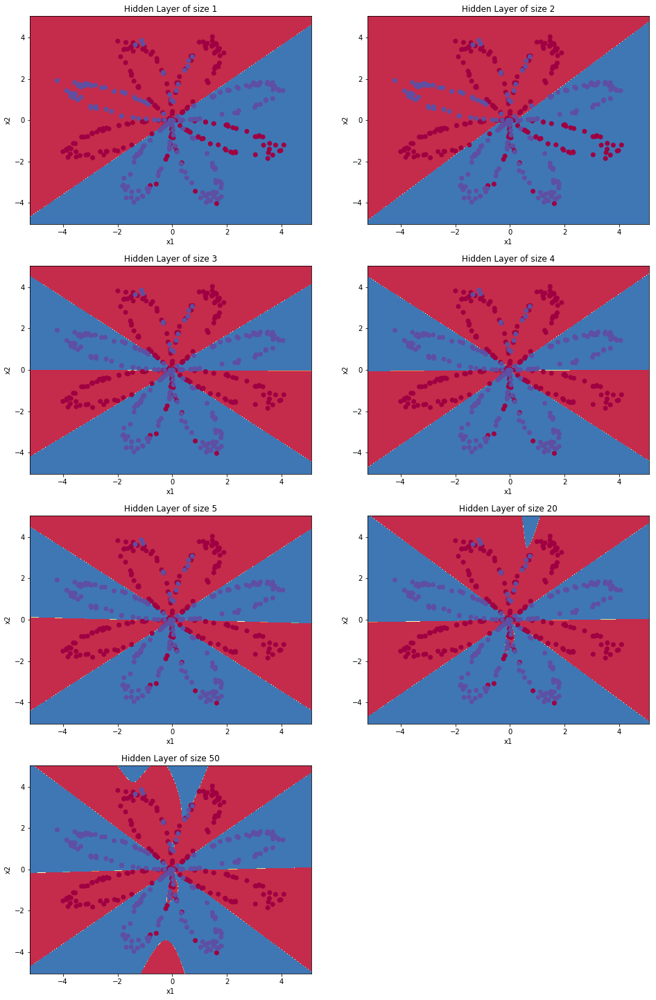

In [31]:
# This may take about 2 minutes to run

plt.figure(figsize=(16, 32))
hidden_layer_sizes = [1, 2, 3, 4, 5, 20, 50]
for i, n_h in enumerate(hidden_layer_sizes):
    plt.subplot(5, 2, i+1)
    plt.title('Hidden Layer of size %d' % n_h)
    parameters = nn_model(X, Y, n_h, num_iterations = 5000)
    plot_decision_boundary(lambda x: predict(parameters, x.T), X, Y)
    predictions = predict(parameters, X)
    accuracy = float((np.dot(Y,predictions.T) + np.dot(1-Y,1-predictions.T))/float(Y.size)*100)
    print ("Accuracy for {} hidden units: {} %".format(n_h, accuracy))

**Interpretation**:
- The larger models (with more hidden units) are able to fit the training set better, until eventually the largest models overfit the data. 
- The best hidden layer size seems to be around n_h = 5. Indeed, a value around here seems to  fits the data well without also incurring noticeable overfitting.
- You will also learn later about regularization, which lets you use very large models (such as n_h = 50) without much overfitting. 

**Optional questions**:

**Note**: Remember to submit the assignment by clicking the blue "Submit Assignment" button at the upper-right. 

Some optional/ungraded questions that you can explore if you wish: 
- What happens when you change the tanh activation for a sigmoid activation or a ReLU activation?
- Play with the learning_rate. What happens?
- What if we change the dataset? (See part 5 below!)

<font color='blue'>
**You've learnt to:**
- Build a complete neural network with a hidden layer
- Make a good use of a non-linear unit
- Implemented forward propagation and backpropagation, and trained a neural network
- See the impact of varying the hidden layer size, including overfitting.

Nice work! 

## 5) Performance on other datasets

If you want, you can rerun the whole notebook (minus the dataset part) for each of the following datasets.

In [ ]:
# Datasets
noisy_circles, noisy_moons, blobs, gaussian_quantiles, no_structure = load_extra_datasets()

datasets = {"noisy_circles": noisy_circles,
            "noisy_moons": noisy_moons,
            "blobs": blobs,
            "gaussian_quantiles": gaussian_quantiles}

### START CODE HERE ### (choose your dataset)
dataset = "noisy_moons"
### END CODE HERE ###

X, Y = datasets[dataset]
X, Y = X.T, Y.reshape(1, Y.shape[0])

# make blobs binary
if dataset == "blobs":
    Y = Y%2

# Visualize the data
plt.scatter(X[0, :], X[1, :], c=Y, s=40, cmap=plt.cm.Spectral);

Congrats on finishing this Programming Assignment!

Reference:
- http://scs.ryerson.ca/~aharley/neural-networks/
- http://cs231n.github.io/neural-networks-case-study/